# Documentation for Hydra Multi-Asset Verification Test
ACTION_LIST = [['test_add', 'test_q_for_r', 'test_r_for_r','test_r_for_q', 'test_remove']]



## Model Description

The methodology for the tests is to create two universes - one for Hydra and one for Uniswap - to subsequently be able to represent sequences of actions on each side. As the Hydra system is unique in its design and has no counterpart yet for approprate comparisons the role of the benchmark will be fulfilled by assembling several Uniswaps together in a way that everything that can be done in Hydra can be accordingly reproduced. This allows next to compare the implications on both systems and ultimately assess the quantitative and qualitative differences of results and impacts on the Hydra system and its agents. 

This approach necessitates the definition and specification of two models:
   - 1 Hydra Omnipool model with one instance that is defined in line with the [Hydra Mathematical Specification](https://hackmd.io/M7OeWimITKGVxBDHGQa6gQ?view)
   - 1 Uniswap model with several instances that each are responsible for a particular mechanism
        - which of 1 instance is used for liquidity provision in asset $R_i$: this is modeled as a Uniswap of $R_i$ and $Q$
        - which of 1 instance is used for liquidity provision in asset $R_j$: this is modeled as a Uniswap of $R_j$ and $Q$
        - which of 1 instance is used for swaps between assets $R_i$ and $R_j$: this is modeled as a Uniswap of $R_i$ and $R_j$
        
![](https://i.imgur.com/yb6Zh3T.png)
        
## Test cases

A variety of testcases can be explored with this model resulting from a combination of the following parameters
   
   - Event: Add Liquidity, Remove Liquidity, Swap Asset, Swap Asset for Base
   - Asset: $R_i$, $R_j$, $R_k$, $Q$
   - Multiple Action Type: Alternating, $i$ only, $j$ only
   - Composite Action Type: Alternating, Trade Bias
   - Enable Symmetric Liquidity: True, False
    
In addition to these settings also a fee structure can be imposed:

   - Fixed Fee

## Test agents

The model specifies a number of eight agents that each have their local balances, can interact with the system and are modeled to be responsible for **one action only**. This allows to track for each testcase how the balances will develop and to show independently which events will trigger changes to local and global states. Most importantly directly and indirectly affected variables can be easily identified.

Two dataframes of agents are initialized identically for both the Uniswap and the Hydra world and then work their way through on each side according to the testcase. Afterwards the effects on both sides can be compared.

![](https://i.imgur.com/r9IAJMr.png)



## Composite Action Tests

Besides being able to test all mechanisms individually also compositions of actions can be performed. This means selecting and combining two from the above testcases and letting the respective agents take the actions repeadetly. A composition action test therefore is defined as two actions which each can be a combination of *event* and *asset* selected from the list of testcases above, for example:
- Add liquidity in $R_i$ and Add liquidity in $R_j$
- Add liquidity in $R_i$ and Swap $R_i$ for $Q$
- Remove liquidity in $R_j$ and Swap $R_i$ for $Q$
- ...

In total there would be 28 composit pairs which can be derived from this decision tree:
selecting any one of the four primitive mechanisms of: **trade in/out** or **add/remove liquidity** of some given asset and then the subsequent action could be the three remaining mechanisms of the same asset or doing anyone of the four mechanisms in another asset.  

These basic combinations can be explored before further proceeding with
- trade sizes,
- trade frequencies,
- randomization,...



## Introduction to Uniswap
>Uniswap is an automated market maker for exchanging ERC20 tokens. Anyone can become a liquidity provider, and invest in the liquidity pool of an ERC20 token. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://uniswap.io/

There are basically eight ways (_mechanisms_) in which an agent can interact with an instance of Uniswap (https://github.com/Uniswap/uniswap-v1/blob/master/contracts/uniswap_exchange.vy):
1. `addLiquidity`: deposit ETH and tokens in the liquidity pool; mint UNI tokens - "shares" of that Uniswap instance - in exchange;
1. `removeLiquidity`: burn UNI tokens; withdraw a proportional amount of ETH and tokens in exchange;
1. `ethToTokenInput`: user specifies an exact amount of ETH they send; receives corresponding amount of tokens
1. `ethToTokenOutput`: user sends some ETH and specifies an exact amount of tokens they want to buy; Uniswap refunds ETH sent in excess
1. `tokenToEthInput`: user specifies an exact amount of tokens they send; receives corresponding amount of ETH
1. `tokenToEthOutput`: user specifies an exact amount of ETH they want to buy; Uniswap takes the corresponding amount of tokens from the user account
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" (effectively a `tokenToEthInput` in instance A combined with a `ethToTokenInput` in instance B)
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Uniswap takes the corresponding amount of "token A" from the user account (effectively a `ethToTokenOutput` in instance B combined with a `tokenToEthOutput` in instance A)

## Limitations and simplifications of this model
* When triggering mechanisms, Uniswap users may include conditions they would like to apply to the transaction. For example, they could define a minimum amount of UNI tokens they wish to receive as a result of adding liquidity to the pool; or the maximum number of tokens they are willing to pay for the amount of ETH requested in a `tokenToEthOutput` operation; or a deadline after which the transaction should not be processed. **This simplified model does not account for this kind conditioning.**

* The `ethToTokenOutput`, `tokenToEthOutput` mechanisms are not implemented. **All swaps are treated as of the "input defined" type.**

* The `tokenToToken` mechanism are not implemented, as they are merely a `tokenToEth` in the context of a single Uniswap instance.

* **User _behavior_ has not been modeled**. User _actions_ are derived from the history of events of the Uniswap instance being analyzed.

## Introduction to Hydra
>Hydra is an automated market maker that generalizes the concept of Uniswap and Balancer to a) an arbitrary number of dimensions and b) a variant weight distaribution of assets in the pool that changes in accordance with action sequences in the pool. Anyone can become a liquidity provider, and invest in the 'Omnipool'. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://hydradx.io/

There is a predefined set of (_mechanisms_) in which an agent can interact with an the Hydra Protocol :
1. `addLiquidity`: deposit a risk asset in the omnipool; mint HDX tokens - "shares" of this risk asset - in exchange;
1. `removeLiquidity`: burn HDX tokens; withdraw a proportional amount of the risk asset in exchange;
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" 
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Hydra takes the corresponding amount of "token A" from the user account 



## Model File structure

The folder **model** contains:

 - a file config.py: 

    This file configures the simulation experiments by setting the number of monte carlo runs, the number of timesteps for the simulation and the simulation parameters. It also aggregates the partial states and the initial state variables.
    
    The purpose of this file is to *configure and initialize* the experiment.
    
    
 - a file partial_state_update_block.py

    This file defines each partial state update block individually. This feature allows cadCAD to divide each simulation timestep into several 'blocks' where different state variables are mutated conditioned upon the policy input.
    
    In the current setting 
    - the first block maps the user action to the appropriate mechanism in the uniswap world
    - the second block maps the user action to the appropriate mechanism in the hydra world
    - the third block resolves the quantities of HDX and weights in the hydra world
    - the forth block calculates the metrics: the swap prices in the uniswap world and the pool prices in the hydra world

    This file corresponds to the system specification diagram, where each column is one partial state update block 
    
    The purpose of this file is to *define* the sequence and details of state updates for each simulation timestep. The relevant mechanisms are imported from the files in the **parts** folder
    
    
 - a file plot_utils.py

    This file defines all plot functions that can be called in the jupyter notebook to visualize the results. In general there are three types of plots:
    - plots related to the uniswap world (do not contain the word 'hydra')
    - plots related to the hydra world (contain the word 'hydra')
    - general plots applicable to both worlds (f.e Impermanent Loss)

    It also can be distinguished between plots related to global system variables and local agent variables:
    - global variables (do not contain the word 'agent')
    - local variables (contain the word 'agent')

    The purpose of this file is to *define* the way how particular properties can be plotted over time.
    

 - a file run.py

    This file *defines* the run and postprocessing methods and is used to execute the simulation run:
    - run() is used to execute the simulation and create a dataframe
    - postprocessing is used to extract relevant metrics from the simulation output in the dataframe

     The purpose of this file is to *execute* the simulation and *create* metrics.
     
     
 - a file state_variables.py

    This file *sets* the number of agents and *defines* the local (agent-level) state variables, *sets* the number of assets and *defines* the global (system-state) variables of the system, *computes* the prices of the assets and *defines* the initial state object
    - the agent states describe their holdings of assets that agents have contributed to the pool or still hold outside as well as their quantities of shares they received for their contribution
    - the global states describe the quantities of assets in the system
    - price variables are computed from the states both in the uniswap and hydra world
    - the initial state object consists of 
        - two agent dataframes, one for each world respectively
        - two sets of global variables, one for each world respectively
        - prices for each world (? is pool = prices ?)

    The purpose of this file is to *define* the global and local states of the system.
    
    
 - a file sys_params.py

    This file *contains* the system parameters and allows to select items from a list for them. Following parameters can be defined:
    - trade action type
    - liquidity action type
    - multiple asset action type
    - composite action type
    - liquidity add type (symmetry)

    In addition the following is set
    - initial values for assets 
    - hard coded fee value
    - choice of the system parameters from the list above
    

 - a folder **parts** which itself contains general files relevant for both instances, files related specifically to Uniswap and files related specifically to Hydra 
      - [action.py](model/parts/action.py)
       This is an action dictionary which drives the model. As there are no behavioral assumptions in the model yet, currently actions are prescribed actions in testing mode derived from events. However, action schema respects https://www.kaggle.com/markusbkoch/uniswap-ethdai-exchange as much as possible, allowing for future analysis against uniswap transaction datasets.
        This file contains a function called 'actionDecoder' which takes its inputs from the file sys_params.py and maps those encoded events to agent actions. At first an arbitrary action dictionary is defined which then is adapted according to the choices of system parameters. In particular relevant are the parameter definitions of the asset, the composite and whether there is a trade or liquidity event defined.
        
    - [uniswap.py](model/parts/uniswap.py)
     Reads in action output and directs the action to the appropriate Uniswap mechanism for each corresponding Uniswap instance. Currently there are two instances in place, namely the R_i<>Q pair and the R_j<>Q pair. Both instances have their respective requisite state variables: UNI_Qx, UNI_Rx, and UNI_Sx.

    - [utils.py](model/parts/utils.py)
    Computes the state update for each Uniswap state variable and outputs the updated global state variables.
        
     - [agent_utils.py](model/parts/agent_utils.py)
     Computes the corresponding agent local state for each Uniswap agent resolving their action and outputs the updates local state variables.

      -  [hydra.py](model/prts/hydra.py)
     Reads in action output and directs the action to the appropriate Hydra mechanism for each state variable: Q, Sq, and pool.
    
      - [hydra_utils.py](model/parts/hydra_utils.py)
     Computes the state update for each Hydra state variable

    -  [asset_utils.py](model/parts/asset_utils.py)
     Computes the state update for each Reserve Asset in a Hydra Omnipool

    -  [hydra_agent_utils_class.py](model/parts/hydra_agent_utils_class.py)
     Computes the corresponding agent local state for each Hydra agent resolving their action and outputs the updates local state variables.
     
     #### The interrelations between the files are shown here:
     
    ![](https://i.imgur.com/mNhfQE4.png)



# Testcase Definition

#### Simulation Settings
- There are 100 timesteps for each simulation run
- Each testcase has 100 MC runs with different randomized variables
- Block 1 randomizes starting liquidity balances (explained below in section 'Block 1')



#### Agent Activities - Action Sequence

There are two agents acting during the simulation. The trading agent performs "R-for-R" trades of equal size but varying direction over most simulation timesteps. The liquidity agent provides liquidity to the pool at timestep 10 and removes the liquidity from the pool at timestep 90.

##### Trading agent

- One Agent performs random "R-for-R" trades during the simulation. 
- The direction of the trade is a random coin flip for each timestep.
- The size of the trade is fixed at $1000$ for each timestep.
- The agent does not act at timestep 10 nor timestep 90.

##### Liquidity agent

- One Agent provides liquidity in Asset "i" to the pool 
- He provides the liquidity at timestep 10
- He removes the liquidity at timestep 90
- He does not act at other timesteps

#### Block 1:

| #   |   Run   | a  | $\mu_i$ |          $\sigma_i$          | $\mu_j$ |          $\sigma_j$          | $\mu$ | $\sigma$ | Total runs         |
| --- |:-------:|:-------:|:-------:|:----------------------------:|:-------:|:----------------------------:| ----- | -------- | ------------------ |
| 1   | 001-100 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 2   | 101-200 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 3   | 201-300 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 4   | 301-400 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$  | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 5   | 401-500 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 6   | 501-600 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |

All tests in block 1 are performed as 100 **MonteCarlo Experiments** with the following randomization:
- The initial balances of the liquidity pools are drawn randomly for each MC run from the same lognormal distribution with $\mu_i$ and $\mu_j$ fixed at $100000$
    - The underlying mean for the lognormal liquidity draw is $\log{100000}$
    - The underlying standard deviation for the lognormal liquidity draw is $\sqrt{\log{1 + \frac{2000^2}{100000^2}}}$
- The action sequence of the agents is randomized in that sense that:
    - For each individual MC run the sequence is identical for the Uniswap and Hydra side of the model. For each timestep of the simulation exactly the same event takes place on both sides.
    - For each individual MC run the trading directions are randomized for each timestep. Therefore the event sequence for each run will be different.
    - For all MC runs the trading amount is always equal to $1000$




# Testcase in this notebook


This notebook documents the results of the following experiment:
- Settings from Block 1 as outlined above
- Testcases **1**, **3** and **5**
- Sweep over three values for $a \in \{0.5, 1, 1.5 \}$ with a fixed $\mu$-to-$\sigma$-ratio of $2$.

The experiment result dataframe is saved into a pickle file and analyzed throughout this notebook.

## Run Model

The following command lines import all packages, experiments and run the model 

This is the execution of cadcad. This writes the config object, does the execution and returns the rdf - which is a data object that shows the rows and columns of results in a dataframe

Here is one additional option as well. The postprocessing causes the index of the results to be every forth because of the cadcad architecture where the partial state updates are the substeps. With this option selected we see only the end of each timestep - the last substep. Therefore only final results are shown. To get a line for each substep the postprocessing needs to be deactivated. 

In [1]:
from model.config_wrapper import ConfigWrapper

from model import run_wrapper
from cadCAD import configs

# parametric_experiment = ConfigWrapper()
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']
# parametric_experiment.get_config()

running file: config_wrapper.py
end of file: config_wrapper.py
running file: run_wrapper.py
end of file: run_wrapper.py


In [2]:
# import model as model


In [3]:
# parametric_experiment = ConfigWrapper(model)


In [4]:
# del configs[:]

# parametric_experiment.append()

In [5]:
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']

In [6]:
# Dependences
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Experiments
from model import run
from model.parts.utils import *
from model.plot_utils import *

pd.options.display.float_format = '{:.2f}'.format

%matplotlib inline

# df = run.run()
# rdf = run.postprocessing(df)
# rdf = df # debugging substeps
# pd.set_option("mode.chained_assignment", None)


running file: run.py
running file: state_variables.py
running file: initialize_liquidity.py
end of file: initialize_liquidity.py
running file: asset_utils.py
end of file: asset_utils.py
end of file: state_variables.py
running file: partial_state_update_block.py
end of file: action_list.py
end of file: partial_state_update_block.py
running file: sim_setup.py
end of file: sim_setup.py
[117495.50135958  95611.25879778 123396.80896711 163945.61903468
  92681.20263534  92681.69654331 166962.85594269 128287.52178985
  85865.50347172 119257.05562057  86034.4775969   85969.93480342
 108170.57813688  53738.68354952  57126.84793488  83317.25550298
  71981.73815777 110738.61693473  74472.65917597  63227.95366503
 160920.31283036  92933.55858926 102216.11620354  62973.06639424
  83802.88617593 103666.06970946  68824.92112422 112969.63603961
  82286.50855935  90966.24299436  82257.98971196 182437.27830573
  99562.84804397  70940.73323924 130603.02513683  67282.02216372
 107014.65789057  52935.55780

Omni_P_RQi ================== 0.06099583544153566
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 163945.61903467937, 'S': 10000, 'W': 10000, 'P': 0.06099583544153566, 'dP': 0}, 'j': {'R': 77073.28511100917, 'S': 10000, 'W': 10000, 'P': 0.12974664289444693}, 'k': {'R': 77073.28511100917, 'S': 10000, 'W': 10000, 'P': 0.12974664289444693}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.10789674406088197
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 92681.20263533981, 'S': 10000, 'W': 10000, 'P': 0.10789674406088197, 'dP': 0}, 'j': {'R': 94899.45833203912, 'S': 10000, 'W': 10000, 'P': 0.1053746794319045}, 'k': {'R': 94899.45833203912, 'S': 10000, 'W': 10000, 'P': 0.1053746794319045}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.10789674406088197
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>

Omni_P_RQi ================== 0.11623247190334142
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 86034.47759689711, 'S': 10000, 'W': 10000, 'P': 0.11623247190334142, 'dP': 0}, 'j': {'R': 53642.98879821878, 'S': 10000, 'W': 10000, 'P': 0.18641765166395893}, 'k': {'R': 53642.98879821878, 'S': 10000, 'W': 10000, 'P': 0.18641765166395893}}}
config_param a value =============  1
Omni_P_RQi ================== 0.11623247190334142
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 86034.47759689711, 'S': 10000, 'W': 10000, 'P': 0.11623247190334142, 'dP': 0}, 'j': {'R': 53642.98879821878, 'S': 10000, 'W': 10000, 'P': 0.18641765166395893}, 'k': {'R': 53642.98879821878, 'S': 10000, 'W': 10000, 'P': 0.18641765166395893}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.11631973460101455
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>:

Omni_P_RQi ================== 0.13892412514521185
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 71981.73815777064, 'S': 10000, 'W': 10000, 'P': 0.13892412514521185, 'dP': 0}, 'j': {'R': 98879.60449673777, 'S': 10000, 'W': 10000, 'P': 0.10113309059938563}, 'k': {'R': 98879.60449673777, 'S': 10000, 'W': 10000, 'P': 0.10113309059938563}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09030273518671895
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 110738.61693472519, 'S': 10000, 'W': 10000, 'P': 0.09030273518671895, 'dP': 0}, 'j': {'R': 68430.98066126654, 'S': 10000, 'W': 10000, 'P': 0.1461326420192634}, 'k': {'R': 68430.98066126654, 'S': 10000, 'W': 10000, 'P': 0.1461326420192634}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09030273518671895
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>

Omni_P_RQi ================== 0.15879804768273367
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 62973.066394236994, 'S': 10000, 'W': 10000, 'P': 0.15879804768273367, 'dP': 0}, 'j': {'R': 63442.84106905442, 'S': 10000, 'W': 10000, 'P': 0.15762219710677033}, 'k': {'R': 63442.84106905442, 'S': 10000, 'W': 10000, 'P': 0.15762219710677033}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.11932763245179008
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 83802.88617592517, 'S': 10000, 'W': 10000, 'P': 0.11932763245179008, 'dP': 0}, 'j': {'R': 120984.18084660778, 'S': 10000, 'W': 10000, 'P': 0.08265543420654888}, 'k': {'R': 120984.18084660778, 'S': 10000, 'W': 10000, 'P': 0.08265543420654888}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.11932763245179008
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Ass

Omni_P_RQi ================== 0.12156873800364996
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 82257.98971195836, 'S': 10000, 'W': 10000, 'P': 0.12156873800364996, 'dP': 0}, 'j': {'R': 60451.169881367074, 'S': 10000, 'W': 10000, 'P': 0.16542277047118503}, 'k': {'R': 60451.169881367074, 'S': 10000, 'W': 10000, 'P': 0.16542277047118503}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.12156873800364996
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 82257.98971195836, 'S': 10000, 'W': 10000, 'P': 0.12156873800364996, 'dP': 0}, 'j': {'R': 60451.169881367074, 'S': 10000, 'W': 10000, 'P': 0.16542277047118503}, 'k': {'R': 60451.169881367074, 'S': 10000, 'W': 10000, 'P': 0.16542277047118503}}}
config_param a value =============  1
Omni_P_RQi ================== 0.12156873800364996
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asse

Omni_P_RQi ================== 0.18890893785663743
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 52935.55780610538, 'S': 10000, 'W': 10000, 'P': 0.18890893785663743, 'dP': 0}, 'j': {'R': 90073.97902636697, 'S': 10000, 'W': 10000, 'P': 0.11101985399215841}, 'k': {'R': 90073.97902636697, 'S': 10000, 'W': 10000, 'P': 0.11101985399215841}}}
config_param a value =============  1
Omni_P_RQi ================== 0.18890893785663743
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 52935.55780610538, 'S': 10000, 'W': 10000, 'P': 0.18890893785663743, 'dP': 0}, 'j': {'R': 90073.97902636697, 'S': 10000, 'W': 10000, 'P': 0.11101985399215841}, 'k': {'R': 90073.97902636697, 'S': 10000, 'W': 10000, 'P': 0.11101985399215841}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.15389797387964263
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>:

Omni_P_RQi ================== 0.12632102272898427
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 79163.38693247065, 'S': 10000, 'W': 10000, 'P': 0.12632102272898427, 'dP': 0}, 'j': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850333}, 'k': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850333}}}
config_param a value =============  1
Omni_P_RQi ================== 0.12632102272898427
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 79163.38693247065, 'S': 10000, 'W': 10000, 'P': 0.12632102272898427, 'dP': 0}, 'j': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850333}, 'k': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850333}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.11612767537501922
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asse

Omni_P_RQi ================== 0.08199222605626101
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 121962.78209519829, 'S': 10000, 'W': 10000, 'P': 0.08199222605626101, 'dP': 0}, 'j': {'R': 107830.23309029221, 'S': 10000, 'W': 10000, 'P': 0.09273836950372209}, 'k': {'R': 107830.23309029221, 'S': 10000, 'W': 10000, 'P': 0.09273836950372209}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.08199222605626101
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 121962.78209519829, 'S': 10000, 'W': 10000, 'P': 0.08199222605626101, 'dP': 0}, 'j': {'R': 107830.23309029221, 'S': 10000, 'W': 10000, 'P': 0.09273836950372209}, 'k': {'R': 107830.23309029221, 'S': 10000, 'W': 10000, 'P': 0.09273836950372209}}}
config_param a value =============  1
Omni_P_RQi ================== 0.08199222605626101
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.10621164576544803
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 94151.63401274708, 'S': 10000, 'W': 10000, 'P': 0.10621164576544803, 'dP': 0}, 'j': {'R': 129108.3814036439, 'S': 10000, 'W': 10000, 'P': 0.07745430537724768}, 'k': {'R': 129108.3814036439, 'S': 10000, 'W': 10000, 'P': 0.07745430537724768}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.14320520531082526
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 69829.8639235572, 'S': 10000, 'W': 10000, 'P': 0.14320520531082526, 'dP': 0}, 'j': {'R': 145655.1763336588, 'S': 10000, 'W': 10000, 'P': 0.06865530118265453}, 'k': {'R': 145655.1763336588, 'S': 10000, 'W': 10000, 'P': 0.06865530118265453}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.14320520531082526
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>

Omni_P_RQi ================== 0.12329396251171942
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 81106.97228219485, 'S': 10000, 'W': 10000, 'P': 0.12329396251171942, 'dP': 0}, 'j': {'R': 78297.27648276718, 'S': 10000, 'W': 10000, 'P': 0.12771836325879032}, 'k': {'R': 78297.27648276718, 'S': 10000, 'W': 10000, 'P': 0.12771836325879032}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.08893126410107997
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112446.39442698039, 'S': 10000, 'W': 10000, 'P': 0.08893126410107997, 'dP': 0}, 'j': {'R': 74921.44508323348, 'S': 10000, 'W': 10000, 'P': 0.13347313294465377}, 'k': {'R': 74921.44508323348, 'S': 10000, 'W': 10000, 'P': 0.13347313294465377}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.08893126410107997
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset

Omni_P_RQi ================== 0.11019216903914911
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90750.55049009151, 'S': 10000, 'W': 10000, 'P': 0.11019216903914911, 'dP': 0}, 'j': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306432}, 'k': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306432}}}
config_param a value =============  1
Omni_P_RQi ================== 0.11019216903914911
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90750.55049009151, 'S': 10000, 'W': 10000, 'P': 0.11019216903914911, 'dP': 0}, 'j': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306432}, 'k': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306432}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09706543069838146
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asse

Omni_P_RQi ================== 0.11832049371712039
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 84516.21258366208, 'S': 10000, 'W': 10000, 'P': 0.11832049371712039, 'dP': 0}, 'j': {'R': 116953.60063318844, 'S': 10000, 'W': 10000, 'P': 0.08550399428371473}, 'k': {'R': 116953.60063318844, 'S': 10000, 'W': 10000, 'P': 0.08550399428371473}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.1300087070477865
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 76917.92516884551, 'S': 10000, 'W': 10000, 'P': 0.1300087070477865, 'dP': 0}, 'j': {'R': 93003.37329919385, 'S': 10000, 'W': 10000, 'P': 0.10752298164314734}, 'k': {'R': 93003.37329919385, 'S': 10000, 'W': 10000, 'P': 0.10752298164314734}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.1300087070477865
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>

Omni_P_RQi ================== 0.07302157546326137
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 136945.82644318874, 'S': 10000, 'W': 10000, 'P': 0.07302157546326137, 'dP': 0}, 'j': {'R': 132046.10051326393, 'S': 10000, 'W': 10000, 'P': 0.07573112694074224}, 'k': {'R': 132046.10051326393, 'S': 10000, 'W': 10000, 'P': 0.07573112694074224}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.07302157546326137
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 136945.82644318874, 'S': 10000, 'W': 10000, 'P': 0.07302157546326137, 'dP': 0}, 'j': {'R': 132046.10051326393, 'S': 10000, 'W': 10000, 'P': 0.07573112694074224}, 'k': {'R': 132046.10051326393, 'S': 10000, 'W': 10000, 'P': 0.07573112694074224}}}
config_param a value =============  1
Omni_P_RQi ================== 0.07302157546326137
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09187541846415995
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 108843.04166626399, 'S': 10000, 'W': 10000, 'P': 0.09187541846415995, 'dP': 0}, 'j': {'R': 105116.39453921908, 'S': 10000, 'W': 10000, 'P': 0.09513263886033481}, 'k': {'R': 105116.39453921908, 'S': 10000, 'W': 10000, 'P': 0.09513263886033481}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09187541846415995
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 108843.04166626399, 'S': 10000, 'W': 10000, 'P': 0.09187541846415995, 'dP': 0}, 'j': {'R': 105116.39453921908, 'S': 10000, 'W': 10000, 'P': 0.09513263886033481}, 'k': {'R': 105116.39453921908, 'S': 10000, 'W': 10000, 'P': 0.09513263886033481}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09983415852476969
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

In [7]:
(data, tensor_field, sessions) = run_wrapper.run(drop_midsteps=True)

experiments = data



                  ___________    ____
  ________ __ ___/ / ____/   |  / __ \
 / ___/ __` / __  / /   / /| | / / / /
/ /__/ /_/ / /_/ / /___/ ___ |/ /_/ /
\___/\__,_/\__,_/\____/_/  |_/_____/
by cadCAD

Execution Mode: local_proc
Configuration Count: 100
Dimensions of the first simulation: (Timesteps, Params, Runs, Vars) = (100, 16, 3, 22)
Execution Method: local_simulations
SimIDs   : [0, 0, 0, 1, 1, 1, 2, 2, 2, 3, 3, 3, 4, 4, 4, 5, 5, 5, 6, 6, 6, 7, 7, 7, 8, 8, 8, 9, 9, 9, 10, 10, 10, 11, 11, 11, 12, 12, 12, 13, 13, 13, 14, 14, 14, 15, 15, 15, 16, 16, 16, 17, 17, 17, 18, 18, 18, 19, 19, 19, 20, 20, 20, 21, 21, 21, 22, 22, 22, 23, 23, 23, 24, 24, 24, 25, 25, 25, 26, 26, 26, 27, 27, 27, 28, 28, 28, 29, 29, 29, 30, 30, 30, 31, 31, 31, 32, 32, 32, 33, 33, 33, 34, 34, 34, 35, 35, 35, 36, 36, 36, 37, 37, 37, 38, 38, 38, 39, 39, 39, 40, 40, 40, 41, 41, 41, 42, 42, 42, 43, 43, 43, 44, 44, 44, 45, 45, 45, 46, 46, 46, 47, 47, 47, 48, 48, 48, 49, 49, 49, 50, 50, 50, 51, 51, 51, 52, 52, 52, 53, 

**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 16978.979655039715 from reserve 184456.31044795158
**********
1000H_chosen_agent
 delta_Ri = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 91923.64 110000.00 138000.00 170000.00 150000.00 0.00 109768.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent -9151.67631129164
H_agent r out =  88948.57473783856
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********delta_Ri = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 122469.14 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri =  
q_sold = 
delta_Ri =  5305.198141892246
H_agent r out =  122469.13734655616
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RE

q_sold =  q_sold = H_chosen_agent 1000
 88924.71361147714
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********1000
     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 54916.37 110000.00 133000.00 170000.00 150000.00 0.00 114055.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent

delta_Ri =    1000
H_chosen_agent1000
H_chosen_agent  **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71248.94 110000.00 134000.00 170000.00 150000.00 0.00 99143.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -4943.499877396408   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139886.19 110000.00 131000.00 170000.00 150000.00 0.00 134916.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

-4929.227147574699   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r

q_sold = q_sold =   1000
 -3543.865165413932
H_agent r out =  104969.22099011921
**********
Q ADDED INTO POOL: 1000 to existing amount 42488.62043548459
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3543.865165413932 from reserve 48134.260053572034
**********
q_sold =  1000
  H_chosen_agent-2933.212843923589153400.54509339534
**********
Q ADDED INTO POOL: 1000 to existing amount 49253.456932357556
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3230.1321422703913 from reserve 53836.731507578435
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54603.09 110000.00 128000.00 170000.00 150000.00 0.00 97439.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000**********q_sold = 

 1000
q_sold = 

q_sold =  1000
delta_Ri =  -2887.8506455577244
H_agent r out =  54603.09158845456
**********
Q ADDED INTO POOL: 1000 to existing amount 46006.534787865756
**********
**********
POOL RESERVE ONE REMO

0 180000.00 160000.00  delta_Ri = q_sold =  -2180.829543800159
H_agent r out =  41696.2870256992
**********
Q ADDED INTO POOL: 1000 to existing amount 52006.534787865756
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2180.829543800159 from reserve 84377.489661039
**********
 1000
1000 


H_chosen_agent
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163433.32 110000.00 122000.00 170000.00 150000.00 0.00 164035.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151606.17 110000.00 120000.00 170000.00 150000.00 0.00 162050.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = delta_Ri = delta_Ri =  4230.902375027939
H_agent r out =  163419.01833982635
**********
Q ADDED INTO POOL: 1000 to existing amount 44171.30685423626
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4230.902

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151008.58 110000.00 121000.00 170000.00 150000.00 0.00 174750.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
 H_chosen_agent
delta_Ri =  3008.145908400637delta_Ri = 
H_agent r out =  174750.99233135878
**********
Q ADDED INTO POOL: 1000 to existing amount 48171.30685423626
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3008.145908400637 from reserve 59263.11662595378
**********
q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156542.85 110000.00 116000.00 170000.00 150000.00 0.00 166421.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   2980.458476967612   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36317.45 110000.00 118000.00 170000.00 150000.00 0.00 86268.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 
delta_Ri =  -1362.6663984046147
H


  163048.96767704663
**********
Q ADDED INTO POOL: 1000 to existing amount 64253.456932357556
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1962.23417912315 from reserve 82562.29112073091
**********
1000q_sold = ********** 1000
delta_Ri = 
**********
1000 2485.2517776575805
H_agent r out =  182065.90573399758
**********
Q ADDED INTO POOL: 1000 to existing amount 56277.37188133427
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2485.2517776575805 from reserve 87191.14988657432
**********

POOL RESERVE ONE REMOVING ASSET i in amount 3339.224901170657 from reserve 99390.586982868
**********
q_sold = H_chosen_agentq_sold = 
  1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46931.23 110000.00 115000.00 170000.00 150000.00 0.00 59635.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2242.153820359273
H_agent r out =  46931.23139793769
**********
Q ADDED INTO POOL: 1000

delta_Ri = 
1000

delta_Ri =  -2583.0191093376666
H_agent r out =  13861.204063230747
**********
Q ADDED INTO POOL: 1000 to existing amount 59867.714476898174
**********
********** -1958.8654715992966
H_agent r out =  57495.69833965736
**********
Q ADDED INTO POOL: 1000 to existing amount 64270.08369853387
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1958.8654715992966 from reserve 46214.984100717746
**********


POOL RESERVE ONE REMOVING ASSET i in amount 2583.0191093376666 from reserve 87258.01303034057
**********
H_chosen_agent q_sold = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27697.49 110000.00 108000.00 170000.00 150000.00 0.00 78805.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = q_sold = 
delta_Ri =  -767.8852986964487
H_agent r out =  78804.99893512791
**********
Q ADDED INTO POOL: 1000 to existing amount 64488.62043548459
H_chosen_agent**********
**********
POOL RESERVE ONE R

0 180000.00 160000.00  
q_sold = 53737.3397896554451299.2219255796647
H_agent r out =  195390.54501879553
**********
Q ADDED INTO POOL: 1000 to existing amount 64171.30685423626
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1299.2219255796647 from reserve 38623.56393851706
**********

delta_Ri = H_chosen_agent

q_sold = delta_Ri =  -3833.858918299028
H_agent r out =  509.47829913964415
**********
Q ADDED INTO POOL: 1000 to existing amount 59764.98177608098
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3833.858918299028 from reserve 117472.33424183355
**********
   q_sold =  1000
q_sold =  1000
delta_Ri =  **********
Q ADDED INTO POOL: 1000 to existing amount 70270.08369853387
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1658.9836201783223 from reserve 42456.62555071583
**********
1997.1227449290423    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16550.14 110000.00 99000.00 170000.00 150000

0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176508.25 110000.00 93000.00 170000.00 150000.00 0.00 181407.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 

delta_Ri =  1380.570905685959
H_agent r out =  176508.25080254514
**********
Q ADDED INTO POOL: 1000 to existing amount 82253.45693235756
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1380.570905685959 from reserve 69103.00799523239
**********
q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196925.31 110000.00 97000.00 170000.00 150000.00 0.00 185681.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =   
 -3372.0170624519296
H_agent r out =  -6917.232470315949
**********
Q ADDED INTO POOL: 1000 to existing amount 64764.98177608098
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3372.0170624519296 from reserve 110045.62347237796


delta_Ri = H_chosen_agent H_chosen_agentdelta_Ri =  H_chosen_agent  1227.4371683933407
H_agent r out =  180490.91918976002
**********
Q ADDED INTO POOL: 1000 to existing amount 87253.45693235756
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1227.4371683933407 from reserve 65120.33960801748
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 -10289.25 110000.00 99000.00 170000.00 150000.00 0.00 -12317.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 172749.78 110000.00 96000.00 170000.00 150000.00 0.00 202062.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12245.53 110000.00 93000.00 170000.00 150000.00 0.00 73870.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1807.0852299519647
H_

  1000-1234.069237500536
H_agent r out =  -16445.537090880403
**********
Q ADDED INTO POOL: 1000 to existing amount 70764.98177608098
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1234.069237500536 from reserve 48010.77335707122
**********

H_chosen_agentq_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206145.74 110000.00 87000.00 170000.00 150000.00 0.00 189470.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17323.35 110000.00 86000.00 170000.00 150000.00 0.00 45410.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180893.50 110000.00 90000.00 170000.00 150000.00 0.00 202956.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri = q_sold =  1000
H_chosen_agentdelta_Ri =  -934.2474588185851
H_agent r

q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182299.53 110000.00 86000.00 170000.00 150000.00 0.00 205362.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  q_sold =  

delta_Ri =  1343.6713917894824
H_agent r out =  182299.52633012235
**********
Q ADDED INTO POOL: 1000 to existing amount 83171.30685423626
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1343.6713917894824 from reserve 60382.170213192425
**********
 1000
delta_Ri = 1000H_chosen_agent
 q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13773.40 110000.00 80000.00 170000.00 150000.00 0.00 43316.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000  
delta_Ri =  -814.6529638123933
H_agent r out =  13773.402740365733
**********
Q ADDED INTO POOL: 1000 to existing amount 93270.08369853387
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 

 
 1000-516.0232703126571
H_agent r out =  52120.251385256255
********************   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186197.97 110000.00 76000.00 170000.00 150000.00 0.00 186981.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1023.6108509602834
H_agent r out =  186197.9741316645
**********
Q ADDED INTO POOL: 1000 to existing amount 99253.45693235756
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1023.6108509602834 from reserve 59413.284666112995
**********


1000delta_Ri =  -783.4047933903361
H_agent r out =  52193.793623010024
**********
Q ADDED INTO POOL: 1000 to existing amount 104006.53478786576
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 783.4047933903361 from reserve 27093.251955049145
**********
H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 89867.71447689817

q_sold = 
H_chosen_agentH_chosen_agentH_chosen_agent  **********  q_sold =  1000

********

 -716.6715116851343q_sold =  1000

delta_Ri =  -1634.9559561968197
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190596.71 110000.00 74000.00 170000.00 150000.00 0.00 208638.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_agent r out =  10667.725126143676
**********
Q ADDED INTO POOL: 1000 to existing amount 101270.08369853387
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 716.6715116851343 from reserve 46533.22859786366
**********
 q_sold = 
q_sold =  1000
H_chosen_agentdelta_Ri =  567.2786469608317
H_agent r out =  208638.23550805586
********** 1000
1000 H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 95171.30685423626
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 567.2786469608317 from reserve 25375.873449256676
**********
  H_chosen_agent
-40679.89036335789 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -15

H_chosen_agent   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6675.27 110000.00 65000.00 170000.00 150000.00 0.00 39055.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 214318.34 110000.00 69000.00 170000.00 150000.00 0.00 196392.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -593.77425531588541000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3961.08 110000.00 70000.00 170000.00 150000.00 0.00 69576.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194388.71 110000.00 69000.00 170000.00 150000.00 0.00 209205.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_agent r out = 
delta_Ri =  863.1802679203882
H_agent r out =  194388.71249054102
**********


0 130000.00 180000.00 160000.00  -1072.6136512906292H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -105.79 110000.00 62000.00 170000.00 150000.00 0.00 49972.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00     1000

delta_Ri =  -562.6109695025146
H_agent r out =  -105.79370089917143
**********
Q ADDED INTO POOL: 1000 to existing amount 112006.53478786576
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 562.6109695025146 from reserve 42575.40893444065
**********


H_agent r out =  -6225.236523074591
**********
Q ADDED INTO POOL: 1000 to existing amount 106488.6204354846
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1072.6136512906292 from reserve 61270.26483650477
**********
-589.3526437038644
H_chosen_agent delta_Ri =  -1187.5598073246003
H_agent r out = delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -20212.69 110000.00 6400

0 130000.00 180000.00 160000.00  delta_Ri = 1000
**********
Q ADDED INTO POOL: 1000 to existing amount 108277.37188133427
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 391.6918537856143 from reserve 19477.90244936779
**********
 H_chosen_agentq_sold =  
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3836.53 110000.00 55000.00 170000.00 150000.00 0.00 35794.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2270.40 110000.00 58000.00 170000.00 150000.00 0.00 49972.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent
   1000-1000.6745466910454
477.1654821617772q_sold = 

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194294.49 110000.00 58000.00 170000.00 150000.00 0.00 190576.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


 
2806.2419387416967q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 97206.35833978651
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 488.18802874555166 from reserve 25796.7701843041
**********
H_chosen_agent 1000 **********1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 219807.74 110000.00 56000.00 170000.00 150000.00 0.00 199264.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 -62247.31 110000.00 51000.00 170000.00 150000.00 0.00 -29405.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_chosen_agent
 delta_Ri =  810.0233499211981
Q ADDED INTO POOL: 1000 to existing amount 111867.71447689817
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 298.5618771714082 from reserve 16380.08959403423
**********
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r

q_sold =  1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200526.30 110000.00 53000.00 170000.00 150000.00 0.00 212969.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  67943.89832807073delta_Ri = 
 H_chosen_agentH_chosen_agent  1000q_sold =  delta_Ri = 
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   537.13 110000.00 45000.00 170000.00 150000.00 0.00 34181.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197222.45 110000.00 47000.00 170000.00 150000.00 0.00 192596.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -23895.73 110000.00 52000.00 170000.00 150000.00 0.00 46043.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -439.3349443537778



H_agent r out 

H_chosen_agent
 1000
q_sold =  H_chosen_agent1000
   1000
delta_Ri =  H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201820.74 110000.00 51000.00 170000.00 150000.00 0.00 212969.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -8786.58212147149    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5954.92 110000.00 45000.00 170000.00 150000.00 0.00 46981.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -513.6369883955318
H_agent r out =  46981.84127252686
**********
Q ADDED INTO POOL: 1000 to existing amount 106102.29560370256
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 513.6369883955318 from reserve 21881.29960456598
**********
q_sold = 
 
q_sold =  1000
delta_Ri =  604.4235659927324
H_agent r out =  201820.73700921988
q_sold = H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  

q_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 89040.39 110000.00 137000.00 170000.00 150000.00 0.00 103555.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
  1000**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8616.61974614271 from reserve 92681.20263533981
**********
 H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 77932.47 110000.00 135000.00 170000.00 150000.00 0.00 94862.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203001.04 110000.00 48000.00 170000.00 150000.00 0.00 213361.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

1000
1000q_sold = delta_Ri =  -5918.061590765501
H_agent r out =  94862.89394457436
**********
Q ADDED INTO POOL: 100


POOL RESERVE ONE REMOVING ASSET i in amount 4572.152761661757 from reserve 68095.36563358911
**********
  -5699.161663791671
H_agent r out =  65623.41918661217
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5699.161663791671 from reserve 84880.47480718409
**********
1000H_chosen_agentq_sold = 
 1000
q_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 84579.56 110000.00 138000.00 170000.00 150000.00 0.00 112746.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -12769.656886419965
H_agent r out =  84579.55636722058
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 12769.656886419965 from reserve 148525.17540189996
**********
 q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 17000

q_sold = 
delta_Ri =  -7285.4467822235765
H_agent r out =  69513.65963426388
**********
Q ADDED INTO POOL: 1000 to existing amount 35646.13648357981
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7285.4467822235765 from reserve 147801.18142411218
**********
7322.257382991184delta_Ri = q_sold =  1000
 3120.0451474533193
H_agent r out =  159636.18829817922
**********
Q ADDED INTO POOL: 1000 to existing amount 40800.96803467534
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3120.0451474533193 from reserve 55263.27003385992
**********
   1000
1000
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139792.81 110000.00 131000.00 170000.00 150000.00 0.00 138396.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1000
1000

q_sold = delta_Ri = H_chosen_agentq_sold = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 43978.10 110000.00 132000.00 170000.00 150000.00 0.00 

0 180000.00 160000.00  q_sold = H_chosen_agent
    delta_Ri =  -3886.06798933653
H_agent r out =  64526.63637702228
**********
Q ADDED INTO POOL: 1000 to existing amount 42617.27320533722
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3886.06798933653 from reserve 107208.33292033707
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45802.41 110000.00 126000.00 170000.00 150000.00 0.00 83037.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145536.23 110000.00 121000.00 170000.00 150000.00 0.00 170305.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56948.38 110000.00 126000.00 170000.00 150000.00 0.00 86878.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  



delta_Ri =  -3229.347088719037

1000q_sold = 1000
 
q_sold = 1000
H_chosen_agent      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159773.13 110000.00 114000.00 170000.00 150000.00 0.00 172350.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  1774.1556963917787
H_agent r out =  159773.13394073874
**********
Q ADDED INTO POOL: 1000 to existing amount 61043.93375431084
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1774.1556963917787 from reserve 76092.3695309813
**********
q_sold = 1000H_chosen_agent1000q_sold = 1000 1000
q_sold = 

q_sold = H_chosen_agent H_chosen_agent 1000
  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41753.51 110000.00 122000.00 170000.00 150000.00 0.00 73354.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155734.83 110000.00 116000.00 170000.00 150000.00 0.00


   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34454.40 110000.00 117000.00 170000.00 150000.00 0.00 66342.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -3301.9149214388717
H_agent r out =  34454.40487423682
**********
Q ADDED INTO POOL: 1000 to existing amount 52471.931826159496
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3301.9149214388717 from reserve 103711.46049480874
**********
 q_sold =  1000
H_chosen_agent 164858.78684383526q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39083.96 110000.00 119000.00 170000.00 150000.00 0.00 59197.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30589.11 110000.00 120000.00 170000.00 150000.00 0.00 75700.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
*****

0 180000.00 160000.00  q_sold = 
H_agent r out =  181563.79236338002
**********
Q ADDED INTO POOL: 1000 to existing amount 60800.96803467534
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1160.204191379251 from reserve 33335.66596865906
**********
 1000


 
**********POOL RESERVE ONE REMOVING ASSET j in amount 1895.1391817242904 from reserve 47084.69446436757q_sold = 
**********
delta_Ri = 
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39083.96 110000.00 116000.00 170000.00 150000.00 0.00 53926.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1492.8706065426309
H_agent r out =  53926.19020382376
**********
Q ADDED INTO POOL: 1000 to existing amount 50646.13648357981
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1492.8706065426309 from reserve 39756.49308903438
**********
H_chosen_agentq_sold =  1000
H_chosen_agentq_sold = q_sold =   1000
**********  1000
-2912.38843064492
H

  q_sold = delta_Ri =   delta_Ri =  -1008.0616885448741
H_agent r out =  70777.05516587898
**********
Q ADDED INTO POOL: 1000 to existing amount 53949.35274377923
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1008.0616885448741 from reserve 27850.340276888153
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42868.75 110000.00 111000.00 170000.00 150000.00 0.00 65883.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10001000 
delta_Ri =  -1235.1435210626141
H_agent r out =  65883.17083031235
**********
Q ADDED INTO POOL: 1000 to existing amount 62438.70291371616
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1235.1435210626141 from reserve 33120.44743128618
**********

1255.7164913679628
H_agent r out = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15052.51 110000.00 109000.00 170000.00 150000.00 0.00 64415.36 130000.00   

        q_j   

0 180000.00 160000.00  delta_Ri =  -3695.8803634485066
H_agent r out =  26167.804691674668
**********
Q ADDED INTO POOL: 1000 to existing amount 60646.13648357981
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3695.8803634485066 from reserve 104455.32648152295
**********


q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40500.73 110000.00 107000.00 170000.00 150000.00 0.00 62435.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = H_chosen_agent -1385.5407630430207
H_agent r out =  59527.24772796588
**********
Q ADDED INTO POOL: 1000 to existing amount 64471.931826159496
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1385.5407630430207 from reserve 37139.749224324514
**********
  delta_Ri =  
q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178275.80 110000.00 98000.00 170000.00 150000.00 0.00 184818.07   

     r_j_in  

0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -675.794036772923
H_agent r out =  65655.7339848579
**********
Q ADDED INTO POOL: 1000 to existing amount 62949.35274377923
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 675.794036772923 from reserve 22729.019095867086
**********
 H_chosen_agent -825.7025108555874
H_agent r out =  43595.42643899378
**********
Q ADDED INTO POOL: 1000 to existing amount 64646.13648357981
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 825.7025108555874 from reserve 29425.729324204407
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38256.06 110000.00 103000.00 170000.00 150000.00 0.00 59638.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5114.14 110000.00 99000.00 170000.00 150000.00 0.00 56856.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

H_agent r out =  58050.404765155596
**********
Q ADDED INTO POOL: 1000 to existing amount 74438.70291371616
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 725.7272175581264 from reserve 25287.68136612943
**********
 H_chosen_agentq_sold = delta_Ri = q_sold = 837.4998048247768
H_agent r out =  186656.7827003347
**********
Q ADDED INTO POOL: 1000 to existing amount 74800.96803467534
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 837.4998048247768 from reserve 28242.67563170439
**********

 
 1000
  delta_Ri =  -568.2489356864291
H_agent r out =  63741.965768037604
**********
Q ADDED INTO POOL: 1000 to existing amount 69949.35274377922
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 568.2489356864291 from reserve 20815.25087904679
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4828.15 110000.00 95000.00 170000.00 150000.00 0.00 41988.93 130000.00   

        q_j       s_j  
0 180000.

0 130000.00 180000.00 160000.00    
194408.92930624247
delta_Ri =  -1044.3345599432084
H_agent r out =  54541.69867341093
**********
Q ADDED INTO POOL: 1000 to existing amount 78471.9318261595
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1044.3345599432084 from reserve 32154.200169769574
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30333.68 110000.00 94000.00 170000.00 150000.00 0.00 55991.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   244.76 110000.00 91000.00 170000.00 150000.00 0.00 40548.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
2419.7843316794247
H_agent r out =  179417.04531909502
**********
Q ADDED INTO POOL: 1000 to existing amount 72652.17562564893
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2419.7843316794247 from reserve 88078.45604048

 1000Q ADDED INTO POOL: 1000 to existing amount 76652.17562564893delta_Ri = 1000q_sold =  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180808.09 110000.00 83000.00 170000.00 150000.00 0.00 197464.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14752.85 110000.00 85000.00 170000.00 150000.00 0.00 37302.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  901.0450493890061
H_agent r out =  197464.91678401735
**********
Q ADDED INTO POOL: 1000 to existing amount 92043.93375431084
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 901.0450493890061 from reserve 31254.368977043065
**********
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 419.979177040138 from reserve 16273.98994332738
**********
1000q_sold = H_chosen_agent
q_sold =  1000
delta_Ri =  -1136.121729461848
H_agent r out =  1475

 H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13945.87 110000.00 81000.00 170000.00 150000.00 0.00 39249.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1050.53983788304H_chosen_agent
H_agent r out =  12524.650711973283
**********
Q ADDED INTO POOL: 1000 to existing amount 89617.27320533722
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1050.53983788304 from reserve 55206.34725528804
**********

 H_chosen_agentdelta_Ri =  -500.6627843033778
H_agent r out =  53717.141599111215
**********
Q ADDED INTO POOL: 1000 to existing amount 87438.70291371616
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 500.6627843033778 from reserve 20954.418200085052
**********
q_sold = q_sold =    1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -31990.23 110000.00 81000.00 170000.00 150000.00 0.00 59925.29 130000.00   

        q_j       s_j  


 37525.132940466385q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 90646.13648357982
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 523.3956605575881 from reserve 23355.435825677014
**********
  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -35751.98 110000.00 76000.00 170000.00 150000.00 0.00 58831.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1754.3328754010831
H_agent r out =  -35751.98423213521
**********
Q ADDED INTO POOL: 1000 to existing amount 90949.35274377922
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1754.3328754010831 from reserve 78193.63480254417
**********
 q_sold = 1000 H_chosen_agentH_chosen_agent 1000 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198816.25 110000.00 81000.00 170000.00 150000.00 0.00 168794.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 16000

0 130000.00 180000.00 160000.00  
H_agent r out =  -12328.32838477946
**********
Q ADDED INTO POOL: 1000 to existing amount 91471.9318261595
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1008.8766468879521 from reserve 56928.72723579248
**********

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15823.39 110000.00 76000.00 170000.00 150000.00 0.00 51848.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =   H_chosen_agent1000

delta_Ri =  -1151.678754037577
H_agent r out =  15823.391549182814
**********
Q ADDED INTO POOL: 1000 to existing amount 97438.70291371616
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1151.678754037577 from reserve 61434.65034696037
**********
1000H_chosen_agent
q_sold =  H_chosen_agent 1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201713.35 110000.00 76000.00 170000.00 150000.00 0.00 169736.99   

     r_j_in       q_j

0 130000.00 180000.00 160000.00   
delta_Ri =  736.6812506062164
H_agent r out =  199528.08585835018
**********
Q ADDED INTO POOL: 1000 to existing amount 104800.96803467534
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 736.6812506062164 from reserve 43153.11677698965
**********
q_sold = -295.16431195171293   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187497.45 110000.00 62000.00 170000.00 150000.00 0.00 206165.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
H_chosen_agentH_agent r out =  57870.196905124525
**********
Q ADDED INTO POOL: 1000 to existing amount 98949.35274377922
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 295.16431195171293 from reserve 14943.482016133717
**********
1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200264.77 110000.00 62000.00 170000.00 150000.00 0.00 195119.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1

0 180000.00 160000.00  H_chosen_agent  H_chosen_agentH_agent r out = q_sold = 
50285.129263442774
**********
Q ADDED INTO POOL: 1000 to existing amount 105438.70291371616
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 351.50291965558006 from reserve 17522.405864416607
**********
  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207989.42 110000.00 66000.00 170000.00 150000.00 0.00 171060.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
29943.9338350018841000   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -23792.81 110000.00 62000.00 170000.00 150000.00 0.00 33905.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********
Q ADDED INTO POOL: 1000 to existing amount 110617.27320533722
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 501.00268469216275 from reserve 23958.04279231442
**********
delta_Ri = q_sold = 
H_chosen_agent -1306.3049

0 180000.00 160000.00  
delta_Ri =  -510.97630774381065
H_agent r out =  44775.08382291509
**********
Q ADDED INTO POOL: 1000 to existing amount 103471.9318261595
**********
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -49138.15 110000.00 60000.00 170000.00 150000.00 0.00 56755.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -26750.52 110000.00 58000.00 170000.00 150000.00 0.00 33530.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00    


1000
 1000POOL RESERVE ONE REMOVING ASSET j in amount 510.97630774381065 from reserve 22387.58531927374delta_Ri = H_chosen_agent
delta_Ri =  -253.14888671730532
H_agent r out =  56755.59908843902
**********
Q ADDED INTO POOL: 1000 to existing amount 106949.35274377922
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 253.14888671730532 from reserve 13828.88419944821
******

1000H_chosen_agent
q_sold = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -17890.68 110000.00 61000.00 170000.00 150000.00 0.00 42862.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000
delta_Ri = H_chosen_agent
 -544.2233849877757
H_agent r out =  q_sold = delta_Ri =  -428.10750410417796
H_agent r out =  42862.37400796401
**********
Q ADDED INTO POOL: 1000 to existing amount 108471.9318261595
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 428.10750410417796 from reserve 20474.875504322674
**********
1000 q_sold = 
 1000
  q_sold = 1000
 1000
-2327.274047075909q_sold = H_chosen_agentH_chosen_agent333.05459502926993   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -28550.18 110000.00 54000.00 170000.00 150000.00 0.00 32821.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
H_agent r out =  209808.5698267834
**********
Q ADDED INTO POOL: 1000 to exis

H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 100696.07349625757 q_sold = 1000
delta_Ri =  -772.4958235651992
H_agent r out =  -19511.27888032337
**********
Q ADDED INTO POOL: 1000 to existing amount 112471.9318261595
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 772.4958235651992 from reserve 49745.77674024856
**********


H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -28550.18 110000.00 52000.00 170000.00 150000.00 0.00 32163.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********1000
**********
POOL RESERVE ONE REMOVING ASSET i in amount 500.70672104607775 from reserve 24815.109906140457
**********

 H_chosen_agentdelta_Ri =  514.6018780775806
H_agent r out =  205897.12062021668
**********
Q ADDED INTO POOL: 1000 to existing amount 97925.18292383951
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 514.6018780775806 from reserve 22460.270677553966
**********
   m

 delta_Ri = 1000q_sold =  180.92429459154027
H_agent r out =  172527.47548723238
**********
Q ADDED INTO POOL: 1000 to existing amount 98395.59228405268
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 180.92429459154027 from reserve 10637.563576220367
**********


 1000 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -51509.18 110000.00 50000.00 170000.00 150000.00 0.00 54960.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000delta_Ri =   
delta_Ri =  -1104.8462753009387
H_agent r out =  -51509.17927219991
**********
Q ADDED INTO POOL: 1000 to existing amount 102594.97373686737
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1104.8462753009387 from reserve 45514.918060210824
**********

 -6553.227022218217
H_agent r out =  92109.0433580475
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6553.227022218217 from

POOL RESERVE ONE REMOVING ASSET i in amount 3579.791424124876 from reserve 57050.174428287006H_chosen_agentdelta_Ri = 
**********

  
H_chosen_agentq_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 101522.25151877676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 628.7527555069989 from reserve 32315.891759478305
**********
**********q_sold = H_chosen_agent 1000
     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -32410.71 110000.00 43000.00 170000.00 150000.00 0.00 30976.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -5117.89773870487
 
1000H_chosen_agent H_agent r out =  78431.72508039446
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5117.89773870487 from reserve 71112.92771573427
**********
Q ADDED INTO POOL: 1000 to existing amount 106594.97373686737
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out 

H_chosen_agent
 H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65012.22 110000.00 130000.00 170000.00 150000.00 0.00 92546.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 158.44239382389958 from reserve 9948.954240465702H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 67604.88 110000.00 131000.00 170000.00 150000.00 0.00 94579.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

q_sold =  delta_Ri = delta_Ri =  -3487.614639095586
H_agent r out =  65012.220542786425
**********
Q ADDED INTO POOL: 1000 to existing amount 43866.39855863692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3487.614639095586 from reserve 107693.42317812624
**********
**********
H_chosen_agent q_sold = H_chosen_agent 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138528.06

-2570.3759260783863   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162360.48 110000.00 133000.00 170000.00 150000.00 0.00 127192.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

H_chosen_agent  H_agent r out =  49575.45692952104
**********
Q ADDED INTO POOL: 1000 to existing amount 49866.39855863692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2570.3759260783863 from reserve 92256.65956486086
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 80235.06 110000.00 137000.00 170000.00 150000.00 0.00 114177.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  6888.964991316881
delta_Ri = 
delta_Ri = **********
H_chosen_agent -2860.5736214290882
H_agent r out = q_sold = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22508.10 110000.00 125000.00 170000.00 150000.00 0.00 42327.86 130000.00   

        q_j       s_j  
0 1

   5046.316290987687
H_agent r out =  133164.2607612659
**********
Q ADDED INTO POOL: 1000 to existing amount 37896.958425615085
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5046.316290987687 from reserve 63909.02434974327
**********
addliq - Sq delta Sq   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55773.23 110000.00 121000.00 170000.00 150000.00 0.00 67905.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = -3520.262268754025q_sold = 1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 74751.69 110000.00 132000.00 170000.00 150000.00 0.00 104253.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 H_agent r out = 6944.518633786285q_sold =  
 
 addliq - Sq delta S 6944.518633786285
POOL ADD LIQUIDITY Timestep ===  10 delta W  10069.552018990113
 
delta_Ri = delta_Ri =  -2590.36170599355
H_agent r out =  104253.4929041604
**********
Q ADDED

 

delta_Ri =  -4838.356145168924
H_agent r out =  11600.974907224478
**********
Q ADDED INTO POOL: 1000 to existing amount 47934.04236515021
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4838.356145168924 from reserve 128563.8308499183
**********
4456.128095832124 H_chosen_agentq_sold = H_chosen_agentdelta_Ri = 
H_agent r out =  155944.54135756154
**********
Q ADDED INTO POOL: 1000 to existing amount 42069.552018990114
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4456.128095832124 from reserve 69885.7615276491
**********
 delta_Ri =  1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33168.96 110000.00 126000.00 170000.00 150000.00 0.00 98702.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -3392.2427908578447q_sold = q_sold =  H_chosen_agent1000

H_agent r out =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 153654.27 110000.00 127000.00 170000.00 150000.0

 

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21512.10 110000.00 120000.00 170000.00 150000.00 0.00 89348.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173853.46 110000.00 124000.00 170000.00 150000.00 0.00 154854.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    -2054.2019024587876
H_agent r out =  69772.07903943656
**********
Q ADDED INTO POOL: 1000 to existing amount 64866.39855863692
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2054.2019024587876 from reserve 44671.53737147569
**********

48524.71887737124delta_Ri =  -3776.005348469732
H_agent r out =  89348.38195025643
**********
Q ADDED INTO POOL: 1000 to existing amount 51890.2139944112
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3776.005348469732 from reserve 58820.541079982715
**********

q_sold =

1000 H_chosen_agentq_sold = -3196.7328391671017
H_agent r out =  -12832.94534334749
**********
Q ADDED INTO POOL: 1000 to existing amount 57934.04236515021
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3196.7328391671017 from reserve 104129.91059934635
**********
H_chosen_agent   
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30258.62 110000.00 120000.00 170000.00 150000.00 0.00 93676.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold =  

1000
delta_Ri =  -2798.1584049768094
H_agent r out = H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16589.49 110000.00 115000.00 170000.00 150000.00 0.00 79310.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -2274.5351089114115
H_agent r out =  16589.493604324925
**********
Q ADDED INTO POOL: 1000 to existing amount 56890.2139944112
**********
**********
POOL RESERVE ONE

 delta_Ri = q_sold =  -1219.4504477228018
H_agent r out =  20564.130879381086
**********
Q ADDED INTO POOL: 1000 to existing amount 76866.39855863692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1219.4504477228018 from reserve 63245.333514720885
**********

 1000q_sold = 
H_agent r out =  74328.58177956534
**********
Q ADDED INTO POOL: 1000 to existing amount 60890.2139944112
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2127.702787463548 from reserve 43800.740909291635
**********
10001000H_chosen_agent 
q_sold = 
 1000
H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36996.31 110000.00 102000.00 170000.00 150000.00 0.00 48232.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1622.2222278536167
H_agent r out =  36996.307869675875
**********
Q ADDED INTO POOL: 1000 to existing amount 72961.5535751395
**********
**********
POOL RESERVE ONE REMOVING ASSET

0 180000.00 160000.00  H_chosen_agent
1000
delta_Ri =   1000
q_sold = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -33880.77 110000.00 98000.00 170000.00 150000.00 0.00  -211.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2245.8819517631546
H_agent r out =  -211.44242873820986
**********
Q ADDED INTO POOL: 1000 to existing amount 67934.0423651502
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2245.8819517631546 from reserve 64244.8680192134
**********
q_sold = -1159.6433857818558 1000
 q_sold = 1000
q_sold =  1000
H_chosen_agentH_chosen_agentq_sold = 
   1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 194268.51 110000.00 106000.00 170000.00 150000.00 0.00 182508.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -33880.77 

q_sold =  1000 delta_Ri = q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41058.19 110000.00 106000.00 170000.00 150000.00 0.00 84380.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -440.35 110000.00 100000.00 170000.00 150000.00 0.00 66900.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   
-890.8228409121533
H_agent r out =  54297.67582575947
**********
Q ADDED INTO POOL: 1000 to existing amount 87866.39855863692
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 890.8228409121533 from reserve 29197.134157798606
**********
1957.6504937692434

q_sold =  1000
delta_Ri = 
H_agent r out =  196324.29762645566
**********
Q ADDED INTO POOL: 1000 to existing amount 69069.55201899011
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1957.6504937692434 from reserve 81963.2241633925

q_sold =  1000
     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 212055.35 110000.00 100000.00 170000.00 150000.00 0.00 173488.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23483.44 110000.00 88000.00 170000.00 150000.00 0.00 43724.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4769.40 110000.00 95000.00 170000.00 150000.00 0.00 64057.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1261.1140557789945
H_agent r out =  64057.657514148035
**********
Q ADDED INTO POOL: 1000 to existing amount 76890.2139944112
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1261.1140557789945 from reserve 33529.81664387434
**********

 q_sold = H_chosen_agentq_sold = delta_Ri =  -1080.4855887163549

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18448.25 110000.00 81000.00 170000.00 150000.00 0.00 41858.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00    delta_Ri = H_chosen_agent
delta_Ri =  -906.2385688977737
H_agent r out =  18448.24761245035
**********
Q ADDED INTO POOL: 1000 to existing amount 93961.5535751395
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 906.2385688977737 from reserve 54313.75108417037
**********
 -667.5123342147702
H_agent r out =  50328.83364863982
**********
Q ADDED INTO POOL: 1000 to existing amount 94866.39855863692
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 667.5123342147702 from reserve 25228.29198067895
**********Q ADDED INTO POOL: 1000 to existing amount 81890.2139944112   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 -46366.79 110000.00 85000.00 170000.00 150000.00 0.00 -11681.14   

     r_j_in       q_j       s_j  
0 130000.00

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15817.38 110000.00 77000.00 170000.00 150000.00 0.00 41003.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent -571.6548196219043
H_agent r out =  48427.06118697044
**********
Q ADDED INTO POOL: 1000 to existing amount 98866.39855863692
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 571.6548196219043 from reserve 23326.519519009566
**********
q_sold =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 226384.85 110000.00 90000.00 170000.00 150000.00 0.00 176128.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  2005.0475548384381
H_agent r out =  226384.84646052012
**********
Q ADDED INTO POOL: 1000 to existing amount 78896.95842561508
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2005.0475548384381 from reserve 87560.77257415923
**********
delta_Ri =    m  r_i_

delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24355.22 110000.00 88000.00 170000.00 150000.00 0.00 80442.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
-725.8503726486354
H_agent r out =  39430.25632624111
**********
Q ADDED INTO POOL: 1000 to existing amount 101961.5535751395
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 725.8503726486354 from reserve 28149.5420873015
**********
q_sold = **********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 -53209.87 110000.00 76000.00 170000.00 150000.00 0.00 -17294.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  Q ADDED INTO POOL: 1000 to existing amount 82896.95842561508
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 486.2651883889786 from reserve 19322.664174776382
**********

delta_Ri =  -1212.5038862076526
H_agent r out =  -53209.87393559424
**********
Q ADDED INTO P

0 180000.00 160000.00  H_chosen_agent  H_chosen_agent1000604.6112707151425    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20669.50 110000.00 82000.00 170000.00 150000.00 0.00 79375.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 -56714.09 110000.00 71000.00 170000.00 150000.00 0.00 -19676.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10569.02 110000.00 67000.00 170000.00 150000.00 0.00 38704.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -827.9181861840283
H_agent r out =  9313.371104748436
**********
Q ADDED INTO POOL: 1000 to existing amount 106866.39855863692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 827.9181861840283 from reserve 51994.57374008821
**********



delta_Ri =  -663.905633881

H_agent r out = 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 -59853.40 110000.00 64000.00 170000.00 150000.00 0.00 -23783.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 H_agent r out =  72777.5463538852
**********
Q ADDED INTO POOL: 1000 to existing amount 92933.87674917757
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 400.40068447477455 from reserve 15942.585417338058
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 212441.31 110000.00 76000.00 170000.00 150000.00 0.00 201781.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent37359.04204811489
H_chosen_agentdelta_Ri =  1270.1291445443799
H_agent r out =  212441.30571933006
**********
Q ADDED INTO POOL: 1000 to existing amount 94069.55201899011
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1270.1291445443799 from reserve 65846.21607051813
*********

0 180000.00 160000.00    1000
**********
delta_Ri =  -366.8443310443826
H_agent r out =  43744.417039851454
**********
Q ADDED INTO POOL: 1000 to existing amount 116866.39855863692
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 366.8443310443826 from reserve 18643.875371890583
**********
delta_Ri = -687.2033644866331q_sold =  -345.5800982086372
H_agent r out =  71633.85578525519
**********
Q ADDED INTO POOL: 1000 to existing amount 97933.87674917757
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 345.5800982086372 from reserve 14798.894848708056
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 240212.20 110000.00 69000.00 170000.00 150000.00 0.00 181715.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 

H_agent r out =  -24223.784869647112
**********
Q ADDED INTO POOL: 1000 to existing amount 107890.2139944112
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6

0 180000.00 160000.00  -706.3835806042946H_chosen_agent  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11240.69 110000.00 68000.00 170000.00 150000.00 0.00 70958.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 217244.01 110000.00 66000.00 170000.00 150000.00 0.00 204742.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   


q_sold = delta_Ri =  -939.7047907165828
H_agent r out =  -11240.693879757458
**********
Q ADDED INTO POOL: 1000 to existing amount 102933.87674917757
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 939.7047907165828 from reserve 56254.80747982192
**********
 -222.804492167127051000
H_chosen_agent 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -26862.01 110000.00 58000.00 170000.00 150000.00 0.00 52762.18 130000.00   

        q_j       s_j  
0 180000

 q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 246836.72 110000.00 59000.00 170000.00 150000.00 0.00 183143.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    delta W  14328.98059431706 delta S  3030
POOL REMOVE LIQUIDITY share fraction of pool = 0.12576557714325393
POOL REMOVE LIQUIDITY share fraction of reserve = 0.23135871722753656
POOL REMOVE LIQUIDITY weight fraction of pool = 0.23135871722753656
-292.36341580497271000H_chosen_agent
H_chosen_agentdelta_Ri =  254.43271333074054
H_agent r out =  183143.8955197617
**********
Q ADDED INTO POOL: 1000 to existing amount 109896.95842561508
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 254.43271333074054 from reserve 13929.389591247545
**********
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5209.21 110000.00 48000.00 170000.00 150000.00 0.00 33084.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

 1000
 H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -29231.60 110000.00 50000.00 170000.00 150000.00 0.00 50674.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 1000
q_sold = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1612.58 110000.00 44000.00 170000.00 150000.00 0.00 41448.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agentH_chosen_agent
delta_Ri =  -546.8638320716942
H_agent r out =  1612.5750223388918
**********
Q ADDED INTO POOL: 1000 to existing amount 106794.13051844887
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 546.8638320716942 from reserve 27696.03793655162
**********

 delta_Ri =  998.6401225876173
H_agent r out =  252368.80492368192
**********
Q ADDED INTO POOL: 1000 to existing amount 115896.95842561508
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 998.6401225876173 from rese

821.0415903155883 1000
H_agent r out =    225012.79174895392
**********
Q ADDED INTO POOL: 1000 to existing amount 101528.60340692717
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 821.0415903155883 from reserve 37976.68282532615
**********
H_chosen_agentq_sold = 
-226.0611757554749-9297.028228440216
H_agent r out =  68778.23707566253
**********
Q ADDED INTO POOL: 1000 to existing amount 117933.87674917757
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 226.0611757554749 from reserve 11943.276139115394
**********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 91282.52 110000.00 138000.00 170000.00 150000.00 0.00 109270.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
q_sold = 
delta_Ri =  -8880.008171704278
H_agent r out =  109270.1674334875
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8880.00817

0 130000.00 180000.00 160000.00  1000
14230.6012113593
H_chosen_agent  H_agent r out =  79485.85773803829
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7828.608787274285 from reserve 98742.91335861021
**********

q_sold =   100068552.17589990706
**********
Q ADDED INTO POOL: 1000 to existing amount 102014.56395366059
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 217.42476357212536 from reserve 11717.21496335992
**********
1000
 delta_Ri = H_chosen_agent
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 72801.73 110000.00 132000.00 170000.00 150000.00 0.00 86530.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
  
delta_Ri =  -4476.029216447379
H_agent r out =  72801.72953881673
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4476.029216447379 f

 
 q_sold = 
**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 120218.54 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000********** 
delta_Ri =  4773.80965824433
H_agent r out =  120218.54453095877
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4773.80965824433 from reserve 65815.93306593834
**********

********************
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5521.959352837006 from reserve 80544.9543804015
**********
q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 11789.499056284436 from reserve 128287.52178984831
**********
H_chosen_agent

1000q_sold =  1000
 1000
q_sold =  1000
POOL RESERVE ONE REMOVING ASSET i in amount 5925.516680412843 from reserve 87539.89551372621 

**********
**********q_sold =  1000
H_chosen_agent
q_sold = H_chosen_agent H_chose

q_sold =  1000
**********  addliq - Sq delta Sq
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8272.895159404614 from reserve 106692.56515598162
**********
 10351.437450423777
addliq - Sq delta S 10351.437450423777
POOL ADD LIQUIDITY Timestep ===  10 delta W  15009.584303114476
5965.253202804502delta_Ri =  -9210.94506608225
H_agent r out =  61742.815569141145
**********
Q ADDED INTO POOL: 1000 to existing amount 34171.5179845214
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9210.94506608225 from reserve 175688.4346038205
**********
 H_chosen_agent
q_sold = q_sold =  q_sold = 1000  1000
 1000
-8993.03095521169
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50959.20 110000.00 122000.00 170000.00 150000.00 0.00 68213.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
delta_Ri =  -2841.4004896647684
H_agent r out = 1000H_chosen_agent

H_chosen_agentq_sold = 1000 1000 1000
q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52531.87 110000.00 126000.00 170000.00 150000.00 0.00 81234.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -8306.397546536444
H_agent r out =  52531.8705030589
**********
Q ADDED INTO POOL: 1000 to existing amount 39171.5179845214
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8306.397546536444 from reserve 166477.48953773823
**********
H_chosen_agent1000q_sold = 
delta_Ri = q_sold =  
 1000
 7774.284339729879
H_agent r out =  182555.0113098806
**********
Q ADDED INTO POOL: 1000 to existing amount 42795.913333926765
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7774.284339729879 from reserve 121901.29913807099
**********
addliq - Sq delta Sq   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48117.80 110000.00 119000.00 170000.00 150000.00 0.00 61861.1

-4659.612332486726H_chosen_agent   
delta_Ri =  -5350.619339584895
H_agent r out =  77294.28649727494
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5350.619339584895 from reserve 72905.54529505249
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144592.57 110000.00 120000.00 170000.00 150000.00 0.00 147240.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40539.77 110000.00 112000.00 170000.00 150000.00 0.00 52390.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47962.86 110000.00 117000.00 170000.00 150000.00 0.00 59058.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2252.5319037538225
H_agent r out =  40539.7749

q_sold = q_sold = H_chosen_agentdelta_Ri =  -1282.035974091139
H_agent r out =  74819.2109804966
**********
Q ADDED INTO POOL: 1000 to existing amount 48171.5179845214
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1282.035974091139 from reserve 31892.49609150579
**********

  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26167.36 110000.00 121000.00 170000.00 150000.00 0.00 75979.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -3286.1822442072844
H_agent r out =  26167.36261378214
**********
Q ADDED INTO POOL: 1000 to existing amount 47800.99085262719
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3286.1822442072844 from reserve 104454.88440363047
**********
1000delta_Ri = q_sold = H_chosen_agent 1000
  1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149558.09 110000.00 115000.00 170000.00 150000.00 0.00 150732.61   

     r_j_in 

1000
-2736.3991949703686delta_Ri = 

H_agent r out =  38866.46706181829
**********
Q ADDED INTO POOL: 1000 to existing amount 58149.589968979824
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4039.7796988749915 from reserve 108123.52268239023
**********

H_chosen_agent 2059.7698912498436
H_agent r out =  154013.52567980427
**********
Q ADDED INTO POOL: 1000 to existing amount 63009.584303114476
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2059.7698912498436 from reserve 82020.95191709287
**********
 q_sold = 
q_sold = H_chosen_agentH_chosen_agent  H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28635.48 110000.00 102000.00 170000.00 150000.00 0.00 45665.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent
delta_Ri =  -1387.2935866283676
H_agent r out =  45665.534511763246
**********
Q ADDED INTO POOL: 1000 to existing amount 70293.59124519318
**********
**********
P

0 130000.00 180000.00 160000.00  **********
Q ADDED INTO POOL: 1000 to existing amount 75293.59124519318
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1209.0266737330655 from reserve 36998.69481186118
**********
-2585.1070034022678q_sold =  q_sold = 
 1000
 1000

delta_Ri =  -2291.7376399627155
H_agent r out =  64074.60928260245
**********
Q ADDED INTO POOL: 1000 to existing amount 57800.99085262719
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2291.7376399627155 from reserve 49904.91216781308
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3266.55 110000.00 108000.00 170000.00 150000.00 0.00 68416.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 delta_Ri =  1264.2362790162606
H_agent r out = delta_Ri = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34826.69 110000.00 105000.00 170000.00 150000.00 0.00 49529.07 13

 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 193412.04 110000.00 100000.00 170000.00 150000.00 0.00 178157.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
-643.9644651944698
H_agent r out =  65408.82293296904
**********
Q ADDED INTO POOL: 1000 to existing amount 62171.5179845214
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 643.9644651944698 from reserve 22482.108043978224
**********
q_sold =  1000
1000

 1000

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161676.23 110000.00 103000.00 170000.00 150000.00 0.00 155523.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri =  1000
H_chosen_agent 
delta_Ri = H_chosen_agentH_chosen_agent1091.1996626563136
H_agent r out =  178157.535103267
**********
Q ADDED INTO POOL: 1000 to existing amount 71823.65825369775
**********
**********
POOL RESERVE ONE REMOVING ASSET j

H_chosen_agentH_chosen_agent  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200129.56 110000.00 94000.00 170000.00 150000.00 0.00 180266.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -915.95 110000.00 99000.00 170000.00 150000.00 0.00 63037.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 237505.12 110000.00 96000.00 170000.00 150000.00 0.00 237365.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 59691.85723016715
**********
Q ADDED INTO POOL: 1000 to existing amount 67800.99085262719
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1916.101784768109 from reserve 45522.16011537779
**********
delta_Ri = 
delta_Ri =  1781.3083663738623
H_agent r out =  237505.11896189122
**********
Q ADDED INT

 
H_chosen_agentH_chosen_agent 1000

delta_Ri =  -1624.3817621686098
H_agent r out =  56014.67760013945
**********
Q ADDED INTO POOL: 1000 to existing amount 72800.99085262719
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1624.3817621686098 from reserve 41844.98048535008
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10873.12 110000.00 91000.00 170000.00 150000.00 0.00 45522.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 170816.52 110000.00 93000.00 170000.00 150000.00 0.00 157739.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 1000
delta_Ri = delta_Ri =  -444.49723968319114
H_agent r out =  61563.413529331716
**********
Q ADDED INTO POOL: 1000 to existing amount 72171.5179845214
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 444.49723968319114 from rese

 1000
q_sold =  1000
H_chosen_agent
H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13817.73 110000.00 81000.00 170000.00 150000.00 0.00 35113.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12374.77 110000.00 91000.00 170000.00 150000.00 0.00 50196.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175756.22 110000.00 88000.00 170000.00 150000.00 0.00 158211.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 244181.23 110000.00 88000.00 170000.00 150000.00 0.00 246109.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_

 1000

H_agent r out =  44436.56435439365
**********
Q ADDED INTO POOL: 1000 to existing amount 86149.58996897982
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 505.4070113931302 from reserve 22049.065850752282
**********
delta_Ri = 
 1276.5160623382983
H_agent r out =  249824.0839625488
**********
Q ADDED INTO POOL: 1000 to existing amount 86795.91333392676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1276.5160623382983 from reserve 67138.77198014507
**********
q_sold = delta_Ri = H_chosen_agent 1000
q_sold =  H_chosen_agent q_sold =  -2250.636828161362-881.9872936664267
H_agent r out =  44865.35955179229
**********
Q ADDED INTO POOL: 1000 to existing amount 84800.99085262719
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 881.9872936664267 from reserve 30695.66243700292
**********
H_chosen_agent
   1000
H_agent r out =  -28411.007409719914
**********
Q ADDED INTO POOL: 1000 to existing amount 84171.5179845214
**********
******

356.4328693745055delta_Ri =  q_sold = -32796.82465280251
**********
Q ADDED INTO POOL: 1000 to existing amount 88171.5179845214
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2028.3895856413585 from reserve 81148.7943818768
**********
H_chosen_agent  1000
-1246.8622735306292
H_agent r out =  -9685.02163108762
**********
Q ADDED INTO POOL: 1000 to existing amount 93149.58996897982
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1246.8622735306292 from reserve 59572.03398948434
**********

 q_sold = q_sold =  1000
**********H_chosen_agentq_sold =   1000

 H_agent r out =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210668.27 110000.00 72000.00 170000.00 150000.00 0.00 189621.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11760.84 110000.00 72000.00 170000.00 150000.00 0.00 30542.65 130000.00   

    

delta_Ri =  -515.2850165018082 
delta_Ri =  -1147.6973588003107
H_agent r out =  -12127.623268554999
**********
Q ADDED INTO POOL: 1000 to existing amount 97149.58996897982
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1147.6973588003107 from reserve 57129.432352016964
**********
q_sold = 
 1000
1000
H_agent r out = q_sold =  1000
H_chosen_agent  30004.258248518992
**********
Q ADDED INTO POOL: 1000 to existing amount 104293.59124519318
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 515.2850165018082 from reserve 24018.367205831542
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14932.94 110000.00 86000.00 170000.00 150000.00 0.00 56297.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 212846.19 110000.00 68000.00 170000.00 150000.00 0.00 190490.11   

     r_j_in       q_j   

965.7048851691352   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184533.08 110000.00 71000.00 170000.00 150000.00 0.00 161172.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  292.0312485955499
H_agent r out =  161172.2156953477
**********
Q ADDED INTO POOL: 1000 to existing amount 104009.58430311448
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 292.0312485955499 from reserve 12470.773102871135
**********
 1026.5320323537326
q_sold = H_agent r out =  214877.99408684272
**********
Q ADDED INTO POOL: 1000 to existing amount 109823.65825369775
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 965.7048851691352 from reserve 58518.81488026706
**********
H_chosen_agent1000
q_sold = H_agent r out =  256819.002677411
**********
Q ADDED INTO POOL: 1000 to existing amount 98795.91333392676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1026.5320323537326 from reserve 60143.853

H_chosen_agentq_sold = ********** H_chosen_agentdelta_Ri =  898.48669621887
H_agent r out =  260725.11079908477
********** 1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8395.00 110000.00 77000.00 170000.00 150000.00 0.00 54468.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -26250.80 110000.00 67000.00 170000.00 150000.00 0.00 40238.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

Q ADDED INTO POOL: 1000 to existing amount 104795.91333392676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 898.48669621887 from reserve 56237.745143609136
**********
delta_Ri =  -954.7645314177955
H_agent r out = 

******************** 8394.997057121365
**********
Q ADDED INTO POOL: 1000 to existing amount 94916.62135962109
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 954.7645314177955

q_sold = 
delta_Ri =  -860.2104414079304
H_agent r out =  1000
H_chosen_agentH_agent r out =  H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189772.73 110000.00 60000.00 170000.00 150000.00 0.00 162263.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =   
263337.0337918984
**********
Q ADDED INTO POOL: 1000 to existing amount 108795.91333392676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 817.5350208240081 from reserve 53625.82215079551
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -18385.14 110000.00 58000.00 170000.00 150000.00 0.00 39913.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  243.66214902925617
H_agent r out =  162263.6013037716
**********
Q ADDED INTO POOL: 1000 to existing amount 115009.58430311448
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 243.66214902925617 from reserve 

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 223.8594145142247 from reserve 10902.27502742626
**********
********** H_chosen_agent 
POOL RESERVE ONE REMOVING ASSET i in amount 674.5864007807309 from reserve 29267.05328484264
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -43618.68 110000.00 57000.00 170000.00 150000.00 0.00 55047.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
delta_Ri =  -1529.3018775339851
H_agent r out =  -43618.67854932506
**********
Q ADDED INTO POOL: 1000 to existing amount 108171.5179845214
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1529.3018775339851 from reserve 70326.94048535425
**********
q_sold = 1000
 H_chosen_agent1000
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -28661.64 110000.00 59000.00 170000.00 150000.00 0.00 37328.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  d

0 130000.00 180000.00 160000.00  
delta_Ri =  551.7155115136688
H_agent r out =  193480.65308651235
**********
Q ADDED INTO POOL: 1000 to existing amount 101639.84459563647
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 551.7155115136688 from reserve 28352.764849107407
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 221028.77 110000.00 46000.00 170000.00 150000.00 0.00 194691.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  772.2171953372031
H_agent r out =  221028.77327458892
**********
Q ADDED INTO POOL: 1000 to existing amount 108093.28318748111
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 772.2171953372031 from reserve 38473.18260344989
**********
********** 1000H_chosen_agentH_chosen_agent-779.0743262022977

H_agent r out =  3131.6447221020267
**********
Q ADDED INTO POOL: 1000 to existing amount 104916.62135962109
**********
**********
POOL RESERVE ONE REMOVING A

0 180000.00 160000.00   
delta_Ri =  -268.79048518132237
H_agent r out =  38419.13804455316
**********
Q ADDED INTO POOL: 1000 to existing amount 103464.36112793522
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 268.79048518132237 from reserve 16031.639540911783
**********
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -34707.84 110000.00 49000.00 170000.00 150000.00 0.00 36823.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -483.64012503312847
H_agent r out =  36823.390591223826
**********
Q ADDED INTO POOL: 1000 to existing amount 101933.37959509158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 483.64012503312847 from reserve 22653.693476434462
**********
q_sold = H_chosen_agentH_chosen_agent   1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195565.68 110000.00 44000.00 170000.00 150000.00 0.00 163583.64   

     r_j_in       q_j  

H_chosen_agent      m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -35278.54 110000.00 44000.00 170000.00 150000.00 0.00 35005.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 86710.78 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3679.11 110000.00 54000.00 170000.00 150000.00 0.00 51136.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri =  -3147.3064600912226
H_agent r out =  86710.78016700917
**********
Q ADDED INTO PO

0 130000.00 180000.00 160000.00  H_agent r out = 
delta_Ri =  2987.80404868684
H_agent r out =  112642.28446475207
**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2987.80404868684 from reserve 41096.39908476796
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76360.65 110000.00 132000.00 170000.00 150000.00 0.00 111297.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  
delta_Ri =  -1864.6846509333532
H_agent r out =  76360.65035163936
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1864.6846509333532 from reserve 33487.49828651439
**********
-7712.9771266376441000H_chosen_agent
H_agent r out =  110685.60377932551
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7712.977126637644 fr

-3783.221696925209 H_chosen_agent
H_agent r out =  80842.97579296905
**********
Q ADDED INTO POOL: 1000 to existing amount 40159.638206370146
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3783.221696925209 from reserve 62817.241172086746q_sold = -6879.727165089894  H_chosen_agent 1000
  q_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63413.49 110000.00 121000.00 170000.00 150000.00 0.00 90542.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 72382.11 110000.00 129000.00 170000.00 150000.00 0.00 86144.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
95445.1275118022
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 115630.09 110000.00 130000.00 170000.00 150000.00 0.00 204802.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********
del

 1000
H_chosen_agentq_sold = q_sold = q_sold =   
  1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 84864.11 110000.00 137000.00 170000.00 150000.00 0.00 97765.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53897.17 110000.00 116000.00 170000.00 150000.00 0.00 88512.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000 q_sold =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66580.26 110000.00 123000.00 170000.00 150000.00 0.00 92567.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66456.82 110000.00 128000.00 170000.00 150000.00 0.00 77966.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


H_chosen_agentdelta_Ri =  -8471.048416548554
H_agent r 


  delta_Ri =  2107.797727128498
H_agent r out =  125367.61948542933
**********
Q ADDED INTO POOL: 1000 to existing amount 58368.55962118892
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2107.797727128498 from reserve 78371.06406409071
**********

q_sold = 1000H_chosen_agent 1000
delta_Ri =  1347.599520848067
H_agent r out =  157783.2349828622
**********
Q ADDED INTO POOL: 1000 to existing amount 45912.483004571106
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1347.599520848067 from reserve 30647.74567840436
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56155.75 110000.00 120000.00 170000.00 150000.00 0.00 78300.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -1873.3184184665959
H_agent r out =  56155.74831311718
**********
Q ADDED INTO POOL: 1000 to existing amount 58032.701482270975
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 18

  1000q_sold = -1839.206989585627
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 72142.69 110000.00 129000.00 170000.00 150000.00 0.00 57576.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
q_sold =  H_agent r out =  53234.60963565401
H_chosen_agent1000
H_chosen_agent  
**********q_sold =  
delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50792.84 110000.00 115000.00 170000.00 150000.00 0.00 72144.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
H_chosen_agent 1000
 -11168.824576782881
H_agent r out =  72142.68874826298
**********
Q ADDED INTO POOL: 1000 to existing amount 34772.69384304352
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 11168.824576782881 from reserve 183063.00157862002
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58894.20 110000.00 114000.00 17000

H_chosen_agentq_sold = delta_Ri = H_chosen_agentH_chosen_agent 1000 q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44691.45 110000.00 111000.00 170000.00 150000.00 0.00 72144.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
-614.2133456570044
H_agent r out =  84670.21729810219
**********
Q ADDED INTO POOL: 1000 to existing amount 69435.80835196728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 614.2133456570044 from reserve 18313.206096320966
**********
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 136515.79 110000.00 109000.00 170000.00 150000.00 0.00 261553.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
  1000
delta_Ri =  -2606.586951410476
H_agent r out =  72144.25203135236
**********
Q ADDED INTO POOL: 1000 to existing amount 67032.70148227098
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2606.5

H_chosen_agent
1000
 delta_Ri = 
delta_Ri =  779.5576970928136
H_agent r out =  165246.73941097557
**********
Q ADDED INTO POOL: 1000 to existing amount 60912.483004571106
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 779.5576970928136 from reserve 23184.241250291016
**********
delta_Ri = H_chosen_agent H_chosen_agent  2922.0171984003996
H_agent r out =  261553.26095787142
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40746.92 110000.00 105000.00 170000.00 150000.00 0.00 65049.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ********** -6457.552834848331 H_chosen_agent
delta_Ri =  -1213.1225670237122
H_agent r out =  40746.920569932634
**********
Q ADDED INTO POOL: 1000 to existing amount 73032.70148227098
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1213.1225670237122 from reserve 62728.65872770326
**********
-926.5555365367725q_sold = 1000    m  r_i_out    r_i_in         h       q

0 130000.00 180000.00 160000.00   63104.202356227666
**********
Q ADDED INTO POOL: 1000 to existing amount 78032.70148227098
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1780.7054694184865 from reserve 41983.806852965434
**********
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171540.71 110000.00 103000.00 170000.00 150000.00 0.00 168078.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2649.649634610348
H_agent r out =  171540.71252121826
**********
Q ADDED INTO POOL: 1000 to existing amount 65912.48300457111
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2649.649634610348 from reserve 89197.90441350697
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26140.30 110000.00 92000.00 170000.00 150000.00 0.00 81962.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

delta_Ri =  -448.13

0 180000.00 160000.00   1000
delta_Ri = 
 H_chosen_agentdelta_Ri =  -1407.2419697169273
H_agent r out =  43362.03078068566
**********
Q ADDED INTO POOL: 1000 to existing amount 77244.0280318448
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1407.2419697169273 from reserve 67834.68995665634
**********
q_sold = 
 1000
H_chosen_agentdelta_Ri =  1196.964413719454
H_agent r out =  144887.6708117953
**********
Q ADDED INTO POOL: 1000 to existing amount 81368.55962118892
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1196.964413719454 from reserve 58851.01273772472
**********
 1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48296.66 110000.00 95000.00 170000.00 150000.00 0.00 62919.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent-2451.816898070815q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181270.95 110000.00 97000.00 170000.00 150000.00 0.00

q_sold = H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 96460.46561104692 1000

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 732.223203911571 from reserve 53098.45806206612
**********
 19637.50828634545H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14913.43 110000.00 110000.00 170000.00 150000.00 0.00 31391.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16113.58 110000.00 91000.00 170000.00 150000.00 0.00 43426.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189086.25 110000.00 92000.00 170000.00 150000.00 0.00 169787.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  1719.1106269540992
H_agent r out =  189086.25470444086
**********
Q ADDED INTO POOL: 1000 to e

0 180000.00 160000.00  
delta_Ri =  -309.1267715052431
H_agent r out = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43159.18 110000.00 88000.00 170000.00 150000.00 0.00 62919.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -921.1444909769301  1000
 79286.96446136225
**********
Q ADDED INTO POOL: 1000 to existing amount 94435.80835196728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 309.1267715052431 from reserve 12929.953259581041
**********
delta_Ri =  1560.6860846785692
H_agent r out = q_sold = 

  1000
-4551.075003720409delta_Ri = H_agent r out = 1000q_sold = 283598.79573507415
**********
Q ADDED INTO POOL: 1000 to existing amount 88368.55962118892
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1560.6860846785692 from reserve 58855.3410618665
**********

 51139.8384802844
**********
Q ADDED INTO POOL: 1000 to existing amount 92032.70148227098
**********H_agent r out =  4590.403691

 q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29564.24 110000.00 82000.00 170000.00 150000.00 0.00 49352.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1469.0932059608433 from reserve 65801.82946724717
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4166.35 110000.00 100000.00 170000.00 150000.00 0.00 24733.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 151407.03 110000.00 86000.00 170000.00 150000.00 0.00 285159.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
10001000delta_Ri =  -822.1690369032754
H_agent r out =  29564.241392713124
**********
Q ADDED INTO POOL: 1000 to existing amount 96032.70148227098
**********
**********
POOL RESERVE ONE REMOVING A

 H_chosen_agent 
48536.22395824016H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 99032.70148227098
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 770.3129359854212 from reserve 27415.828454977924
**********
H_agent r out =  22160.069213879193
**********
Q ADDED INTO POOL: 1000 to existing amount 67772.69384304353
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 773.3010146501175 from reserve 31433.980548863434
**********
q_sold =  1000
 q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4757.14 110000.00 79000.00 170000.00 150000.00 0.00 40515.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -503.9890753043591
H_agent r out =  40515.520390504294
**********
Q ADDED INTO POOL: 1000 to existing amount 90159.63820637015
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 503.9890753043591 from reserve 22489.785769621994
**********
 

q_sold = 
q_sold =  1000
q_sold = H_chosen_agent 1000
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38342.72 110000.00 75000.00 170000.00 150000.00 0.00 56710.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -18223.69 110000.00 90000.00 170000.00 150000.00 0.00 19949.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -2954.06699927686
H_agent r out =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198297.80 110000.00 75000.00 170000.00 150000.00 0.00 174174.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -18223.687869290876 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27173.98 110000.00 73000.00 170000.00 150000.00 0.00 45073.99 130000.00   

        q_j    

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2533.44 110000.00 69000.00 170000.00 150000.00 0.00 38626.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000


delta_Ri =  -1053.9112970653985
H_agent r out =  -2533.4416717919103
**********
Q ADDED INTO POOL: 1000 to existing amount 100159.63820637015
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1053.9112970653985 from reserve 55637.136465083284
**********
H_chosen_agent**********q_sold =  H_chosen_agent
 H_chosen_agentdelta_Ri = Q ADDED INTO POOL: 1000 to existing amount 77772.69384304353
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2453.6758067752876 from reserve 84365.6402765841
**********
 -501.55685577673484
H_agent r out =  36765.94452373672
**********
Q ADDED INTO POOL: 1000 to existing amount 117460.46561104692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 501.55685577673484 from r

 H_agent r out = 155979.0   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20497.17 110000.00 63000.00 170000.00 150000.00 0.00  8185.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -622.7425379209687
H_agent r out =  20497.173676474707
**********
Q ADDED INTO POOL: 1000 to existing amount 114244.0280318448
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 622.7425379209687 from reserve 44969.832852445405
**********
 q_sold =  1000
37796.219034173344
**********
Q ADDED INTO POOL: 1000 to existing amount 104159.63820637015
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 390.55598265275904 from reserve 19770.484413291044
**********
H_agent r out = 
H_chosen_agent 36264.387667959985
**********
Q ADDED INTO POOL: 1000 to existing amount 121460.46561104692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 490.2903606344996 from reserve 43391.235602835004
**********
 POO

H_chosen_agentH_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21170.16 110000.00 58000.00 170000.00 150000.00 0.00 41922.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00     q_sold = 
delta_Ri =  -577.7644959875464
H_agent r out =  21170.161878582396
**********
Q ADDED INTO POOL: 1000 to existing amount 120032.70148227098
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 577.7644959875464 from reserve 43151.900036353036
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4626.68 110000.00 48000.00 170000.00 150000.00 0.00 76165.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5579.82 110000.00 62000.00 170000.00 150000.00 0.00 37030.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i 

   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -35581.86 110000.00 77000.00 170000.00 150000.00 0.00 16344.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00   212706.59502386558
**********
Q ADDED INTO POOL: 1000 to existing amount 113912.48300457111
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 778.7189147113927 from reserve 48032.021910859665
**********
q_sold =  
delta_Ri =  -516.0563073022583
H_agent r out =  16344.395752536295
**********
Q ADDED INTO POOL: 1000 to existing amount 86772.69384304353
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 516.0563073022583 from reserve 25618.307087520538
**********
q_sold = 
 1000
q_sold =  10001000157282.0
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 159564.68 110000.00 58000.00 170000.00 150000.00 0.00 303668.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 
delta_Ri =  678.1721365827509
H_ag

H_chosen_agentdelta_Ri = 159362.0 1000 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17437.46 110000.00 49000.00 170000.00 150000.00 0.00 41048.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 
delta_Ri =  -467.52609695435433
H_agent r out =  17437.463714532514
**********
Q ADDED INTO POOL: 1000 to existing amount 100738.20319191049
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 467.52609695435433 from reserve 24952.024680586506
**********
H_chosen_agentdelta_Ri = -1770.85974475452961000  -5633.74929306766
H_agent r out =  85217.65254840568
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5633.74929306766 from reserve 71187.58735182277
**********


q_sold = q_sold = H_agent r out =  -39407.97506671
**********
Q ADDED INTO POOL: 1000 to existing amount 91772.69384304353
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amoun

H_agent r out =  -47463.780947324434
**********
Q ADDED INTO POOL: 1000 to existing amount 96772.69384304353
**********
**********q_sold = q_sold = q_sold =  1000
 1000

H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10766.93 110000.00 48000.00 170000.00 150000.00 0.00 34480.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  addliq - Sq delta Sq1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 162151.25 110000.00 49000.00 170000.00 150000.00 0.00 306860.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
H_chosen_agent

delta_Ri =  575.6558588473162
H_agent r out =  306860.11084619915
**********
Q ADDED INTO POOL: 1000 to existing amount 92043.61560289626
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 575.6558588473162 from reserve 35594.025950741576
**********
delta_Ri =  -271.306829070851
H_agent r out =  34480.68571695779
******

0 130000.00 180000.00 160000.00  
 H_chosen_agent1000
  q_sold =  q_sold = delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 112240.58 110000.00 136000.00 170000.00 150000.00 0.00 136846.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 94052.89 110000.00 138000.00 170000.00 150000.00 0.00 107987.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  -9941.546009913232
H_agent r out =  107987.49707477163
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9941.546009913232 from reserve 115631.13073607297
**********
1000H_chosen_agent
q_sold = -254.13517724086705
delta_Ri =  4683.706722900085
H_agent r out =  112240.58097792264
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING 

0 180000.00 160000.00  q_sold = 
delta_Ri =  -6162.726913808698
H_agent r out =  82543.86187838577
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6162.726913808698 from reserve 90187.49553968711
**********


1000
  q_sold = 
delta_Ri =  7031.883326461937
H_agent r out =  118402.84829406632
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7031.883326461937 from reserve 89767.72984280888
**********
delta_Ri = 1000
 1000
Q ADDED INTO POOL: 1000 to existing amount 51524.288321019136q_sold =  1000q_sold =  1000

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2458.2665720956115 from reserve 84044.79814338245
**********
 1000
q_sold = q_sold = -8496.071109927974
H_chosen_agentq_sold =  1000
H_chosen_agent
H_agent r out =  89823.22831066257
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
*******

 H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 74163.52 110000.00 131000.00 170000.00 150000.00 0.00 94157.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  16484.55536145503 129490.93201716854    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 84975.84 110000.00 130000.00 170000.00 150000.00 0.00 66269.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -3618.55644389004
H_agent r out =  84975.84128989835
**********
Q ADDED INTO POOL: 1000 to existing amount 43484.41550313033
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3618.55644389004 from reserve 98203.79495493196
**********

POOL ADD LIQUIDITY Timestep ===  10 delta W  23902.605274109792
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -59130.33 110000.00 51000.00 170000.00 150000.00 0.00 12344.19 130000.00   

        q_j       s_j 

q_sold =   
delta_Ri =  5706.989702605617
H_agent r out =  144081.1701435322
**********
Q ADDED INTO POOL: 1000 to existing amount 45487.603805002036
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5706.989702605617 from reserve 77893.09523558547
**********
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69208.80 110000.00 124000.00 170000.00 150000.00 0.00 62068.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = 1000 1000
 1000
 

delta_Ri =  -2564.5027872987894
H_agent r out =  69208.79812845825
**********
Q ADDED INTO POOL: 1000 to existing amount 49484.41550313033
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2564.5027872987894 from reserve 82436.75179349184
**********
H_chosen_agent1000q_sold =   1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -62594.98 110000.00 44000.00 170000.00 150000.00 0.00 11274.85 130000.00   

   

0 130000.00 180000.00 160000.00  
delta_Ri =  2996.71266233821
H_agent r out =  155321.52457720044
**********
Q ADDED INTO POOL: 1000 to existing amount 50487.603805002036
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2996.71266233821 from reserve 102849.05355967474
**********
q_sold = q_sold =  1000
delta_Ri =   1000
 -7315.081319203346
H_agent r out =  27124.545521318338
**********
Q ADDED INTO POOL: 1000 to existing amount 60902.605274109796
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7315.081319203346 from reserve 129578.682318259
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61965.65 110000.00 117000.00 170000.00 150000.00 0.00 49156.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentq_sold =   1000

1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146746.11 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in  

POOL RESERVE ONE REMOVING ASSET i in amount 3789.2819525138752 from reserve 104435.99591928122H_chosen_agent1000 2672.195570975436
H_agent r out =  161146.473913096
**********
Q ADDED INTO POOL: 1000 to existing amount 55487.603805002036
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2672.195570975436 from reserve 97024.10422377918
**********
q_sold = 
H_chosen_agent
q_sold = 1000 1000
 1000
**********
H_chosen_agentH_chosen_agent
q_sold =       1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65804.70 110000.00 117000.00 170000.00 150000.00 0.00 13276.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172406.35 110000.00 130000.00 170000.00 150000.00 0.00 142136.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145837.68 

0 130000.00 180000.00 160000.00  q_sold = delta_Ri = H_chosen_agentq_sold =   -924.3329959844265   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59825.28 110000.00 112000.00 170000.00 150000.00 0.00 40282.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   
delta_Ri =  -2021.9296282607859
H_agent r out =  59825.283102698486
**********
Q ADDED INTO POOL: 1000 to existing amount 61484.41550313033
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2021.9296282607859 from reserve 73053.23676773209
**********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61708.76 110000.00 112000.00 170000.00 150000.00 0.00  2103.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
1000 
 q_sold = 
delta_Ri =  -4813.298582731204
H_agent r out =  2103.807217421735
**********
Q ADDED INTO POOL: 1000 to existing amount 71902.6052741098
**********
**********
POOL RESER

0 180000.00 160000.00  H_chosen_agentq_sold = 
delta_Ri =  -1619.7850561481453
H_agent r out =  36861.50035874283
**********
Q ADDED INTO POOL: 1000 to existing amount 70673.5994087479
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1619.7850561481453 from reserve 70178.75586172685
**********
q_sold =   1000

delta_Ri =  4785.292898999626
H_agent r out =  169515.91491069205
**********
Q ADDED INTO POOL: 1000 to existing amount 49167.88694292105
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4785.292898999626 from reserve 79757.99642429219
**********
  **********H_chosen_agent1576.1226836369456
H_agent r out =  155014.86997038522
**********
Q ADDED INTO POOL: 1000 to existing amount 75711.51431298837
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1576.1226836369456 from reserve 66966.86818738538
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171019.41 110000.00 108000.00 170000.00 150000.0

0 180000.00 160000.00   H_chosen_agentH_chosen_agent
H_chosen_agent
H_agent r out =  163474.73896475264
**********
Q ADDED INTO POOL: 1000 to existing amount 81711.51431298837
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1206.2152421193675 from reserve 58506.999193017946
**********
 delta_Ri =  -1190.5623028730752
H_agent r out = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 206089.90 110000.00 114000.00 170000.00 150000.00 0.00 182329.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00          m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33694.92 110000.00 99000.00 170000.00 150000.00 0.00 45495.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -3406.75137727534831185.5068560365651000
delta_Ri =  -1169.1168974863651
H_agent r out =  45495.278377768744
**********
Q ADDED INTO POOL: 1000 to existing amount 74673.5994087479
**********
**********
POOL RESE

 H_chosen_agentdelta_Ri = 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18514.97 110000.00 82000.00 170000.00 150000.00 0.00 46190.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
 
delta_Ri =  -1044.3846850644886
H_agent r out =  18514.972080815438
**********
Q ADDED INTO POOL: 1000 to existing amount 89524.28832101914
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1044.3846850644886 from reserve 54484.906884232514
**********
q_sold = 989.2671286066288delta_Ri = H_chosen_agent 1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 211466.38 110000.00 108000.00 170000.00 150000.00 0.00 194138.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 H_chosen_agent-2020.6109549323996
H_agent r out =  15128.78402778215
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177202.82 110000.00 98000.00 170000.00 150000.00 0.00 19175

H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16465.42 110000.00 77000.00 170000.00 150000.00 0.00 44318.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

q_sold =  1000delta_Ri = q_sold = H_chosen_agent
  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 171907.24 110000.00 81000.00 170000.00 150000.00 0.00 192703.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 47596.12 110000.00 92000.00 170000.00 150000.00 0.00 -21368.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -483.54406324733145H_chosen_agent
 
delta_Ri =  -2924.813612490452
H_agent r out =  -21368.93051158202
**********
Q ADDED INTO POOL: 1000 to existing amount 91902.6052741098
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2924.813612490452 from reserve 81085.

delta_Ri =  -660.3703881496165
H_agent r out =  21162.86608201917
**********
Q ADDED INTO POOL: 1000 to existing amount 89484.41550313032
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 660.3703881496165 from reserve 28806.499743320503
**********
q_sold = q_sold =  1000
H_chosen_agent  1000
q_sold = 1000H_chosen_agent q_sold =  1000
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32216.12 110000.00 89000.00 170000.00 150000.00 0.00 37155.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_chosen_agent
delta_Ri =  -1415.105816309099
H_agent r out =  32216.117550772695
**********
Q ADDED INTO POOL: 1000 to existing amount 84673.5994087479
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1415.105816309099 from reserve 65533.37305375672
**********
1000 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9371.34 110000.00 88000.00 170000.00 

H_chosen_agent  H_chosen_agentq_sold =  H_chosen_agent1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 43253.06 110000.00 79000.00 170000.00 150000.00 0.00 -38195.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1849.4080165510466
H_agent r out =  -38195.856067690576
**********
Q ADDED INTO POOL: 1000 to existing amount 104902.6052741098
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1849.4080165510466 from reserve 64258.28072925007
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192694.23 110000.00 78000.00 170000.00 150000.00 0.00 198829.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 1000q_sold =  
delta_Ri =  1229.2900270684431
H_agent r out =  192694.23237795202
**********
Q ADDED INTO POOL: 1000 to existing amount 95487.60380500203
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount

      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1499.12 110000.00 78000.00 170000.00 150000.00 0.00 66617.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 

delta_Ri =  -328.01821353247436
H_agent r out =  66617.81528814608
**********
Q ADDED INTO POOL: 1000 to existing amount 89655.87351017323
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 328.01821353247436 from reserve 15048.795949412668
**********
1000H_chosen_agentH_chosen_agent
  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195107.64 110000.00 72000.00 170000.00 150000.00 0.00 200811.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  443.3678169147363
H_agent r out =  200811.01538906185
**********
Q ADDED INTO POOL: 1000 to existing amount 101487.60380500203
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 443.3678169147363 from reserve 21163.249990055843
***

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 41345.15 110000.00 67000.00 170000.00 150000.00 0.00 -51721.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 228403.34 110000.00 94000.00 170000.00 150000.00 0.00 205668.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentq_sold = 
delta_Ri =  1468.5508676395293
H_agent r out =  205668.5095860324
**********
Q ADDED INTO POOL: 1000 to existing amount 76167.88694292106
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1468.5508676395293 from reserve 43605.40174895182
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16748.30 110000.00 69000.00 170000.00 150000.00 0.00 33464.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i

H_chosen_agentq_sold = delta_Ri =  -421.90838429753427
H_agent r out =  1000
 31071.13949510211
**********
Q ADDED INTO POOL: 1000 to existing amount 111673.5994087479
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 421.90838429753427 from reserve 21354.19538263357
**********
 q_sold =  1000
q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 233357.71 110000.00 83000.00 170000.00 150000.00 0.00 215173.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 1000 
 1000
1000
delta_Ri =  1522.1259247263943
H_agent r out =  233357.71140917786
**********
Q ADDED INTO POOL: 1000 to existing amount 87167.88694292106
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1522.1259247263943 from reserve 77562.6014211793
**********
H_chosen_agentq_sold = 
  q_sold =  1000
1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15115.30 110000.00 610

H_chosen_agent q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 242890.29 110000.00 72000.00 170000.00 150000.00 0.00 218523.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent1000

delta_Ri =  1173.7404586065238
H_agent r out =  242890.29298093627
**********
Q ADDED INTO POOL: 1000 to existing amount 98167.88694292106
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1173.7404586065238 from reserve 68030.01984942086
**********
q_sold =   1000
q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180808.20 110000.00 58000.00 170000.00 150000.00 0.00 198739.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  q_sold = 601.0305387096694
H_agent r out =  180808.19655698238
**********
Q ADDED INTO POOL: 1000 to existing amount 115711.51431298837
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 601.0305387096694 f

q_sold = 157138.0q_sold =  1000
H_chosen_agent delta_Ri = delta_Ri = 

 9227.4275900524
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9227.4275900524 from reserve 99143.07131612096
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15115.30 110000.00 60000.00 170000.00 150000.00 0.00 30243.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =   q_sold =  1000
-528.6365069514025
H_agent r out =  38487.28083117668
**********
Q ADDED INTO POOL: 1000 to existing amount 124902.6052741098
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 528.6365069514025 from reserve 42225.96438069673
**********
-698.2655295838783 1000
delta_Ri = q_sold = 
H_agent r out =  29447.552735255656
**********
Q ADDED INTO POOL: 1000 to existing amount 115484.41550313032
**********
**********
POOL RESERVE ONE REMOVING ASSET i in a

1000
H_chosen_agent
delta_Ri =  -858.4462569761682
H_agent r out =  -58855.41292279476
**********
Q ADDED INTO POOL: 1000 to existing amount 130902.6052741098
**********
**********
 H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 858.4462569761682 from reserve 43598.723874145886
**********
 delta_Ri = q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184093.37 110000.00 45000.00 170000.00 150000.00 0.00 201315.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    159907.0   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 114625.90 110000.00 135000.00 170000.00 150000.00 0.00 143332.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203212.72 110000.00 52000.00 170000.00 150000.00 0.00 205134.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
H_chosen_agent-37

-9115.255967458183H_agent r out = 
**********H_chosen_agent

 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 762.9990771635877 from reserve 41124.422372124674
**********
delta_Ri = -12494.231695922368
**********
Q ADDED INTO POOL: 1000 to existing amount 98629.12394894434
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 766.9881431891725 from reserve 28692.784446074704
**********
  H_agent r out = H_chosen_agent247.14808800496775    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26203.10 110000.00 48000.00 170000.00 150000.00 0.00 12949.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  120000.0
**********q_sold = 

Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9115.255967458183 from reserve 98879.60449673777
**********
 
delta_Ri =   1000
-339.45996787360184
H_agent r out =  12949.407007922931
**********
Q ADDED INTO POOL: 1000 to existing am

 H_chosen_agent  10001000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 246294.16 110000.00 65000.00 170000.00 150000.00 0.00 221274.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  612.4633866579562
H_agent r out =  221274.87244994164
**********
Q ADDED INTO POOL: 1000 to existing amount 105167.88694292106
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 612.4633866579562 from reserve 27999.03888504254
**********
H_chosen_agent -525.9339629102665   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83248.79 110000.00 133000.00 170000.00 150000.00 0.00 91460.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3983.0896963116957
H_agent r out =  83248.79399886128
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********H_chosen_agent 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out 

H_chosen_agent q_sold = H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 250336.25 110000.00 57000.00 170000.00 150000.00 0.00 223573.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000


delta_Ri =  516.9172832007293
H_agent r out =  223573.88594045446
**********
Q ADDED INTO POOL: 1000 to existing amount 113167.88694292106
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 516.9172832007293 from reserve 25700.025394529745
**********
1000 q_sold = q_sold = delta_Ri = 
q_sold = 120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 10283.756196990895 from reserve 110283.05588753146
**********
 1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 114867.13 110000.00 135000.00 170000.00 150000.00 0.00 141744.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00

q_sold =  1000
 1000
delta_Ri = q_sold = -4552.4590577659565q_sold = H_chosen_agent  1000
 3115.351231091061
H_agent r out =  118385.41283433701
**********
Q ADDED INTO POOL: 1000 to existing amount 44610.17701121923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3115.351231091061 from reserve 94842.54083069661
**********
 addliq - Sq delta Sqq_sold = 
H_chosen_agent 10688.208125416995
addliq - Sq delta S 10688.208125416993
POOL ADD LIQUIDITY Timestep ===  10 delta W  15497.901781854642
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133755.69 110000.00 122000.00 170000.00 150000.00 0.00 174715.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =  
delta_Ri =  1954.3425608427983
H_agent r out =  174715.6626824477
**********
Q ADDED INTO POOL: 1000 to existing amount 47887.64280460376
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1954.3425608427983 from reserve 44427.40863367327
***

H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144455.99 110000.00 116000.00 170000.00 150000.00 0.00 180105.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1516.949230773926
H_agent r out =  180105.05643244428
**********
Q ADDED INTO POOL: 1000 to existing amount 53887.64280460376
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1516.949230773926 from reserve 39038.014883676675
**********
410.37789172732255H_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63759.45 110000.00 125000.00 170000.00 150000.00 0.00 82572.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = 
delta_Ri =  -2546.9495402159873
H_agent r out =  63759.445303942564
**********
Q ADDED INTO POOL: 1000 to existing amount 48659.21822424592
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2546.9495402159873 fro

0 130000.00 180000.00 160000.00  805.6291871270361 delta_Ri = 
delta_Ri =  1129.7754268339806
H_agent r out =  185538.69028572613
**********
Q ADDED INTO POOL: 1000 to existing amount 59887.64280460376
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1129.7754268339806 from reserve 33604.381030394854402.84958580177
**********


**********
H_agent r out =  253875.63397085932
**********
Q ADDED INTO POOL: 1000 to existing amount 112239.1932343962
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 805.6291871270361 from reserve 44295.094988199475
**********
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75695.24 110000.00 125000.00 170000.00 150000.00 0.00 77315.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -2758.0962682215877
H_agent r out =  77315.3325119926
**********
Q ADDED INTO POOL: 1000 to existing amount 54942.8944563134
**********
**********
POOL RESERVE ONE REMO

H_chosen_agent1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 53700.04 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -7671.128866218748
H_agent r out =  53700.03687333782
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7671.128866218748 from reserve 114620.34970369487
**********
q_sold = q_sold = q_sold = 
  1000
 1000
 q_sold = q_sold = H_chosen_agent 1000
1000    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140577.81 110000.00 119000.00 170000.00 150000.00 0.00 181011.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1000H_chosen_agentH_chosen_agent 

 
      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140590.59 110000.00 118000.00 170000.00 150000.00 0.00 181355.74   

     r_j_in 

delta_Ri = H_agent r out =  51677.57859543899
**********
Q ADDED INTO POOL: 1000 to existing amount 61299.8877781314
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1905.5839517801944 from reserve 76150.23777140967
**********

delta_Ri =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38381.15 110000.00 116000.00 170000.00 150000.00 0.00 63860.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1789.9421018921894
H_agent r out =  63667.36167438711
**********
Q ADDED INTO POOL: 1000 to existing amount 64659.21822424592
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1789.9421018921894 from reserve 42546.96617112488
**********


1000 delta_Ri =  -2771.528208168486
H_agent r out =  38381.150536288435
**********
Q ADDED INTO POOL: 1000 to existing amount 55880.51808904734
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2771.528208168486 from reserve 96551.72867316364
**********
 -1691

1000delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 155668.58 110000.00 99000.00 170000.00 150000.00 0.00 193550.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 -1259.5877434512547
H_agent r out =  38027.61825575641
**********
Q ADDED INTO POOL: 1000 to existing amount 72659.21822424591
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1259.5877434512547 from reserve 60009.35641352706
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4172.449978597537 from reserve 129837.92872120628delta_Ri = H_chosen_agent
**********

  -1432.7468508054417
H_agent r out =  62722.18335271397
**********
Q ADDED INTO POOL: 1000 to existing amount 68942.8944563134
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1432.7468508054417 from reserve 36669.22088496175
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32993.14 110000.00 113000.00 

q_sold = H_chosen_agent H_chosen_agent delta_Ri =  -1571.226940854342
H_agent r out =  44587.63585158264
**********
Q ADDED INTO POOL: 1000 to existing amount 71299.88777813141
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1571.226940854342 from reserve 69060.29502755332
**********
 
q_sold = H_chosen_agent 1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7157.94 110000.00 121000.00 170000.00 150000.00 0.00 70744.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 160307.36 110000.00 96000.00 170000.00 150000.00 0.00 194210.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
 
delta_Ri =  626.9983612959772
H_agent r out =  194210.20226866263
**********
Q ADDED INTO POOL: 1000 to existing amount 73887.64280460376
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 626.99

 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57923.67 110000.00 101000.00 170000.00 150000.00 0.00 54598.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154394.92 110000.00 102000.00 170000.00 150000.00 0.00 197578.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1000

delta_Ri =  1912.1178950853928
H_agent r out =  154394.91659548122
**********
Q ADDED INTO POOL: 1000 to existing amount 73497.90178185464
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1912.1178950853928 from reserve 78922.3389075028
**********
 -1536.444819993629

H_agent r out =  22104.988879714005
**********
Q ADDED INTO POOL: 1000 to existing amount 76299.88777813141
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1536.444819993629 from reserve 47016.35621899879
**********
q_sold = H_chosen_ag

0 130000.00 180000.00 160000.00  delta_Ri =   q_sold = -875.0333906059636
H_agent r out =  50683.031356045256
**********
Q ADDED INTO POOL: 1000 to existing amount 87659.21822424591
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 875.0333906059636 from reserve 29562.63585278302
**********
 1000
 q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19915.62 110000.00 98000.00 170000.00 150000.00 0.00 49448.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5575.83 110000.00 112000.00 170000.00 150000.00 0.00 51470.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = delta_Ri =  471.7406676343246
delta_Ri =  -2789.7052251851437
H_agent r out = q_sold = delta_Ri =    51470.79517871668
**********
Q ADDED INTO POOL: 1000 to existing amount 58104.218401016245
**********
**********
POOL RESE

q_sold = q_sold =  1000
 delta_Ri = q_sold =  1000

delta_Ri = **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 996.7762264695838 from reserve 53242.69151121744
**********
  q_sold = 1000q_sold = 1627.7545230175795
H_agent r out =  169856.70492033768
**********
Q ADDED INTO POOL: 1000 to existing amount 87887.64280460376
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1627.7545230175795 from reserve 66113.2298830794
**********
      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 159866.68 110000.00 95000.00 170000.00 150000.00 0.00 201140.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000-1825.06754964072621000
q_sold = 1000
delta_Ri =  1659.171478930926
H_agent r out =  159866.6795880706
**********
Q ADDED INTO POOL: 1000 to existing amount 80497.90178185464
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1659.171478930926 from reserve 73450.57591491342
**********

H_agent r out

1000q_sold = H_chosen_agent
1392.706245935387 
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34909.55 110000.00 87000.00 170000.00 150000.00 0.00 12102.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18090.55 110000.00 89000.00 170000.00 150000.00 0.00 43139.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48391.03 110000.00 86000.00 170000.00 150000.00 0.00 49422.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00     

H_chosen_agent
delta_Ri =  -590.0507943920752
H_agent r out =  49422.30345988143
**********
Q ADDED INTO POOL: 1000 to existing amount 93942.8944563134
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 590.0507943920752 from reserve 23369.34099212921
**********
delta

-1523.70319489729831000delta_Ri = H_chosen_agent 
 1286.8064057162326
H_agent r out =  177264.87273280654
**********
Q ADDED INTO POOL: 1000 to existing amount 96887.64280460376
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1286.8064057162326 from reserve 58705.06207061055
**********
H_chosen_agent

q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 170093.62 110000.00 85000.00 170000.00 150000.00 0.00 203341.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1232.9574608969197
H_agent r out =  170093.6229377751
**********
Q ADDED INTO POOL: 1000 to existing amount 90497.90178185464
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1232.9574608969197 from reserve 63223.63256520893
**********
delta_Ri =  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 163760.40 110000.00 81000.00 170000.00 150000.00 0.00 214780.83   

     r_j_in       q_j    

0 180000.00 160000.00   delta_Ri = 
delta_Ri =  -1290.56387210478
H_agent r out =  7364.659273138594
**********
Q ADDED INTO POOL: 1000 to existing amount 93880.51808904734
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1290.56387210478 from reserve 65535.23741001382
**********



 1000
**********
7759.508150626291   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180963.08 110000.00 67000.00 170000.00 150000.00 0.00 201494.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri =  1131.322793409986
H_agent r out =  180963.0774701743
**********
Q ADDED INTO POOL: 1000 to existing amount 102887.64280460376
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1131.322793409986 from reserve 55006.85733324281
**********

delta_Ri = delta_Ri =   804.1186355297535
H_agent r out =  165454.21428373907
**********
Q ADDED INTO POOL: 1000 to existing amount 97610.17701121923
**********
**********


q_sold =  delta_Ri = 1000
 delta_Ri =   572.9905678612411
H_agent r out =  205233.25301197032
**********
Q ADDED INTO POOL: 1000 to existing amount 99497.90178185464
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 572.9905678612411 from reserve 25049.802875561152
**********
1000
q_sold =  1000
q_sold = -654.7233164123872
q_sold =  1000
H_chosen_agentdelta_Ri =  752.2004847114077
H_agent r out =  167035.84322347262
**********
Q ADDED INTO POOL: 1000 to existing amount 101610.17701121923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 752.2004847114077 from reserve 46192.1104415609
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18205.62 110000.00 63000.00 170000.00 150000.00 0.00 44885.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
 q_sold = 
delta_Ri =  -568.9666960670245
H_agent r out =  18205.615600700494
**********
Q ADDED INTO POOL: 1000 to existing amo

q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -40015.80 110000.00 80000.00 170000.00 150000.00 0.00 27026.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 168516.22 110000.00 68000.00 170000.00 150000.00 0.00 219926.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agent1000
delta_Ri =  705.2106058444346
H_agent r out =  168516.2152812427
**********
Q ADDED INTO POOL: 1000 to existing amount 107610.17701121923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 705.2106058444346 from reserve 44711.738383790806
**********
  
H_chosen_agent
-394.69043005529977
H_agent r out =  38102.003285028935
**********
Q ADDED INTO POOL: 1000 to existing amount 102880.51808904734
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 394.69043005529977 from reserve 20076.268664

441.6922074221766**********
H_agent r out =  208318.03257371404
**********
Q ADDED INTO POOL: 1000 to existing amount 107497.90178185464
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 441.6922074221766 from reserve 21965.023313817437
**********
H_chosen_agent 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 171209.50 110000.00 64000.00 170000.00 150000.00 0.00 219926.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29504.83 110000.00 68000.00 170000.00 150000.00 0.00  2063.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
********** delta_Ri =  623.332372570686
H_agent r out =  171209.50218203675
**********
Q ADDED INTO POOL: 1000 to existing amount 111610.17701121923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 623.332372570686 from reserve 42018.45148299679
**********


0 180000.00 160000.00   q_sold = q_sold = 
delta_Ri =  -506.07223560236105
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -50911.33 110000.00 68000.00 170000.00 150000.00 0.00 25052.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =     1000

delta_Ri =  -908.0805628577034
H_agent r out =  -50911.33483208576
**********
Q ADDED INTO POOL: 1000 to existing amount 102104.21840101625
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 908.0805628577034 from reserve 60008.97799827125
**********
16022.114234570705
**********
Q ADDED INTO POOL: 1000 to existing amount 92141.91511935464
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 506.07223560236105 from reserve 22774.64880775811
**********
1000q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37058.87 110000.00 59000.00 170000.00 150000.00 0.00 43535.41 130000.00   

        q_j  

0 130000.00 180000.00 160000.00   Q ADDED INTO POOL: 1000 to existing amount 99141.91511935464
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 392.8104031014361 from reserve 20042.194952444144
**********
 1000 -412.18847731185406q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183083.06 110000.00 59000.00 170000.00 150000.00 0.00 209984.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  377.7995024367129
H_agent r out =  209984.37467030674
**********
Q ADDED INTO POOL: 1000 to existing amount 116497.90178185464
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 377.7995024367129 from reserve 20298.681217224723
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36423.86 110000.00 54000.00 170000.00 150000.00 0.00 42277.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = 
   m   r_i_out    r_i_in        h  

H_chosen_agentq_sold = q_sold =  1000     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183864.71 110000.00 55000.00 170000.00 150000.00 0.00 211077.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189602.19 110000.00 43000.00 170000.00 150000.00 0.00 205286.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

1000q_sold = 
delta_Ri =  722.6920830116871
H_agent r out =  189602.18796074184
**********
Q ADDED INTO POOL: 1000 to existing amount 100878.48818264302
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 722.6920830116871 from reserve 22789.350405610716
**********
 
 1000
 
H_chosen_agent 1000
delta_Ri =  757.702398431635
H_agent r out =  183864.709316114
**********
Q ADDED INTO POOL: 1000 to existing amount 120497.90178185464
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 757.70239

0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 25000.0   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 85511.27 110000.00 135000.00 170000.00 150000.00 0.00 96905.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3826.377476996831 from reserve 52172.933005319224
**********
1000
delta_Ri =  440.19055774057387
H_agent r out =  176142.80375748512
**********
Q ADDED INTO POOL: 1000 to existing amount 95587.8811196434
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 440.19055774057387 from reserve 19065.625647897454   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186066.28 110000.00 51000.00 170000.00 150000.00 0.00 211415.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = H_chosen_agent1000

 1000
H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i 

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 105311.11 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta Sq

delta_Ri =  8743.823190272627
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8743.823190272627 from reserve 93947.03753224776
********************q_sold =  
H_chosen_agentq_sold = 
 delta_Ri = q_sold = 7892.685448373035
addliq - Sq delta S 7892.685448373034
POOL ADD LIQUIDITY Timestep ===  10 delta W  11444.3939001409
H_chosen_agent**********1000   

-588.8990834597139     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188004.93 110000.00 47000.00 170000.00 150000.00 0.00 211742.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57066.91 110000.00 127000.00 170000.00 150000.00 0.00 91187.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10003719.0559597949214
delta_Ri =  -2250.3090290851187
H_agent r out =  91187.04290113463
**********
Q ADDED INTO POOL: 1000 to existing amount 41947.82817379649
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2250.3090290851187 from reserve 39618.02356240117
**********
1000

H_agent r out =  109726.58862022473
**********
q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3719.0559597949214 from reserve 47400.259314650284
**********
 1000
H_chosen_agentq_sold =  1000
q_sold = H_chosen_agent H_chosen_agentq_sold =  q_sold =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 113445.64 110000.00 134000.00 170000.00 150000.00 0.00 142098.30   

     

  q_sold =  1000
**********
q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 48862.20384966754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4547.969296601321 from reserve 66621.69273580158
**********
 1000
92343.22487939456q_sold = H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6376.907817621345 from reserve 75660.48038237856
**********
q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 81641.84 110000.00 132000.00 170000.00 150000.00 0.00 67111.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -12448.451011005265
H_agent r out =  67111.27578929008
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 12448.451011005265 from reserve 169565.41258623076
**********
delta_Ri =  1000
 H_chosen_agentq_sold = q_sold = 100

0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -2193.3590185584585
H_agent r out =   q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75724.15 110000.00 125000.00 170000.00 150000.00 0.00 59061.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00   80581.122562852461000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 126349.79 110000.00 125000.00 170000.00 150000.00 0.00 159325.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4608.1933551404545 from reserve 63898.378065836456
**********

79326.30724107068
delta_Ri =  2086.808824649747
H_agent r out =  126349.79112115837
**********
Q ADDED INTO POOL: 1000 to existing amount 54862.20384966754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2086.808824649747 from reserve 80777.0568

 q_sold =  1000
q_sold = -2422.421462858908
H_agent r out =  70416.9492617777
**********
Q ADDED INTO POOL: 1000 to existing amount 54566.347784612204
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2422.421462858908 from reserve 83644.90292681131
**********
H_chosen_agentq_sold =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128436.60 110000.00 120000.00 170000.00 150000.00 0.00 169898.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46125.16 110000.00 115000.00 170000.00 150000.00 0.00 65528.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000delta_Ri =  1982.7198608718902
H_agent r out =  128436.59994580812
**********
Q ADDED INTO POOL: 1000 to existing amount 59862.20384966754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1982.7198608718902 from reserve 78690.2479890669
**********
H_c

     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65707.26 110000.00 116000.00 170000.00 150000.00 0.00 45043.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 1000

**********39538.76589763864H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 2386.6254996674784 from reserve 52090.64738863151
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 132304.69 110000.00 115000.00 170000.00 150000.00 0.00 175479.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63307.37 110000.00 127000.00 170000.00 150000.00 0.00 88669.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 

delta_Ri =  -2448.659773753642
H_agent r out =  88669.0781385332
**********
Q ADDED INTO POOL: 1000 to existing amount 42174.71644837514
**********
**********
POOL RESERVE ONE RE

0 180000.00 160000.00  delta_Ri =  1310.959265222361
H_agent r out =  143288.14000718552
**********
Q ADDED INTO POOL: 1000 to existing amount 71862.20384966754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1310.959265222361 from reserve 63838.707927689524
**********
q_sold = 
H_chosen_agent1000 
delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 69405.42 110000.00 112000.00 170000.00 150000.00 0.00 -22167.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  -1706.9014063488617
H_agent r out =  69405.41792977032
**********
Q ADDED INTO POOL: 1000 to existing amount 69198.10314013527
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1706.9014063488617 from reserve 73144.10147929036
**********
  H_agent r out = q_sold = 1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57717.03 110000.00 110000.00 170000.00 150000.0

 q_sold = delta_Ri =  -2708.6930484117242
H_agent r out =  55313.89535826675
**********
Q ADDED INTO POOL: 1000 to existing amount 57806.33866154442
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2708.6930484117242 from reserve 88631.15086125075delta_Ri = q_sold = delta_Ri =  1161.8554116771074
H_agent r out =  147065.91168013032
**********
Q ADDED INTO POOL: 1000 to existing amount 76862.20384966754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1161.8554116771074 from reserve 60060.93625474475
**********
  -1490.2170736475925
H_agent r out =    1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55385.58 110000.00 118000.00 170000.00 150000.00 0.00 75887.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_chosen_agent 
delta_Ri =  -1231.8132606877234
H_agent r out =  75887.69780026628
**********
Q ADDED INTO POOL: 1000 to existing amount 51174.71644837514
**********
**********
POOL RESERVE

0 130000.00 180000.00 160000.00  delta_Ri = H_agent r out =  -1306.407035480673
H_agent r out =  1445.9558240680387
**********
Q ADDED INTO POOL: 1000 to existing amount 77947.8281737965
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1306.407035480673 from reserve 62184.57275879324
**********
H_chosen_agent181040.9003820935   

**********
Q ADDED INTO POOL: 1000 to existing amount 81862.20384966754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1147.6096981094097 from reserve 32906.13715015428
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50056.55 110000.00 110000.00 170000.00 150000.00 0.00 48705.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent45773.4432993480441000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 58924.83 110000.00 103000.00 170000.00 150000.00 0.00 -27782.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1600

 H_chosen_agentH_chosen_agent
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150947.15 110000.00 105000.00 170000.00 150000.00 0.00 219003.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41193.72 110000.00 94000.00 170000.00 150000.00 0.00 34434.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent  delta_Ri =  1446.5809863931254
H_agent r out =  219003.4402060251
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47655.13 110000.00 107000.00 170000.00 150000.00 0.00 46092.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 56460.30 110000.00 98000.00 170000.00 150000.00 0.00 -34872.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
   m 

 delta_Ri =   q_sold =  -1027.8378846903797
H_agent r out =  -5647.039384596338
**********
Q ADDED INTO POOL: 1000 to existing amount 87947.8281737965
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1027.8378846903797 from reserve 55091.57755012886
**********
q_sold =  H_chosen_agent 1000 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41193.72 110000.00 91000.00 170000.00 150000.00 0.00 30583.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 55299.31 110000.00 93000.00 170000.00 150000.00 0.00 -42465.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 157775.41 110000.00 86000.00 170000.00 150000.00 0.00 185196.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent    
1000

1355.4101120400144
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 159325.19 110000.00 82000.00 170000.00 150000.00 0.00 186903.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  H_agent r out = 
delta_Ri =  779.8822726137317
H_agent r out =  186903.95074189853
**********
Q ADDED INTO POOL: 1000 to existing amount 97862.20384966754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 779.8822726137317 from reserve 27043.086790349287
**********
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 52070.02 110000.00 88000.00 170000.00 150000.00 0.00 -45656.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
delta_Ri =  -999.3092467019836
H_agent r out =  52070.02010405323
**********
Q ADDED INTO POOL: 1000 to existing amount 93198.10314013527
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 999.3092467019836 from reserve 55808.70365357326
******

0 180000.00 160000.00  1000q_sold =  10001000

1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11287.90 110000.00 72000.00 170000.00 150000.00 0.00 69062.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 160064.17 110000.00 80000.00 170000.00 150000.00 0.00 187683.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  -829.6980307865364
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24984.08 110000.00 95000.00 170000.00 150000.00 0.00 66251.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri = q_sold =  736.1316617489324
H_agent r out =  187683.83301451226
**********
Q ADDED INTO POOL: 1000 to existing amount 99862.20384966754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 736.1316617489324 from reserve 26263.204517735

1000-409.0837102642173H_agent r out =  160064.1711114343
**********
Q ADDED INTO POOL: 1000 to existing amount 103862.20384966754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 716.5970063339893 from reserve 47062.67682344081
**********

q_sold = 
1000 
1000
H_agent r out = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35517.53 110000.00 81000.00 170000.00 150000.00 0.00 26427.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 1000 68178.58758825624
**********
Q ADDED INTO POOL: 1000 to existing amount 99947.8281737965
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 409.0837102642173 from reserve 16609.568249522814
**********
q_sold = 
H_chosen_agentq_sold = 1000 1000
 

  H_chosen_agentH_chosen_agentq_sold = 1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29540.18 110000.00 90000.00 170000.00 150000.00 0.00 39183.89 1

H_chosen_agent delta_Ri =  1047.8182392944218q_sold =    1000

H_agent r out =  171874.03802766107
**********
Q ADDED INTO POOL: 1000 to existing amount 87414.44455355109
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1047.8182392944218 from reserve 52598.62114830959
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25588.61 110000.00 85000.00 170000.00 150000.00 0.00 37666.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 44203.24 110000.00 75000.00 170000.00 150000.00 0.00 -51117.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1209.0517721377796
H_agent r out =  25588.61211205382
**********
Q ADDED INTO POOL: 1000 to existing amount 86806.33866154442
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1209.0517721377796 from reserve 58905.8676150378
**********
1000
 
q_sold = d

0 180000.00 160000.00  H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 102566.34778461221
delta_Ri =  -1342.8803714649214
H_agent r out =  q_sold =  1000
 1000
 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 173928.76 110000.00 78000.00 170000.00 150000.00 0.00 231106.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  791.1934021174513
H_agent r out =  231106.5379869613
**********
Q ADDED INTO POOL: 1000 to existing amount 93414.44455355109
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 791.1934021174513 from reserve 33804.82935232349
**********
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 705.9820088315338 from reserve 44847.370521673125
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -17228.26 110000.00 57000.00 170000.00 150000.00 0.00 66316.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -19103.77 110000.00 52000.00 170000.00 150000.00 0.00 65683.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

delta_Ri =  -587.7273611817928
H_agent r out =  -19103.76896053922
**********
Q ADDED INTO POOL: 1000 to existing amount 96320.68714353965
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 587.7273611817928 from reserve 29357.01314559069
**********

H_chosen_agent 
 q_sold = 23086.38933877162delta_Ri =  834.261273327633
H_agent r out =  177592.03090322932
**********
Q ADDED INTO POOL: 1000 to existing amount 99414.44455355109
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 834.261273327633 from reserve 46880.628272741305
**********
delta_Ri = 
**********
Q ADDED INTO POOL: 1000 to existing amount 105566.34778461221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 735.2898240013499 from reserve 30730.023000072957
*****

0 180000.00 160000.00    q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28922.66 110000.00 65000.00 170000.00 150000.00 0.00 20981.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 1000-885.8822019355196
H_agent r out =  -58511.36657524113
**********
Q ADDED INTO POOL: 1000 to existing amount 120198.10314013527
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 885.8822019355196 from reserve 43942.770221699524
**********

H_chosen_agentdelta_Ri =  -638.9502643100894
H_agent r out =  20981.41521191043
**********
Q ADDED INTO POOL: 1000 to existing amount 110566.34778461221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 638.9502643100894 from reserve 28625.048873211766
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -20256.15 110000.00 49000.00 170000.00 150000.00 0.00 65387.36 130000.00   

        q_j       s_j  
0 180000.00 160000.0


q_sold =  1000
H_chosen_agent q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180759.85 110000.00 65000.00 170000.00 150000.00 0.00 234724.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12229.56 110000.00 66000.00 170000.00 150000.00 0.00 34477.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000delta_Ri = 
 
delta_Ri =  -725.8984297631594
H_agent r out =  12229.563378536177
**********
Q ADDED INTO POOL: 1000 to existing amount 105806.33866154442
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 725.8984297631594 from reserve 45546.818881520165
**********
1000
 408.650184500958q_sold = 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27692.21 110000.00 59000.00 170000.00 150000.00 0.00 18586.18 130000.00   

        q_j       s_j  
0 180000.00 1

H_chosen_agentq_sold = q_sold = 
delta_Ri =  -505.7688605856538
H_agent r out =   1000
delta_Ri =   1000
 -263.68426334443546
H_agent r out =  59437.6039254648
**********
Q ADDED INTO POOL: 1000 to existing amount 102174.71644837514
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 263.68426334443546 from reserve 13877.313027071925
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182868.39 110000.00 60000.00 170000.00 150000.00 0.00 235963.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000  q_sold = 33396.35157191797
**********
Q ADDED INTO POOL: 1000 to existing amount 108806.33866154442
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 505.7688605856538 from reserve 23679.40745944942
**********
H_chosen_agent
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 108640.08 110000.00 137000.00 170000.00 150000.00 0.00 132671.18   

     r_j_in       q_j       s_j 

H_agent r out =  q_sold = H_chosen_agent 32406.007039184336
  1000
**********
Q ADDED INTO POOL: 1000 to existing amount 112806.33866154442
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 464.7434320535329 from reserve 22689.062926715786
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 121882.71 110000.00 133000.00 170000.00 150000.00 0.00 141642.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  3576.1885834946306
H_agent r out =  141642.53389142547
**********
Q ADDED INTO POOL: 1000 to existing amount 27000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3576.1885834946306 from reserve 52797.17521018164
**********
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7939.75 110000.00 62000.00 170000.00 150000.00 0.00 58675.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in      


delta_Ri = q_sold = 
delta_Ri =  -6769.131226340817
H_agent r out =  91249.47883070938
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6769.131226340817 from reserve 92233.65967731716
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186528.79 110000.00 51000.00 170000.00 150000.00 0.00 237641.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  516.5988725938046
H_agent r out =  237641.89343249303
**********
Q ADDED INTO POOL: 1000 to existing amount 91074.99224293523
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 516.5988725938046 from reserve 27269.473906791754
**********
1000delta_Ri = 4213.3793007733275Q ADDED INTO POOL: 1000 to existing amount 101867.48484348044q_sold = 
 1000

H_agent r out =  131610.17312106435
**********
Q ADDED INTO POOL: 1000 to existing amount 43625.59643825751
**********
**********
POO

q_sold = 
H_agent r out =  78621.64057537368
**********
Q ADDED INTO POOL: 1000 to existing amount 45595.39208177395
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5107.087073688815 from reserve 79605.82142198145
**********
 H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61329.41 110000.00 129000.00 170000.00 150000.00 0.00 66849.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -6626.7378058217755
H_agent r out =  66849.80635401055
**********
Q ADDED INTO POOL: 1000 to existing amount 42044.53568356531
**********
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7594.73 110000.00 49000.00 170000.00 150000.00 0.00 29878.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00    POOL REMOVE LIQUIDITY Timestep === 
delta_Ri =  -367.0988307004626
H_agent r out =  29878.08832282099
**********
Q ADDED INTO POOL: 1000 to existing am

q_sold = 
 -179.69240180828598  1000

H_agent r out =  57000.446612954394
**********
Q ADDED INTO POOL: 1000 to existing amount 95847.31505403118
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 179.69240180828598 from reserve 11440.155714561515
**********
1000
H_chosen_agent1000Q ADDED INTO POOL: 1000 to existing amount 100650.33582285281  H_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 74043.01 110000.00 133000.00 170000.00 150000.00 0.00 113298.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53502.95 110000.00 125000.00 170000.00 150000.00 0.00 54388.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -5177.288234685387
H_agent r out =  54388.106022229156
**********
Q ADDED INTO POOL: 1000 to existing amount 46044.53568356531
**********
**********
POOL RESERVE ONE REMOVIN

q_sold = 
delta_Ri =  -731.0126499407054
H_agent r out =  2691.1090106023066
**********
Q ADDED INTO POOL: 1000 to existing amount 98847.31505403118
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 731.0126499407054 from reserve 25172.537916375008
**********
1000  7018.729446731484
H_agent r out =  108457.17905389774
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7018.729446731484 from reserve 82509.06394046574
**********
 q_sold = 
1000delta_Ri = -2460.155156412585  -3755.295427436248
H_agent r out =  40430.263394248104
**********
Q ADDED INTO POOL: 1000 to existing amount 51044.53568356531
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3755.295427436248 from reserve 78100.72732980642
**********

H_agent r out = 
1000H_chosen_agent
H_chosen_agent
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143370.83 110000.00 114000.00 1700

H_chosen_agent delta_Ri =  1000
delta_Ri =  4527.9017008900455
H_agent r out =  140574.35569199515
**********
Q ADDED INTO POOL: 1000 to existing amount 44200.48509331649
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4527.9017008900455 from reserve 113091.71401746289
**********
 169215.3954941484   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43870.77 110000.00 112000.00 170000.00 150000.00 0.00 50435.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000H_chosen_agent


q_sold = -6287.261748333438delta_Ri =  -1978.767145288676
H_agent r out =  43870.77005284696
**********
Q ADDED INTO POOL: 1000 to existing amount 61595.39208177395
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1978.767145288676 from reserve 77673.65622877212
**********
 q_sold = H_chosen_agent********** 1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75846.40 110000.00 

 q_sold =   1000 H_chosen_agent 1000H_chosen_agent-1625.750858001422
H_agent r out =  36517.83073837609
**********
Q ADDED INTO POOL: 1000 to existing amount 67595.39208177396
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1625.750858001422 from reserve 70320.71691430127
**********
1000 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35370.93 110000.00 110000.00 170000.00 150000.00 0.00 22276.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -2383.5559665107435   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 86153.31 110000.00 134000.00 170000.00 150000.00 0.00 102571.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -2434.538289262372
H_agent r out =  35370.93391343579
**********
Q ADDED INTO POOL: 1000 to existing amount 61044.53568356531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2434.538289262372 from reserve 87587.0501169

0 130000.00 180000.00 160000.00   1000
1000q_sold = H_chosen_agentdelta_Ri = 
 1000
 delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30633.01 110000.00 105000.00 170000.00 150000.00 0.00 16036.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1359.3657139723323
H_agent r out =  30436.77928554643
**********
Q ADDED INTO POOL: 1000 to existing amount 72595.39208177396
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1359.3657139723323 from reserve 64239.665461471595
**********


q_sold = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 169309.51 110000.00 98000.00 170000.00 150000.00 0.00 172953.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58448.49 110000.00 119000.00 170000.00 150000.00 0.00 87361.95 130000.00   

        q_j       s_

H_agent r out = **********
POOL RESERVE ONE REMOVING ASSET i in amount 2571.251272965268 from reserve 84797.03791960917
**********
  H_chosen_agentq_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141717.49 110000.00 122000.00 170000.00 150000.00 0.00 163083.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 1000

delta_Ri =  3173.925878239597
H_agent r out =  141717.48557117287
**********
Q ADDED INTO POOL: 1000 to existing amount 50466.460057519726
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3173.925878239597 from reserve 99248.75742319065
**********
 67351.91955640777H_chosen_agentq_sold = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62456.38 110000.00 122000.00 170000.00 150000.00 0.00 89508.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53259.03 11000

q_sold = 62662.544306343014H_chosen_agentq_sold =   q_sold =  1000
1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24410.67 110000.00 95000.00 170000.00 150000.00 0.00  5547.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent  H_chosen_agent1000
 H_chosen_agent
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147868.81 110000.00 117000.00 170000.00 150000.00 0.00 168612.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177793.49 110000.00 89000.00 170000.00 150000.00 0.00 175230.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  ********** 1000 

delta_Ri =  495.90821499412993
H_agent r out =  175230.96357354333
**********
Q ADDED INTO POOL: 1000 to existing amount 81625.59643825752
**********
**********
POOL RESERVE ONE REMOVING ASSET j in

 H_chosen_agentdelta_Ri =  q_sold = 77285.19980825201
delta_Ri =  -1549.4205492792294
H_agent r out =  17435.89911546511
**********
Q ADDED INTO POOL: 1000 to existing amount 81044.53568356531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1549.4205492792294 from reserve 69652.0153190007
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18095.29 110000.00 86000.00 170000.00 150000.00 0.00 38272.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1283.3873250044676
H_agent r out =  38272.26034314846
**********
Q ADDED INTO POOL: 1000 to existing amount 87595.39208177396
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1283.3873250044676 from reserve 39256.44118975623
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49551.43 110000.00 114000.00 170000.00 150000.00 0.00 85564.34 130000.00   

        q_j       s_j  
0 180000.00 160000.

H_chosen_agentdelta_Ri =  H_chosen_agent H_chosen_agent1000 2034.5827022863
H_agent r out =  259085.04359771777
**********
Q ADDED INTO POOL: 1000 to existing amount 74200.4850933165
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2034.5827022863 from reserve 64518.8506711206
**********

  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155791.63 110000.00 110000.00 170000.00 150000.00 0.00 174049.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185706.21 110000.00 79000.00 170000.00 150000.00 0.00 177072.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47381.31 110000.00 109000.00 170000.00 150000.00 0.00 81681.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000delta_Ri = 
Q ADDED INTO POOL:

177866.52536762756delta_Ri = 
**********
Q ADDED INTO POOL: 1000 to existing amount 96625.59643825752
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 370.52289038147376 from reserve 16573.18373397956
**********
 -690.795506462212
H_agent r out =  80144.46097905346
**********34658.33998537908q_sold = delta_Ri = 
Q ADDED INTO POOL: 1000 to existing amount 69735.17378895225
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 690.795506462212 from reserve 20595.630860420537
**********
 1036.4283606768088
H_agent r out =  175164.02117393623
**********
Q ADDED INTO POOL: 1000 to existing amount 66466.46005751973
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1036.4283606768088 from reserve 29759.032069544595
**********
H_chosen_agentq_sold = 
  1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162471.10 110000.00 105000.00 170000.00 150000.00 0.00 176200.45   

     r_j_in       q_j       s_j  
0 130000.00 1

0 180000.00 160000.00  
q_sold = 
-824.6597376238221 1000
delta_Ri =  -679.8808619515527
H_agent r out =  69781.44817965517
**********
Q ADDED INTO POOL: 1000 to existing amount 86661.9689163242
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 679.8808619515527 from reserve 22285.98822193309
**********
H_chosen_agent 

delta_Ri = 
delta_Ri =  -1538.106115694093
H_agent r out =  36440.07668401527
**********
Q ADDED INTO POOL: 1000 to existing amount 76735.17378895225
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1538.106115694093 from reserve 68698.06639597361
**********
q_sold =  H_agent r out = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11733.24 110000.00 73000.00 170000.00 150000.00 0.00 32597.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166371.24 110000.00 102000.00 170000.00 150000.00 0.00 177167

0 180000.00 160000.00  delta_Ri =  q_sold =  H_agent r out = 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4526.06 110000.00 72000.00 170000.00 150000.00 0.00 -3126.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1064.3033188057882 

delta_Ri =  -1032.5213230466236
H_agent r out =  4526.059686891176
**********
Q ADDED INTO POOL: 1000 to existing amount 99044.53568356531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1032.5213230466236 from reserve 56742.17589042676
**********
H_chosen_agent
1000delta_Ri = H_chosen_agent31300.854036398036  -985.9457639633114
H_agent r out =  37991.81078212113
**********
Q ADDED INTO POOL: 1000 to existing amount 91661.9689163242
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 985.9457639633114 from reserve 56816.731906344874
**********
q_sold = H_agent r out = 
 
 1000
**********
Q ADDED INTO POOL: 1000 to existing amount 80041.37230209619
**********
*****

0 180000.00 160000.00  
delta_Ri =  -426.21428279455347
H_chosen_agent 10001000
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204338.66 110000.00 74000.00 170000.00 150000.00 0.00 272416.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  880.9336213903435
H_agent r out =  204338.66215834592
**********
Q ADDED INTO POOL: 1000 to existing amount 94200.4850933165
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 880.9336213903435 from reserve 49327.407551112185
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28516.78 110000.00 88000.00 170000.00 150000.00 0.00 43112.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  H_chosen_agent
 75669.0499123964
**********
Q ADDED INTO POOL: 1000 to existing amount 86735.17378895225
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 426.214282794553

q_sold =  H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7898.85 110000.00 60000.00 170000.00 150000.00 0.00 26945.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176048.34 110000.00 90000.00 170000.00 150000.00 0.00 181829.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   609.25 110000.00 62000.00 170000.00 150000.00 0.00 -7202.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentdelta_Ri =  q_sold = 
delta_Ri =  -896.1823171365521
H_agent r out =  609.2462924637533
**********
Q ADDED INTO POOL: 1000 to existing amount 109044.53568356531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 896.1823171365521 from reserve 52825.36249599934
**********
   -577.15

0 180000.00 160000.00  1000H_chosen_agent  1000


 delta_Ri =  -1192.9464429077725
H_agent r out =  28141.169461284022
**********
Q ADDED INTO POOL: 1000 to existing amount 94735.17378895225
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1192.9464429077725 from reserve 60399.15917324235
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197629.11 110000.00 53000.00 170000.00 150000.00 0.00 181197.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

Q ADDED INTO POOL: 1000 to existing amount 112044.53568356531   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33381.21 110000.00 75000.00 170000.00 150000.00 0.00 64448.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri =  -625.6573676360995
H_agent r out =  26289.71784879918
**********
Q ADDED INTO POOL: 1000 to existing amount 118595.39208177396
**********
**********
POOL RESERVE ONE REMOVING AS

 1000H_chosen_agent228.98504922313307
H_agent r out =  181434.88502834432
********** delta_Ri = q_sold = H_chosen_agentH_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3586.65 110000.00 54000.00 170000.00 150000.00 0.00 -8900.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211275.68 110000.00 59000.00 170000.00 150000.00 0.00 279286.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  652.2070920595232
H_agent r out =  211275.68221923322
**********
Q ADDED INTO POOL: 1000 to existing amount 109200.4850933165
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 652.2070920595232 from reserve 42390.38749022488
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181216.03 110000.00 83000.00 170000.00 150000.00 0.00 183619.22   

     r_j_in       q_j       s_j 

0 180000.00 160000.00  q_sold =  1000
q_sold =  1000
H_chosen_agent H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22612.52 110000.00 67000.00 170000.00 150000.00 0.00 71005.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  1039.2689141393314
H_agent r out =  184582.2435088194
**********
Q ADDED INTO POOL: 1000 to existing amount 93466.46005751973
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1039.2689141393314 from reserve 56383.999485544104
**********
 
  
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5064.23 110000.00 50000.00 170000.00 150000.00 0.00 -9930.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000delta_Ri = 23949.10764234584
delta_Ri =  -487.3166306578473
H_agent r out =  -9930.504396768561
**********
Q ADDED INTO POOL: 1000 to existing amount 99345.151123797
**********
**********   m   r_i_out 

1000q_sold = 
-693.5384775295074
H_agent r out =  28747.781314658958
**********
Q ADDED INTO POOL: 1000 to existing amount 117661.9689163242
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 693.5384775295074 from reserve 47572.702438882705
**********
delta_Ri =  -454.5038290923344
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20435.89 110000.00 68000.00 170000.00 150000.00 0.00 36332.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agentH_agent r out =  -10888.319360540265
**********
Q ADDED INTO POOL: 1000 to existing amount 102345.151123797
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 454.5038290923344 from reserve 26782.144575018072
**********
1000

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188521.37 110000.00 73000.00 170000.00 150000.00 0.00 185151.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   ********

0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 213766.66 110000.00 50000.00 170000.00 150000.00 0.00 283743.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     


-6011.837354074083delta_Ri =  -636.2334847728902
H_agent r out =  26726.15272715455
**********
Q ADDED INTO POOL: 1000 to existing amount 122661.9689163242
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 636.2334847728902 from reserve 45551.0738513783
**********
1000
H_agent r out =  84329.46176909137
**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 


delta_Ri =  -5923.138577494999
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5923.1385774949

0 180000.00 160000.00  delta_Ri = 1000delta_Ri =  3160.886343313744
H_agent r out =  131876.35034596184
**********
Q ADDED INTO POOL: 1000 to existing amount 46406.38109616343
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3160.886343313744 from reserve 101926.53582996331
**********


H_agent r out = q_sold =  1000
 109083.18307486126
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4160.246825186255 from reserve 52526.02414391568
**********

delta_Ri =  762.5058187743642
H_agent r out =  192733.70834015874
**********
Q ADDED INTO POOL: 1000 to existing amount 108466.46005751973
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 762.5058187743642 from reserve 48232.534654204785
**********
delta_Ri =   -802.3630729000968
H_agent r out =  17180.98150987485
**********
Q ADDED INTO POOL: 1000 to existing amount 119735.17378895225
**********
**********
POOL RESERVE ONE REMOVING A

0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82561.43 110000.00 137000.00 170000.00 150000.00 0.00 101230.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -15578.451540135064
H_agent r out =  101230.69341066202
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 15578.451540135064 from reserve 184834.5876795004
**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145937.32 110000.00 122000.00 170000.00 150000.00 0.00 170741.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold =   delta_Ri = 
delta_Ri =  2358.906014671806
H_agent r out =  145937.3216669841
**********
Q ADDED INTO POOL: 1000 to existing amount 53406.38109616343
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2358.906014671806 from reserve 87865.56450894102
**

q_sold = delta_Ri =  -147.79666502016852
H_agent r out =  69001.38956978457
**********
Q ADDED INTO POOL: 1000 to existing amount 103717.39503716622
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 147.79666502016852 from reserve 9452.55945115166
**********
q_sold =  1000
  H_chosen_agent q_sold = 1000H_chosen_agent
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152654.93 110000.00 116000.00 170000.00 150000.00 0.00 181456.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12023.42 110000.00 50000.00 170000.00 150000.00 0.00 33655.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agentq_sold =   1000

delta_Ri =  -691.5896700651808
H_agent r out =  12023.423555507192
**********
Q ADDED INTO POOL: 1000 to existing amount 95649.09407150699
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 691.5

H_chosen_agent q_sold =   1000
H_chosen_agent 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56632.31 110000.00 125000.00 170000.00 150000.00 0.00 28675.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent-1472.2207679381302   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65078.49 110000.00 120000.00 170000.00 150000.00 0.00 89300.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11331.83 110000.00 46000.00 170000.00 150000.00 0.00 32831.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000


delta_Ri =  -655.4488923187024
H_agent r out =  11331.83388544201
**********
Q ADDED INTO POOL: 1000 to existing amount 99649.09407150699
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 655.4488923187024 from reserve 25067.98394133293
**********
delta_Ri = -9639.6

0 180000.00 160000.00  
q_sold = delta_Ri = delta_Ri =  -1606.8858659815394
H_agent r out =  59790.63641431233
**********
Q ADDED INTO POOL: 1000 to existing amount 67616.21708287277
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1606.8858659815394 from reserve 72763.70280854934
**********
  q_sold = q_sold = 
 1000
1000H_chosen_agent260.75923418018533
  H_chosen_agent
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 107650.22 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  6342.699937544155
H_agent r out =  107650.21961662869
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6342.699937544155 from reserve 74636.28894271886
**********
q_sold = 1000q_sold =  1000

H_chosen_agent H_agent r out =   1000
H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        

H_chosen_agentdelta_Ri = H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123911.98 110000.00 134000.00 170000.00 150000.00 0.00 137610.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 

delta_Ri =  3951.332520310416
H_agent r out =  123911.9811343631
**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3951.332520310416 from reserve 58374.52742498444
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33333.89 110000.00 108000.00 170000.00 150000.00 0.00 73951.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = delta_Ri = 
delta_Ri =  -1058.5233089171809
H_agent r out =  73951.7548201464
**********
Q ADDED INTO POOL: 1000 to existing amount 61122.65554890489
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1058.5233089171809 from reserve 28391.4639217535
*****

H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7858.072710439607 from reserve 84923.0532434808
**********
 H_chosen_agent1000
 **********H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29215.91 110000.00 103000.00 170000.00 150000.00 0.00 70997.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11107.11 110000.00 122000.00 170000.00 150000.00 0.00 70532.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 945.9576108996902 from reserve 33791.77369856193
**********
delta_Ri =  -1300.413094277086 q_sold = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46130.43 110000.00 121000.00 170000.00 150000.00 0.0

  q_sold =  164952.26647452018
**********
Q ADDED INTO POOL: 1000 to existing amount 84406.38109616343
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1459.2398232580115 from reserve 68850.61970140492
**********
 1000
H_chosen_agent

1000
 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31179.90 110000.00 115000.00 170000.00 150000.00 0.00 72191.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -629.7955191371036
H_agent r out =  76454.91933172732
**********
Q ADDED INTO POOL: 1000 to existing amount 84616.21708287277delta_Ri = H_chosen_agent q_sold =  -2431.2095740595396
H_agent r out =  67840.78985606064
**********
Q ADDED INTO POOL: 1000 to existing amount 50114.3196238738
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2431.2095740595396 from reserve 50091.24407058249
**********
delta_Ri = 
delta_Ri =  -1499.2392181041484
H_agent r out =  72191.9374122658
**********
Q ADDED

 q_sold = -1548.9414676474846
H_agent r out =  22184.39150434742
**********
Q ADDED INTO POOL: 1000 to existing amount 74122.65554890489
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1548.9414676474846 from reserve 65117.95009360652
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1634.8976505872677 from reserve 71694.22090243979

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148831.28 110000.00 118000.00 170000.00 150000.00 0.00 169769.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =  45310.99906247003
**********
Q ADDED INTO POOL: 1000 to existing amount 88616.21708287277
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1035.7160729838981 from reserve 58284.06545670703
**********

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 169152.02 110000.00 86000.00 170000.00 150000.00 0.00 211445.72   

     r_j_in       q_j       s_j  

H_chosen_agentH_chosen_agentH_chosen_agentq_sold =    1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17409.13 110000.00 104000.00 170000.00 150000.00 0.00 64768.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = H_chosen_agent 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 171678.25 110000.00 80000.00 170000.00 150000.00 0.00 214147.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41377.91 110000.00 87000.00 170000.00 150000.00 0.00 74678.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  1190.6532430391212
H_agent r out =  171678.2516931715
  1000
delta_Ri =  -523.8298197370308
H_agent r out =  74678.00361607906
**********
Q ADDED INTO POOL: 1000 to existing amount 93616.21708287277
**********
**********
POOL RESERVE ONE REMOVING ASSET j

H_chosen_agent
 delta_Ri = delta_Ri = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16400.81 110000.00 86000.00 170000.00 150000.00 0.00 64945.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
q_sold = 573.777897713336
H_agent r out =  214747.86407406058
**********
Q ADDED INTO POOL: 1000 to existing amount 100406.38109616343
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 573.777897713336 from reserve 26236.316772547165
**********
 -2526.551724460018
H_agent r out = H_chosen_agent  q_sold = 
q_sold = 1000
 1000
 delta_Ri =  -499.0513773979284
H_agent r out =  64945.79118778038
**********
Q ADDED INTO POOL: 1000 to existing amount 83122.65554890489
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 499.0513773979284 from reserve 19385.500289387477
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0  4463.24 110000.00 85000.00

H_chosen_agent H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41377.91 110000.00 80000.00 170000.00 150000.00 0.00 71553.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8989.33 110000.00 96000.00 170000.00 150000.00 0.00 61337.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
181079.5258057696
delta_Ri =  -730.1686236638903
H_agent r out =  61337.51583776602
**********
Q ADDED INTO POOL: 1000 to existing amount 71546.79188872485
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 730.1686236638903 from reserve 24546.389294749053
**********

 q_sold = H_chosen_agentdelta_Ri = q_sold =  -360.4577435127976
H_agent r out =  71553.51595691322
**********
Q ADDED INTO POOL: 1000 to existing amount 100616.21708287277
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 360.45

q_sold = -1749.37438568944751000H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38759.04 110000.00 73000.00 170000.00 150000.00 0.00 70208.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -817.7350624919995
H_agent r out =  38759.037300823125
**********
Q ADDED INTO POOL: 1000 to existing amount 107616.21708287277
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 817.7350624919995 from reserve 51732.10369506013
**********
q_sold = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 167881.75 110000.00 98000.00 170000.00 150000.00 0.00 185827.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold =  
delta_Ri =  1202.4198916464616
H_agent r out =  167881.75266698503
**********
Q ADDED INTO POOL: 1000 to existing amount 79731.05246031863
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1202.4198916464616 from 

H_chosen_agent 1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -55012.39 110000.00 85000.00 170000.00 150000.00 0.00 46972.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0   373.03 110000.00 71000.00 170000.00 150000.00 0.00 -36920.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1065.2354217221116
H_agent r out =  -36920.498014293706
**********
Q ADDED INTO POOL: 1000 to existing amount 99897.23226424455
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1065.2354217221116 from reserve 46683.39625454468
**********
q_sold =  1000
1000
delta_Ri = 
 -844.4603884239069
H_agent r out =  46972.641784298394
**********
Q ADDED INTO POOL: 1000 to existing amount 82114.3196238738
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 844.4603884239069 from reserve 29223.095998820245
*********

q_sold =   1000

H_chosen_agent 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184261.54 110000.00 62000.00 170000.00 150000.00 0.00 216901.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =  1000

delta_Ri =  759.9389616910478
H_agent r out = delta_Ri =  184261.54074609902
**********
Q ADDED INTO POOL: 1000 to existing amount 113406.38109616343
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 759.9389616910478 from reserve 49541.345429826106
**********
q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1200.63 110000.00 59000.00 170000.00 150000.00 0.00 61560.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -341.78563370259366
H_agent r out =  61560.93419662491
**********
Q ADDED INTO POOL: 1000 to existing amount 110122.65554890489
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 341.7856337025

   908.2619690270075 1000
H_chosen_agent1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -63653.05 110000.00 74000.00 170000.00 150000.00 0.00 43187.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  176389.7096126176
**********
Q ADDED INTO POOL: 1000 to existing amount 97731.05246031863
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 908.2619690270075 from reserve 55896.798946729934
**********

-701.5092444691944q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7106.53 110000.00 73000.00 170000.00 150000.00 0.00 54736.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23481.75 110000.00 90000.00 170000.00 150000.00 0.00 61114.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent 
H_agent r out =  34913.422220884

q_sold = 

 1000 1000
Q ADDED INTO POOL: 1000 to existing amount 90874.47664622727   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33530.66 110000.00 59000.00 170000.00 150000.00 0.00 68356.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12261.82 110000.00 67000.00 170000.00 150000.00 0.00 54342.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
q_sold = delta_Ri = 
delta_Ri =  -376.5170173643007
H_agent r out =  54342.80569487841
**********
Q ADDED INTO POOL: 1000 to existing amount 100546.79188872485
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 376.5170173643007 from reserve 17551.67915186143
**********
q_sold =  1000

**********
 1000
 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 704.2409213717874 from reserve 24495.458323528765
**********
delta_Ri =  -224.2961466656022
H_agent r out =  68356

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3637.03 110000.00 45000.00 170000.00 150000.00 0.00 58696.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -546.900151165772
H_agent r out =  -3637.0309353784633
**********
Q ADDED INTO POOL: 1000 to existing amount 99772.8557325429
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 546.900151165772 from reserve 24393.669454165192
**********
delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 -3181.46 110000.00 60000.00 170000.00 150000.00 0.00 -43478.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000158316.0-1168.3489016956412
H_agent r out =  -66120.18187447137
**********
Q ADDED INTO POOL: 1000 to existing amount 96114.3196238738
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1168.3489016956412 from reserve 66317.0964312613
**********



q_sold = delta_Ri =  -789.2603765402

H_chosen_agentH_chosen_agentq_sold = 1000-45756.341745784644 1000
 
 1000

q_sold = 
 1000
**********
Q ADDED INTO POOL: 1000 to existing amount 114897.23226424455
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 702.8685014461994 from reserve 37847.55252305374
**********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90385.73 110000.00 137000.00 170000.00 150000.00 0.00 92881.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -69505.90 110000.00 66000.00 170000.00 150000.00 0.00 41353.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -554.0065634052755
H_agent r out =  41353.30932008579
**********
Q ADDED INTO POOL: 1000 to existing amount 101114.3196238738
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 554.0065634052755 from reserve 23603.76353460765




delta_Ri =  5854.638825768069
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5854.638825768069 from reserve 62973.066394236994
**********
H_chosen_agentdelta_Ri =  619.2225231836604
H_agent r out =  198100.84038786273
**********
Q ADDED INTO POOL: 1000 to existing amount 115731.05246031863
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 619.2225231836604 from reserve 25186.65384454603
**********

H_agent r out =  54883.09154996278
**********
Q ADDED INTO POOL: 1000 to existing amount 105874.47664622727
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 462.7684019829425 from reserve 19806.144793443604
**********
q_sold = q_sold = H_chosen_agentq_sold =  1000
 1000
  H_chosen_agentq_sold = H_chosen_agent   1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -71577.45 110000.00 60000.00 170000.00 150000.00 0.00 3

  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -74441.09 110000.00 54000.00 170000.00 150000.00 0.00 37954.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
-4302.14815367914delta_Ri = **********
POOL REMOVE LIQUIDITY Timestep === delta_Ri =  3499.334660526128
H_agent r out =  114806.1761265489
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3499.334660526128 from reserve 48166.89026768809
**********
delta_Ri =  -726.9256328944579
H_agent r out = 
 90 delta W  20556.171764391864 delta S  4484
POOL REMOVE LIQUIDITY share fraction of pool = 0.17790344005559316
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3234808737534264
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3234808737534264
  -5551.323997815783
**********
Q ADDED INTO POOL: 1000 to existing amount 102455.80267453687
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 726.

q_sold =  1000
H_chosen_agentH_chosen_agent1000     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -21419.93 110000.00 47000.00 170000.00 150000.00 0.00 51724.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
1000
H_chosen_agent H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10560.91 110000.00 63000.00 170000.00 150000.00 0.00 53556.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -76203.20 110000.00 49000.00 170000.00 150000.00 0.00 36779.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 
delta_Ri =  -361.6221413177351
H_agent r out =  36779.849885302545
**********
Q ADDED INTO POOL: 1000 to existing amount 105242.40604326167
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 361.6221413177351 from reserve 19030.304099824396
********

0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58016.75 110000.00 124000.00 170000.00 150000.00 0.00 69703.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -3977.587280578872
H_agent r out =  69703.47510579771
**********
Q ADDED INTO POOL: 1000 to existing amount 47730.20917757649
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3977.587280578872 from reserve 70687.65595240549
**********

H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 102990.62012433299
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 254.18261666584928 from reserve 14396.163946354816
**********
delta_Ri = H_chosen_agentdelta_Ri =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 121332.92 110000.00 130000.00 170000.00 150000.00 0.00 141539.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r

H_chosen_agentq_sold =  H_chosen_agent      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 119210.62 110000.00 137000.00 170000.00 150000.00 0.00 127752.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35906.71 110000.00 116000.00 170000.00 150000.00 0.00 39589.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49844.67 110000.00 118000.00 170000.00 150000.00 0.00 58977.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent

  delta_Ri =  -2410.4014266214153
H_agent r out =  49844.671189400826
**********
Q ADDED INTO POOL: 1000 to existing amount 53730.20917757649
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2410.4014266214153 from reserve 83647.55736532599
**********
 H_chosen

**********q_sold = 

delta_Ri =  -2128.4557975372995
H_agent r out =  87082.7209591029
**********
Q ADDED INTO POOL: 1000 to existing amount 47396.96697577534
********** 1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133438.23 110000.00 121000.00 170000.00 150000.00 0.00 150520.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta Sq   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45158.15 110000.00 114000.00 170000.00 150000.00 0.00 53472.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


 delta_Ri = 12162.592765110117
addliq - Sq delta S 12162.592765110117
POOL ADD LIQUIDITY Timestep ===  10 delta W  17635.75950940967
delta_Ri =  -2389.5781722768693
H_agent r out = H_chosen_agent 1673.671016971071
H_agent r out =  150520.8986915066
**********
Q ADDED INTO POOL: 1000 to existing amount 57011.46380831934
**********
**********
POOL RESERVE ONE REM

0 130000.00 180000.00 160000.00  H_chosen_agentq_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70268.56 110000.00 122000.00 170000.00 150000.00 0.00 81317.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =   1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3103.51 110000.00 43000.00 170000.00 150000.00 0.00 50757.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000

delta_Ri =  -291.16986055096305
H_agent r out =  50757.76038860305
**********
Q ADDED INTO POOL: 1000 to existing amount 112535.9719828922
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 291.16986055096305 from reserve 15680.813632083868
**********
delta_Ri = 
delta_Ri = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39034.80 110000.00 109000.00 170000.00 150000.00 0.00 48894.71 130000.00   

    

H_chosen_agentq_sold =  Q ADDED INTO POOL: 1000 to existing amount 67011.46380831934H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1052.114982704861 from reserve 25968.384299519403
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 60559.09 110000.00 129000.00 170000.00 150000.00 0.00 102578.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent-1856.1251192313139q_sold = 

 

H_agent r out =  46881.93331194618
**********
Q ADDED INTO POOL: 1000 to existing amount 65730.2091775765
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1856.1251192313139 from reserve 47866.11415855396
**********
delta_Ri =  -2462.617723965285
H_agent r out =  60559.08625726782
**********
Q ADDED INTO POOL: 1000 to existing amount 48635.75950940967
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2462.617723965285 from reserve 92845.59481661537
**********
H_agent r out = 1

q_sold = H_chosen_agentH_chosen_agentaddliq - Sq delta Sq 1000
 8305.71623221762
addliq - Sq delta S 8305.716232217617
POOL ADD LIQUIDITY Timestep ===  10 delta W  12043.288536715547
H_agent r out =    169151.71072514963
**********
Q ADDED INTO POOL: 1000 to existing amount 47217.779634369836
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2694.706649348275 from reserve 53098.74348937227
**********
     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147319.82 110000.00 105000.00 170000.00 150000.00 0.00 160394.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167514.68 110000.00 118000.00 170000.00 150000.00 0.00 160037.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29256.38 110000.00 100000.00 170000.00 150000.00 0.00 

H_agent r out =  70456.37858501414
**********
Q ADDED INTO POOL: 1000 to existing amount 59635.75950940967
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2722.180350980692 from reserve 53743.87281742286
**********
**********   

q_sold = 2014.3197853172512
H_agent r out =  176489.48322751545
**********
Q ADDED INTO POOL: 1000 to existing amount 51217.779634369836
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2014.3197853172512 from reserve 45760.97098700644
**********
-1483.9788745847786
H_agent r out = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57910.17 110000.00 111000.00 170000.00 150000.00 0.00 73689.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 45043.28853671555 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12698.42 110000.00 92000.00 170000.00 150000.00 0.00 11810.91 130000.00   

        

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 216818.72 110000.00 110000.00 170000.00 150000.00 0.00 182042.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1968.6620524048126

delta_Ri =  3613.3891919113
H_agent r out =  216818.72463560916
**********
Q ADDED INTO POOL: 1000 to existing amount 56217.779634369836
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3613.3891919113 from reserve 115618.55367012348
**********


 q_sold = 1000
H_chosen_agent H_agent r out = q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52013.87 110000.00 106000.00 170000.00 150000.00 0.00 71858.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000
delta_Ri =   
delta_Ri =  -1769.0877268687416
H_agent r out =  52013.86814796935
**********
Q ADDED INTO POOL: 1000 to existing amount 68396.96697577534
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 17

delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 159079.50 110000.00 90000.00 170000.00 150000.00 0.00 164031.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  593.9065769489032
H_agent r out =  164031.57378972715
**********
Q ADDED INTO POOL: 1000 to existing amount 88011.46380831934
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 593.9065769489032 from reserve 19411.267279327218
**********
   q_sold = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 185586.06 110000.00 105000.00 170000.00 150000.00 0.00 169153.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58255.73 110000.00 118000.00 170000.00 150000.00 0.00 85248.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = -1212.9269022358335
H_agent r out =  37551

 1000H_chosen_agent52717.7825725872
  
**********
Q ADDED INTO POOL: 1000 to existing amount 57043.28853671555
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2522.2856927961893 from reserve 84975.77228454559
**********
-1064.8849672409474 
H_agent r out =  6727.295793795944
**********
Q ADDED INTO POOL: 1000 to existing amount 92703.25937360575
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1064.8849672409474 from reserve 58943.41199733159
**********

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14218.00 110000.00 79000.00 170000.00 150000.00 0.00 34128.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1009.6366252116349
H_agent r out =  34128.130561326536
**********
Q ADDED INTO POOL: 1000 to existing amount 92730.2091775765
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1009.6366252116349 from reserve 35112.311407934314
**********
   m  r_i_out   

H_chosen_agentq_sold = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 230035.75 110000.00 99000.00 170000.00 150000.00 0.00 190913.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4635.31 110000.00 75000.00 170000.00 150000.00 0.00  -376.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -896.3463575082855
H_agent r out =  -376.47705616814176
**********
Q ADDED INTO POOL: 1000 to existing amount 97703.25937360575
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 896.3463575082855 from reserve 37293.98687939014
**********
1000H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38744.43 110000.00 91000.00 170000.00 150000.00 0.00 67634.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  q_sold = 


delta_Ri =  -565.

0 130000.00 180000.00 160000.00  q_sold = q_sold = 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 235574.06 110000.00 95000.00 170000.00 150000.00 0.00 192770.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = 
q_sold =  
delta_Ri =  848.5645284574356
H_agent r out =  192770.82727661586
**********
Q ADDED INTO POOL: 1000 to existing amount 71217.77963436983
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 848.5645284574356 from reserve 29479.626937906065
**********

1000 delta_Ri =  1321.1436800989059
H_agent r out =  196585.31515375167
**********
Q ADDED INTO POOL: 1000 to existing amount 79435.42269080866
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1321.1436800989059 from reserve 66384.32088585642
**********
-506.2322796404121 1000q_sold =   1000
1000
-1904.915853513299
H_agent r out =  41445.36837928262
**********
Q ADDED INTO POOL: 1000 to existing amount 65043.28853671555
**

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3643.85 110000.00 66000.00 170000.00 150000.00 0.00 -6514.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26732.71 110000.00 89000.00 170000.00 150000.00 0.00 49484.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

 q_sold = delta_Ri =  -433.2867199055888
H_agent r out =  65091.750482827665
**********
Q ADDED INTO POOL: 1000 to existing amount 91396.96697577534
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 433.2867199055888 from reserve 17596.2905251056
**********
delta_Ri = 
q_sold =  -627.9484407072015
H_agent r out = H_chosen_agent
q_sold = delta_Ri =  -1031.71035740784
H_agent r out =  49484.50653996285
**********
Q ADDED INTO POOL: 1000 to existing amount 88635.75950940966
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1031.71035740784 fro

 10001000
  1000
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2686.33 110000.00 62000.00 170000.00 150000.00 0.00 -8324.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  
delta_Ri =  -557.7022162153978
H_agent r out =  -8324.861523195219
**********
Q ADDED INTO POOL: 1000 to existing amount 110703.25937360575
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 557.7022162153978 from reserve 29345.60241236306
**********
q_sold = H_chosen_agent  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32813.24 110000.00 97000.00 170000.00 150000.00 0.00 77930.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
delta_Ri =  -563.6890520800391
H_agent r out =  77930.0806492486
**********
Q ADDED INTO POOL: 1000 to existing amount 75043.28853671555
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 563.6890520800391

      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 167267.51 110000.00 66000.00 170000.00 150000.00 0.00 169979.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7832.35 110000.00 57000.00 170000.00 150000.00 0.00 24373.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34319.37 110000.00 75000.00 170000.00 150000.00 0.00 62449.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 252800.41 110000.00 80000.00 170000.00 150000.00 0.00 197836.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = delta_Ri = -471.42119965323667

delta_Ri =  1731.9388261393424
H_agent r out =  252800.41380109478
**********
Q ADDED INTO POOL: 1000 to existing

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205862.74 110000.00 73000.00 170000.00 150000.00 0.00 183380.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -488.18760367840804q_sold = q_sold = 
delta_Ri =  980.7443875207017
H_agent r out =  205862.7376514694
**********
Q ADDED INTO POOL: 1000 to existing amount 98435.42269080866
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 980.7443875207017 from reserve 57106.8983881387
**********
 1000

q_sold = 1000
q_sold = H_agent r out =  23334.21301485241
**********
Q ADDED INTO POOL: 1000 to existing amount 117730.2091775765
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 488.18760367840804 from reserve 24318.393861460187
**********
H_agent r out =  
q_sold = q_sold =   75419.70613910146
**********
Q ADDED INTO POOL: 1000 to existing amount 83043.28853671555
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 421.9485151421378 from reser

delta_Ri = H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 171086.74 110000.00 56000.00 170000.00 150000.00 0.00 171062.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  244.1567806483733
H_agent r out =  171062.5590116845
**********
Q ADDED INTO POOL: 1000 to existing amount 122011.46380831934
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 244.1567806483733 from reserve 12380.282057369857
**********
H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 -1644.50 110000.00 49000.00 170000.00 150000.00 0.00 -12262.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 1000
delta_Ri =  -770.2354336884772
H_agent r out =  
-755.0535159647682   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 259304.29 110000.00 71000.00 170000.00 150000.00 0.00 200505.59   

     r_j_in       q

 delta_Ri =  -592.0025856925273
H_agent r out =  41446.225492296
**********
Q ADDED INTO POOL: 1000 to existing amount 110635.75950940966
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 592.0025856925273 from reserve 24733.71972470471
**********
q_sold = 
H_chosen_agent q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24793.39 110000.00 81000.00 170000.00 150000.00 0.00 73512.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =  
delta_Ri =  -327.66202007609866
H_agent r out =  73512.80029221119
**********
Q ADDED INTO POOL: 1000 to existing amount 91043.28853671555
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 327.66202007609866 from reserve 13963.970173578273
**********
1000
1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 172221.78 110000.00 52000.00 170000.00 150000.00 0.00 171541.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1

0 180000.00 160000.00    
delta_Ri =  -298.62105109942104
H_agent r out =  72872.50196922029
**********
Q ADDED INTO POOL: 1000 to existing amount 95043.28853671555
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 298.62105109942104 from reserve 13323.671850587369
**********
q_sold = H_chosen_agent
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90249.35 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000 
delta_Ri =  -19161.099581214898
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 19161.099581214898 from reserve 203603.89426883837
**********

delta_Ri =  6639.339535076026
H_agent r out =  117381.97325682471
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6639.339535076026

  q_sold = 
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13904.36 110000.00 58000.00 170000.00 150000.00 0.00 38745.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24359.42 110000.00 52000.00 170000.00 150000.00 0.00 59594.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000 
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174243.65 110000.00 45000.00 170000.00 150000.00 0.00 172193.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22541.85 110000.00 73000.00 170000.00 150000.00 0.00 71753.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 
756.660990775527delta_Ri = delta_Ri =  450.9637885739783
H_agent r out =  174243.651146475

 delta_Ri = q_sold = 1000
delta_Ri =  -213.9349284240186
H_agent r out =  1000
 H_chosen_agent 70807.68086119696
**********
Q ADDED INTO POOL: 1000 to existing amount 103043.28853671555
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 213.9349284240186 from reserve 11258.850742564033
**********
-4436.612678150667q_sold =  delta_Ri =  -4806.0837435440141000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12095.15 110000.00 53000.00 170000.00 150000.00 0.00 37823.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_agent r out =  94212.83616311198
**********q_sold = H_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22490.93 110000.00 46000.00 170000.00 150000.00 0.00 58996.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -556.2403390106117
H_agent r out =  22490.925252832636
**********
Q ADDED INTO POOL: 1000 to existing amoun

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 269571.95 110000.00 51000.00 170000.00 150000.00 0.00 205024.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent

delta_Ri =  293.03107073771014
H_agent r out =  205024.6387024162
**********
Q ADDED INTO POOL: 1000 to existing amount 102120.98723584056
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 293.03107073771014 from reserve 17225.815512105706
**********
H_chosen_agent********** delta_Ri =  q_sold = delta_Ri =   6398.688812002662
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6398.688812002662 from reserve 68824.9211242237
**********
3523.294874540583
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10977.57 110000.00 49000.00 170000.00 150000.00 0.00 36975.73 130000.00   

        

0 180000.00 160000.00    69813.55455078193 1000
100041771.61340070353
delta_Ri =  -3486.506231496933
H_agent r out =  85327.03487270362
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3486.506231496933 from reserve 48300.10126694061
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 89618.20 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156715.26 110000.00 121000.00 170000.00 150000.00 0.00 191225.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  ********** delta_Ri = addliq - Sq delta Sq1000
H_chosen_agent -8621.805517378012
H_agent r out =  89618.19981479175
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVI

    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 57379.10 110000.00 133000.00 170000.00 150000.00 0.00 112329.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164921.98 110000.00 116000.00 170000.00 150000.00 0.00 200008.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  2430.691670112295
H_agent r out =  164921.98239483873
**********
Q ADDED INTO POOL: 1000 to existing amount 55093.401062974546
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2430.691670112295 from reserve 87294.13380869685
**********

q_sold = H_chosen_agent 1000
 delta_Ri = 9891.681542811553   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16739.57 110000.00 55000.00 170000.00 150000.00 0.00 69297.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent   m   r_i_

0 180000.00 160000.00    delta_Ri =  -2824.940558645774
H_chosen_agent 
q_sold = delta_Ri = 1000
H_agent r out =  40024.125608416296
**********
Q ADDED INTO POOL: 1000 to existing amount 47397.27713003445
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2824.940558645774 from reserve 102993.76164802436
**********
 -814.456389053965
H_agent r out = q_sold = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173894.15 110000.00 111000.00 170000.00 150000.00 0.00 203765.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
 
delta_Ri =  3409.187006023562
H_agent r out =  203765.4846675856
**********
Q ADDED INTO POOL: 1000 to existing amount 60093.401062974546
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3409.187006023562 from reserve 73904.97926797271
**********
addliq - Sq delta Sq  6463.3953756953915
addliq - Sq delta S 6463.3953756953915
POOL ADD LIQUIDITY Timestep ===  10 delta W 

0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7668.68 110000.00 127000.00 170000.00 150000.00 0.00 95996.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = -3496.5039433450606
1000 


   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22827.45 110000.00 106000.00 170000.00 150000.00 0.00 -4109.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  1727.481675470255
H_agent r out =  156755.04551568534
**********
Q ADDED INTO POOL: 1000 to existing amount 52342.938237076756
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1727.481675470255 from reserve 35749.49452659264
**********
delta_Ri =  -4837.5981726301625
H_agent r out = 
delta_Ri =  -1881.9550109247114
H_agent r out = delta_Ri = POOL RESERVE ONE REMOVING ASSET i in amount 679.7191369613337 from reserve 23948.16378449853 7668.682767367294
**********
Q ADDED INTO POOL: 1000 

H_agent r out =  delta_Ri = delta_Ri = H_chosen_agent1000    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 107647.57 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
-3717.6256783869153
H_agent r out =  -9862.682122581175
**********
Q ADDED INTO POOL: 1000 to existing amount 45948.092239604055
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3717.6256783869153 from reserve 122574.59618315156
**********
 H_chosen_agent 
H_chosen_agent-10086.833437296049
**********
Q ADDED INTO POOL: 1000 to existing amount 68990.45237006055
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2663.607302452571 from reserve 73517.06083154232
**********
 delta_Ri = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 181195.96 110000.00 101000.00 170000.00 150000.00 0.00 220382.36   

     r_j_in       q_j       s_j  
0 130000.00 180000


    m   r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out  \
0  0 -17078.57 110000.00 117000.00 170000.00 150000.00 0.00 77290.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123902.71 110000.00 134000.00 170000.00 150000.00 0.00 130307.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000

q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185837.47 110000.00 95000.00 170000.00 150000.00 0.00 226170.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent 

delta_Ri =  1415.40095029523
H_agent r out =  185837.47472564343
**********
Q ADDED INTO POOL: 1000 to existing amount 76093.40106297455
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1415.40095029523 from reserve 66378.64147789216
**********
H_chosen_agent1000delta_Ri = 1000q_sold =  
    m  r_i_o

0 130000.00 180000.00 160000.00   1000
H_chosen_agent
delta_Ri =  952.1967965901874
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191158.60 110000.00 89000.00 170000.00 150000.00 0.00 229420.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  1475.6726084027684
H_agent r out =  229420.25639782587
**********
Q ADDED INTO POOL: 1000 to existing amount 82093.40106297455
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1475.6726084027684 from reserve 48250.207537732436
**********
   166128.57549388497
**********
Q ADDED INTO POOL: 1000 to existing amount 68342.93823707676
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 952.1967965901874 from reserve 26375.96454839298
**********
delta_Ri =  -1499.4356948723444
H_agent r out =  72434.37126347284
**********
Q ADDED INTO POOL: 1000 to existing amount 64397.27713003445
**********
**********
POOL RESERVE ONE REMOVING ASSET j in a

H_chosen_agent 
delta_Ri =  3087.7945976161827
H_agent r out =  134675.76182269465
**********
Q ADDED INTO POOL: 1000 to existing amount 48785.4332970361
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3087.7945976161827 from reserve 97582.22788926373
**********
1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194621.50 110000.00 83000.00 170000.00 150000.00 0.00 233592.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = q_sold =  47250.90173526522
**********
Q ADDED INTO POOL: 1000 to existing amount 77620.25986637226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1265.9537067629954 from reserve 60223.96812950224
**********
H_chosen_agentH_chosen_agent1000q_sold =    1000
 1000

q_sold =  1000
H_chosen_agent 
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155825.46 110000.00 100000.00 170000.00 150000.00 0.00 168792.60   

     r_j_i

0 130000.00 180000.00 160000.00  q_sold =  1000
1000
q_sold = 

delta_Ri =  2900.626724872396
H_agent r out =  137763.55642031084 1000
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195690.32 110000.00 79000.00 170000.00 150000.00 0.00 237099.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 54785.4332970361
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2900.626724872396 from reserve 94494.43329164754
**********
 H_chosen_agent  
  1000
-1589.8827828695005
H_agent r out =  13943.008457412994
**********
Q ADDED INTO POOL: 1000 to existing amount 74397.27713003445
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1589.8827828695005 from reserve 76912.64449702106
**********
q_sold = delta_Ri = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44771.22 110000.00 920

q_sold = 10001000 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10827.75 110000.00 95000.00 170000.00 150000.00 0.00 64053.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 

delta_Ri =  -1465.2491965271595
H_agent r out =  10827.75202725684
**********
Q ADDED INTO POOL: 1000 to existing amount 79397.27713003445
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1465.2491965271595 from reserve 73797.38806686489
**********
 1000

H_agent r out = delta_Ri = H_chosen_agent1000H_chosen_agent 58684.55624570372
**********
Q ADDED INTO POOL: 1000 to existing amount 65371.923294758315
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 662.4705173272534 from reserve 23607.60948918455
**********

 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 161059.78 110000.00 89000.00 170000.00 150000.00 0.00 173314.68   

     r_j_in       q_j       s_j  
0 130000.00 1800

 H_chosen_agentq_sold = **********q_sold =   1000q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9362.50 110000.00 91000.00 170000.00 150000.00 0.00 61559.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -57059.07 110000.00 89000.00 170000.00 150000.00 0.00 55040.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10001000Q ADDED INTO POOL: 1000 to existing amount 62785.4332970361 

delta_Ri =  -1343.3620019818727
H_agent r out =  55040.31572089397
**********
Q ADDED INTO POOL: 1000 to existing amount 78948.09223960406
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1343.3620019818727 from reserve 37290.76993541582
**********

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2170.8007605494745 from reserve 81578.37761024821
**********

1000delta_Ri =  1000


H_chosen_agent  H_chose

H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4038.72 110000.00 84000.00 170000.00 150000.00 0.00 59483.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -61175.57 110000.00 84000.00 170000.00 150000.00 0.00 52447.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

56802.62090006321
**********
Q ADDED INTO POOL: 1000 to existing amount 76371.92329475831
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 562.4599258200549 from reserve 21725.674143544027
**********

delta_Ri = H_chosen_agent H_chosen_agent1000
 delta_Ri =  -1165.8525029021957
H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0  6209.75 110000.00 72000.00 170000.00 150000.00 0.00 -42514.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in  

H_chosen_agentdelta_Ri =  -1229.4407363849616
H_agent r out = q_sold = 
   -62449.85050144628
**********
Q ADDED INTO POOL: 1000 to existing amount 87948.09223960406
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1229.4407363849616 from reserve 69987.4278042865
**********
H_agent r out =  161340.39366590665
**********
Q ADDED INTO POOL: 1000 to existing amount 72785.4332970361
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 602.5758071882684 from reserve 19110.77621546043
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 164450.07 110000.00 77000.00 170000.00 150000.00 0.00 177091.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0  1824.95 110000.00 66000.00 170000.00 150000.00 0.00 -44170.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -997.634564067324
H_agent r 

1000 q_sold = 

 1000
H_chosen_agent473.24955623245205 H_chosen_agentdelta_Ri =  -1268.3972395376863
H_agent r out =  17384.100896908138
**********
Q ADDED INTO POOL: 1000 to existing amount 87371.92329475831
**********
**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30458.57 110000.00 66000.00 170000.00 150000.00 0.00 70457.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 

1000H_agent r out =  163542.06646701455
**********
Q ADDED INTO POOL: 1000 to existing amount 76785.4332970361
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 473.24955623245205 from reserve 16909.103414352496
**********


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 166497.89 110000.00 71000.00 170000.00 150000.00 0.00 178331.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = delta_Ri = POOL RESERVE ONE REMOVING ASSET i in amount 1268.3972395376863 from reserve 5835

H_chosen_agentH_chosen_agentH_chosen_agent
     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -73065.19 110000.00 66000.00 170000.00 150000.00 0.00 45656.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 q_sold = 
delta_Ri =  -887.022923189438
H_agent r out =  -73065.18720926867
**********
Q ADDED INTO POOL: 1000 to existing amount 101948.09223960406
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 887.022923189438 from reserve 59372.09109646414
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 -2828.50 110000.00 57000.00 170000.00 150000.00 0.00 -47112.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -413.8987582640599 1000
POOL RESERVE ONE REMOVING ASSET j in amount 631.8090245280978 from reserve 31408.76107561869q_sold = 70154.28164402698
**********
Q ADDED INTO POOL: 1000 to existing amount 114620.25986637226
**********
**********
POOL RESER

0 130000.00 180000.00 160000.00   
delta_Ri =  1406.3314379999306
H_agent r out =  166792.52362923344
**********
Q ADDED INTO POOL: 1000 to existing amount 86785.4332970361
**********
**********
1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -76461.06 110000.00 61000.00 170000.00 150000.00 0.00 44897.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent-599.7411892438561
delta_Ri =  -789.0706351083237
H_agent r out =  -76461.06259044248
**********
Q ADDED INTO POOL: 1000 to existing amount 106948.09223960406
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 789.0706351083237 from reserve 55976.21571529031
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26210.38 110000.00 56000.00 170000.00 150000.00 0.00 69585.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 990.0196902582707 from reser


delta_Ri =  596.555616342829
H_agent r out =  208618.12112338815
**********
Q ADDED INTO POOL: 1000 to existing amount 104514.93704933088
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 596.555616342829 from reserve 29379.394051970194
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5923.33 110000.00 65000.00 170000.00 150000.00 0.00 52240.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
delta_Ri =  -353.03963188184247
H_agent r out =  52240.473775537765
**********
Q ADDED INTO POOL: 1000 to existing amount 104371.92329475831
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 353.03963188184247 from reserve 17163.527019018577
**********
 -768.238421226598
H_agent r out =  -4474.576334302248
**********
Q ADDED INTO POOL: 1000 to existing amount 98582.23228205026
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 768.238421226598 from reserve 31641.386322299626
**

 Q ADDED INTO POOL: 1000 to existing amount 24000.0 1000

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4643.627582139019 from reserve 58651.78931889433
**********
delta_Ri =  -636.824952249061
H_agent r out =  -7338.8458412773
**********
Q ADDED INTO POOL: 1000 to existing amount 106582.23228205026
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 636.824952249061 from reserve 28777.116815324574
**********
q_sold = 1000
 1000
H_chosen_agentH_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 172077.31 110000.00 78000.00 170000.00 150000.00 0.00 167609.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82876.84 110000.00 135000.00 170000.00 150000.00 0.00 103173.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h   

0 130000.00 180000.00 160000.00  
delta_Ri =  916.1504632300456
H_agent r out =  179526.7277307652
**********
Q ADDED INTO POOL: 1000 to existing amount 104785.4332970361
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 916.1504632300456 from reserve 52731.261981193195
**********
 q_sold =  1000
q_sold =  1000
q_sold =  1000
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24154.22 110000.00 45000.00 170000.00 150000.00 0.00 67923.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -203.24957634502633
H_agent r out =  67923.76292058415
**********
Q ADDED INTO POOL: 1000 to existing amount 97466.14755926767
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 203.24957634502633 from reserve 11366.603989638574
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61705.02 110000.00 127000.00 170000.00 150000.00 0.00 90163.

0 130000.00 180000.00 160000.00  
delta_Ri =  774.4525666391191
H_agent r out =  183809.8790117476
**********
Q ADDED INTO POOL: 1000 to existing amount 113785.4332970361
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 774.4525666391191 from reserve 48448.11070021081
**********

delta_Ri =  -585.7827093838845
H_agent r out =  42233.42844220125
**********
Q ADDED INTO POOL: 1000 to existing amount 104207.26515061557
**********
q_sold = H_chosen_agent 1000
**********q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 585.7827093838845 from reserve 24483.8826567231
**********
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174784.73 110000.00 44000.00 170000.00 150000.00 0.00 181939.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1000
delta_Ri =  660.8745835991955
H_agent r out =  174784.72895191767
**********
Q ADDED INTO POOL: 1000 to existing amount 99752.78495064154
**********
**********
POOL RE

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186765.90 110000.00 52000.00 170000.00 150000.00 0.00 169913.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  185.54597699950054
H_agent r out =  169913.40374511882
**********
Q ADDED INTO POOL: 1000 to existing amount 95787.4882355051
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 185.54597699950054 from reserve 10537.766136248194
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   823.14 110000.00 44000.00 170000.00 150000.00 0.00 48341.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -592.3709028064867
H_agent r out =  823.1402543189495
**********
Q ADDED INTO POOL: 1000 to existing amount 100596.58535279962
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 592.3709028064867 from reserve 23217.634612086455
**********
q_sold = q_sold =  1000
 1000


0 180000.00 160000.00  
delta_Ri =  -468.83962919815133
H_agent r out =  67270.15693982942
**********
Q ADDED INTO POOL: 1000 to existing amount 82444.94593505641
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 468.83962919815133 from reserve 18105.211584033594
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18801.06 110000.00 88000.00 170000.00 150000.00 0.00 66801.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1516.5161605510793
H_agent r out =  18801.05632766766
**********
Q ADDED INTO POOL: 1000 to existing amount 83444.94593505641
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1516.5161605510793 from reserve 68363.90437163335
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17284.54 110000.00 87000.00 170000.00 150000.00 0.00 66801.32 130000.00   

        q_j       s_j  
0 180000.00 160000.

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11836.53 110000.00 79000.00 170000.00 150000.00 0.00 65145.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1226.0263229217016
H_agent r out =  11836.527742695795
**********
Q ADDED INTO POOL: 1000 to existing amount 92444.94593505641
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1226.0263229217016 from reserve 61399.37578666148
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10610.50 110000.00 78000.00 170000.00 150000.00 0.00 65145.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1177.9941994262927
H_agent r out =  10610.501419774093
**********
Q ADDED INTO POOL: 1000 to existing amount 93444.94593505641
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1177.9941994262927 from reserve 60173.34946373978
**********
q_sold =  1000
q_s

0 180000.00 160000.00  
delta_Ri =  -188.3855034678262
H_agent r out =  60589.30218984364
**********
Q ADDED INTO POOL: 1000 to existing amount 105297.17427073728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 188.3855034678262 from reserve 11424.356834047801
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4509.41 110000.00 43000.00 170000.00 150000.00 0.00 60400.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -182.27048065090497
H_agent r out =  60400.916686375815
**********
Q ADDED INTO POOL: 1000 to existing amount 106297.17427073728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 182.27048065090497 from reserve 11235.971330579976
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j    

0 130000.00 180000.00 160000.00  
delta_Ri =  864.3192983480844
H_agent r out =  166011.9625441158
**********
Q ADDED INTO POOL: 1000 to existing amount 64390.84579697515
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 864.3192983480844 from reserve 24823.092100088386
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165720.16 110000.00 106000.00 170000.00 150000.00 0.00 166876.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2255.6141016634065
H_agent r out =  165720.15843589304
**********
Q ADDED INTO POOL: 1000 to existing amount 65390.84579697515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2255.6141016634065 from reserve 83842.6896080727
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167975.77 110000.00 105000.00 170000.00 150000.00 0.00 166876.28   

     r_j_in       q_j       s_j  
0 130000.00

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201548.87 110000.00 65000.00 170000.00 150000.00 0.00 174730.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  748.0023246581648
H_agent r out =  201548.87452941824
**********
Q ADDED INTO POOL: 1000 to existing amount 106390.84579697515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 748.0023246581648 from reserve 48013.97351454748
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202296.88 110000.00 64000.00 170000.00 150000.00 0.00 174730.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  725.0330901418503
H_agent r out =  202296.8768540764
**********
Q ADDED INTO POOL: 1000 to existing amount 107390.84579697515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 725.0330901418503 from reserve 47265.971189889315
**********
q_sold =  1000

0 180000.00 160000.00  
delta_Ri =  -2077.7761225423337
H_agent r out =  88304.16492616505
**********
Q ADDED INTO POOL: 1000 to existing amount 40515.7037386771
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2077.7761225423337 from reserve 39139.21957036921
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71139.24 110000.00 127000.00 170000.00 150000.00 0.00 86226.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1867.3696039960626
H_agent r out =  86226.38880362271
**********
Q ADDED INTO POOL: 1000 to existing amount 41515.7037386771
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1867.3696039960626 from reserve 37061.44344782688
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71139.24 110000.00 126000.00 170000.00 150000.00 0.00 84359

0 180000.00 160000.00  
delta_Ri =  -1616.5535965983631
H_agent r out =  17385.817344315194
**********
Q ADDED INTO POOL: 1000 to existing amount 76515.7037386771
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1616.5535965983631 from reserve 66948.66538828095
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15769.26 110000.00 91000.00 170000.00 150000.00 0.00 68649.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -528.7507566660411
H_agent r out =  68649.53609671755
**********
Q ADDED INTO POOL: 1000 to existing amount 77515.7037386771
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 528.7507566660411 from reserve 19484.59074092175
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15769.26 110000.00 90000.00 170000.00 150000.00 0.00 68120.79 1

0 180000.00 160000.00  
delta_Ri =  -236.4665312081715
H_agent r out =  62136.30278654517
**********
Q ADDED INTO POOL: 1000 to existing amount 114515.7037386771
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 236.4665312081715 from reserve 12971.357430749365
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4776.44 110000.00 53000.00 170000.00 150000.00 0.00 61899.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -227.9854749361243
H_agent r out =  61899.836255337
**********
Q ADDED INTO POOL: 1000 to existing amount 115515.7037386771
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 227.9854749361243 from reserve 12734.890899541195
**********
155097.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  22953.76868936271 delta S  5097
POOL REMOVE LIQUIDITY share fraction of pool = 0.1970015023969963
POOL REMOVE LIQUIDITY share fraction of

0 180000.00 160000.00  
delta_Ri =  -2579.71668280061
H_agent r out =  58667.50522815327
**********
Q ADDED INTO POOL: 1000 to existing amount 53215.262402411005
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2579.71668280061 from reserve 79608.23846739148
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56087.79 110000.00 116000.00 170000.00 150000.00 0.00 52999.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2101.556480813393
H_agent r out =  52999.04518196755
**********
Q ADDED INTO POOL: 1000 to existing amount 54215.262402411005
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2101.556480813393 from reserve 49616.02652235848
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56087.79 110000.00 115000.00 170000.00 150000.00 0.00 50897.4

0 180000.00 160000.00  
delta_Ri =  -697.4284336730486
H_agent r out =  31708.274963793017
**********
Q ADDED INTO POOL: 1000 to existing amount 89215.262402411
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 697.4284336730486 from reserve 28325.256304183964
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27703.95 110000.00 80000.00 170000.00 150000.00 0.00 31010.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -975.7632249956798
H_agent r out =  27703.949805275806
**********
Q ADDED INTO POOL: 1000 to existing amount 90215.262402411
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 975.7632249956798 from reserve 48644.68304451401
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26728.19 110000.00 79000.00 170000.00 150000.00 0.00 31010.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
d

H_chosen_agentH_chosen_agentH_chosen_agentH_chosen_agent  H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent 

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = delta_Ri =  6595.396967820337
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6595.396967820337 from reserve 70940.73323923821
**********
   m   r_i_ou

q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 84878.64 110000.00 136000.00 170000.00 150000.00 0.00 107995.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     117977.83113820646
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6884.31750313449 from reserve 87742.27609926973
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 69827.84 110000.00 136000.00 170000.00 150000.00 0.00 109858.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
1000
1000delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 78015.27 110000.00 135000.00 170000.00 150000.00 0.00 102702.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 112443.27 11

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 63439.58 110000.00 132000.00 170000.00 150000.00 0.00 101564.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentaddliq - Sq delta Sq
delta_Ri =  -4505.2480012639235
H_agent r out =  63439.58211009893
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4505.2480012639235 from reserve 70454.24000066599
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 124023.75 110000.00 130000.00 170000.00 150000.00 0.00 159604.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
delta_Ri =  3045.4012910661595
H_agent r out =  124023.7539308864
**********
Q ADDED INTO POOL: 1000 to existing amount 45985.68388367003
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3045.4012910661595 from reserve 96916.97930835182
**********
    m  r_i_out   

H_chosen_agent
********** 

 delta_Ri =  -2479.1856587538527
H_agent r out =  72763.22308213096
**********
Q ADDED INTO POOL: 1000 to existing amount 50377.842092920066
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2479.1856587538527 from reserve 87741.33649004753
**********

H_agent r out = delta_Ri = -2747.3569331537587   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63488.48 110000.00 125000.00 170000.00 150000.00 0.00 91653.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 49644.48174883719
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3343.759682379725 from reserve 55726.31785870802
**********
 

H_agent r out =  91901.73905321158
**********
Q ADDED INTO POOL: 1000 to existing amount 43649.406306266
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2747.3569331537587 from reserve 46099.32810932375
**********
 q_sold = delta_Ri = 1719

0 130000.00 180000.00 160000.00   H_chosen_agent1000
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21519.99 110000.00 118000.00 170000.00 150000.00 0.00 84540.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44345.49 110000.00 121000.00 170000.00 150000.00 0.00 82484.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000delta_Ri =  -1414.7485015456361
H_agent r out =  90087.67504633509
**********
Q ADDED INTO POOL: 1000 to existing amount 49733.282356382595
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1414.7485015456361 from reserve 29434.14424002818
**********


H_chosen_agent
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 122793.50 110000.00 123000.00 170000.00 150000.00 0.00 165679.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1465.1268383645938 from reserve 33404.593794214925
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19709.24 110000.00 115000.00 170000.00 150000.00 0.00 62531.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000
H_chosen_agent1000
delta_Ri =  -2879.2768990012214
H_agent r out =  19709.2401579783
**********
Q ADDED INTO POOL: 1000 to existing amount 53963.68611581369q_sold = H_chosen_agent 1000

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2879.2768990012214 from reserve 96796.14656473494
**********

2297.824734145737q_sold =   
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129044.50 110000.00 118000.00 170000.00 150000.00 0.00 169774.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  1872.348732287025
H_agent r out =  129044.50019595979
**********


    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28249.29 110000.00 110000.00 170000.00 150000.00 0.00 74002.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_agent r out = 
 58089.418320895755
**********
Q ADDED INTO POOL: 1000 to existing amount 57963.68611581369
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1938.4481202208729 from reserve 45751.99577237084
**********
q_sold =  1000
delta_Ri = delta_Ri = 
H_chosen_agent 1750.3556201268857
H_agent r out =  147771.94233209486
**********
Q ADDED INTO POOL: 1000 to existing amount 64985.68388367003
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1750.3556201268857 from reserve 73168.79090714341
**********
q_sold = delta_Ri =   1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44916.39 110000.00 110000.00 170000.00 150000.00 0.00 65786.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_R

0 180000.00 160000.00  q_sold = 
delta_Ri =  -847.7079960404827   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41553.18 110000.00 105000.00 170000.00 150000.00 0.00 57656.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -3445.3718333754664
H_agent r out =  57656.39161800377
**********
Q ADDED INTO POOL: 1000 to existing amount 72377.84209292007
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3445.3718333754664 from reserve 67877.26761279827

**********H_chosen_agent2003.7665023719107H_agent r out =  71092.7016299383
**********
Q ADDED INTO POOL: 1000 to existing amount 65649.406306266
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 847.7079960404827 from reserve 25290.290686050474
**********
  
H_chosen_agentH_agent r out =  217320.50026514375
**********
Q ADDED INTO POOL: 1000 to existing amount 64219.582188257424
**********
**********
POOL RESERVE ONE REMOVING ASSET j i

0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14922.33 110000.00 98000.00 170000.00 150000.00 0.00 68486.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 
H_chosen_agent 1000
H_chosen_agentdelta_Ri = 
q_sold = 
 6841.432907226474delta_Ri =  -697.4977389964042
H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41553.18 110000.00 102000.00 170000.00 150000.00 0.00 48275.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00    68709.55115070635   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30277.33 110000.00 103000.00 170000.00 150000.00 0.00 80892.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1423.5987596942662

q_sold = 
delta_Ri =  -678.7133374786308
H_agent r out = 
delta_Ri =  -2574.4048225389715
H_agent r out =  48275.798902308365
**********
Q ADDED INTO POOL: 1000 to existing am

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13351.04 110000.00 94000.00 170000.00 150000.00 0.00 66014.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 -1001.9059451863368
H_agent r out =  40513.683155945044
**********
Q ADDED INTO POOL: 1000 to existing amount 80377.84209292007
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1001.9059451863368 from reserve 55491.79656386161
**********
H_chosen_agent delta_Ri =  q_sold = H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178704.13 110000.00 98000.00 170000.00 150000.00 0.00 226074.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000 79578.76207070363 delta_Ri = 
delta_Ri =  1429.6680512112953
H_agent r out =  226074.93003442246
**********
Q ADDED INTO POOL: 1000 to existing amount 74219.58218825742
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1429.6680512112953 fro

H_chosen_agentH_chosen_agentH_chosen_agentH_chosen_agentq_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39511.78 110000.00 92000.00 170000.00 150000.00 0.00 32540.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24890.64 110000.00 96000.00 170000.00 150000.00 0.00 78425.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180495.58 110000.00 93000.00 170000.00 150000.00 0.00 231312.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9365.35 110000.00 88000.00 170000.00 150000.00 0.00 43114.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \

H_chosen_agentq_sold =  Q ADDED INTO POOL: 1000 to existing amount 84644.48174883719
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1289.7857844011996 from reserve 61163.25440722439
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 83219.58218825742
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1496.171308755868 from reserve 70317.83438324275
**********
 1000 H_chosen_agent
 q_sold = 1000
delta_Ri =  1012.7333736686484
H_agent r out =  165453.07871897545
**********
Q ADDED INTO POOL: 1000 to existing amount 88985.68388367003
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1012.7333736686484 from reserve 55487.6545202628
**********

q_sold = H_chosen_agent  1000H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12151.88 110000.00 82000.00 170000.00 150000.00 0.00 39840.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
   m  r_i_out    r_i_in     

H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35840.06 110000.00 83000.00 170000.00 150000.00 0.00 26390.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -842.0480858006264
H_agent r out =  35840.063438938734
**********
Q ADDED INTO POOL: 1000 to existing amount 94377.84209292007
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 842.0480858006264 from reserve 50818.1768468553
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6607.61 110000.00 82000.00 170000.00 150000.00 0.00 62829.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 166465.81 110000.00 83000.00 170000.00 150000.00 0.00 206612.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri =  -1661.7447759530087
H_agent r out =  -6607

0 180000.00 160000.00   
1000H_chosen_agent60791.26449402634
**********
Q ADDED INTO POOL: 1000 to existing amount 94130.58722728095
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 440.7996923489894 from reserve 18341.953225399106
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 169294.34 110000.00 77000.00 170000.00 150000.00 0.00 208823.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
q_sold = delta_Ri = 
 H_chosen_agentdelta_Ri =  541.1044582034868
H_agent r out =  188045.17405550607
**********
Q ADDED INTO POOL: 1000 to existing amount 95644.48174883719
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 541.1044582034868 from reserve 22028.804970860918
**********
  
  1000
H_chosen_agent H_chosen_agent-1023.5578459309894    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12834.52 110000.00 76000.00 170000.00 150000.00 0.00 62070.28 130000.00

0 180000.00 160000.00   1000

H_agent r out = 
delta_Ri = q_sold = H_agent r out =  172638.21516935292
**********
Q ADDED INTO POOL: 1000 to existing amount 103985.68388367003
**********
**********
 1000

q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 769.3370905289864 from reserve 48302.51806988534
**********
 1000
H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -21329.67 110000.00 68000.00 170000.00 150000.00 0.00 36057.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold =  
1050.1084599044914delta_Ri =  -531.7063192730512
H_agent r out =  36057.144987768625
**********
Q ADDED INTO POOL: 1000 to existing amount 100963.68611581369
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 531.7063192730512 from reserve 23719.722439243702
**********
delta_Ri = q_sold =  -1054.3911613518185
H_agent r out =  1789.5610454619823
**********
Q ADDED INTO POOL: 1000 to existing amount 99130.58

  H_chosen_agentq_sold = 
 H_chosen_agent q_sold =  -22297.645213044663q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30478.98 110000.00 73000.00 170000.00 150000.00 0.00 23482.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -18094.63 110000.00 68000.00 170000.00 150000.00 0.00 60738.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

 H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1264.10 110000.00 68000.00 170000.00 150000.00 0.00 58780.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
 delta_Ri = 1000
delta_Ri = **********
 -350.36630944229546
H_agent r out =  58780.579246386675
**********
Q ADDED INTO POOL: 1000 to existing amount 104130.58722728095
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 350.36630944229546 from reserve

 1000
945.2420735775884

H_agent r out =  199950.9437274525
**********
Q ADDED INTO POOL: 1000 to existing amount 104219.58218825742
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 945.2420735775884 from reserve 55769.16351002377
**********
 H_chosen_agentq_sold = 1000
1000  H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2946.20 110000.00 65000.00 170000.00 150000.00 0.00 73668.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000-18094.629598251162q_sold =  
delta_Ri =  -284.06097573743693
H_agent r out = 
 q_sold =  73668.58033764352
**********
Q ADDED INTO POOL: 1000 to existing amount 106733.2823563826
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 284.06097573743693 from reserve 13015.0495313366
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30478.98 110000.00 69000.00 170000.00 150000.00 0.00 20256.26 130000.00

0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  571.1755567032781
H_agent r out =  179366.92189762165
**********
Q ADDED INTO POOL: 1000 to existing amount 119985.68388367003
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 571.1755567032781 from reserve 41573.81134161667
**********

 1000
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29803.80 110000.00 65000.00 170000.00 150000.00 0.00 18215.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -655.3923091261071
H_agent r out =  29803.802714178168
**********
Q ADDED INTO POOL: 1000 to existing amount 112377.84209292007
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 655.3923091261071 from reserve 44781.91612209472
**********
q_sold =  
H_chosen_agent638.177277450179
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 157448.04 110000.00 66000.00 170000.00 150000.00 0.00 192476.35 

 delta_Ri = q_sold = q_sold = -682.927167570689
H_agent r out =  -29688.03489978013
 1000

H_agent r out =  243008.28726402085
**********
Q ADDED INTO POOL: 1000 to existing amount 111219.58218825742
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 588.29804395536 from reserve 29842.068014623794
**********
H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -748.49 110000.00 56000.00 170000.00 150000.00 0.00 72602.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -239.84030846288948
H_agent r out =  72602.13573979671
**********
Q ADDED INTO POOL: 1000 to existing amount 115733.2823563826
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 239.84030846288948 from reserve 11948.60493348979
**********
**********1000 
-246.9558876799861
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27893.51 110000.00 60000.00 170000.

q_sold =  10001000

 
q_sold = 1000
155352.0H_chosen_agent 
 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -32263.90 110000.00 44000.00 170000.00 150000.00 0.00 31632.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agentq_sold = 1000
  1000
delta_Ri =  -353.2209782203771
H_agent r out =  31632.98038577403
**********
Q ADDED INTO POOL: 1000 to existing amount 106978.10620254316
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 353.2209782203771 from reserve 19295.557837249107
**********
 H_chosen_agentPOOL REMOVE LIQUIDITY Timestep ===     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182560.25 110000.00 47000.00 170000.00 150000.00 0.00 214303.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  431.1111584645998
H_agent r out =  214303.90044645482
**********
Q ADDED INTO POOL: 1000 to existing amount 99632.3782143214
*********

0 180000.00 160000.00  q_sold =  
delta_Ri =  -510.8930837339293
H_agent r out =  25051.516161568274
**********
Q ADDED INTO POOL: 1000 to existing amount 95830.2495344708
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 510.8930837339293 from reserve 22824.08193260167
**********
H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 101922.00591003758 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 549.033218954028 from reserve 27332.740272708303
**********
  q_sold = 1000
 1000
1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183029.52 110000.00 43000.00 170000.00 150000.00 0.00 215549.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 162034.82 110000.00 52000.00 170000.00 150000.00 0.00 194647.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  574.9832544137665
H_agent

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83491.05 110000.00 136000.00 170000.00 150000.00 0.00 109249.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_agent r out =  -28205.366776300634
**********
Q ADDED INTO POOL: 1000 to existing amount 105123.98959893099
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 800.0139950136694 from reserve 35952.96181206165
**********

H_chosen_agentq_sold = delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 163150.52 110000.00 48000.00 170000.00 150000.00 0.00 195172.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -8933.945437665818
H_agent r out =  109249.61683978997
**********
Q ADDED

480.72701825480556 
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7237.528391070377 from reserve 77550.68873137273
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 93671.57 110000.00 138000.00 170000.00 150000.00 0.00 104435.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = q_sold =  437.44871338697544
H_agent r out =  247142.30222126472
**********
Q ADDED INTO POOL: 1000 to existing amount 108560.82461895917
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 437.44871338697544 from reserve 25708.053057379904
**********
 1000
delta_Ri = H_chosen_agent
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 84403.02 110000.00 136000.00 170000.00 150000.00 0.00 101738.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 
q

1000q_sold = q_sold =  1000

H_chosen_agentH_chosen_agent  
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140711.26 110000.00 131000.00 170000.00 150000.00 0.00 138291.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 81660.11 110000.00 134000.00 170000.00 150000.00 0.00 100322.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000 
delta_Ri =  -3236.893512241998
H_agent r out =  100322.1306442702
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3236.893512241998 from reserve 47385.664361486466
**********
H_chosen_agentdelta_Ri = 
1000 q_sold =  4336.918759272277
H_agent r out =  138291.1135804668
**********
Q ADDED INTO POOL: 1000 to existing amount 41065.74736924974
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4336.91875

delta_Ri =  2326.0813524214823
H_agent r out =  177173.79828411888
**********
Q ADDED INTO POOL: 1000 to existing amount 51923.31214994414
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2326.0813524214823 from reserve 50488.7791673562
**********
  POOL ADD LIQUIDITY Timestep ===  
1000
H_chosen_agent-2488.486379438288
H_agent r out =  94262.99065197563
**********
Q ADDED INTO POOL: 1000 to existing amount 38998.88979982182
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2488.486379438288 from reserve 41326.524369191895
**********
 delta_Ri =   2546.929763892379
H_agent r out =  152508.704634332
**********
Q ADDED INTO POOL: 1000 to existing amount 47065.74736924974
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2546.929763892379 from reserve 45041.9840970407
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69795.61 110000.00 125000.00 170000.00 150000.00 0.00 67688.98 130000.00   

 

Q ADDED INTO POOL: 1000 to existing amount 47564.23200307657 
delta_Ri =  -3678.575586814408
H_agent r out =  45106.36437517512
**********
Q ADDED INTO POOL: 1000 to existing amount 45998.88979982182
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3678.575586814408 from reserve 101704.91708417298
**********
q_sold =  q_sold = delta_Ri = 
H_chosen_agent-3087.721759862596
H_agent r out =  73290.29996917357
**********
Q ADDED INTO POOL: 1000 to existing amount 44670.60021579562
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3087.721759862596 from reserve 90572.32213288927
**********
1784.43902614355  1000
H_chosen_agent q_sold =   
 1000
1000
H_chosen_agent-2533.0089451635713**********H_chosen_agent 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2967.3968355642583 from reserve 95644.83388673168
**********
H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161304.16 110000.00 120000.00 170000.00 150000

0 180000.00 160000.00  
delta_Ri =  -5020.820353380128
H_agent r out =  56312.54537874299
**********
Q ADDED INTO POOL: 1000 to existing amount 50153.29271313951
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5020.820353380128 from reserve 89162.90065738767
**********
q_sold = -4856.9205377435355
H_agent r out =  44929.60151685166
**********
Q ADDED INTO POOL: 1000 to existing amount 49670.60021579562
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4856.9205377435355 from reserve 90313.23153068488
**********
 1000
-1937.9007617882035   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82221.85 110000.00 128000.00 170000.00 150000.00 0.00 82503.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2280.2870588276787
H_agent r out =  82221.84771778552
**********
Q ADDED INTO POOL: 1000 to existing amount 53332.63216736355
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2280.287

 q_sold = **********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61747.09 110000.00 111000.00 170000.00 150000.00 0.00 43129.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri = 1000
H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 58564.23200307657
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2098.8478651282926 from reserve 80230.80427959356
**********

 
-1449.0079147247334q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 64923.31214994414
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1145.2371447303321 from reserve 35196.81341442906
**********

1527.7337151861477delta_Ri = H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 77780.45 110000.00 123000.00 170000.00 150000.00 0.00 74513.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2147.6880412313294
H_agent r out =

q_sold = -2194.1592695227
H_agent r out =  21626.463972788664
**********
Q ADDED INTO POOL: 1000 to existing amount 57998.88979982182
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2194.1592695227 from reserve 78225.01668178654
**********
delta_Ri =    
 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47959.09 110000.00 112000.00 170000.00 150000.00 0.00 31773.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192787.28 110000.00 99000.00 170000.00 150000.00 0.00 194684.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -3015.739051379576  1000-1912.4023466762

H_agent r out =  35827.64610205535
**********
Q ADDED INTO POOL: 1000 to existing amount 61153.29271313951
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3015.739051379576 from reserve 68678.00138070004
**********

10001184.6544780288

0 180000.00 160000.00  q_sold = q_sold =  
delta_Ri =  -1380.1357609121308
H_agent r out =  65513.663272085076
**********
Q ADDED INTO POOL: 1000 to existing amount 66332.63216736354
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1380.1357609121308 from reserve 35587.64229845203
**********
 -1721.7383759000415
H_agent r out =  49273.282945461375
**********
Q ADDED INTO POOL: 1000 to existing amount 70857.43330776962
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1721.7383759000415 from reserve 70214.01618469959
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31757.10 110000.00 105000.00 170000.00 150000.00 0.00 53658.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000

delta_Ri =  -1497.5947572087055
H_agent r out =  H_chosen_agent 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23503.88 110000.00 106000.00 170000.00 150000.00 0.00

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25348.67 110000.00 99000.00 170000.00 150000.00 0.00 50771.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
Q ADDED INTO POOL: 1000 to existing amount 68670.60021579562
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2334.1569469294327 from reserve 62082.75369723498
**********

H_agent r out = q_sold = 
  1000

**********H_chosen_agentdelta_Ri =  -1491.2435726818874
H_agent r out =  44349.82685950169
**********delta_Ri =  -1428.7527543927147
H_agent r out =  25348.671617401298
**********
**********q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 1712.2650401445821 from reserve 75549.68977684059
**********


Q ADDED INTO POOL: 1000 to existing amount 73564.23200307657
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1428.7527543927147 from reserve 66037.49111733118
**********
  Q ADDED INTO POOL: 1000 to existing amount 75857.43330776962


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10079.23 110000.00 96000.00 170000.00 150000.00 0.00 74006.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10186.631862041817delta_Ri = 
delta_Ri =  -1601.1845259743918
H_agent r out =  10079.228473378593
**********
Q ADDED INTO POOL: 1000 to existing amount 71998.88979982183
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1601.1845259743918 from reserve 66677.78118237645
**********


**********
Q ADDED INTO POOL: 1000 to existing amount 72670.60021579562
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1877.2286034367223 from reserve 55570.26187587503
**********
q_sold =  H_chosen_agentq_sold = 679.8450323012344
H_agent r out =  200643.76876844565
**********
Q ADDED INTO POOL: 1000 to existing amount 80923.31214994413
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 679.8450323012344 from reserve 27018.808683029485
**********
   1000


  delta_Ri =  -1631.2784985479004
H_agent r out =  17377.26769024435
**********
Q ADDED INTO POOL: 1000 to existing amount 78153.29271313951   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186346.16 110000.00 87000.00 170000.00 150000.00 0.00 178116.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2775.23 110000.00 90000.00 170000.00 150000.00 0.00 73340.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1631.2784985479004 from reserve 50227.62296888905
**********
q_sold = q_sold = q_sold =  1000
 1000


H_chosen_agent  1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63832.69 110000.00 102000.00 170000.00 150000.00 0.00 56832.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  1508.79253611

q_sold = 1000
q_sold =  1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19981.78 110000.00 88000.00 170000.00 150000.00 0.00 43296.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 85153.292713139511000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2008.29 110000.00 84000.00 170000.00 150000.00 0.00 72125.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -554.5515477843076
H_agent r out =  72125.7998848444
**********
Q ADDED INTO POOL: 1000 to existing amount 83998.88979982183
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 554.5515477843076 from reserve 19189.33360206065
**********

**********H_chosen_agent

q_sold = q_sold = delta_Ri =  -827.7553020766026
H_agent r out =  43296.365587181215
**********
Q ADDED INTO POOL: 1000 to existing amount 84564.23200307657
**********
**********
POOL RESERVE ONE RE

delta_Ri =  10001000
H_chosen_agentq_sold =  q_sold =  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193296.61 110000.00 78000.00 170000.00 150000.00 0.00 179935.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -959.5940899843621000

H_agent r out =  -5118.947491161145
**********
Q ADDED INTO POOL: 1000 to existing amount 89998.88979982183
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 959.594089984362 from reserve 51479.60521783671
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2327.91 110000.00 81000.00 170000.00 150000.00 0.00 10159.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agentq_sold = 
delta_Ri =  -1201.7188040069038
H_agent r out =  10159.252171195363
**********
Q ADDED INTO POOL: 1000 to existing amount 91153.29271313951
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1201.7188040069038 from rese

-1116.7776576872102-955.465846608946   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30046.72 110000.00 74000.00 170000.00 150000.00 0.00 28943.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1020.3859968051102
H_agent r out =  6745.322316731381
**********
Q ADDED INTO POOL: 1000 to existing amount 94153.29271313951
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1020.3859968051102 from reserve 39595.67759537608
**********

delta_Ri =  -557.6004412666143
H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7894.29 110000.00 73000.00 170000.00 150000.00 0.00 69640.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
 H_agent r out = 
delta_Ri = q_sold =  53908.04418801943
**********
Q ADDED INTO POOL: 1000 to existing amount 93332.63216736354
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 634.4569102977118 f

0 180000.00 160000.00  1000
delta_Ri =  -749.1697234308315
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28250.13 110000.00 69000.00 170000.00 150000.00 0.00 27340.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  -11160.353724846473
**********
Q ADDED INTO POOL: 1000 to existing amount 98998.88979982183
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 749.1697234308315 from reserve 45438.19898415138
**********


delta_Ri =  -851.5651033675842
H_agent r out =  28250.132387966827
**********
Q ADDED INTO POOL: 1000 to existing amount 104857.43330776962
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 851.5651033675842 from reserve 49190.86562720506
**********
 delta_Ri = q_sold = delta_Ri =  1020.643468058628
H_agent r out =  199002.5293315068
********** -877.3757766710464
H_agent r out =  3834.378721542851
**********
Q ADDED INTO POOL: 1000 to existing amount 99153.29

1000H_chosen_agent
delta_Ri =  -794.6940117231193
H_agent r out =  28266.09585217245
**********

 Q ADDED INTO POOL: 1000 to existing amount 98670.60021579562delta_Ri = H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 794.6940117231193 from reserve 45548.11801588814
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14015.81 110000.00 63000.00 170000.00 150000.00 0.00 68817.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12425.76 110000.00 72000.00 170000.00 150000.00 0.00 37213.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -658.6432418060767
H_agent r out =  -14015.81307946605
**********
Q ADDED INTO POOL: 1000 to existing amount 104998.88979982183
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 658.6432418060767 from reserve 42582.739629531796
***

0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9734.44 110000.00 67000.00 170000.00 150000.00 0.00 36188.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = delta_Ri =  383.58151445253515
H_agent r out =  207433.34497842364
**********
Q ADDED INTO POOL: 1000 to existing amount 109923.31214994413
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 383.58151445253515 from reserve 20229.23247305155
**********
  
q_sold =  1000
1000
H_chosen_agent delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26703.96 110000.00 70000.00 170000.00 150000.00 0.00 -8928.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50083.65 110000.00 77000.00 170000.00 150000.00 0.00 49197.00 130000.00   

        q_j       s_j  
0 180000.00 16000

q_sold = q_sold =  1000

   
1000q_sold = q_sold = 1000
delta_Ri = 
1000
 807.4510200190582
H_agent r out =  205464.477206588H_chosen_agentH_chosen_agentH_chosen_agent 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 223858.41 110000.00 53000.00 170000.00 150000.00 0.00 208885.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  330.92419384255277
H_agent r out =  208885.05349733788
**********
Q ADDED INTO POOL: 1000 to existing amount 115923.31214994413
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 330.92419384255277 from reserve 18777.523954137323
**********
1000delta_Ri =  **********q_sold = 
 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -15932.58 110000.00 53000.00 170000.00 150000.00 0.00 66482.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
 -650.1262997358548
H_agent r out =  23880.37584091084
**********
Q ADDED INTO P

H_chosen_agentPOOL REMOVE LIQUIDITY Timestep ===  H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 256.75296418981594 from reserve 12999.665852192762 90 delta W  20357.73962276295 delta S  4802
POOL REMOVE LIQUIDITY share fraction of pool = 0.1695549319337083
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3081436362019943
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3081436362019943
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45132.58 110000.00 66000.00 170000.00 150000.00 0.00 47301.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = q_sold = H_chosen_agent
delta_Ri =  -335.21755937866897
H_agent r out =  47301.36420776104
**********
Q ADDED INTO POOL: 1000 to existing amount 115332.63216736354
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 335.21755937866897 from reserve 17375.343234128
**********
154802.0**********q_sold =   
    m  r_i_out    r_i_in        h       q_i       s_i  s_q

H_chosen_agentdelta_Ri =  q_sold =   645.8493364035734
 1000
 -714.6058046119671   m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 21397.38 110000.00 53000.00 170000.00 150000.00 0.00 -15165.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_agent r out = H_agent r out = 1000 44395.765349891524
**********
Q ADDED INTO POOL: 1000 to existing amount 122332.63216736354
**********
**********
delta_Ri =  POOL RESERVE ONE REMOVING ASSET i in amount 714.6058046119671 from reserve 47331.323155996906 -563.6521966788125
H_agent r out =  -15165.075021029812
**********
Q ADDED INTO POOL: 1000 to existing amount 119670.60021579562
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 563.6521966788125 from reserve 30218.554992803416
**********

**********

209921.54883871225q_sold = H_chosen_agentq_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 227122.44 110000.00 44000.00 170000.00 150000.00 


delta_Ri =  -644.6403420797336
H_agent r out =  4422.055773881759
**********
Q ADDED INTO POOL: 1000 to existing amount 99615.40820156086
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 644.6403420797336 from reserve 27863.960929369263
**********
H_agent r out =  -5531.949599170954
**********
Q ADDED INTO POOL: 1000 to existing amount 104472.66779831679
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 488.73605482142136 from reserve 27318.40567947374
**********



q_sold = delta_Ri =  -542.6469956398298
H_agent r out =  -15728.727217708625
**********
Q ADDED INTO POOL: 1000 to existing amount 91544.50655908429
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 542.6469956398298 from reserve 29654.902796124603
**********
H_chosen_agentq_sold = H_agent r out =    H_chosen_agent1000
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 78607.15 110000.00 137000.00 170000.00 150000.00 0.00 110089.79  

H_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41668.16 110000.00 48000.00 170000.00 150000.00 0.00 43764.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00    -291.8110230885284
H_agent r out =  31228.297430514976
**********
Q ADDED INTO POOL: 1000 to existing amount 103615.40820156086
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 291.8110230885284 from reserve 17404.607573650985
**********
q_sold = 1000 1000
q_sold = H_chosen_agent
 1000

delta_Ri =  -607.2822642127527
H_agent r out =  41668.16069374339
**********
Q ADDED INTO POOL: 1000 to existing amount 96156.00589360499
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 607.2822642127527 from reserve 19985.156677388495
**********
q_sold = 10001000 H_chosen_agentH_chosen_agent
 
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57316.73 110000.00 132000.00 1700

 115820.38485969008
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3735.798693583389 from reserve 51461.63730402561
**********
 q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64073.72 110000.00 130000.00 170000.00 150000.00 0.00 93865.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agentq_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144602.59 110000.00 126000.00 170000.00 150000.00 0.00 148084.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    delta_Ri =  q_sold = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83438.72 110000.00 136000.00 170000.00 150000.00 0.00 109790.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  

0 180000.00 160000.00  1000q_sold = 
  -2870.7982395563945
H_agent r out =  90604.03053071977
**********
Q ADDED INTO POOL: 1000 to existing amount 44550.247139323146
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2870.7982395563945 from reserve 48154.71926209251
**********

10508.023099821618q_sold =  1000
q_sold = H_chosen_agent 1000
delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155122.20 110000.00 121000.00 170000.00 150000.00 0.00 152257.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent H_chosen_agent

delta_Ri =  3081.020571613664
H_agent r out =  155122.19931408548
**********
Q ADDED INTO POOL: 1000 to existing amount 51120.2359389211
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3081.020571613664 from reserve 101476.35339491241
**********
1000     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 93888.27 110000.00 135000.00 1


 4852.247856331383
H_agent r out = H_chosen_agent
 delta_Ri =  -5499.002494869986
H_agent r out =  75507.43659439676
**********
Q ADDED INTO POOL: 1000 to existing amount 44251.616276558576
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5499.002494869986 from reserve 85728.3125891913
**********
q_sold = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134610.15 110000.00 128000.00 170000.00 150000.00 0.00 160505.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent H_chosen_agent
delta_Ri =  3616.707966383061
H_agent r out =  134610.1506731023
**********
Q ADDED INTO POOL: 1000 to existing amount 44508.209940919165
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3616.707966383061 from reserve 106078.66882682756
**********
 194776.40404823355
 q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 53195.76585897508
**********
**********
POOL RESERVE ONE REMOVING ASSET

q_sold = H_chosen_agent 1000
H_chosen_agentH_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30275.81 110000.00 113000.00 170000.00 150000.00 0.00 53312.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -3487.035656868158
H_agent r out =  30275.80564206144
**********
Q ADDED INTO POOL: 1000 to existing amount 55885.87314303917
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3487.035656868158 from reserve 107362.71204881808
**********
q_sold = delta_Ri = H_chosen_agent   1000
1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18808.39 110000.00 116000.00 170000.00 150000.00 0.00 82158.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2873.062395015587
H_agent r out =  18808.388169236332
**********
Q ADDED INTO POOL: 1000 to existing amount 53942.172740146845
**********
**********
POOL RESERVE ONE REMOVING ASSET i 

H_chosen_agentdelta_Ri =  -1563.50470898008
H_agent r out =  91273.54894121672
**********
Q ADDED INTO POOL: 1000 to existing amount 59236.63349474134
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1563.50470898008 from reserve 30620.018134909817
**********
 H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168861.20 110000.00 106000.00 170000.00 150000.00 0.00 164385.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   178671.55115456742    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8233.31 110000.00 110000.00 170000.00 150000.00 0.00 78791.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -2301.3432404761697
H_agent r out =  8233.312289258089
**********
Q ADDED INTO POOL: 1000 to existing amount 59942.172740146845
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2301.3432404761697 from reserve 88836.33742609149
******

 1000
q_sold = -2524.9231642892896   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175457.71 110000.00 99000.00 170000.00 150000.00 0.00 167158.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1984.0766106548979
H_agent r out =  175457.711755672
**********
Q ADDED INTO POOL: 1000 to existing amount 73120.2359389211
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1984.0766106548979 from reserve 81140.8409533259
**********
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34232.70 110000.00 110000.00 170000.00 150000.00 0.00 85850.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71901.66 110000.00 121000.00 170000.00 150000.00 0.00 47720.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1877.5925538905315
H_agent r out =  34232.70189681883
*

H_chosen_agentq_sold =   1000
  496.40118304328945
H_agent r out = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7553.34 110000.00 97000.00 170000.00 150000.00 0.00 43624.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri =  -2182.4133233292373
H_agent r out =  7553.337109559652
**********
Q ADDED INTO POOL: 1000 to existing amount 71885.87314303918
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2182.4133233292373 from reserve 84640.24351631629
**********
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8924.10 110000.00 96000.00 170000.00 150000.00 0.00 72589.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 1295.8823648161258
H_agent r out =  188959.31567836815
**********
Q ADDED INTO POOL: 1000 to existing amount 64508.209940919165
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1295.88236

**********delta_Ri =  -628.6018519575695
H_agent r out =  79890.92166640943
**********
Q ADDED INTO POOL: 1000 to existing amount 74236.63349474134
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 628.6018519575695 from reserve 19237.390860102532
**********
1000
H_agent r out = 
q_sold = delta_Ri =   H_chosen_agent10001000H_chosen_agent  
     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139026.63 110000.00 102000.00 170000.00 150000.00 0.00 240461.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  3298.4773782308375H_chosen_agent-2092.6067952839157   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13259.53 110000.00 90000.00 170000.00 150000.00 0.00 69873.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 

q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 76885.87314303918
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1971.36069033

q_sold =   1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 140891.60 110000.00 95000.00 170000.00 150000.00 0.00 246919.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  899.7316184215467
H_agent r out =  246919.29328098652
**********
Q ADDED INTO POOL: 1000 to existing amount 84195.76585897508
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 899.7316184215467 from reserve 38464.33673284678
**********
 q_sold = q_sold = 786.2576513317957
H_agent r out =  197293.89227962616
**********
Q ADDED INTO POOL: 1000 to existing amount 77508.20994091916
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 786.2576513317957 from reserve 28882.41786350988
**********
q_sold = q_sold =  1000
   1000
1000
1000
H_chosen_agentq_sold = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25643.76 110000.00 93000.00 170000.00 150000.00 0.00 77111.33 130000.00   



q_sold =  1000
 1000
q_sold = q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4046.29 110000.00 85000.00 170000.00 150000.00 0.00 38913.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
H_chosen_agent
delta_Ri =  -650.4388365747305
H_agent r out =  38913.92441286582
**********
Q ADDED INTO POOL: 1000 to existing amount 83885.87314303918
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 650.4388365747305 from reserve 26576.50186434091
**********
H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -20526.80 110000.00 81000.00 170000.00 150000.00 0.00 67658.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -650.5714361464414
H_agent r out =  67658.3686113332
**********
Q ADDED INTO POOL: 1000 to existing amount 88942.17274014684
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 650.5714361464414 f

q_sold = q_sold = q_sold = 
 1000
 1000

 1000
delta_Ri =  -1329.2264259173392
H_agent r out =  21315.611668934263
**********
Q ADDED INTO POOL: 1000 to existing amount 88236.63349474134
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1329.2264259173392 from reserve 67631.33508990878
**********
H_chosen_agent q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5351.37 110000.00 78000.00 170000.00 150000.00 0.00 60232.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -24558.89 110000.00 74000.00 170000.00 150000.00 0.00 65816.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentH_chosen_agent 1000
 H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19986.39 110000.00 86000.00 170000.00 150000.00 0.00 75798.55 130000.00   

 

0 180000.00 160000.00  196538.39874779916  H_chosen_agent1000Q ADDED INTO POOL: 1000 to existing amount 97885.87314303918 784.2310308374509

H_agent r out =  249497.695687231
**********
Q ADDED INTO POOL: 1000 to existing amount 87195.76585897508
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 784.2310308374509 from reserve 35885.934326602306
**********
q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 102120.2359389211
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1094.2645292038223 from reserve 60060.15396119875
**********

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1265.2554443349125 from reserve 64236.30016419717
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 172922.33 110000.00 87000.00 170000.00 150000.00 0.00 200838.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  1496.946270447396
H_agent r out =  172922.3253229

0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = q_sold =     1000
-862.1410651795836
H_agent r out =  23072.71575517534
**********
Q ADDED INTO POOL: 1000 to existing amount 82251.61627655858
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 862.1410651795836 from reserve 33293.59174996989
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199705.70 110000.00 64000.00 170000.00 150000.00 0.00 174220.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  248.23434448033524
H_agent r out =  174220.60535634356
**********
Q ADDED INTO POOL: 1000 to existing amount 108120.2359389211
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 248.23434448033524 from reserve 12842.928360872711
**********
q_sold = q_sold =  q_sold = H_chosen_agent 1000
   H_chosen_agent1000
1622.5669571716458    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -27244.96 110000

0 130000.00 180000.00 160000.00   -1345.1384695397933
H_agent r out =  46740.52736104583
**********
Q ADDED INTO POOL: 1000 to existing amount 87251.61627655858
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1345.1384695397933 from reserve 61718.640768962425
**********
H_chosen_agent q_sold = H_chosen_agent   1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7334.04 110000.00 69000.00 170000.00 150000.00 0.00 74021.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 
delta_Ri =  -839.7679696598663
H_agent r out =  7334.037775855617
**********
Q ADDED INTO POOL: 1000 to existing amount 106236.63349474134
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 839.7679696598663 from reserve 53649.761196830135
**********
1000 

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199705.70 110000.00 61000.00 170000.00 150000.00 0.00 174937.56   

     r_j_in       q

 H_chosen_agentq_sold = q_sold = q_sold =  1000
1000 1000

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5996.95 110000.00 57000.00 170000.00 150000.00 0.00 56867.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000 
delta_Ri =  -830.2142285514745
H_agent r out =  -5996.950078252933
**********
Q ADDED INTO POOL: 1000 to existing amount 113550.24713932315
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 830.2142285514745 from reserve 51017.70781231416
**********
q_sold =  
 1000
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 150452.80 110000.00 80000.00 170000.00 150000.00 0.00 253739.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1365.533412540467
H_agent r out =  150452.7996133285
**********
Q ADDED INTO POOL: 1000 to existing amount 99195.76585897508
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1365

0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent
delta_Ri =  566.3465962381811
H_agent r out =  254939.39184560927
**********
Q ADDED INTO POOL: 1000 to existing amount 104195.76585897508
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 566.3465962381811 from reserve 30444.238168224096
**********
  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185411.11 110000.00 65000.00 170000.00 150000.00 0.00 206603.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3382.56 110000.00 59000.00 170000.00 150000.00 0.00 72617.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -721.4747187985762
H_agent r out =  3382.5576485427373
**********
Q ADDED INTO POOL: 1000 to existing amount 116236.63349474134
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 721.4747187985762 from reser

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190074.69 110000.00 59000.00 170000.00 150000.00 0.00 206967.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31693837542577546
POOL REMOVE LIQUIDITY weight fraction of pool = 0.31693837542577546

154780.0   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 158967.37 110000.00 68000.00 170000.00 150000.00 0.00 256577.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentdelta_Ri = H_chosen_agent
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   617.12 110000.00 54000.00 170000.00 150000.00 0.00 72370.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38412.95 110000.00 70000.00 170000.00 150000.00 0.00 13582.37 130000.00   

        q_j   

0 180000.00 160000.00  H_chosen_agent  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191726.82 110000.00 55000.00 170000.00 150000.00 0.00 207656.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  786.2739779686194
H_agent r out =  191726.82481601174
**********
Q ADDED INTO POOL: 1000 to existing amount 117508.20994091916
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 786.2739779686194 from reserve 48961.99468391819
**********
1000
H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 161015.51 110000.00 64000.00 170000.00 150000.00 0.00 257575.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri = H_chosen_agent -310.7580303426173
H_agent r out =  30647.243220284978
**********
Q ADDED INTO POOL: 1000 to existing amount 103875.34296280792
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3

 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 162924.63 110000.00 60000.00 170000.00 150000.00 0.00 258505.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1252.18 110000.00 47000.00 170000.00 150000.00 0.00 71480.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  POOL RESERVE ONE REMOVING ASSET i in amount 719.8273782307011 from reserve 34337.75067246608
delta_Ri =  -201.892931793281
H_agent r out =  71480.17686472747
**********
Q ADDED INTO POOL: 1000 to existing amount 106508.25570378281
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 201.892931793281 from reserve 10826.64605842059
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0

H_agent r out =  -2926.547203216468  

**********
Q ADDED INTO POOL: 1000 to existing amount 110508.25570378281
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 519.027883594983 from reserve 29655.839626340985
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33719.29 110000.00 59000.00 170000.00 150000.00 0.00 11146.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -358.3413309920515
H_agent r out =  11146.307219890085
**********
Q ADDED INTO POOL: 1000 to existing amount 116251.61627655858
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 358.3413309920515 from reserve 21367.183214684632
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137960.95 110000.00 132000.00 170000.00 150000.00 0.00 141604.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i    

0 130000.00 180000.00 160000.00  H_chosen_agentH_agent r out =  q_sold =  1000
 H_chosen_agent 
delta_Ri =   H_chosen_agent 698.2359583424682
H_agent r out =  194008.07176363017
**********
Q ADDED INTO POOL: 1000 to existing amount 104664.49738353623
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 698.2359583424682 from reserve 28879.38153577618
**********
29909.993708804028    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 48960.72 110000.00 129000.00 170000.00 150000.00 0.00 108680.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  98596.39038270205   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 122658.74 110000.00 135000.00 170000.00 150000.00 0.00 130102.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  5351.195378187239
H_agent r out =  122658.73842618945
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERV

q_sold = 42869.20712625822
**********
Q ADDED INTO POOL: 1000 to existing amount 48611.69112596002
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2790.3418811951697 from reserve 99467.75983525609
**********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 91665.79 110000.00 137000.00 170000.00 150000.00 0.00 102112.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -6845.877253898365
H_agent r out =  102112.51630610063
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6845.877253898365 from reserve 88288.82644923664
**********
 H_chosen_agent H_chosen_agentq_sold = 1000
 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 166372.22 110000.00 48000.00 170000.00 150000.00 0.00 261678.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent1000
 

0 180000.00 160000.00  
delta_Ri =  -603.9609939729927
H_agent r out =  29989.186601660247
**********
Q ADDED INTO POOL: 1000 to existing amount 97987.19283481431
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 603.9609939729927 from reserve 18460.839898980867
**********
H_agent r out = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71614.88 110000.00 122000.00 170000.00 150000.00 0.00 79073.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 30327.56 110000.00 120000.00 170000.00 150000.00 0.00 100546.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147491.05 110000.00 125000.00 170000.00 150000.00 0.00 142643.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = 
delta_Ri =  22

H_chosen_agent  H_chosen_agent      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44221.04 110000.00 117000.00 170000.00 150000.00 0.00 32126.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -5124.0274756620414224.055377423543   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178885.64 110000.00 114000.00 170000.00 150000.00 0.00 162459.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66554.78 110000.00 117000.00 170000.00 150000.00 0.00 74052.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1537.5082452598538
H_agent r out =  66554.77936431576
**********
Q ADDED INTO POOL: 1000 to existing amount 64523.015403371595
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1537.5082452598538 from reserve 69490.33717042113
**********



H_agent r out =  89387.741

q_sold = 1000 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178885.64 110000.00 110000.00 170000.00 150000.00 0.00 167210.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2985.344030285298 from reserve 96760.00751153663
**********

delta_Ri =  973.1311412894275
H_agent r out =  167210.27137184882
**********
Q ADDED INTO POOL: 1000 to existing amount 58684.26207790334
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 973.1311412894275 from reserve 26987.31768426336
**********
 
H_chosen_agent1000
 1000
q_sold = 1000H_chosen_agent 1000
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 122011.13 110000.00 132000.00 170000.00 150000.00 0.00 150666.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  7247.120192227585
H_agent r out =  150666.5842034269
**********
Q AD

0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 127433.03 110000.00 127000.00 170000.00 150000.00 0.00 169703.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  
delta_Ri =  -3164.9011695786785
H_agent r out =  58650.23763298598
**********
Q ADDED INTO POOL: 1000 to existing amount 53458.37084742884
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3164.9011695786785 from reserve 99339.05713291586
**********
  H_chosen_agentH_chosen_agent1000
 1000    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167969.32 110000.00 109000.00 170000.00 150000.00 0.00 155045.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = -1490.3939258441987
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15730.70 110000.00 102000.00 170000.00 150000.00 0.00 80474.63 130000.00   

        q_j       s_j  
0 180000.00 160

**********
q_sold = 2776.9274980280247 1000

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57053.30 110000.00 103000.00 170000.00 150000.00 0.00 62432.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55485.34 110000.00 116000.00 170000.00 150000.00 0.00 55850.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  184969.37324498867
**********
Q ADDED INTO POOL: 1000 to existing amount 66684.26207790335
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2776.9274980280247 from reserve 95633.6518918447
**********
 

delta_Ri =  -1626.7415352511891
H_agent r out =  55850.40583443007
**********
Q ADDED INTO POOL: 1000 to existing amount 56458.37084742884
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1626.7415352511891 from reserve 42026.71597756609
**********
   m  r_i_out    

0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agentq_sold = Q ADDED INTO POOL: 1000 to existing amount 83611.69112596002

 1000
 delta_Ri =  581.07222513484
H_agent r out =  173424.6263235944
**********
Q ADDED INTO POOL: 1000 to existing amount 70684.26207790335
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 581.07222513484 from reserve 20772.96273251777
**********
H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54797.60 110000.00 100000.00 170000.00 150000.00 0.00 61253.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
delta_Ri =  -1095.821513887824
H_agent r out =  61253.99176007366
**********
Q ADDED INTO POOL: 1000 to existing amount 81523.0154033716
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1095.821513887824 from reserve 31327.970786440615
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49721.88 11000

0 130000.00 180000.00 160000.00   1000

delta_Ri =  675.5845041308283
H_agent r out =  159280.50218961638
**********
Q ADDED INTO POOL: 1000 to existing amount 72777.22823787833
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 675.5845041308283 from reserve 20065.967004076647
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51669.34 110000.00 111000.00 170000.00 150000.00 0.00 25817.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17674.75 110000.00 91000.00 170000.00 150000.00 0.00  6215.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  

delta_Ri =  -1011.518266715703
H_agent r out =  6215.388155432331
**********
Q ADDED INTO POOL: 1000 to existing amount 79776.71946463334
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1011.518266715703 from reserve 39065.

H_chosen_agentH_chosen_agent 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12716.29 110000.00 85000.00 170000.00 150000.00 0.00  3330.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
delta_Ri =  -869.2859404086192
H_agent r out =  3330.3483995385195
**********
Q ADDED INTO POOL: 1000 to existing amount 85776.71946463334
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 869.2859404086192 from reserve 36180.70367818316
**********

delta_Ri = H_chosen_agent  1423.8049294829327
H_agent r out =  179999.85726651805
**********
Q ADDED INTO POOL: 1000 to existing amount 76777.22823787833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1423.8049294829327 from reserve 66315.86615445644
**********
-1507.5846463684525    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1596.31 110000.00 81000.00 170000.00 150000.00 0.00 74919.80 130000.00   

        q_j       

 q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9766.95 110000.00 80000.00 170000.00 150000.00 0.00   842.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  1000
q_sold =  1000
H_chosen_agentq_sold = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46924.38 110000.00 104000.00 170000.00 150000.00 0.00 15180.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -2460.9290253718664 q_sold =  
delta_Ri =  -1440.2690126287214
H_agent r out =  46924.38209000553
**********
Q ADDED INTO POOL: 1000 to existing amount 70614.87167923103
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1440.2690126287214 from reserve 64206.404253721186
1000
**********
H_chosen_agent 1000 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203435.06 110000.00 85000.00 170000.00 150000.00 0.00 176907.23   

     r_j_in       q_j       

H_chosen_agentdelta_Ri = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45659.98 110000.00 81000.00 170000.00 150000.00 0.00 53548.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 
delta_Ri =  -628.3624228001763
H_agent r out =  53548.70156091204
**********
Q ADDED INTO POOL: 1000 to existing amount 100523.0154033716
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 628.3624228001763 from reserve 23622.680587278996
**********
  1000
H_chosen_agent delta_Ri = H_chosen_agent H_chosen_agent1255.2992050862892   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30520.35 110000.00 94000.00 170000.00 150000.00 0.00 42948.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
H_agent r out =  184095.5087150105
**********
Q ADDED INTO POOL: 1000 to existing amount 84777.22823787833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1255.2992050862892 fro

0 130000.00 180000.00 160000.00   
delta_Ri =  1158.9265509982895
H_agent r out =  186556.47840389895
1080.026960446153
H_agent r out =  212740.3421929912
**********
Q ADDED INTO POOL: 1000 to existing amount 84455.26296518915
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1080.026960446153 from reserve 37480.53380180329
**********
********** delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3397.12 110000.00 69000.00 170000.00 150000.00 0.00 -3231.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4899.70 110000.00 69000.00 170000.00 150000.00 0.00 70262.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
Q ADDED INTO POOL: 1000 to existing amount 88777.22823787833
delta_Ri =  -764.8877080851053
H_agent r out =  -4899.7018441407445
**********
Q ADDED INTO POOL: 1000 to existing amount 104611.69

0 180000.00 160000.00  1000H_chosen_agentq_sold =   
 delta_Ri = 
delta_Ri =  -562.4274781719827
H_agent r out =  -3816.789519584203
**********
Q ADDED INTO POOL: 1000 to existing amount 105776.71946463334
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 562.4274781719827 from reserve 29033.56575906044
**********
 -993.3113400453747
H_agent r out =  35936.530545287846
**********
Q ADDED INTO POOL: 1000 to existing amount 85614.87167923103
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 993.3113400453747 from reserve 53218.5527090035
**********
1000q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 156455.75 110000.00 88000.00 170000.00 150000.00 0.00 216716.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
 
delta_Ri =  1120.1749934185382
H_agent r out =  156455.75382487106
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 214587.16 110000.0

H_chosen_agentH_chosen_agent1000delta_Ri =  q_sold = 
 q_sold =   1000
  1000
339.23542291675307
H_agent r out =  165195.7771856941
**********
Q ADDED INTO POOL: 1000 to existing amount 96777.22823787833
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 339.23542291675307 from reserve 14150.692007998909
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21684.83 110000.00 81000.00 170000.00 150000.00 0.00 38190.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
-349.4001905371744q_sold = 
H_agent r out =  68236.93070211563
**********
Q ADDED INTO POOL: 1000 to existing amount 111611.69112596002
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 349.4001905371744 from reserve 15300.464419331887
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -870.83 110000.00 61000.00 170000.00 150000.00 0.00 -5441.12 130000.00   

      

H_chosen_agent delta_Ri = q_sold = delta_Ri = 1000 1000
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39019.23 110000.00 61000.00 170000.00 150000.00 0.00 48479.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00    294.7285211452911
H_agent r out =  166166.89031310577
**********
Q ADDED INTO POOL: 1000 to existing amount 101777.22823787833
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 294.7285211452911 from reserve 13179.578880587214
**********

 q_sold = q_sold = delta_Ri =  -565.60881440765
H_agent r out =  39019.23374687878
**********
Q ADDED INTO POOL: 1000 to existing amount 120523.0154033716
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 565.60881440765 from reserve 41954.79155298414
**********
 1000
 q_sold = -998.91926995787231000 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8510.96 110000.00 57000.00 170000.00 150000.00 0.00

q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15840.41 110000.00 72000.00 170000.00 150000.00 0.00 36110.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  90H_chosen_agentdelta_Ri = 
delta_Ri =  -465.73259995502
H_agent r out =  36110.09477279581
**********
Q ADDED INTO POOL: 1000 to existing amount 100458.37084742884
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 465.73259995502 from reserve 22286.40491593184
**********
H_agent r out =   1000
 -6558.918836616161
**********
Q ADDED INTO POOL: 1000 to existing amount 97614.87167923103
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 906.6027487799815 from reserve 38824.71117721701
**********
q_sold =  810.4234552305514
H_agent r out =  196423.82759056383
**********
Q ADDED INTO POOL: 1000 to existing amount 106777.22823787833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 810.4234552305514 from reserve 49891.89583041063


H_chosen_agentH_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29680.71 110000.00 72000.00 170000.00 150000.00 0.00 -7465.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold =   delta_Ri = 
delta_Ri =  -865.3950632624859
H_agent r out =  -7465.521585396142
**********
Q ADDED INTO POOL: 1000 to existing amount 102614.87167923103
 1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199514.81 110000.00 59000.00 170000.00 150000.00 0.00 167271.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -566.449548579634 **********1000
delta_Ri =  713.8063188677276
H_agent r out =  199514.81400521798
**********
Q ADDED INTO POOL: 1000 to existing amount 112777.22823787833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 713.8063188677276 from reserve 46800.90941575646
**********

H_agent r out =    m   r_i_out    r_i_in        h

 Q ADDED INTO POOL: 1000 to existing amount 105614.87167923103
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 756.7122156310252 from reserve 35435.471602466874
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12754.62 110000.00 44000.00 170000.00 150000.00 0.00 65828.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -248.63223962141234
H_agent r out =  65828.2317835024
**********
Q ADDED INTO POOL: 1000 to existing amount 109479.20519411998
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 248.63223962141234 from reserve 12891.765500718686
**********
 H_chosen_agentq_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 167560.10 110000.00 63000.00 170000.00 150000.00 0.00 225304.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  481.70907692397
H_agent r out =  225304.9083311088
**********
Q ADDED INT

0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 228506.88 110000.00 46000.00 170000.00 150000.00 0.00 182315.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  12007.752789302627
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 12007.752789302627 from reserve 128888.06274237928
**********

H_chosen_agentq_sold =  q_sold = 1000
1000
H_chosen_agent   1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35925.63 110000.00 45000.00 170000.00 150000.00 0.00 45201.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agentdelta_Ri =   H_chosen_agent q_sold = 
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 113461.83 110000.00 137000.00 170000.00 150000.00 0.00 132007.75   

     r_j_in       q_j    

0 180000.00 160000.00  
delta_Ri =  -2662.28938995235
H_agent r out =  78856.70287749109
**********
Q ADDED INTO POOL: 1000 to existing amount 48409.36358913526
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2662.28938995235 from reserve 90740.13728766979
**********
-8703.658452022619q_sold = q_sold = 
H_agent r out =  89484.33993726895
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8703.658452022619 from reserve 101283.7433524844
**********
 1000
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123004.42 110000.00 134000.00 170000.00 150000.00 0.00 141975.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 28904.92 110000.00 59000.00 170000.00 150000.00 0.00 -15763.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10


delta_Ri =  399.37995106445607 q_sold = delta_Ri =  -461.1561584277076
H_agent r out =  -17776.512440310595
**********
Q ADDED INTO POOL: 1000 to existing amount 121614.87167923103
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 461.1561584277076 from reserve 27607.117573522573
**********
delta_Ri = delta_Ri =  -259.6939120924104
H_agent r out =  30438.9423913582
**********
Q ADDED INTO POOL: 1000 to existing amount 98595.86762132541
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 259.6939120924104 from reserve 16615.25253449424
**********
 -3197.245918098857
H_agent r out =  100687.0142277266
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3197.245918098857 from reserve 47618.1880096045
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 73457.30 110000.00 134000.00 170000.00 150000.00 0.00 91840.01 130000.00   

        q_j

0 180000.00 160000.00    
delta_Ri =  -3826.4253921077534
H_agent r out =  66451.95784846244
**********
Q ADDED INTO POOL: 1000 to existing amount 41838.70774297985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3826.4253921077534 from reserve 102564.0751168595
**********
H_chosen_agent -3581.311294655729H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62625.53 110000.00 127000.00 170000.00 150000.00 0.00 94697.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -3550.343012810402
H_agent r out =  62625.53245635468
**********
Q ADDED INTO POOL: 1000 to existing amount 42838.70774297985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3550.343012810402 from reserve 98737.64972475175
**********
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52893.56 110000.00 129000.00 170000.00 150000.00 0.00 85192.37 130000.00   

        q_j       s_

0 180000.00 160000.00  

H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 3658.8964110095653 from reserve 110776.04030728583
**********
 H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 119109.30 110000.00 132000.00 170000.00 150000.00 0.00 145944.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
delta_Ri =  2365.9396334334206
H_agent r out =  119109.29697566348
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2365.9396334334206 from reserve 37315.005710889345
**********
1000 H_chosen_agent-1595.9993627100087
H_agent r out = q_sold = 

 86282.71929470806
**********
Q ADDED INTO POOL: 1000 to existing amount 48838.70774297985
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1595.9993627100087 from reserve 33213.89307658598
**********
q_sold =   1000
H_chosen_agent  q_sold =    m   r_i_out    r_i_in     

0 130000.00 180000.00 160000.00  
delta_Ri =  2321.9604307677077
H_agent r out =  193893.77029690912
**********
Q ADDED INTO POOL: 1000 to existing amount 63430.570704192505
**********
**********
 H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 2321.9604307677077 from reserve 54994.292445470151000H_chosen_agentdelta_Ri =  2032.2820666494663
H_agent r out =  123612.19635761395
**********
Q ADDED INTO POOL: 1000 to existing amount 55890.45430361426
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2032.2820666494663 from reserve 82812.10632893887
**********
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 72575.77 110000.00 134000.00 170000.00 150000.00 0.00 112453.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  -6255.989229049804
H_agent r out =  112453.04043870402
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 

q_sold =  1000
1000q_sold = H_chosen_agent    1000
1000
H_chosen_agent
H_chosen_agent5857.396591452472q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47086.24 110000.00 112000.00 170000.00 150000.00 0.00 78567.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50028.97 110000.00 127000.00 170000.00 150000.00 0.00 83361.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
H_agent r out = H_chosen_agent  
delta_Ri =  -3635.7799938677526
H_agent r out =  50028.9688260069
**********
Q ADDED INTO POOL: 1000 to existing amount 44563.97483081306
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3635.7799938677526 from reserve 111121.7283753212
**********
delta_Ri = H_chosen_agent1000 q_sold =  -950.0151362115921
H_agent r out =  78567.06806761684
**********
Q ADDED INTO POOL: 1000 to existing amount 57838.70774

 
delta_Ri =  -1128.521757923632
H_agent r out =  46881.31430520852
**********
Q ADDED INTO POOL: 1000 to existing amount 79409.36358913526
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1128.521757923632 from reserve 58764.748715387235
**********
H_chosen_agent **********1000q_sold = q_sold = 
 
delta_Ri =  -1772.4193769784567
H_agent r out =  14916.226633095153
**********
Q ADDED INTO POOL: 1000 to existing amount 62611.58474240244
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1772.4193769784567 from reserve 76715.63004831062
**********

q_sold =   H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148962.03 110000.00 107000.00 170000.00 150000.00 0.00 205394.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  10001000
delta_Ri =  1464.1583331549878
H_agent r out =  205394.6866729923
**********
Q ADDED INTO POOL: 1000 to existing amount 71430.5707041925
**********
**********
POOL RES

delta_Ri =  
q_sold =  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9833.75 110000.00 104000.00 170000.00 150000.00 0.00 54187.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140259.83 110000.00 110000.00 170000.00 150000.00 0.00 183118.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 q_sold =  delta_Ri =  q_sold = 1000
 -1547.7728987482412
H_agent r out =  9833.753578809326
**********
Q ADDED INTO POOL: 1000 to existing amount 67611.58474240244
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1547.7728987482412 from reserve 71633.15699402479
**********
-3182.530674534196
H_agent r out =  71221.7067635679
**********
Q ADDED INTO POOL: 1000 to existing amount 53563.97483081306
**********
**********1000H_chosen_agent 

POOL RESERVE ONE REMOVING ASSET j in amount 3182.530674534196 from reserve 59692.2204923

0 180000.00 160000.00  q_sold = 
51271.95686243242
delta_Ri =  -2133.681947750997
H_agent r out =  51856.03558403859
**********
Q ADDED INTO POOL: 1000 to existing amount 72611.58474240244
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2133.681947750997 from reserve 50317.61506383112
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27159.44 110000.00 97000.00 170000.00 150000.00 0.00 74432.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 154283.20 110000.00 97000.00 170000.00 150000.00 0.00 213919.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -2153.3752257898363
q_sold =  1000
delta_Ri =  1620.4051699053985
H_agent r out =  154283.20149047064
**********
Q ADDED INTO POOL: 1000 to existing amount 81430.5707041925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1620.405169905

H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 158942.92 110000.00 92000.00 170000.00 150000.00 0.00 215773.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19892.05 110000.00 108000.00 170000.00 150000.00 0.00 58107.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  1426.8996313317207
H_agent r out =  158942.92398052692
**********
Q ADDED INTO POOL: 1000 to existing amount 86430.5707041925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1426.8996313317207 from reserve 70220.46295194379
**********

 q_sold = delta_Ri =  delta_Ri =  -1670.6632002596405
H_agent r out =  45955.80361070078
**********
Q ADDED INTO POOL: 1000 to existing amount 77611.58474240244
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1670.6632002596405 from reserve 44417.38309049331
*******

  1000 q_sold = q_sold = 2802.3442260629654
H_agent r out =  q_sold =  1000
171780.3754784159
**********
Q ADDED INTO POOL: 1000 to existing amount 60961.16450575079
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2802.3442260629654 from reserve 100182.40661678238
**********
1000
H_chosen_agent H_chosen_agent  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37343.56 110000.00 103000.00 170000.00 150000.00 0.00 69871.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 165540.54 110000.00 86000.00 170000.00 150000.00 0.00 216629.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 
delta_Ri =  812.3043675745802
H_agent r out =  216629.2500480939
**********
Q ADDED INTO POOL: 1000 to existing amount 92430.5707041925
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 812.3043675745802 from reserve 3

 q_sold = q_sold = H_chosen_agent1000
H_chosen_agent  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 166714.07 110000.00 82000.00 170000.00 150000.00 0.00 218949.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 1000-1201.8121430792594  
delta_Ri =  1131.044644893919
H_agent r out =  166714.07422051535
**********
Q ADDED INTO POOL: 1000 to existing amount 96430.5707041925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1131.044644893919 from reserve 62449.31271195537
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18075.65 110000.00 82000.00 170000.00 150000.00 0.00 70031.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -425.81805548995055
H_agent r out =  70031.20381752397
**********
Q ADDED INTO POOL: 1000 to existing amount 87838.70774297985
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 425.81805

0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -878.1334881254309
H_agent r out = -1311.4443416866677
H_agent r out =  5177.621809417388
**********
Q ADDED INTO POOL: 1000 to existing amount 79563.97483081307
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1311.4443416866677 from reserve 66270.38135873168
**********
H_chosen_agent  -7992.304460716235
**********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 151339.49 110000.00 88000.00 170000.00 150000.00 0.00 199385.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 

delta_Ri =  861.2206015760244
H_agent r out =  199385.92383035377
**********
Q ADDED INTO POOL: 1000 to existing amount 94890.45430361426
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 861.2206015760244 from reserve 30733.922663492154
**********
delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 93611.58474240244
**********
**********
POOL RESERVE ONE REMOVING ASSET i

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27478.42 110000.00 88000.00 170000.00 150000.00 0.00 63414.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -702.6841439616231
H_agent r out =  63414.02746316748
**********
Q ADDED INTO POOL: 1000 to existing amount 88170.98045171457
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 154798.25 110000.00 81000.00 170000.00 150000.00 0.00 201832.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  ********** 
delta_Ri =  797.8709947191501
H_agent r out =  154798.24577351045
**********
Q ADDED INTO POOL: 1000 to existing amount 101890.45430361426
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 797.8709947191501 from reserve 51626.056913042456
**********
q_sold = 
H_chosen_agent44916.084483897255 1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188578.72 1

0 180000.00 160000.00  
**********
**********
delta_Ri =  660.2022278162551
H_agent r out =  203258.09157259364
**********
Q ADDED INTO POOL: 1000 to existing amount 107890.45430361426
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 660.2022278162551 from reserve 26861.75492125227
**********
delta_Ri = 
q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 843.4803140827657 from reserve 30123.11757863225 -852.4307339085672
H_agent r out =  42036.948151117474
**********
Q ADDED INTO POOL: 1000 to existing amount 91563.97483081307
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 852.4307339085672 from reserve 30507.461879920986
delta_Ri =  -537.0989854294264
H_agent r out =  35152.274469002514
**********
Q ADDED INTO POOL: 1000 to existing amount 113409.36358913526
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 537.0989854294264 from reserve 23953.900755138027
**********
 1000

H_chosen_agent**********
H_chosen_agentH_chosen_agent     

H_chosen_agentH_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175605.33 110000.00 65000.00 170000.00 150000.00 0.00 223766.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11272.95 110000.00 73000.00 170000.00 150000.00 0.00 69200.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -834.651559070066
H_agent r out =  11272.954841251607
**********
Q ADDED INTO POOL: 1000 to existing amount 96838.70774297985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 834.651559070066 from reserve 47385.07210964866
**********
delta_Ri =  834.0938811845543
H_agent r out =  175605.32588106464
**********
Q ADDED INTO POOL: 1000 to existing amount 113430.5707041925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 834.0938811845543 from reserve 53558.061051406105
Q ADDED INTO POOL: 1

q_sold = q_sold =  1000

  1000
1000
q_sold = q_sold =  1000
H_chosen_agentq_sold =  1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7374.40 110000.00 64000.00 170000.00 150000.00 0.00 67760.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25610.13 110000.00 44000.00 170000.00 150000.00 0.00 30684.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -15649.23 110000.00 61000.00 170000.00 150000.00 0.00 30248.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  441.02980640554097
H_agent r out =  225196.16237553352
**********
Q ADDED INTO POOL: 1000 to existing amount 121430.5707041925
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 441.02980640554097 from reserve 23691.9003

H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180945.06 110000.00 51000.00 170000.00 150000.00 0.00 226866.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  1000
 H_chosen_agent
 delta_Ri =  673.7990919326412
H_agent r out =  180945.0613704103
**********
Q ADDED INTO POOL: 1000 to existing amount 101944.04170556202
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 673.7990919326412 from reserve 30769.68443341905
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5988.61 110000.00 57000.00 170000.00 150000.00 0.00 66286.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -660.3270578312035
H_agent r out =  5988.609363075067
**********
Q ADDED INTO POOL: 1000 to existing amount 112838.70774297985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 660.3270578312035 from re

delta_Ri =  
delta_Ri =  -378.3279040192488
H_agent r out =  57062.548502100835
**********
Q ADDED INTO POOL: 1000 to existing amount 103170.98045171457
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 378.3279040192488 from reserve 17255.77280305605
**********

 H_agent r out = **********
Q ADDED INTO POOL: 1000 to existing amount 105563.97483081307
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 800.7988077132597 from reserve 51664.755918050156
**********
646.6436791451883delta_Ri =  -502.884401331394
H_agent r out =   182881.6510823793
-20330.475964880236
**********
Q ADDED INTO POOL: 1000 to existing amount 106005.15115697341
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 502.884401331394 from reserve 29994.736155371993
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 107944.04170556202
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 592.4505993550898 from reserve 28833.094721450056
**********


0 130000.00 180000.00 160000.00   
delta_Ri =  406.7881704386193
H_agent r out =  209086.6465043588
**********
Q ADDED INTO POOL: 1000 to existing amount 124890.45430361426
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 406.7881704386193 from reserve 21033.199989487126
**********
H_chosen_agentq_sold =      m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12488.78 110000.00 60000.00 170000.00 150000.00 0.00 35767.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208380.24 110000.00 75000.00 170000.00 150000.00 0.00 202761.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
 q_sold = delta_Ri =  -541.0580847317893
H_agent r out =  35767.5118714891
**********
Q ADDED INTO POOL: 1000 to existing amount 111563.97483081307
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 541.0580847317893 from reser

159330.0
delta_Ri =  9165.4543060228
H_agent r out =  131064.07980365661
**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9165.4543060228 from reserve 107397.4996761359
**********

H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 86743.82 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -6130.4316577663685
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6130.4316577663685 from reserve 65141.34294745224
**********
q_sold =  1000
POOL REMOVE LIQUIDITY Timestep ===   90 delta W  34124.80262141605 delta S  9330
POOL REMOVE LIQUIDITY share fraction of pool = 0.2607126914103297
POOL REMOVE LIQUIDITY share fraction of reserve = 0.43811276910003333
POOL REMOVE LIQUIDITY weig


delta_Ri =  -262.91567718235683
H_agent r out =  54165.806544021034
**********
Q ADDED INTO POOL: 1000 to existing amount 119170.98045171457
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 262.91567718235683 from reserve 14359.030844976241
**********
q_sold = delta_Ri =  1000
 314.45734263428153
H_agent r out =  211635.89953696006
**********
q_sold = q_sold =  1000
Q ADDED INTO POOL: 1000 to existing amount 103765.65168219821H_chosen_agent 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 314.45734263428153 from reserve 18483.946956885844
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 120963.79 110000.00 131000.00 170000.00 150000.00 0.00 151675.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
delta_Ri =  5263.397034430086
H_agent r out =  151675.61384754977
**********
Q ADDED INTO POOL: 1000 to existing amount 47328.6063074762
**********
**********
POOL RESERVE ONE REMOVIN

q_sold =  q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90501.96 110000.00 136000.00 170000.00 150000.00 0.00 101436.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  90  delta W  17903.460502291055 delta S  4216
POOL REMOVE LIQUIDITY share fraction of pool = 0.14924380382646907
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2673708056668199
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2673708056668199
1000
 154216.0
1000
delta_Ri =  -3643.2135197808593
H_agent r out = addliq - Sq delta Sq
q_sold = H_chosen_agent  1000
  q_sold = 8569.86119892584
addliq - Sq delta S 8569.86119892584
POOL ADD LIQUIDITY Timestep ===  10 delta W  12426.298738442469
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 126136.54 110000.00 124000.00 170000.00 150000.00 0.00 172336.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  2869.337488976528
H_agent r out =  172336.8

H_chosen_agent6993.407588840261 1000

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15115.25 110000.00 44000.00 170000.00 150000.00 0.00 52302.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63182.48 110000.00 126000.00 170000.00 150000.00 0.00 71252.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -199.45517520074483
H_agent r out =  52302.015959384764
delta_Ri = 
delta_Ri =  -4780.772933996514
H_agent r out =  71252.70576463247
**********
Q ADDED INTO POOL: 1000 to existing amount 46426.29873844247
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4780.772933996514 from reserve 80140.76850701176
**********
q_sold = q_sold =  addliq - Sq delta S 1000
2245.682470813734
H_agent r out =  128509.63594671816
**********
Q ADDED INTO POOL: 1000 to existing amount 61328.6063074762
**********
**********
POOL R

0 130000.00 180000.00 160000.00   q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52443.88 110000.00 119000.00 170000.00 150000.00 0.00 58445.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  1327.5651855938268
H_agent r out =  190686.72706925633
**********
Q ADDED INTO POOL: 1000 to existing amount 67328.6063074762
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1327.5651855938268 from reserve 38114.899216879276
**********
 4106.015744979177q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 79042.40 110000.00 136000.00 170000.00 150000.00 0.00 109468.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -4933.333465831682
H_agent r out =  79042.40231431316
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4933.333465831682 from reserve 67292.53

H_chosen_agent        m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 88791.74 110000.00 138000.00 170000.00 150000.00 0.00 110074.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   113656.86315209663q_sold = 92560.5459250226
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5218.402431865125 from reserve 66617.1661227521
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 44084.46724379292
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2142.062781467851 from reserve 37701.88887247484
**********
1000q_sold = 
 q_sold = delta_Ri =  -9322.035917393569
H_agent r out =  88791.7383986215
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9322.035917393569 from reserve 110754.52049381979
**********
H_chosen_agent78248.47109565593
    m  r_i_out    r_i_in      

H_agent r out =  -3237.331739732185  delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42087.33 110000.00 110000.00 170000.00 150000.00 0.00 46619.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -5825.009348216187
H_agent r out =  64878.56371639522
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5825.009348216187 from reserve 86841.3458115935
**********
11097.549480663627
delta_Ri =  -2334.249480543372
H_agent r out =  46619.316212021135
**********
Q ADDED INTO POOL: 1000 to existing amount 62426.29873844247
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2334.249480543372 from reserve 55507.378954400425
**********
q_sold = 
-4722.54638902688q_sold = 
addliq - Sq delta S H_agent r out =  70537.84823079994
**********
Q ADDED INTO POOL: 1000 to existing amount 58014.03782949832
**********
**********
POOL RESERVE ONE REMOVING ASS

q_sold = H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145140.43 110000.00 100000.00 170000.00 150000.00 0.00 196512.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = **********   1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56156.88 110000.00 124000.00 170000.00 150000.00 0.00 72839.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 
-1830.7300015685478 
H_chosen_agent
-3552.490991006763
H_agent r out =  18226.010223180285
**********
Q ADDED INTO POOL: 1000 to existing amount 53084.46724379292
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3552.490991006763 from reserve 109161.81450754363
**********
 delta_Ri = 
H_agent r out = 
 40160.891509256406
**********
Q ADDED INTO POOL: 1000 to existing amount 67426.29873844248
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1830.7300015685478 from rese

0 180000.00 160000.00  H_chosen_agent  1000  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64783.90 110000.00 113000.00 170000.00 150000.00 0.00 55214.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 147973.52 110000.00 96000.00 170000.00 150000.00 0.00 198373.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = delta_Ri = 

  1000    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 136438.52 110000.00 123000.00 170000.00 150000.00 0.00 158594.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri =  851.994510490839
H_agent r out =  198373.06692057275
**********
Q ADDED INTO POOL: 1000 to existing amount 82328.6063074762
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 851.994510490839 from reserve 30428.55936556285

H_agent r out =  196963.12097892375
**********
Q ADDED INTO POOL: 1000 to existing amount 70140.44100381839
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1445.8343479337727 from reserve 41498.458500868765
**********
 -1547.1125874642535 H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144065.12 110000.00 118000.00 170000.00 150000.00 0.00 162617.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 30720.303245881372
**********
Q ADDED INTO POOL: 1000 to existing amount 49537.00553710517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3062.303265838997 from reserve 102683.08534107966
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31334.78 110000.00 94000.00 170000.00 150000.00 0.00 30904.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
150576.06585225888 H_chosen_agent

**********
Q ADDED INTO POOL: 1000 t

H_chosen_agent2049.1763611858196
H_agent r out =  148496.4978768039
**********
Q ADDED INTO POOL: 1000 to existing amount 62091.44674696226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2049.1763611858196 from reserve 81777.53139804483
**********
q_sold = delta_Ri =    -1767.2419069293258
H_agent r out =  35214.09108430031
**********
Q ADDED INTO POOL: 1000 to existing amount 63908.55336759106
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1767.2419069293258 from reserve 73464.22671053468
**********
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195931.36 110000.00 93000.00 170000.00 150000.00 0.00 199757.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =  27475.343679192323
**********
Q ADDED INTO POOL: 1000 to existing amount 82426.29873844248
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1015.1561417013186 from reserve 36363.406421571606
*********

0 130000.00 180000.00 160000.00  1000
delta_Ri =  -818.7019667916506
H_agent r out =  23729.214014210356
**********
Q ADDED INTO POOL: 1000 to existing amount 86426.29873844248
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 818.7019667916506 from reserve 32617.276756589636
**********
q_sold =  1000

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152494.53 110000.00 110000.00 170000.00 150000.00 0.00 168706.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 

delta_Ri =  1225.553511947202
H_agent r out =  168706.3441654543
**********
Q ADDED INTO POOL: 1000 to existing amount 66091.44674696226
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1225.553511947202 from reserve 31486.880135500855
**********
 1000
delta_Ri = q_sold =  1000

q_sold = delta_Ri = H_chosen_agent q_sold =  -2771.8535832170423
H_agent r out =  1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out   

H_chosen_agent 1000
q_sold = H_chosen_agent   1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26527.73 110000.00 80000.00 170000.00 150000.00 0.00 21390.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21875.98 110000.00 98000.00 170000.00 150000.00 0.00 51778.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157810.07 110000.00 104000.00 170000.00 150000.00 0.00 172117.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  978.368377040263
H_agent r out =  172117.27306411572
**********
Q ADDED INTO POOL: 1000 to existing amount 72091.44674696226
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 978.368377040263 from reserve 28075.951236839417
**********
    m  r_i_o


delta_Ri =  -409.30946324528935
H_agent r out =  71078.85714593518H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52451.90 110000.00 93000.00 170000.00 150000.00 0.00 40879.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri = q_sold =  -616.1864207040078
H_agent r out =  19365.036581523986
**********
Q ADDED INTO POOL: 1000 to existing amount 96426.29873844248
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 616.1864207040078 from reserve 28253.099323903265
**********
 1000
 delta_Ri = H_chosen_agent q_sold =  H_chosen_agent**********-1111.6367786582082
H_agent r out =  52451.89840928822
**********
Q ADDED INTO POOL: 1000 to existing amount 87014.03782949832
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1111.6367786582082 from reserve 58876.20109584102
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 160967.85 110000.00 99000.00 170000.

 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9257.95 110000.00 87000.00 170000.00 150000.00 0.00 70280.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = ********** delta_Ri = 
delta_Ri =  -2006.3462674362167
H_agent r out =  -9257.949944579435
**********
Q ADDED INTO POOL: 1000 to existing amount 81084.46724379293
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2006.3462674362167 from reserve 81677.85433978392
**********

Q ADDED INTO POOL: 1000 to existing amount 93140.44100381839
**********
**********   -565.2569801571341
H_agent r out = 10001000

POOL RESERVE ONE REMOVING ASSET i in amount 970.6540801918682 from reserve 55271.718704509534
**********
H_chosen_agent1000 

H_chosen_agent 18158.929175303965   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207498.34 110000.00 76000.00 170000.00 150000.00 0.00 207140.51   

     r_j_in       q_j       s_j  
0 130000.00 18

 -698.3608231230083
H_agent r out =  37683.97149107976
**********
Q ADDED INTO POOL: 1000 to existing amount 94014.03782949832
**********
**********delta_Ri = 1304.158935434269delta_Ri = 
delta_Ri =   -370.5170666042239
H_agent r out =  70280.37145029566
**********
Q ADDED INTO POOL: 1000 to existing amount 85084.46724379293
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 370.5170666042239 from reserve 15421.714397747903
**********
  -1151.5846845741028   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211881.08 110000.00 71000.00 170000.00 150000.00 0.00 207140.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  793.3439345682908

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12637.64 110000.00 84000.00 170000.00 150000.00 0.00 44396.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 698.3608231230083 from reserve 27803.81798

H_agent r out = 
delta_Ri =  372.9683419492398
H_agent r out =  208762.39399220888
**********
Q ADDED INTO POOL: 1000 to existing amount 116328.6063074762
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 372.9683419492398 from reserve 20039.232293926732
**********
 delta_Ri = q_sold = 1000 -1518.929737554154
H_agent r out =  -19978.640768380454
**********
Q ADDED INTO POOL: 1000 to existing amount 89084.46724379293
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1518.929737554154 from reserve 70957.1635159829
**********
  q_sold =  35689.15948227105
**********
Q ADDED INTO POOL: 1000 to existing amount 99014.03782949832
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 602.7347667840766 from reserve 25809.005976116892
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 167778.31 110000.00 88000.00 170000.00 150000.00 0.00 179001.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 

H_chosen_agent 
 Q ADDED INTO POOL: 1000 to existing amount 94908.55336759106
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 773.6366697089317 from reserve 48408.41364123653
**********
q_sold = q_sold = -1339.3131171534376 1000
H_chosen_agent 1000

H_agent r out =  -24348.322174859186
**********
Q ADDED INTO POOL: 1000 to existing amount 93084.46724379293
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1339.3131171534376 from reserve 66587.48210950418
**********
1000  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7162.29 110000.00 84000.00 170000.00 150000.00 0.00 42534.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -848.0564243259773
H_agent r out = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 164176.34 110000.00 58000.00 170000.00 150000.00 0.00 210175.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_chosen_agentH

delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19727.33 110000.00 60000.00 170000.00 150000.00 0.00 14214.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 124328.6063074762 ********************

 
delta_Ri =  -413.51803280615695
H_agent r out =  14214.421180661617
**********
Q ADDED INTO POOL: 1000 to existing amount 112426.29873844248
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 413.51803280615695 from reserve 23102.48392304089
**********
q_sold = delta_Ri = delta_Ri = -749.3267881065212
-462.22484573882804

 1000

H_agent r out =  32451.381120626425
**********
Q ADDED INTO POOL: 1000 to existing amount 109014.03782949832
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 462.22484573882804 from reserve 22571.227614472264
**********
q_sold = Q ADDED INTO POOL: 1000 to existing amount 93091.44674696226  **********q_sold = 679.7293410345637
H_ag

0 180000.00 160000.00  1000 
 q_sold = 
210497.92381170113**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -25687.64 110000.00 70000.00 170000.00 150000.00 0.00 68013.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = H_agent r out =  
delta_Ri =  -270.5431934027936
H_agent r out =  68013.48570385406
**********
Q ADDED INTO POOL: 1000 to existing amount 98084.46724379293
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 270.5431934027936 from reserve 13154.828651306325
**********
1000

H_chosen_agentq_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 94802.50315665362
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 311.251497019373 from reserve 18303.7024744345
**********
**********    
q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 372.03819302853964 from reserve 21904.872338310266
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \

 

H_chosen_agent 
Q ADDED INTO POOL: 1000 to existing amount 98091.44674696226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1036.9988486378224 from reserve 57940.5413096057
**********
1000 1000**********-239.70353909517468   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18888.69 110000.00 53000.00 170000.00 150000.00 0.00 11937.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

H_agent r out =  67233.93993463328
**********
Q ADDED INTO POOL: 1000 to existing amount 101084.46724379293
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 239.70353909517468 from reserve 12375.282882085537
**********

H_chosen_agent

Q ADDED INTO POOL: 1000 to existing amount 101908.55336759106
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 824.7684827314389 from reserve 30178.615297515327
**********
delta_Ri =  -810.3984537687188
H_agent r out =  18888.686709763977
**********
Q ADDED INTO POOL


delta_Ri =  872.2283739608671
H_agent r out = H_agent r out =  66994.2363955381
**********
Q ADDED INTO POOL: 1000 to existing amount 104084.46724379293
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 230.59958039343724 from reserve 12135.579342990362
**********
Q ADDED INTO POOL: 1000 to existing amount 112140.44100381839 -1027.6783976940703
H_agent r out =  -12899.192387243396
**********
Q ADDED INTO POOL: 1000 to existing amount 97537.00553710517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1027.6783976940703 from reserve 59063.58970795485
**********
177171.88115472803
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6522.43 110000.00 68000.00 170000.00 150000.00 0.00 36670.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agent
H_chosen_agentH_chosen_agent  
 
delta_Ri =  -740.3757946503061
H_agent r out = H_chosen_agent**********q_sold = **********     m   r_i_out    r_i_in   

0 180000.00 160000.00   H_chosen_agentq_sold = -213.86700534417406178888.15751319838
42162.69270309028    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 94312.97 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   


H_agent r out =  66541.6373995641
**********
Q ADDED INTO POOL: 1000 to existing amount 107084.46724379293
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 213.86700534417406 from reserve 11682.98034701637
**********
delta_Ri = **********


1000q_sold =  -662.6504025598589
H_agent r out =  6522.431154409986
**********
Q ADDED INTO POOL: 1000 to existing amount 106908.55336759106
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 662.6504025598589 from reserve 44772.56678064437
**********
 1000

**********
q_sold = Q ADDED INTO POOL: 1000 to existing amount 108091.44674696226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8

********** 
-563.5791272299244
H_agent r out =  36860.27138735904
**********
Q ADDED INTO POOL: 1000 to existing amount 104537.00553710517
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 563.5791272299244 from reserve 24690.504477651284
**********

**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40665.72 110000.00 58000.00 170000.00 150000.00 0.00 28877.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -30547.01 110000.00 57000.00 170000.00 150000.00 0.00 65922.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -191.98591992012575
H_agent r out =  65922.70042032629
**********
Q ADDED INTO POOL: 1000 to existing amount 111084.46724379293
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 191.98591992012575 from reserve 11064.043367778559
**

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 221040.82 110000.00 47000.00 170000.00 150000.00 0.00 213848.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  515.675239783003
H_agent r out =  213848.684901177
**********
Q ADDED INTO POOL: 1000 to existing amount 103047.28444833538
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 515.675239783003 from reserve 24612.894578615524
**********
H_agent r out =  q_sold =  184222.06179195884
**********
Q ADDED INTO POOL: 1000 to existing amount 115091.44674696226
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 321.25917834489167 from reserve 15971.162508996289
**********
q_sold =  1000

H_chosen_agent
H_chosen_agentdelta_Ri =      m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -20227.63 110000.00 60000.00 170000.00 150000.00 0.00 35243.32 130000.00   

        q_j       s_j  
0 180000.00 160000.

H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -22527.75 110000.00 56000.00 170000.00 150000.00 0.00 34750.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  184851.8959286795
delta_Ri =  -721.8885079654569
H_agent r out =  -22527.74860946686
**********
Q ADDED INTO POOL: 1000 to existing amount 114537.00553710517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 721.8885079654569 from reserve 49435.03348573138
**********
q_sold = delta_Ri = q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 120091.44674696226
********** -286.30173086092293
H_agent r out =  27628.850808627936
**********
Q ADDED INTO POOL: 1000 to existing amount 92975.92223755486
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 286.30173086092293 from reserve 17748.697302473774
**********
q_sold =  1000
 1000
q_sold = q_sold = delta_Ri =  
H_chosen_agent1000
 1000
H_chosen_agent**********     m  r_i_out    

H_chosen_agentdelta_Ri = 154200.0 -2306.427817930706
H_agent r out =  53179.617611280824
**********
Q ADDED INTO POOL: 1000 to existing amount 55040.11182938824
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2306.427817930706 from reserve 89291.7348796779
**********
q_sold = 
 H_chosen_agent
H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6173.6133936301585 from reserve 85782.04282706308
**********
q_sold =   **********  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69981.96 110000.00 123000.00 170000.00 150000.00 0.00 71021.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2264.17 110000.00 50000.00 170000.00 150000.00 0.00 30203.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h  

**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50873.19 110000.00 119000.00 170000.00 150000.00 0.00 87597.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = Q ADDED INTO POOL: 1000 to existing amount 100157.88201672625
**********
**********
**********H_chosen_agentH_chosen_agent 1000
 delta_Ri = 
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37375.35 110000.00 44000.00 170000.00 150000.00 0.00 26284.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00    POOL RESERVE ONE REMOVING ASSET i in amount 555.0311213261325 from reserve 27140.808490960157
 delta_Ri =  
delta_Ri =  -244.86852624237076
H_agent r out =  26284.157260880933
**********
Q ADDED INTO POOL: 1000 to existing amount 100975.92223755486
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 244.86852624237076 from reserve 16404.00375472677
**********
q_sold = -2190.5316019431681

-1443.9233980251092-4982.704952483078H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64236.72 110000.00 116000.00 170000.00 150000.00 0.00 60018.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  

delta_Ri =  -2145.1694413437895
H_agent r out =  60018.60971118541
**********
Q ADDED INTO POOL: 1000 to existing amount 64756.67831104084
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2145.1694413437895 from reserve 48820.235997320946
**********
delta_Ri =  4234.1934934161345

H_chosen_agent -401.2032816037413
H_agent r out =  32974.00586682617
**********
Q ADDED INTO POOL: 1000 to existing amount 108278.40567820887
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 401.2032816037413 from reserve 20804.238957118418
**********
H_agent r out = H_agent r out = 
80902.15989318391 84242.57155249639
**********
Q ADDED INTO POOL: 1000 to existing amount 61040.11182938824
**********

 
**********q_sold = 1000
H_chosen_agent


q_sold =  
  1000
q_sold = H_agent r out = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 113102.88 110000.00 135000.00 170000.00 150000.00 0.00 138939.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  3125.1481248579357
H_agent r out =  138939.13530141357
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3125.1481248579357 from reserve 46202.207646038674
**********
100081482.70759559312q_sold = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 108204.66 110000.00 137000.00 170000.00 150000.00 0.00 139048.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 q_sold = 
 delta_Ri = **********10001000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60834.24 110000.00 112000.00 170000.00 

q_sold = 
 q_sold =  1000
POOL RESERVE ONE REMOVING ASSET j in amount 3122.650126991644 from reserve 61751.50139907212
**********
       m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 86478.91 110000.00 136000.00 170000.00 150000.00 0.00 106489.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  10001000q_sold = 

H_chosen_agent 1000
q_sold = 
5372.354196484945q_sold = H_chosen_agent
   H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36370.08 110000.00 118000.00 170000.00 150000.00 0.00 60167.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66797.03 110000.00 134000.00 170000.00 150000.00 0.00 93877.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 113102.88 110000.00 131000.

 **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40920.81 110000.00 105000.00 170000.00 150000.00 0.00 76334.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = q_sold = 
delta_Ri =  -813.4861406813018
H_agent r out =  76334.36639486662
**********
Q ADDED INTO POOL: 1000 to existing amount 72040.11182938825
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 813.4861406813018 from reserve 23265.540176744547
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28292.62 110000.00 113000.00 170000.00 150000.00 0.00 54784.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 4575.438308964374 from reserve 71344.20453101565  H_agent r out =  
delta_Ri =  -2404.7176416981374
H_agent r out = 1000
 50897.51518059643
**********
Q ADDED INTO POOL: 1000 to existing amount 74756.67831104084
**********
**********
POOL R


POOL RESERVE ONE REMOVING ASSET j in amount 3614.776966532573 from reserve 63676.91131282311
**********
1000
1000q_sold = 
delta_Ri = 
 -708.9145652836679
H_agent r out =  74762.37658345996
**********
Q ADDED INTO POOL: 1000 to existing amount 76040.11182938825
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 708.9145652836679 from reserve 21693.550365337884
**********
H_chosen_agent H_chosen_agentH_agent r out =    
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157467.83 110000.00 124000.00 170000.00 150000.00 0.00 152949.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52234.85 110000.00 101000.00 170000.00 150000.00 0.00 48138.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00   5018.042112666924
1000delta_Ri = 23608.03986348598
**********
Q ADDED INTO POOL: 1000 to existing amount 62495.18204370408
**********
**

H_chosen_agent**********-2115.512276734947
Q ADDED INTO POOL: 1000 to existing amount 44634.4251981775
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2951.661218619418 from reserve 58196.108409808396
**********
1000
 
 H_agent r out = 1000  1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15563.07 110000.00 104000.00 170000.00 150000.00 0.00 48337.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179657.77 110000.00 119000.00 170000.00 150000.00 0.00 154501.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent81718.95708621357 
q_sold = H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 46255.908716332604
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2115.512276734947 from reserve 41912.181387168785
**********
   m  r_i_out    r_i_in 

0 180000.00 160000.00  
delta_Ri =  -521.2411719171884
H_agent r out =  71627.60035195987
**********
Q ADDED INTO POOL: 1000 to existing amount 85040.11182938825
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 521.2411719171884 from reserve 18558.7741338378
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48654.00 110000.00 94000.00 170000.00 150000.00 0.00 43630.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000

1000
H_chosen_agent
3794.4089524442106delta_Ri =  -1106.262419068894

H_agent r out =  188194.72493687045
**********
Q ADDED INTO POOL: 1000 to existing amount 48302.49079060513
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3794.4089524442106 from reserve 102741.07934749287
**********
H_chosen_agent H_chosen_agentq_sold = H_agent r out = H_chosen_agent  48654.00059991201
**********
Q ADDED INTO POOL: 1000 to existing amount 86756.67831104084
**********
**********
P

1000 155910.75575986717
**********
Q ADDED INTO POOL: 1000 to existing amount 50302.49079060513
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1286.4606985294952 from reserve 29230.587187585057
**********
q_sold = 
 q_sold =  1000
H_chosen_agent1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25583.70 110000.00 117000.00 170000.00 150000.00 0.00 56807.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65829.00 110000.00 120000.00 170000.00 150000.00 0.00 74373.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
delta_Ri =  -1450.3716738758555
H_agent r out = 
q_sold = delta_Ri =  1000-1028.9306084495681
H_agent r out =   46481.24362023903
**********
Q ADDED INTO POOL: 1000 to existing amount 89756.67831104084
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1028.9306084495681 

**********Q ADDED INTO POOL: 1000 to existing amount 92040.11182938825delta_Ri = delta_Ri = H_chosen_agent
   
POOL RESERVE ONE REMOVING ASSET i in amount 959.5161359541838 from reserve 56342.52050112787
**********
-3408.3942171540157 q_sold = **********2289.066537698415
H_agent r out =  159442.52808806917
**********
Q ADDED INTO POOL: 1000 to existing amount 57634.4251981775
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2289.066537698415 from reserve 78807.60753816523
**********
q_sold = q_sold =  1000

 1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 195512.69 110000.00 110000.00 170000.00 150000.00 0.00 160455.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8904.13 110000.00 96000.00 170000.00 150000.00 0.00 41832.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 
delta_Ri =  -1352.5810769291

 delta_Ri = H_chosen_agentH_chosen_agent1000 1000
  
H_agent r out = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40807.83 110000.00 81000.00 170000.00 150000.00 0.00 39338.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent1932.1499470932345

H_agent r out =  165932.93897396824
**********
Q ADDED INTO POOL: 1000 to existing amount 62634.4251981775
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1932.1499470932345 from reserve 72317.19665226617
**********
 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17554.60 110000.00 110000.00 170000.00 150000.00 0.00 48336.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  49277.17265198949
delta_Ri =  q_sold = delta_Ri = 
delta_Ri =  -3610.3543196856936
H_agent r out =  17554.59916095457
**********
Q ADDED INTO POOL: 1000 to existing amount 57090.50607356566
**********
**********
POOL RESERVE ONE

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38365.47 110000.00 77000.00 170000.00 150000.00 0.00 38613.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10001000q_sold =  
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 201862.86 110000.00 104000.00 170000.00 150000.00 0.00 163774.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   


delta_Ri =  2868.159470303953
H_agent r out =  201862.86454520555
**********
Q ADDED INTO POOL: 1000 to existing amount 60302.49079060513
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2868.159470303953 from reserve 89072.93973915774
**********
 1000delta_Ri = 1000
H_chosen_agentH_chosen_agent
 q_sold = -2969.0446048444637H_chosen_agent -689.097427198109
H_agent r out =  38613.291822559186
**********
Q ADDED INTO POOL: 1000 to existing amount 103756.67831104084
**********
**********
POOL RESERVE ONE REMOVING ASSET j in

 H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 209945.82 110000.00 100000.00 170000.00 150000.00 0.00 164469.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =  33073.3332256594
**********
Q ADDED INTO POOL: 1000 to existing amount 87495.18204370409
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 833.8357732064783 from reserve 31534.91270545192
**********
  q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38365.47 110000.00 73000.00 170000.00 150000.00 0.00 36050.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -987.36 110000.00 100000.00 170000.00 150000.00 0.00 43489.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 
delta_Ri =  -1026.0090845384689
H_agent r out =  43489.75085658858
**********
Q A

 H_chosen_agentq_sold =  q_sold = -2086.4140952699204
H_agent r out =  47225.338814816685
**********
Q ADDED INTO POOL: 1000 to existing amount 70255.9087163326
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2086.4140952699204 from reserve 77499.3680896654
**********
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   813.80 110000.00 78000.00 170000.00 150000.00 0.00 29983.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent
delta_Ri =  -1172.1480182707905
H_agent r out =  813.8011184757302
**********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177589.96 110000.00 94000.00 170000.00 150000.00 0.00 197567.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  1049.5503784511484
H_agent r out =  197567.50390460892
**********
Q ADDED INTO POOL: 1000 to existing amount 75634.4251981775
**********
**********
POOL RESERVE 

q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 216685.74 110000.00 92000.00 170000.00 150000.00 0.00 167360.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19176.28 110000.00 95000.00 170000.00 150000.00 0.00 40798.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
1000
delta_Ri =  2003.7667232063768
H_agent r out =  216685.74393765803
**********
Q ADDED INTO POOL: 1000 to existing amount 72302.49079060514
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2003.7667232063768 from reserve 74250.06034670526
**********


 H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41285.84 110000.00 97000.00 170000.00 150000.00 0.00 61837.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = 1000 -1942.666563650334
q_sol

 H_chosen_agent H_chosen_agent10001000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 220587.97 110000.00 88000.00 170000.00 150000.00 0.00 168303.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39503.25 110000.00 91000.00 170000.00 150000.00 0.00 59141.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17233.61 110000.00 92000.00 170000.00 150000.00 0.00 39242.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -461.6803881768338
H_agent r out =  59141.97907665361
**********
Q ADDED INTO POOL: 1000 to existing amount 81255.9087163326
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 461.6803881768338 from reserve 19335.203377608846
**********

H_chosen_agentH_chosen_agent
delta_Ri = H_chosen_agent    m   r

q_sold = H_chosen_agentq_sold = H_agent r out = 1000   H_chosen_agent15911.43633759438
**********
Q ADDED INTO POOL: 1000 to existing amount 122040.11182938825
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 792.1441266739157 from reserve 52023.55360599144
**********
 158469.01000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182708.16 110000.00 79000.00 170000.00 150000.00 0.00 206407.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent1000


delta_Ri =  1147.5978193508051
H_agent r out =  182708.15957679614
**********
Q ADDED INTO POOL: 1000 to existing amount 90634.4251981775
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1147.5978193508051 from reserve 55541.9760494383
**********
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3626.32 110000.00 66000.00 170000.00 150000.00 0.00 25323.91 130000.00   

        q_j       s_j  
0 18000

H_agent r out = H_chosen_agentH_chosen_agentq_sold = 35991.369030199494  
H_agent r out =  34649.31677955495
**********
Q ADDED INTO POOL: 1000 to existing amount 87255.9087163326
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1471.2083203598102 from reserve 64923.346054403664
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -30156.81 110000.00 76000.00 170000.00 150000.00 0.00 37422.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1129.9778675558503
H_agent r out =  -30156.812138496574
**********
Q ADDED INTO POOL: 1000 to existing amount 91090.50607356566
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1129.9778675558503 from reserve 59589.01543014952
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7478.85 110000.00 61000.00 170000.00 150000.00 0.00 24846.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  143

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30427.30 110000.00 81000.00 170000.00 150000.00 0.00 57418.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000 q_sold =   1000
**********
Q ADDED INTO POOL: 1000 to existing amount 104979.26669185227
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 291.9955061850779 from reserve 17791.197556561747
**********
1000H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187030.76 110000.00 70000.00 170000.00 150000.00 0.00 209077.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
H_chosen_agent 
delta_Ri =  977.567489314034
H_agent r out =  187030.76155813932
**********
Q ADDED INTO POOL: 1000 to existing amount 99634.4251981775
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 977.567489314034 from reserve 51219.374068095094
**********
    m   r_i_out    r_i_in        h 

q_sold = q_sold =  1000
    H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 86391.10 110000.00 137000.00 170000.00 150000.00 0.00 107864.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11631.26 110000.00 53000.00 170000.00 150000.00 0.00 23523.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -33422.99 110000.00 67000.00 170000.00 150000.00 0.00 33736.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10001000


delta_Ri =  -519.9427738449887
H_agent r out =  33736.55496821295
**********
Q ADDED INTO POOL: 1000 to existing amount 100090.50607356566
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 519.9427738449887 from reserve 23716.65209084896
**********

   m  r_i_out    r_i_in        h       q_i

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66696.89 110000.00 132000.00 170000.00 150000.00 0.00 107864.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =  
120000.01000
delta_Ri =  -337.8368935375041
H_agent r out =  56314.87783681543
**********
Q ADDED INTO POOL: 1000 to existing amount 99255.9087163326
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 337.8368935375041 from reserve 16508.102137770667
**********
q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6235.589018643721 from reserve 66931.1737818779
**********
H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13116.48 110000.00 50000.00 170000.00 150000.00 0.00 23115.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -10060.647089112548
H_agent r out =  107864

delta_Ri = H_chosen_agent delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5884.07 110000.00 68000.00 170000.00 150000.00 0.00 30618.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00   758.9757340918699   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64049.94 110000.00 128000.00 170000.00 150000.00 0.00 82080.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -379.0455198518455
q_sold = H_chosen_agent
delta_Ri =  -2504.6111759265823
H_agent r out =  64049.93624320603
**********
Q ADDED INTO POOL: 1000 to existing amount 50534.55939276765
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2504.6111759265823 from reserve 93213.32317567669
**********
H_agent r out =   
H_agent r out =  22722.35110128375
**********
Q ADDED INTO POOL: 1000 to existing amount 106765.95076076145
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 379.0455198518455 from r

0 180000.00 160000.00  
delta_Ri =  -1304.4993752180976
H_agent r out =  4525.524002512552
**********
Q ADDED INTO POOL: 1000 to existing amount 107684.7518124956
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1304.4993752180976 from reserve 65618.28355182685
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 125035.19 110000.00 131000.00 170000.00 150000.00 0.00 142698.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 116634.4251981775H_chosen_agentq_sold = delta_Ri = delta_Ri = 

delta_Ri =  2819.128090819461
H_agent r out =  142698.77989836677
**********
Q ADDED INTO POOL: 1000 to existing amount 40460.955800248135
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2819.128090819461 from reserve 44232.39388351112
**********
********** 1000
 
Q ADDED INTO POOL: 1000 to existing amount 109090.50607356566
**********
**********
POOL RESERVE ONE REMOV

0 130000.00 180000.00 160000.00  q_sold = 
  delta_Ri = 
delta_Ri =  -3155.3284013530583
H_agent r out =  86598.82775032708
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3155.3284013530583 from reserve 43023.13043687991
**********
 -3394.652680375292
H_agent r out =  57596.79448665437
**********H_agent r out = 1000-1077.2294661826563    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18740.06 110000.00 58000.00 170000.00 150000.00 0.00 53702.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

H_agent r out =  -1516.3465790250875
**********
Q ADDED INTO POOL: 1000 to existing amount 114684.7518124956
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1077.2294661826563 from reserve 59576.412970289224
**********

delta_Ri =  -843.1381749556231
H_agent r out = 30924.983512099185  18740.05620628333
**********
Q ADDED INTO POOL: 1000 to existing a

H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199103.68 110000.00 46000.00 170000.00 150000.00 0.00 212353.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  53230.47991140798 q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52740.01 110000.00 116000.00 170000.00 150000.00 0.00 51137.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent

delta_Ri =  -2780.560433511565
H_agent r out = **********
Q ADDED INTO POOL: 1000 to existing amount 118255.9087163326
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 224.19424389854015 from reserve 13423.704212363218
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -41362.91 110000.00 50000.00 170000.00 150000.00 0.00 30130.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  

 q_sold = 1000H_agent r out =  213029.70273258348
**********
Q ADDED INTO POOL: 1000 to existing amount 101058.49074510006
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 321.02587095496733 from reserve 18872.44363894758
**********
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50799.03 110000.00 113000.00 170000.00 150000.00 0.00 45822.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agent 1000
H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -44102.94 110000.00 45000.00 170000.00 150000.00 0.00 29755.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentdelta_Ri = 
delta_Ri =  -361.2605045217389
H_agent r out =  29755.356100722092
**********
Q ADDED INTO POOL: 1000 to existing amount 105314.76136617694
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 361.2605045217389 from reserve 19735.453223358098
******

1000
-238.38078847004041H_chosen_agent
H_chosen_agentq_sold =  
**********H_chosen_agentH_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7223.219166200504 from reserve 93038.37344207526
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 247678.11 110000.00 43000.00 170000.00 150000.00 0.00 174321.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69789.93 110000.00 122000.00 170000.00 150000.00 0.00 69967.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 

delta_Ri =  -1864.9820159287287
H_agent r out =  69789.93159080017
**********
Q ADDED INTO POOL: 1000 to existing amount 58191.93651002368
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1864.9820159287287 from reserve 76214.23427735303
**********
 -1963.8833141864343
H_agent r out = delta_Ri =  180.986133601

delta_Ri =  -3516.9003312252476
H_agent r out =  66574.96967955292
**********
Q ADDED INTO POOL: 1000 to existing amount 42799.56349802368
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3516.9003312252476 from reserve 104825.10530578732
**********
H_chosen_agent********** q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 110328.35 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   ********** 1000

H_chosen_agent
delta_Ri =  8563.105318131758
H_agent r out =  110328.35179483422
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8563.105318131758 from reserve 100764.40775448007
**********
q_sold =   1000

H_chosen_agent1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43874.77 110000.00 104000.00 170000.00 150000.00 0.00 35909.09 130000.00   



 -1312.9797294117473
H_agent r out =  38054.02176506531
**********
Q ADDED INTO POOL: 1000 to existing amount 79534.55939276765
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1312.9797294117473 from reserve 67217.40869753598
**********

  q_sold =  1000
H_chosen_agentdelta_Ri =  -3628.0465582320635
H_agent r out =  104786.09077076286
**********
Q ADDED INTO POOL: 1000 to existing amount 38117.90239491963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3628.0465582320635 from reserve 49927.4337182151
**********
 
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164644.95 110000.00 104000.00 170000.00 150000.00 0.00 163458.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_agent r out = 
delta_Ri =  817.5935865668819
H_agent r out =  163458.08415961894
**********
Q ADDED INTO POOL: 1000 to existing amount 67460.95580024814
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 

q_sold = q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48508.82 110000.00 121000.00 170000.00 150000.00 0.00 73444.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 169720.10 110000.00 98000.00 170000.00 150000.00 0.00 165750.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
H_chosen_agent q_sold =  -1200.286319303856
H_agent r out = delta_Ri =  30237.615302529703
**********
Q ADDED INTO POOL: 1000 to existing amount 84534.55939276765
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1200.286319303856 from reserve 39125.67804490895
**********
 q_sold =  -2423.0974243377573
H_agent r out =  48508.81938191724
**********
Q ADDED INTO POOL: 1000 to existing amount 51799.56349802368
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2423.0974243377573 from reserve 86758.9550081516

H_chosen_agentdelta_Ri = delta_Ri =  4995.1663013740235
H_agent r out =  137742.25695029832
**********
Q ADDED INTO POOL: 1000 to existing amount 38884.70600035404
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4995.1663013740235 from reserve 123350.50259901598
**********
 
 q_sold = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148760.70 110000.00 127000.00 170000.00 150000.00 0.00 169542.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    Q ADDED INTO POOL: 1000 to existing amount 55799.56349802368-1476.8545081694149q_sold = q_sold = 1000
 
delta_Ri =  3225.1733971240187
H_agent r out =  169542.54683320023
**********
Q ADDED INTO POOL: 1000 to existing amount 38173.70079488348
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3225.1733971240187 from reserve 60437.55028943583
**********

 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 169720.10 110000.

delta_Ri = -3255.8277690011887H_agent r out = q_sold =  1000
 
 H_chosen_agentdelta_Ri = 
 -1299.1734134899996
H_agent r out =  57050.33449859395
**********
Q ADDED INTO POOL: 1000 to existing amount 73191.93651002369
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1299.1734134899996 from reserve 63474.637185146814
**********
delta_Ri =  1340.5550995734147
H_agent r out = -2956.1325928610745148760.70092085752
 174123.17976701507
**********
Q ADDED INTO POOL: 1000 to existing amount 81460.95580024814
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1340.5550995734147 from reserve 61988.93750138198
**********
H_chosen_agentdelta_Ri =  -1128.1692183099758
H_agent r out = H_agent r out = 
H_agent r out =  66470.64924991301
**********
Q ADDED INTO POOL: 1000 to existing amount 58799.56349802368
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2956.1325928610745 from reserve 58372.795621444115
**********
q_sold = 
   16744.987989274978
****

**********167214.44586379075
delta_Ri =  -2319.942573790101
H_agent r out =  -219.16289857167112
**********
Q ADDED INTO POOL: 1000 to existing amount 59117.90239491963
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2319.942573790101 from reserve 90716.64138579166
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33981.48 110000.00 110000.00 170000.00 150000.00 0.00 60844.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = **********H_agent r out = 
delta_Ri = 

delta_Ri =  -2424.6405176016588
H_agent r out =  60844.42682914879
**********
Q ADDED INTO POOL: 1000 to existing amount 62799.56349802368
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2424.6405176016588 from reserve 52746.57320067989
**********
  169211.65835018252
**********
Q ADDED INTO POOL: 1000 to existing amount 85460.95580024814
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 469.78572544849834 f

H_chosen_agentH_chosen_agentdelta_Ri = H_chosen_agentq_sold =       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33981.48 110000.00 105000.00 170000.00 150000.00 0.00 50609.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -1689.100513168656
H_agent r out =  33981.475481920286
**********
Q ADDED INTO POOL: 1000 to existing amount 67799.56349802368
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1689.100513168656 from reserve 72231.61110815467
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51045.91 110000.00 99000.00 170000.00 150000.00 0.00 48185.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  3208.9587902028247 ********** 
delta_Ri =  -1339.8549901510687
H_agent r out =  48185.15879843411
**********
Q ADDED INTO POOL: 1000 to existing amount 81191.93651002369
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount

-1997.822987474725


delta_Ri =  1958.3323535049117
H_agent r out =  182040.8749602517
**********
Q ADDED INTO POOL: 1000 to existing amount 55884.70600035404
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1958.3323535049117 from reserve 46429.63876855179
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 195869.94 110000.00 109000.00 170000.00 150000.00 0.00 188321.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  H_agent r out = 
delta_Ri =  3033.71278389525
H_agent r out =  195869.94154285642
**********
Q ADDED INTO POOL: 1000 to existing amount 56173.70079488348
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3033.71278389525 from reserve 93875.88602578966
**********
1000H_agent r out =  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27832.80 110000.00 73000.00 170000.00 150000.00 0.00 18225.96 130000.00   

        q_j       s_j  
0 18

q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25082.80 110000.00 68000.00 170000.00 150000.00 0.00 17086.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  delta_Ri = delta_Ri =  
delta_Ri =  -534.3540394219415
H_agent r out =  17086.91441081431
**********
Q ADDED INTO POOL: 1000 to existing amount 110534.55939276765
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 534.3540394219415 from reserve 25974.977153193548
**********
 1000

delta_Ri =  -1409.885537699315
H_agent r out =  27667.701826473934
**********
Q ADDED INTO POOL: 1000 to existing amount 75799.56349802368
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1409.885537699315 from reserve 65917.83745270832
**********
q_sold =  1000
348.35532468378966  
2671.2528933768945
H_agent r out =  201747.07629890504
**********
Q ADDED INTO POOL: 1000 to existing amount 60173.70079488348
**********
**********
POOL

0 130000.00 180000.00 160000.00   
delta_Ri =  871.1852788265932
H_agent r out =  186247.64740792295
**********
Q ADDED INTO POOL: 1000 to existing amount 102460.95580024814
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 871.1852788265932 from reserve 49864.46986047413
**********
 H_chosen_agentq_sold =  q_sold = 78684.24069661481
**********
Q ADDED INTO POOL: 1000 to existing amount 72117.90239491963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 857.5436598128215 from reserve 23825.583644067046
**********
  1000
1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24224.14 110000.00 63000.00 170000.00 150000.00 0.00 15073.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45186.38 110000.00 86000.00 170000.00 150000.00 0.00 40434.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00 

**********10001000


H_chosen_agent
delta_Ri =  24224.14371002995 -807.0596936923546
H_agent r out =  43490.02653776616
**********
Q ADDED INTO POOL: 1000 to existing amount 99191.93651002369
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 807.0596936923546 from reserve 49914.32922431903
**********
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 215660.92 110000.00 96000.00 170000.00 150000.00 0.00 195100.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1099.3932073501308
H_agent r out =  195100.52124084882
**********
Q ADDED INTO POOL: 1000 to existing amount 69173.70079488348
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1099.3932073501308 from reserve 34879.575881787205
**********


H_chosen_agentq_sold = POOL RESERVE ONE REMOVING ASSET j in amount 932.0506049346149 from reserve 32448.270557164735**********H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 118534

H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21044.93 110000.00 55000.00 170000.00 150000.00 0.00 13350.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -392.803951546117
H_agent r out =  13350.370069345221
**********
Q ADDED INTO POOL: 1000 to existing amount 123534.55939276765
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 392.803951546117 from reserve 22238.43281172446
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 217563.10 110000.00 92000.00 170000.00 150000.00 0.00 198202.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = 
delta_Ri =  1807.148544036173
H_agent r out =  217563.10256511808
**********
Q ADDED INTO POOL: 1000 to existing amount 73173.70079488348
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1807.148544036173 from reserve 72182.72500352802
**********

   m  r_i_out  

q_sold = q_sold = H_agent r out =  1000

H_agent r out = H_chosen_agent 23610.096528321814
**********
Q ADDED INTO POOL: 1000 to existing amount 90799.56349802368
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1244.5732311731692 from reserve 61860.2321545562
**********
 H_chosen_agent H_chosen_agent -353.7677285071284
H_agent r out =  12212.187250271934
**********
Q ADDED INTO POOL: 1000 to existing amount 102932.3359241539
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 353.7677285071284 from reserve 21100.249992651174
**********
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2372.72 110000.00 85000.00 170000.00 150000.00 0.00 39707.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00   155940.01000q_sold = -27055.96099833268

delta_Ri =  -713.1651217306942
H_agent r out =  39707.06311537872
**********
Q ADDED INTO POOL: 1000 to existing amount 85641.97212418195
**********
**********

 
   m   r_i_

0 130000.00 180000.00 160000.00    

delta_Ri =  -1105.7521141886682
H_agent r out =  20020.856682669237
**********
Q ADDED INTO POOL: 1000 to existing amount 97799.56349802368
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1105.7521141886682 from reserve 58270.992308903624
**********
1000H_chosen_agent

    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -30413.19 110000.00 77000.00 170000.00 150000.00 0.00 73205.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  596.7613815349288
H_agent r out =  194401.92001476543
**********
Q ADDED INTO POOL: 1000 to existing amount 97031.0767487694
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 596.7613815349288 from reserve 25511.110305049715
**********
q_sold = 1000  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36444.82 110000.00 67000.00 170000.00 150000.00 0.00 35292.16 130000.00   

    

H_chosen_agentq_sold = H_chosen_agentH_chosen_agent 
 q_sold =  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11346.98 110000.00 73000.00 170000.00 150000.00 0.00 36475.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00     H_agent r out = 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205643.29 110000.00 80000.00 170000.00 150000.00 0.00 198948.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
1000228561.32227934728
**********
Q ADDED INTO POOL: 1000 to existing amount 86173.70079488348
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1303.3817150598531 from reserve 61184.50528929882
**********
q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 87157.49 110000.00 138000.00 170000.00 150000.00 0.00 109876.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

1000delta_Ri = 

delta_

**********H_chosen_agent652.0254641573197 
POOL RESERVE ONE REMOVING ASSET i in amount 889.2587828524505 from reserve 52212.21700185865
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33618.81 110000.00 58000.00 170000.00 150000.00 0.00 33062.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

delta_Ri =  -521.0649717400112
H_agent r out =  33618.80888918587
**********
Q ADDED INTO POOL: 1000 to existing amount 122191.93651002369
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 521.0649717400112 from reserve 40043.11157573874
**********
addliq - Sq delta Sq   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13072.82 110000.00 67000.00 170000.00 150000.00 0.00 31539.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14521.49 110000.00 69000.00 170000.00 150000.00

H_chosen_agentH_chosen_agent **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206676.50 110000.00 72000.00 170000.00 150000.00 0.00 203786.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
H_chosen_agent**********
POOL RESERVE ONE REMOVING ASSET i in amount 494.7995187433373 from reserve 39014.3649610877
**********
  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 233462.02 110000.00 69000.00 170000.00 150000.00 0.00 206541.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -17380.02 110000.00 64000.00 170000.00 150000.00 0.00 34877.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -33436.09 110000.00 65000.00 170000.00 150000.00 0.00 69435.43 130000.00   

      


    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -34377.91 110000.00 61000.00 170000.00 150000.00 0.00 68501.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -285.2489591047452
H_agent r out =  68501.41409657459
**********
Q ADDED INTO POOL: 1000 to existing amount 108117.90239491963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 285.2489591047452 from reserve 13642.757044026826
**********
H_chosen_agentdelta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 73902.53 110000.00 129000.00 170000.00 150000.00 0.00 49622.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00     H_chosen_agent893.6998236242795
H_agent r out = H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31144.97 110000.00 51000.00 170000.00 150000.00 0.00 32088.66 130000.00   

        q_j       s_j  
0 180000.00 160000.

q_sold = H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211314.57 110000.00 62000.00 170000.00 150000.00 0.00 206372.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  453.513815191897
H_agent r out =  206372.63560699715
**********
Q ADDED INTO POOL: 1000 to existing amount 106884.70600035404
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 453.513815191897 from reserve 22097.878121806345
**********
********** 442.27369355751154   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -37027.32 110000.00 56000.00 170000.00 150000.00 0.00 67942.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 53199.36644486066
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2562.24033200353 from reserve 95343.98629832479
**********

delta_Ri =  -828.8002457016672
H_agent r out =  -37027.32155269195
****

H_chosen_agentq_sold =    1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -19967.70 110000.00 53000.00 170000.00 150000.00 0.00 31488.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3886.79 110000.00 110000.00 170000.00 150000.00 0.00 67360.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri = H_chosen_agent1000
 852.0401591934834
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 212955.87 110000.00 57000.00 170000.00 150000.00 0.00 207679.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58588.73 110000.00 120000.00 170000.00 150000.00 0.00 26582.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri = 
delta_Ri =  -

 153603.0H_chosen_agent1000
H_chosen_agent

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2781.48 110000.00 43000.00 170000.00 150000.00 0.00 27761.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5971.48 110000.00 106000.00 170000.00 150000.00 0.00 59452.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -40184.12 110000.00 48000.00 170000.00 150000.00 0.00 66952.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  7585.658676072463 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53699.00 110000.00 115000.00 170000.00 150000.00 0.00 14658.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


q_sold = 
delta_Ri =  -3300.4073951536657
H_agent r out 

0 180000.00 160000.00   q_sold = 338.72498230315654**********
delta_Ri =  -2584.5959451650074
H_agent r out =  5531.6314765202815
**********
Q ADDED INTO POOL: 1000 to existing amount 62008.94705758928
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2584.5959451650074 from reserve 68769.88621338284
**********



H_chosen_agent
H_agent r out = H_agent r out = delta_Ri = 1000
 210745.8700758446
**********
Q ADDED INTO POOL: 1000 to existing amount 98872.12063250688
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 338.72498230315654 from reserve 19234.2270467914
**********
  H_chosen_agent -7181.751106633714Q ADDED INTO POOL: 1000 to existing amount 107981.35046152 q_sold = 1000

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 216.289875727027 from reserve 11869.190099821819
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -22306.95 110000.00 46000.00 170000.00 150000.00 0.00 30148.06 130

 -3757.5878847017284q_sold = 
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -23025.24 110000.00 43000.00 170000.00 150000.00 0.00 29545.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

  delta_Ri = 
delta_Ri =  -286.5413315441231
H_agent r out =  29545.132535651064
**********
Q ADDED INTO POOL: 1000 to existing amount 109346.15924894104
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 286.5413315441231 from reserve 17375.36562594325
**********
 10001000   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 91949.03 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43630.84 110000.00 105000.00 170000.00 150000.00 0.00   549.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = 
de

0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57883.13 110000.00 128000.00 170000.00 150000.00 0.00 94244.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35817.70 110000.00 99000.00 170000.00 150000.00 0.00 -1680.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  

H_chosen_agentdelta_Ri =  -1357.1880023839756
H_agent r out =  35817.701191209
**********
Q ADDED INTO POOL: 1000 to existing amount 74008.94705758928
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1357.1880023839756 from reserve 61972.354280547275
**********
   m   r_i_out    

1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -23631.60 110000.00 86000.00 170000.00 150000.00 0.00 44992.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 
delta_Ri =  -1243.4258059952908
H_agent r out = 
-10652.139504369563 -23631.59562891807
**********
Q ADDED INTO POOL: 1000 to existing amount 83199.36644486066
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1243.4258059952908 from reserve 66114.23193972798
**********
 
H_agent r out =  107127.69050937626
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
q_sold = q_sold = H_chosen_agent 1000
 1000
**********    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 67147.98 110000.00 130000.00 170000.00 150000.00 0.00 98590.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 131895.

q_sold = H_chosen_agentH_chosen_agentH_chosen_agent 1000
  H_chosen_agent1000
 q_sold =   1000
q_sold = 42040.26740338185   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29578.11 110000.00 90000.00 170000.00 150000.00 0.00 -9233.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
H_chosen_agent 
delta_Ri =  -1607.198833849294
H_agent r out =  -9233.791159179786
**********
Q ADDED INTO POOL: 1000 to existing amount 83008.94705758928
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1607.198833849294 from reserve 54004.46357768277
**********
 **********  
Q ADDED INTO POOL: 1000 to existing amount 49137.3670608666
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3324.5818944750445 from reserve 103392.21963667496
**********
1000
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143169.73 110000.00 126000.00 170000.00 150000.00 0.00 169263.41   

     r_j_in 

0 180000.00 160000.00  H_chosen_agent
H_chosen_agent
H_chosen_agent delta_Ri =  -1198.0319113172286
H_agent r out =  -24875.02143491336
**********
Q ADDED INTO POOL: 1000 to existing amount 89199.36644486066
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1198.0319113172286 from reserve 64870.80613373269
**********
  **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146441.86 110000.00 121000.00 170000.00 150000.00 0.00 185487.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 -4790.828399267793delta_Ri =  -4216.908344696469
H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 29578.11 110000.00 85000.00 170000.00 150000.00 0.00 -16414.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1100.301618717361
H_agent r out =  29578.114855629607
**********
Q ADDED INTO POOL: 1000 to existing amount 88008.94705758928
**********
********

0 180000.00 160000.00  q_sold = 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41990.74 110000.00 116000.00 170000.00 150000.00 0.00 86880.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = delta_Ri = 
delta_Ri =  -1854.2263034370014
H_agent r out =  41990.735645354434
**********
Q ADDED INTO POOL: 1000 to existing amount 59167.72776700776
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1854.2263034370014 from reserve 77586.31651052952
**********
 
1000
 -3845.399619418661
H_agent r out =  50461.10329947104
**********
delta_Ri =  Q ADDED INTO POOL: 1000 to existing amount 49090.15377359276
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3845.399619418661 from reserve 76116.27963312983
**********
 -734.2571757892632
H_agent r out = 
H_chosen_agent191353.68734641204  H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 56046.90845887974delta_Ri = 38514.734761899235
******

-2811.281702752496    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20337.85 110000.00 109000.00 170000.00 150000.00 0.00 81282.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 
delta_Ri =  -1228.1873281655278
H_agent r out =  81282.60436799667
**********
Q ADDED INTO POOL: 1000 to existing amount 61137.3670608666
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1228.1873281655278 from reserve 29212.864554558186
**********
delta_Ri = delta_Ri =  1650.4738952813664
H_agent r out = q_sold = H_chosen_agentH_agent r out = 100010001000 192575.4737316594
**********
Q ADDED INTO POOL: 1000 to existing amount 69542.0584322031
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1650.4738952813664 from reserve 44050.61125159443
**********
 

     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164511.45 110000.00 110000.00 170000.00 150000.00 0.00 196227.45   

     r_j_in       q_j  

 q_sold = delta_Ri =  -1475.8024542275894
H_agent r out =  33528.3886233244
**********
Q ADDED INTO POOL: 1000 to existing amount 68167.72776700776
q_sold =   1000
 1000H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 24479.36 110000.00 73000.00 170000.00 150000.00 0.00 -23761.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
**********
delta_Ri =  -865.4426075145055
H_agent r out =  -23761.90599293211
**********
Q ADDED INTO POOL: 1000 to existing amount 100008.94705758928
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 865.4426075145055 from reserve 39476.348743930444
**********
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14374.24 110000.00 103000.00 170000.00 150000.00 0.00 77884.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  34471.22014386834   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  

1000
1000 H_chosen_agent

delta_Ri =  -461.3751575620759
H_agent r out =  32556.66763501747
**********
Q ADDED INTO POOL: 1000 to existing amount 104199.36644486066
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 461.3751575620759 from reserve 22536.764757653516
59936.20867057156
**********
Q ADDED INTO POOL: 1000 to existing amount 61090.15377359276
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2214.3269649103518 from reserve 79766.07259412878
**********
 q_sold =  q_sold =  1000
H_agent r out =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26730.25 110000.00 102000.00 170000.00 150000.00 0.00 79510.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6233.10 110000.00 112000.00 170000.00 150000.00 0.00 53858.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent**********

H_chose

0 130000.00 180000.00 160000.00     
1000
1000H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9222.13 110000.00 93000.00 170000.00 150000.00 0.00 72375.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57721.88 110000.00 109000.00 170000.00 150000.00 0.00 24039.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 21025.76 110000.00 63000.00 170000.00 150000.00 0.00 -28441.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -791.0317197896976
H_agent r out =  21025.76386203189
**********
Q ADDED INTO POOL: 1000 to existing amount 110008.94705758928
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 791.0317197896976 from reserve 47180.41695137016
**********
delta_Ri = 
H_chosen_agent
   m 

0 130000.00 180000.00 160000.00   q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20151.85 110000.00 95000.00 170000.00 150000.00 0.00 78075.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  71208.97187589902delta_Ri =  -2096.5891909692064
H_agent r out =  57721.88170566121
**********
Q ADDED INTO POOL: 1000 to existing amount 68090.15377359276
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2096.5891909692064 from reserve 77551.74562921844
**********
 delta_Ri = 
delta_Ri =  -963.706305377171
H_agent r out =  20151.845087065478
**********
Q ADDED INTO POOL: 1000 to existing amount 80167.72776700776
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 963.706305377171 from reserve 55747.42595224057
**********
**********
Q ADDED INTO POOL: 1000 to existing amount 81137.3670608666
delta_Ri = 
  -1927.276935792246
H_agent r out =  34556.34677172643
**********
Q ADDED INTO POOL: 1000 to existing amo

0 180000.00 160000.00   1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177022.82 110000.00 88000.00 170000.00 150000.00 0.00 205777.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -1884.3988831617646
H_agent r out =  53639.3442161356
**********
Q ADDED INTO POOL: 1000 to existing amount 72090.15377359276
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1884.3988831617646 from reserve 73469.20813969283
**********
H_agent r out = 
 
q_sold =  32629.069835934184
**********
Q ADDED INTO POOL: 1000 to existing amount 68972.93441797887
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1787.6752390838278 from reserve 49340.886939844226
**********

delta_Ri =  1312.5374185084213
H_agent r out = delta_Ri =  -907.8914121344815
H_agent r out =  -33366.798702281405
**********
Q ADDED INTO POOL: 1000 to existing amount 115199.36644486066
**********
**********
POOL RESERVE ONE REMOVING ASSET i i

 H_chosen_agent********** q_sold = H_agent r out = 
 1000
2029.5365725319236
**********
Q ADDED INTO POOL: 1000 to existing amount 87137.3670608666
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1266.0705705066919 from reserve 63381.488805825036
**********
q_sold = H_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3671.00 110000.00 96000.00 170000.00 150000.00 0.00 27628.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -35153.76288444653   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182445.13 110000.00 87000.00 170000.00 150000.00 0.00 214002.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 q_sold = 
**********1000


Q ADDED INTO POOL: 1000 to existing amount 100885.83380573147 1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 18013.14 110000.00 53000.00 170000.00 150000.00 0.00 -32129.07 

q_sold =  1000
q_sold = **********775.6528984283867 H_agent r out = q_sold = 
delta_Ri =  -742.1524898540805
H_agent r out =  13274.559086384004
**********
Q ADDED INTO POOL: 1000 to existing amount 90167.72776700776
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 742.1524898540805 from reserve 48870.1399515591
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184872.72 110000.00 85000.00 170000.00 150000.00 0.00 214002.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
 
-36002.18819844323  
 1000
H_agent r out =  206595.6232541206
**********
Q ADDED INTO POOL: 1000 to existing amount 88542.0584322031
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 775.6528984283867 from reserve 30030.461729133272
**********
H_chosen_agent1000delta_Ri = 
1000q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 1448.9774090244332 from reserve 44340.397184824076 **********
Q ADDED INTO PO

1000**********
Q ADDED INTO POOL: 1000 to existing amount 89046.90845887974
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1059.2344044363465 from reserve 57035.29804230062
**********

q_sold = H_chosen_agent
 q_sold = Q ADDED INTO POOL: 1000 to existing amount 79090.15377359276
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1546.1434924645507 from reserve 66469.99470478295
**********
 -339.34284405793676     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7024.88 110000.00 91000.00 170000.00 150000.00 0.00 23548.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 91542.0584322031
1000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 700.3478608379016 from reserve 28518.273592889116
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 16672.83 110000.00 48000.00 170000.00 150000.00 0.00 -33693.82 130

q_sold =  
H_chosen_agent 1000
delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11113.71 110000.00 80000.00 170000.00 150000.00 0.00 73416.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188175.57 110000.00 81000.00 170000.00 150000.00 0.00 214959.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1623.14 110000.00 75000.00 170000.00 150000.00 0.00 67634.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  666.8010964092563
delta_Ri = 

H_agent r out =  208808.15925120268
**********
Q ADDED INTO POOL: 1000 to existing amount 94542.0584322031
delta_Ri =  905.6878976794828
H_agent r out =  214959.36308465322
**********
Q ADDED INTO POOL: 1000 to existing amount 91046.90845887974
**********
**********
POOL RESERVE ONE REMOVING

0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = ********** H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186194.65 110000.00 75000.00 170000.00 150000.00 0.00 209474.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

-1128.8578276884646
delta_Ri =  963.2156006682455
H_agent r out =  186194.64657124516
**********
Q ADDED INTO POOL: 1000 to existing amount 97542.0584322031
**********
**********delta_Ri = **********
 1000

POOL RESERVE ONE REMOVING ASSET i in amount 949.4324843821605 from reserve 53971.28267337355
**********
q_sold = H_chosen_agent  H_agent r out = 
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39567.85 110000.00 88000.00 170000.00 150000.00 0.00 11247


 q_sold = H_chosen_agent-10538.066366869649 1000
H_chosen_agent-826.8314834149895   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193787.52 110000.00 74000.00 170000.00 150000.00 0.00 215865.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 

H_agent r out =  

delta_Ri =  859.0975976141666
H_agent r out =  215865.0509823327
**********
Q ADDED INTO POOL: 1000 to existing amount 98046.90845887974
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 859.0975976141666 from reserve 33243.330421311206
**********
q_sold = H_agent r out =  188087.48552904927
**********
Q ADDED INTO POOL: 1000 to existing amount 100542.0584322031
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7080.137815562064 from reserve 76154.65308933824
**********
q_sold =  1000
q_sold =  1000
**********   m  r_i_out    r_i_in        h       q_i       s

POOL RESERVE ONE REMOVING ASSET i in amount 1007.6041904379006 from reserve 56473.60704940741
**********

delta_Ri =    
delta_Ri =  -1228.6006812487099
H_agent r out =  -15527.783951936195
**********
Q ADDED INTO POOL: 1000 to existing amount 87972.93441797887
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1228.6006812487099 from reserve 64651.193743663505
**********
-723.744491973518514136.629554680107q_sold = 
H_agent r out =  137054.32063851188
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 14136.629554680107 from reserve 166183.93409835073
**********
1000H_chosen_agent  -6528.1712004852625
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36003.95 110000.00 82000.00 170000.00 150000.00 0.00  8601.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_agent r out =  69976.02622790188
**********
Q ADDED INTO POOL: 1000 to e

1000
q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 5007.311580341802 from reserve 83381.56158979372 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192287.81 110000.00 65000.00 170000.00 150000.00 0.00 211296.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  66304.86758191152q_sold = 
q_sold = **********
q_sold = q_sold = 

  1000
 1000
 q_sold = delta_Ri = **********10001000
H_chosen_agent 760.4580445732864
H_agent r out =  192287.80502076977
**********
Q ADDED INTO POOL: 1000 to existing amount 107542.0584322031
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194615.23 110000.00 68000.00 170000.00 150000.00 0.00 219757.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 

**********
H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 105137.3670608666
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 297.5770996838748 from rese

 Q ADDED INTO POOL: 1000 to existing amount 97090.15377359276delta_Ri =  q_sold = 1000
 Q ADDED INTO POOL: 1000 to existing amount 109542.0584322031
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 714.2205096602273 from reserve 46665.38038138895
**********
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 939.8116967663137 from reserve 51698.25228070788
**********
 
 
q_sold = Q ADDED INTO POOL: 1000 to existing amount 94972.93441797887
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1059.7032830357296 from reserve 60001.854521780246
**********
-567.98244836131141000 10001000



q_sold = H_agent r out =   67332.36040968302
H_chosen_agentH_chosen_agent1000********** 
q_sold = 1000
 1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194499.28 110000.00 62000.00 170000.00 150000.00 0.00 211296.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in  

1000H_agent r out = delta_Ri = delta_Ri = **********H_agent r out = **********  
  
H_chosen_agent-23247.74302032324
**********
Q ADDED INTO POOL: 1000 to existing amount 98972.93441797887
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 954.8546662421834 from reserve 56931.23467527646
**********
q_sold = 
222833.4251970147 ********** 1000
H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 109046.90845887974
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 539.2889351827465 from reserve 26274.956206629147
**********
6795.484252973345 q_sold = 
H_agent r out =  189993.23393266156
**********
Q ADDED INTO POOL: 1000 to existing amount 49962.98362923408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6795.484252973345 from reserve 113245.02080420105
**********
-508.34983690769036 POOL RESERVE ONE REMOVING ASSET j in amount 729.3543982048836 from reserve 32693.2097098925731000
q_sold =    m   r_i_out    r_i_in        h   

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20860.89 110000.00 123000.00 170000.00 150000.00 0.00 96658.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out = q_sold = delta_Ri =  -740.549198799876
H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6744.89 110000.00 61000.00 170000.00 150000.00 0.00 65237.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27488.22 110000.00 69000.00 170000.00 150000.00 0.00  5611.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  197765.65487472323 
 
14839.056795945182delta_Ri = 
delta_Ri =  -788.4647459910078
H_agent r out =  27488.217007349253
**********
Q ADDED INTO POOL: 1000 to existing amount 105090.15377359276
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 788.4647459910078 from r

 1000
delta_Ri =  -435.07339436446836

**********q_sold = H_agent r out =  64779.485205437595
**********
Q ADDED INTO POOL: 1000 to existing amount 118167.72776700776
**********
 1000
 **********
H_chosen_agentH_chosen_agent

H_chosen_agent**********
POOL RESERVE ONE REMOVING ASSET j in amount 3346.2033630368046 from reserve 52124.024320160584
**********
q_sold = H_chosen_agent-639.7692435202546 POOL RESERVE ONE REMOVING ASSET j in amount 435.07339436446836 from reserve 17658.117681777382419.159720280102 1000

**********

  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -25126.00 110000.00 66000.00 170000.00 150000.00 0.00 14098.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195416.56 110000.00 58000.00 170000.00 150000.00 0.00 224865.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i   

0 180000.00 160000.00  H_chosen_agentq_sold =  1000
q_sold =  H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 107972.93441797887
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 811.7505713084314 from reserve 52456.957821274504
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9930.51 110000.00 115000.00 170000.00 150000.00 0.00 83924.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14982.10 110000.00 49000.00 170000.00 150000.00 0.00 64454.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri = H_chosen_agent 
delta_Ri =  -225.57782181057425
H_agent r out =  64454.49264093446
**********delta_Ri =  -394.6886123505782
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196943.83 110000.00 55000.00 170000.00 150000.00 0.00 225325.10   

     r_j_in 

H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3603.65 110000.00 50000.00 170000.00 150000.00 0.00 63159.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 

delta_Ri =  -472.36912050850947
H_agent r out =  3603.653163973814
**********
Q ADDED INTO POOL: 1000 to existing amount 100724.63367113721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 472.36912050850947 from reserve 27098.183350650226
**********
 Q ADDED INTO POOL: 1000 to existing amount 59962.98362923408q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4364.390402858322 from reserve 90213.87859454003
**********
delta_Ri = H_chosen_agent -2326.909447233613
H_agent r out =  83924.37681193279
**********
Q ADDED INTO POOL: 1000 to existing amount 61172.83497268714
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -15651.72 110000.00 46000.00 170000.00 150000.00 0.00 640

-589.0170478919193
H_agent r out =  3690.1090977389636
**********
Q ADDED INTO POOL: 1000 to existing amount 115090.15377359276
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 589.0170478919193 from reserve 29345.285431397773
**********
q_sold = H_agent r out =   q_sold =    1000
 1000
q_sold = 10001000  1000
q_sold = 
100010001000H_chosen_agent

H_chosen_agent 
q_sold =   q_sold = 1000 1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 153396.95 110000.00 112000.00 170000.00 150000.00 0.00 217388.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
q_sold = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 91687.69 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -10735.289670321985
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**

0 180000.00 160000.00  -1559.3195126672804

H_agent r out =  75911.26269406668
**********
Q ADDED INTO POOL: 1000 to existing amount 68172.83497268714
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1559.3195126672804 from reserve 35215.91754593378
**********
 1000
delta_Ri = -544.4244738861514H_chosen_agent
H_chosen_agentq_sold =  H_chosen_agent-5846.979053228026
H_agent r out = H_agent r out =   10295.01182877272
**********
Q ADDED INTO POOL: 1000 to existing amount 116972.93441797887
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 544.4244738861514 from reserve 27006.828932682754
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 87090.23 110000.00 136000.00 170000.00 150000.00 0.00 90605.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent84774.25339740457
  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199017.31 110000.00 47000.00 170000.00

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158061.43 110000.00 105000.00 170000.00 150000.00 0.00 231309.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000

 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -31542.16 110000.00 49000.00 170000.00 150000.00 0.00  8725.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********1000q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 72172.83497268714
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1519.3415658202102 from reserve 75730.46821108134
**********
 1000



delta_Ri =  -483.3523071956452
H_agent r out =  8725.419848794945
**********
Q ADDED INTO POOL: 1000 to existing amount 103666.24282116967
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 483.3523071956452 from reserve 25437.236952704978
**********
**********delta_Ri = H_chosen_agentq_sold = 
Q ADDED INTO POOL: 1000 to existing 

0 180000.00 160000.00     
delta_Ri =  1311.6452506389044
H_agent r out =  160852.74967538426
**********
Q ADDED INTO POOL: 1000 to existing amount 75962.98362923408
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1311.6452506389044 from reserve 65301.903413953965
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1350.1954702494331 from reserve 71348.23886108752
1000H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -32231.97 110000.00 45000.00 170000.00 150000.00 0.00  7328.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
 

141195.49882302267**********q_sold = 
 H_chosen_agentdelta_Ri =  -432.1542814188387
H_agent r out =  7328.461416698311
**********
Q ADDED INTO POOL: 1000 to existing amount 107666.24282116967
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 432.1542814188387 from reserve 24040.278520608346
**********
-4096.445986237048delta_Ri = 

  
H_agent r out 

 1000 q_sold = 1000
delta_Ri =  1000
-3422.540982378438-6379.242944642255 2085.1826170600425
H_agent r out =  241342.08181231064
**********
Q ADDED INTO POOL: 1000 to existing amount 79962.98362923408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2085.1826170600425 from reserve 61896.172924551975

**********
q_sold = q_sold = H_chosen_agent 1000
  

   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -17849.59 110000.00 90000.00 170000.00 150000.00 0.00 69287.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000H_agent r out = H_agent r out = H_chosen_agentH_chosen_agent 67734.26414440975
**********
Q ADDED INTO POOL: 1000 to existing amount 44873.89392603403
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3422.540982378438 from reserve 64360.34912766359
**********
  
 
 q_sold = q_sold =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 112102.81 11000

0 180000.00 160000.00  q_sold = 
delta_Ri =  -5155.748542345284
H_agent r out =  72244.94848739245
**********
Q ADDED INTO POOL: 1000 to existing amount 39663.516039991555
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5155.748542345284 from reserve 116396.58250013954
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76836.34 110000.00 135000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -2852.8483988919443
H_agent r out =  76836.34048226227
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2852.8483988919443 from reserve 44658.574293279984
**********
   H_chosen_agent100010573.760223339848
q_sold = 10001000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 67089.20 110000.00 127000.00 170000.00 150000.00 0.00 62256.42 130000.00   

        q

**********
Q ADDED INTO POOL: 1000 to existing amount 88962.98362923408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1612.4886631845993 from reserve 54320.93113499383
**********
1000H_chosen_agent
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -23485.25 110000.00 79000.00 170000.00 150000.00 0.00 64022.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -694.4647046793878
H_agent r out =  64022.98909482548
**********
H_agent r out = H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 93172.83497268714q_sold =  1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46927.52 110000.00 120000.00 170000.00 150000.00 0.00 55057.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agentaddliq - Sq delta Sq 58051.63551839604
**********
Q ADDED INTO POOL: 1000 to existing amount 50873.89392603403
**********
**********
P

q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 53873.89392603403
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3091.619673859996 from reserve 95196.82574536033
**********
q_sold = q_sold = 63033.70568080527
**********
Q ADDED INTO POOL: 1000 to existing amount 56631.15869535732
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1866.460007232684 from reserve 80855.93949182298
**********
H_chosen_agent   1000
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150015.75 110000.00 128000.00 170000.00 150000.00 0.00 172126.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentq_sold = 
delta_Ri =  5063.058286688921
H_agent r out =  172126.2282605474
**********
Q ADDED INTO POOL: 1000 to existing amount 39580.58376022395
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5063.058286688921 from reserve 84585.58884336264
**********
H_chosen_agent  1000
 100

delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -28252.18 110000.00 70000.00 170000.00 150000.00 0.00 61472.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =   
delta_Ri =  -552.7060675972394
H_agent r out =  61472.98069768202
**********
Q ADDED INTO POOL: 1000 to existing amount 102172.83497268714
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 552.7060675972394 from reserve 20777.63554954912
**********
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46037.43 110000.00 113000.00 170000.00 150000.00 0.00 49580.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00   2769.507590534585q_sold = 876.9283174792183
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172946.26 110000.00 122000.00 170000.00 150000.00 0.00 177189.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
56051.5102

0 130000.00 180000.00 160000.00  delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156246.27 110000.00 110000.00 170000.00 150000.00 0.00 165314.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 -497.5750996549211
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30655.05 110000.00 108000.00 170000.00 150000.00 0.00 40150.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  

delta_Ri =  -1835.979540344
H_agent r out =  40150.11522660437
**********
Q ADDED INTO POOL: 1000 to existing amount 59663.516039991555
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1835.979540344 from reserve 49258.49663024827
**********
delta_Ri =  q_sold = 
H_chosen_agent 1031.8458525152337
H_agent r out =  165314.0320706837
**********
Q ADDED INTO POOL: 1000 to existing amount 61534.785622639414
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1031.845

   1000
H_chosen_agent H_chosen_agentq_sold = 33904.97029505195-2248.2293039980195 1000
1000 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -32336.49 110000.00 61000.00 170000.00 150000.00 0.00 59425.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********
Q ADDED INTO POOL: 1000 to existing amount 67219.10093572164
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1154.3844359455693 from reserve 37657.369694758934
**********

delta_Ri =  -747.6682584347985
H_agent r out =  -32336.488209700576
**********
Q ADDED INTO POOL: 1000 to existing amount 111172.83497268714
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 747.6682584347985 from reserve 52958.44017496798
**********


H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160498.88 110000.00 105000.00 170000.00 150000.00 0.00 168193.75   

     r_j_in       q_j       s_j  
0 130000.00

 delta_Ri = H_agent r out =   58546.06377934033
**********
Q ADDED INTO POOL: 1000 to existing amount 115172.83497268714
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 409.46645155958197 from reserve 17850.718631207426
**********
q_sold = -1226.7962427367313H_chosen_agentq_sold = H_chosen_agent1000 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24516.91 110000.00 98000.00 170000.00 150000.00 0.00 29651.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   10001000

delta_Ri =  -1828.2351024535424
H_agent r out =  24516.90698946934
**********
Q ADDED INTO POOL: 1000 to existing amount 69663.51603999155
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1828.2351024535424 from reserve 68668.54100221644
**********

H_agent r out = 
 H_chosen_agentH_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27418.67 110000.00 99000.00 170000.00 150000.0

 delta_Ri = 153818.0 H_chosen_agent 
 q_sold = q_sold = -1353.3668841771007 -1181.7492121234975
H_agent r out =  46352.49920658722
**********
Q ADDED INTO POOL: 1000 to existing amount 77631.15869535733
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1181.7492121234975 from reserve 64174.733017604914
**********

H_agent r out =  14838.761091795528
**********
Q ADDED INTO POOL: 1000 to existing amount 75663.51603999155
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1353.3668841771007 from reserve 58990.39510454263    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 169371.28 110000.00 97000.00 170000.00 150000.00 0.00 170528.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178456.79 110000.00 60000.00 170000.00 150000.00 0.00 267498.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 **********
1000100

H_chosen_agent H_chosen_agentq_sold =  q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181153.39 110000.00 56000.00 170000.00 150000.00 0.00 267498.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00        m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10956.84 110000.00 87000.00 170000.00 150000.00 0.00 27425.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

delta_Ri =  -1019.7155223081243
H_agent r out =  27425.4263158333
**********
Q ADDED INTO POOL: 1000 to existing amount 80663.51603999155
**********
**********1000-1266.410736808407
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6290.06 110000.00 89000.00 170000.00 150000.00 0.00 26301.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri = H_chosen_agentq_sold = POOL RESERVE ONE REMOVING ASSET j in amount 1019.7155223081243 from reserve 36533.80771947

delta_Ri =  -624.2939273734689
H_agent r out =  -36519.24935421278
**********
Q ADDED INTO POOL: 1000 to existing amount 111014.39380307551
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 624.2939273734689 from reserve 37863.81767694318
**********
q_sold = **********1000delta_Ri = H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 81873.89392603403
**********
**********  1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176368.96 110000.00 89000.00 170000.00 150000.00 0.00 172460.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -1001.0913284120672
 H_chosen_agent

1655.3698166487686 
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8640.32 110000.00 82000.00 170000.00 150000.00 0.00 24528.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  70995.77459143488
**********
Q ADDED INTO POOL: 1000 to existing amount 87631.15869535

0 130000.00 180000.00 160000.00  
delta_Ri =  8787.938734934432
H_agent r out =  123007.06497479876
 delta_Ri = 1000**********215948.00336794666
**********
Q ADDED INTO POOL: 1000 to existing amount 77580.58376022395
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1327.4065229580744 from reserve 64230.97432765289
**********

delta_Ri =  H_chosen_agent q_sold =   1000
H_chosen_agent -840.347209810665   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6510.52 110000.00 77000.00 170000.00 150000.00 0.00 22057.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184109.55 110000.00 48000.00 170000.00 150000.00 0.00 269530.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

q_sold =  1129.2261516677518H_chosen_agent
 1000
delta_Ri =  -1001.7106870487288
H_agent r out =  6510.523563339624
**********
Q ADDED INTO POOL: 1000 to exis

 

H_chosen_agentdelta_Ri = delta_Ri =  1364.907665625387
H_agent r out =  213454.7782191156
**********
Q ADDED INTO POOL: 1000 to existing amount 81580.58376022395
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1364.907665625387 from reserve 43257.03888479441
**********
  H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20167.57 110000.00 80000.00 170000.00 150000.00 0.00 29548.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  3953.88427060893451000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34560.28 110000.00 84000.00 170000.00 150000.00 0.00 66624.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 delta_Ri = 
delta_Ri =  -790.0825581918081
H_agent r out =  34560.28402017436
**********
Q ADDED INTO POOL: 1000 to existing amount 97631.15869535733
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 790.0825581918081 from

 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16513.39 110000.00 77000.00 170000.00 150000.00 0.00 29548.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -583.5530913336432
H_agent r out =   q_sold =  29548.082480464785
**********
Q ADDED INTO POOL: 1000 to existing amount 93873.89392603403
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 583.5530913336432 from reserve 26174.167463718615
**********
1000 q_sold = 
 1000
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -20419.95 110000.00 72000.00 170000.00 150000.00 0.00 20739.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_chosen_agent-6998.538892965574
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6998.538892965574 from reserve 76154.65308933824
*

H_chosen_agent q_sold = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -23213.82 110000.00 68000.00 170000.00 150000.00 0.00 19772.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri =  -1311.1472809568684
H_agent r out =  -23213.815110704552
**********
Q ADDED INTO POOL: 1000 to existing amount 99219.10093572164
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1311.1472809568684 from reserve 64039.077434380844
**********
   1000
H_chosen_agentq_sold =  
H_chosen_agent  H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168433.33 110000.00 124000.00 170000.00 150000.00 0.00 150424.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15391.38 110000.00 73000.00 170000.00 150000.00 0.00 27872.21 130000.00   

        q_j       s_j  
0 180000.00 160

0 130000.00 180000.00 160000.00   -628.0694783879491
H_agent r out =  28843.211164540564

**********
Q ADDED INTO POOL: 1000 to existing amount 109631.15869535733
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 628.0694783879491 from reserve 46665.44497555826
**********
addliq - Sq delta SH_chosen_agent 6534.185898336153
POOL ADD LIQUIDITY Timestep ===  10 delta W  9474.56955258742
delta_Ri = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4014.28 110000.00 57000.00 170000.00 150000.00 0.00 17496.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
 q_sold = H_chosen_agent
delta_Ri =  -544.8888930866398
H_agent r out =  17496.79470699159
**********
Q ADDED INTO POOL: 1000 to existing amount 110663.51603999155
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 544.8888930866398 from reserve 26605.176110635493
**********
   H_chosen_agent   m   r_i_out    r_i_in        h       q_i       

0 130000.00 180000.00 160000.00   
H_chosen_agent H_chosen_agent-502.4208296719002   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27008.40 110000.00 68000.00 170000.00 150000.00 0.00 63448.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11312.83 110000.00 67000.00 170000.00 150000.00 0.00 26869.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  




delta_Ri =  -471.2733239538885
H_agent r out =  26869.341022241293
**********
Q ADDED INTO POOL: 1000 to existing amount 103873.89392603403
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 471.2733239538885 from reserve 23495.426005495123
**********
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -26992.55 110000.00 61000.00 170000.00 150000.00 0.00 18049.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_s

 POOL RESERVE ONE REMOVING ASSET j in amount 418.7216097013209 from reserve 22136.23051180752
q_sold = 
**********
q_sold =  1000
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 229776.25 110000.00 65000.00 170000.00 150000.00 0.00 224866.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  821.202136442128
H_agent r out =  229776.2527884526
**********
Q ADDED INTO POOL: 1000 to existing amount 102580.58376022395
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 821.202136442128 from reserve 50402.724907147
**********
1000H_chosen_agentq_sold = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 183688.88 110000.00 113000.00 170000.00 150000.00 0.00 163955.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent q_sold =   
delta_Ri =  2585.430606260578
H_agent r out =  183688.87837708803
**********
Q ADDED INTO POOL: 1000 to

153695.0 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11312.83 110000.00 61000.00 170000.00 150000.00 0.00 24299.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -3622.225026123436H_chosen_agent
delta_Ri =  delta_Ri =   -487.5218345398461
H_agent r out =  -7452.524772757805
**********
Q ADDED INTO POOL: 1000 to existing amount 95989.4215800704
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 487.5218345398461 from reserve 21857.89990960125
**********

-928.4943399797905H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24251.21 110000.00 59000.00 170000.00 150000.00 0.00 61470.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  11312.832147155219
**********
Q ADDED INTO POOL: 1000 to existing amount 109873.89392603403
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 928.4943399797905 from reserve 51763.27074557838
***

q_sold = delta_Ri = delta_Ri = 1000
 -498.97606873899514
H_agent r out =  23739.966833302453
**********
Q ADDED INTO POOL: 1000 to existing amount 126631.15869535733
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 498.97606873899514 from reserve 41562.200644320146
**********
 delta_Ri = q_sold =  1000
1939.10472694495
H_agent r out =  197451.04334884763
**********
Q ADDED INTO POOL: 1000 to existing amount 69480.06871208393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1939.10472694495 from reserve 87843.88503582099
**********
q_sold =   1000
H_chosen_agentq_sold = 1000 1000

H_chosen_agentH_chosen_agentq_sold =  H_chosen_agent 701.2826565879778
H_agent r out =  233631.14307825043
**********
Q ADDED INTO POOL: 1000 to existing amount 111580.58376022395
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 701.2826565879778 from reserve 46547.83461734913
**********
H_chosen_agentH_chosen_agent         m  r_i_out    r_i_in        h       

q_sold =   q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -35133.52 110000.00 45000.00 170000.00 150000.00 0.00 15265.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7788.41 110000.00 54000.00 170000.00 150000.00 0.00 23215.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000

H_chosen_agent H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53612.83 110000.00 112000.00 170000.00 150000.00 0.00  4072.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL REMOVE LIQUIDITY share fraction of reserve = 0.2614700186701216   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193334.94 110000.00 51000.00 170000.00 150000.00 0.00 179681.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -298.78217561

-775.0740709538234q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46440.93 110000.00 107000.00 170000.00 150000.00 0.00  -592.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  -345.44177266495524delta_Ri =  -2111.6654221132785
H_agent r out =  46440.9326301144
**********
Q ADDED INTO POOL: 1000 to existing amount 62474.56955258742
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2111.6654221132785 from reserve 72595.58571945265
**********
 H_agent r out = q_sold = 
H_chosen_agent10001000
H_agent r out =  59487.68894088837
**********
Q ADDED INTO POOL: 1000 to existing amount 103655.55812551382
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 345.44177266495524 from reserve 16101.899550210617
**********
 H_chosen_agent
 H_chosen_agent1000
6981.09968015269
**********
Q ADDED INTO POOL: 1000 to existing amount 95320.35039223863
**********
**********
POOL RESERVE ONE REMOVING ASSET i 

0 180000.00 160000.00   **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   


delta_Ri =  6305.468449550403
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6305.468449550403 from reserve 67822.23381101771
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 66474.56955258742
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1726.70495599756 from reserve 56744.99194361399
**********
7634.6031886687915**********q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 212283.32 110000.00 89000.00 170000.00 150000.00 0.00 174325.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  delta_Ri = 
delta_Ri =  1344.6582098130068
H_ag

0 180000.00 160000.00  1000Q ADDED INTO POOL: 1000 to existing amount 58592.47091143795
H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 80088.20 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

H_agent r out = 
delta_Ri =  1088.1935255643302
H_agent r out =  219670.36057193653
**********
Q ADDED INTO POOL: 1000 to existing amount 91480.06871208393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1088.1935255643302 from reserve 65624.56781273207
**********
delta_Ri =  -694.9236531224706
H_agent r out = 
********** q_sold = H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4793.013282025306 from reserve 84247.31681835641
**********
H_chosen_agent 146644.61486772628  delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 40451.33 110000.00 98000.00 170000.00 150000.00 0.00 -1

0 130000.00 180000.00 160000.00  delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 80849.30 110000.00 136000.00 170000.00 150000.00 0.00 108316.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  10001000q_sold = 
delta_Ri =  986.7318286899767
H_agent r out =  222830.22821989495
**********
Q ADDED INTO POOL: 1000 to existing amount 96480.06871208393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 986.7318286899767 from reserve 62464.70016477363
**********
 
1000


q_sold = delta_Ri =  -7299.833504955381
H_agent r out =  80849.30405230002
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7299.833504955381 from reserve 92201.25628559315
**********
H_chosen_agent  H_chosen_agentq_sold =  1000
-1446.4822279334892
H_agent r out =  -11375.452082798465
**********
Q ADDED INTO POOL: 1000 to existing amount 74474.56955258742
**********
****

q_sold = H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133093.29 110000.00 127000.00 170000.00 150000.00 0.00 142347.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     delta_Ri = 
q_sold = 
delta_Ri =  3706.74408393704
H_agent r out =  142347.57449447952
**********
Q ADDED INTO POOL: 1000 to existing amount 52042.676060687816
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3706.74408393704 from reserve 54266.636114842775
**********
   1000
H_agent r out = 61948.54100320092
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4687.253749983718 from reserve 73300.49323649405
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 27239.72 110000.00 88000.00 170000.00 150000.00 0.00 -12821.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1150.

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44875.90 110000.00 107000.00 170000.00 150000.00 0.00 39070.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_chosen_agent

delta_Ri =  -1287.2485980294305
H_agent r out =  44875.90243299063
**********
Q ADDED INTO POOL: 1000 to existing amount 71592.47091143795
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1287.2485980294305 from reserve 64705.76635654783
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 135272.35 110000.00 122000.00 170000.00 150000.00 0.00 154647.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 43659.557338890605 q_sold = 24986.50592808287delta_Ri =  
delta_Ri =  2248.8157320403607
H_agent r out =  154647.0162831542
**********
Q ADDED INTO POOL: 1000 to existing amount 57042.676060687816
**********
**********
POOL RESERVE ONE 

 H_chosen_agent1000 H_agent r out = **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 23929.71 110000.00 81000.00 170000.00 150000.00 0.00 -17884.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1951.5287721862821 from reserve 80069.52452491685
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142973.37 110000.00 115000.00 170000.00 150000.00 0.00 160739.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  42351.48205016801

**********delta_Ri =  -1110.4913325084824
H_agent r out =  -17884.868433479518
**********
Q ADDED INTO POOL: 1000 to existing amount 88474.56955258742
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1110.4913325084824 from reserve 45353.386303383115
**********


H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56144.53 1

delta_Ri =  delta_Ri = q_sold =  -961.8568511071542
H_agent r out =  -21060.490997205678
**********
Q ADDED INTO POOL: 1000 to existing amount 92474.56955258742
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 961.8568511071542 from reserve 42177.76373965695 1000
 -1025.2157072060184
H_agent r out =  37850.5479821492
**********
Q ADDED INTO POOL: 1000 to existing amount 82592.47091143795
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1025.2157072060184 from reserve 57680.4119057064
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 230715.72 110000.00 57000.00 170000.00 150000.00 0.00 182151.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1509.740353860882 1000
delta_Ri =  755.0283580873355
H_agent r out =  230715.7205880203
**********
Q ADDED INTO POOL: 1000 to existing amount 116480.06871208393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 755.0283580873355 from rese

 -900.4767734160966
1000H_agent r out =  21005.02713150909
**********
Q ADDED INTO POOL: 1000 to existing amount 97474.56955258742
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 900.4767734160966 from reserve 47159.68022084734
**********

 H_chosen_agentq_sold = 15885.466482313663 delta S  3831
POOL REMOVE LIQUIDITY share fraction of pool = 0.13076603142169194
POOL REMOVE LIQUIDITY share fraction of reserve = 0.21045908878154598
POOL REMOVE LIQUIDITY weight fraction of pool = 0.21045908878154598
153831.0 q_sold = delta_Ri =  -1438.2673227791659
H_agent r out =  79841.47723453595
**********
Q ADDED INTO POOL: 1000 to existing amount 67010.52530053869
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1438.2673227791659 from reserve 32720.109710875757
**********
 1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35902.23 110000.00 116000.00 170000.00 150000.00 0.00 82271.88 130000.00   

        q_j

0 180000.00 160000.00  

delta_Ri =  -957.691517107254
H_agent r out =  77553.82425899252H_chosen_agent
q_sold = q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17115.96 110000.00 108000.00 170000.00 150000.00 0.00 31654.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent  **********
delta_Ri =  -2998.114941290803
H_agent r out =  17115.958709212682
**********
Q ADDED INTO POOL: 1000 to existing amount 59552.60936810712
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2998.114941290803 from reserve 97294.93640481237
**********
1000q_sold =  10001000
q_sold = 

 1000
 1000
delta_Ri = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 18403.07 110000.00 68000.00 170000.00 150000.00 0.00 -24661.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 60659.557338890605
delta_Ri =  -806.218318361459


delta_Ri =  1411.264286803513
H_agent r out =  201821.04410169736
**********
Q ADDED INTO POOL: 1000 to existing amount 69193.69672789316
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1411.264286803513 from reserve 41931.35529800962
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33064.57 110000.00 83000.00 170000.00 150000.00 0.00 14740.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = H_chosen_agent
delta_Ri =  -863.5559414679232
H_agent r out =  33064.57475324187
**********
Q ADDED INTO POOL: 1000 to existing amount 95592.47091143795
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 863.5559414679232 from reserve 52894.43867679907
**********
 
  q_sold = 1000

 1000
-742.2682810147519
H_agent r out =  -26241.10488344015
**********
Q ADDED INTO POOL: 1000 to existing amount 107474.56955258742
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 742.26828

10001000**********
Q ADDED INTO POOL: 1000 to existing amount 78010.52530053869
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 891.3618970486518 from reserve 25646.136616832526
**********


q_sold = 
H_chosen_agent q_sold =  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 158255.84 110000.00 92000.00 170000.00 150000.00 0.00 173915.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    1000

delta_Ri =  673.7067560383667
H_agent r out =  173915.87654000882
**********
Q ADDED INTO POOL: 1000 to existing amount 87042.67606068781H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 77225.47 110000.00 136000.00 170000.00 150000.00 0.00 106631.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30555.80 110000.00 77000.00 170000.00 150000.00 0.00 11517.10 

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 158255.84 110000.00 89000.00 170000.00 150000.00 0.00 175823.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
H_chosen_agent  1000
 156694.0H_chosen_agentdelta_Ri = q_sold = 
 -4385.141668643966
H_agent r out =  101500.83194540394
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4385.141668643966 from reserve 60805.48679727104
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28274.21 110000.00 73000.00 170000.00 150000.00 0.00 10553.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -1917.4059419502278 
delta_Ri =  -914.5035541961871
H_agent r out =  10553.906234096521
**********
Q ADDED INTO POOL: 1000 to existing amount 105592.47091143795
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 914.5035541961871 

0 180000.00 160000.00  delta_Ri = 1000 q_sold = H_chosen_agent
delta_Ri =  -674.3164758954819

 1000
q_sold =   H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 162374.91 110000.00 84000.00 170000.00 150000.00 0.00 176390.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    delta_Ri =  -4533.880217603516
H_agent r out =  38607.03165141988
**********
Q ADDED INTO POOL: 1000 to existing amount 41347.944442567124
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4533.880217603516 from reserve 123901.9600360885
**********
H_chosen_agentH_agent r out = 
1000-1162.9733802499022    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 220048.35 110000.00 83000.00 170000.00 150000.00 0.00 211825.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  942.1976974110295
   m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 12104.36 11

q_sold = Q ADDED INTO POOL: 1000 to existing amount 88193.69672789316delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14303.48 110000.00 82000.00 170000.00 150000.00 0.00 17960.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -1387.9601061419132
H_agent r out =  -14303.484947346215
**********
Q ADDED INTO POOL: 1000 to existing amount 85552.60936810712
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1387.9601061419132 from reserve 65875.49274825347
**********
q_sold =  1000
483.1106136654449 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 782.9825466801183 from reserve 31102.269641352326
**********
1000H_chosen_agentq_sold =  1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent1000q_sold = 
 


q_sold = q_sold =   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15204.12 110000.00 85000.00 170000.00 150000.00 0.00 67037.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = H_chosen_agent1000H_chosen_agent

H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 73456.51 110000.00 134000.00 170000.00 150000.00 0.00 99940.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 165961.08 110000.00 75000.00 170000.00 150000.00 0.00 178815.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000 10001000delta_Ri =  
 -2092.3821202467766
H_agent r out =  82085.58254201135
**********
Q ADDED INTO POOL: 1000 to existing amount 51347.944442567124
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2092.3821202467766 from reserve 41390.2373938

90 -5647.417882779119
H_agent r out = q_sold =  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17783.68 110000.00 74000.00 170000.00 150000.00 0.00 64593.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   delta W 85738.06109427023
**********
Q ADDED INTO POOL: 1000 to existing amount 44353.571708846364
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5647.417882779119 from reserve 82364.14607752406
**********

 H_chosen_agent1000
q_sold =  q_sold = delta_Ri = 1000  1000

 -875.6854989691936
H_agent r out =  17783.680100079582
**********
Q ADDED INTO POOL: 1000 to existing amount 101010.52530053869
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 875.6854989691936 from reserve 53379.26096525461
**********
H_chosen_agentH_chosen_agent  1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5691.58 110000.00 79000.00 170000.00 150000.00 0.00 67037.73

0 180000.00 160000.00  1000H_chosen_agent
delta_Ri =  -2544.879463330301
H_agent r out = H_chosen_agent q_sold =  7037.961170299507
**********
Q ADDED INTO POOL: 1000 to existing amount 61347.944442567124
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2544.879463330301 from reserve 92332.88955496813
**********
q_sold = 
333.13332029270924
H_agent r out =  1000
2523.4231589104925
**********
Q ADDED INTO POOL: 1000 to existing amount 99796.905434366
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 556.5966683595519 from reserve 28178.59949256933
**********
 q_sold = H_chosen_agent 180720.6377080964
 ********** 1000
 1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3025.45 110000.00 74000.00 170000.00 150000.00 0.00 66074.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 H_chosen_agent
H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 113042.67606068781    m  r_

H_chosen_agent63777.00621690799H_chosen_agentq_sold = q_sold = delta_Ri = 
  
**********
Q ADDED INTO POOL: 1000 to existing amount 108010.52530053869
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 380.2633159400694 from reserve 16655.638693247838
**********
delta_Ri =   q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2084.60 110000.00 104000.00 170000.00 150000.00 0.00 69729.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
-514.7016437210541
H_agent r out =  1431.791893604916
**********
Q ADDED INTO POOL: 1000 to existing amount 103796.905434366
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 514.7016437210541 from reserve 27086.968227263755
**********
 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1717.63 110000.00 69000.00 170000.00 150000.00 0.00 65780.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -3073.025178685833


POOL RESERVE ONE REMOVING ASSET i in amount 873.5915012256793 from reserve 52389.96105383951delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11500.00 110000.00 62000.00 170000.00 150000.00 0.00 63033.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 6492.118868176525
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6492.118868176525 from reserve 69829.8639235572
**********
**********

173180.44603545303
q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 123042.67606068781
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 612.9067021129689 from reserve 44641.787775564655
**********
delta_Ri = delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -198.90 110000.00 100000.00 170000.00 150000.00 0.00 66808.50 130000.00   

        q_j       s_j  
0 1800

q_sold = q_sold =  H_chosen_agent 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -23986.07 110000.00 57000.00 170000.00 150000.00 0.00  7409.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  3877.926546331609 
H_agent r out =  116410.3770112292
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3877.926546331609 from reserve 53419.48691232801
**********


H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10029.98 110000.00 94000.00 170000.00 150000.00 0.00 65960.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10153.65 110000.00 58000.00 170000.00 150000.00 0.00 62353.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 1000 
   m  r_i_out    r_i_in         h       q_

delta_Ri =  -395.48649179718564
H_agent r out = H_chosen_agent
H_agent r out = 1000 6576.100360659745
**********
Q ADDED INTO POOL: 1000 to existing amount 113552.60936810712
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 395.48649179718564 from reserve 23287.917464569808
**********
delta_Ri =  2928.3936448240306
H_agent r out = 528.8296218549851 delta_Ri = 
H_agent r out =  175519.03606226866
**********
Q ADDED INTO POOL: 1000 to existing amount 102533.60731302717
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 528.8296218549851 from reserve 24993.51448416055
**********
 q_sold =   -1778.1957758142323
H_agent r out =  48895.843733672955
**********
Q ADDED INTO POOL: 1000 to existing amount 64353.571708846364
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1778.1957758142323 from reserve 45521.92871692678
**********

10153.649031165334123643.97480103333H_chosen_agent q_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q


1000

1000Q ADDED INTO POOL: 1000 to existing amount 84347.94444256712H_agent r out = delta_Ri =  -1842.0003321240424
H_agent r out =  36925.14145317821
**********
Q ADDED INTO POOL: 1000 to existing amount 68353.57170884637
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1842.0003321240424 from reserve 77375.58005160137
**********
 424.9117673346239H_chosen_agent
q_sold = 129210.43204888923
**********
Q ADDED INTO POOL: 1000 to existing amount 49493.904724845124
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2492.7222205393646 from reserve 90619.43187466798
**********

********** 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1314.466086330224 from reserve 66101.83951248892
**********
 
q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176554.78 110000.00 43000.00 170000.00 150000.00 0.00 183748.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =  1000 
100

   1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 241745.52 110000.00 44000.00 170000.00 150000.00 0.00 221743.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1000H_chosen_agent
delta_Ri =  629.6889006388869
H_agent r out =  241745.51756997348
**********
Q ADDED INTO POOL: 1000 to existing amount 106076.97429566903
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 629.6889006388869 from reserve 32629.834007667065
 
q_sold =  **********
 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -24154.81 110000.00 79000.00 170000.00 150000.00 0.00 62433.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -27809.41 110000.00 46000.00 170000.00 150000.00 0.00  4725.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent1000H_chosen_ag

H_agent r out = q_sold =  1000
q_sold = q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -15232.47 110000.00 43000.00 170000.00 150000.00 0.00 63401.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 87386.59 110000.00 137000.00 170000.00 150000.00 0.00 99151.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -7979.122037898094
H_agent r out =  99151.47905065633
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7979.122037898094 from reserve 102903.8784503633
**********
Q ADDED INTO POOL: 1000 to existing amount 56493.904724845124q_sold = 
100000.0 1000
delta_Ri =  -193.25323775402794
H_agent r out =  63401.00358821757
**********
Q ADDED INTO POOL: 1000 to existing amount 108901.97779863678
**********
 H_chosen_agent
    m   r_i_out    r_

 1000H_chosen_agentH_agent r out =  **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31650.13 110000.00 96000.00 170000.00 150000.00 0.00 36703.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -962.9844098391559
H_agent r out =  36703.36574872901
**********
Q ADDED INTO POOL: 1000 to existing amount 78353.57170884637
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 962.9844098391559 from reserve 33329.45073198283
**********
 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142359.00 110000.00 118000.00 170000.00 150000.00 0.00 190153.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83814.49 110000.00 137000.00 170000.00 150000.00 0.00 107843.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = POOL RESERVE ONE

q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 72380.81 110000.00 133000.00 170000.00 150000.00 0.00 89307.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145934.77 110000.00 114000.00 170000.00 150000.00 0.00 197461.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =  delta_Ri =  -7222.825658217452
H_agent r out =  89307.1495401613
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7222.825658217452 from reserve 98415.5309438052
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -30341.32 110000.00 68000.00 170000.00 150000.00 0.00 59769.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent1000q_sold = 
delta_Ri =  -911.4496486054412
H_agent r out =  -30341.

H_chosen_agent  


1000
H_chosen_agent q_sold = delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 67751.90 110000.00 129000.00 170000.00 150000.00 0.00 70404.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00     1000
H_chosen_agent 
-771.4123699232465q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150189.58 110000.00 128000.00 170000.00 150000.00 0.00 139839.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38230.77 110000.00 125000.00 170000.00 150000.00 0.00 68527.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  3479.3907544648746
H_agent r out =  150189.58385010727
**********
Q ADDED INTO POOL: 1000 to existing amount 45102.6144540976
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3479.3907544648746 from reserve 111162.36838318582

0 180000.00 160000.00  H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -35391.26 110000.00 58000.00 170000.00 150000.00 0.00 58066.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21752.98 110000.00 83000.00 170000.00 150000.00 0.00 31654.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1460.329401255369
H_agent r out =  150720.23823574834
**********
Q ADDED INTO POOL: 1000 to existing amount 70493.90472484512
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1460.329401255369 from reserve 69109.62568780889
**********
delta_Ri =  -752.7740273806725
H_agent r out =  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160012.57 110000.00 124000.00 170000.00 150000.00 0.00 143121.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_ou

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22201.74 110000.00 118000.00 170000.00 150000.00 0.00 57576.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

 H_chosen_agent
 delta_Ri =  -3402.5216234805416
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62866.08 110000.00 117000.00 170000.00 150000.00 0.00 77780.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri = q_sold = 57580.37208932589
**********
Q ADDED INTO POOL: 1000 to existing amount 49521.183179547945
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3402.5216234805416 from reserve 66688.75349296979
**********
  1000 q_sold = 1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154923.39 110000.00 103000.00 170000.00 150000.00 0.00 210745.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    delta_Ri

**********H_chosen_agentq_sold = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59017.51 110000.00 115000.00 170000.00 150000.00 0.00 77780.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET i in amount 2484.692907606531 from reserve 84918.52104536255
**********
 q_sold = H_chosen_agent 1000

q_sold = 2327.9262122791138
H_agent r out =  170694.67904646945
**********
Q ADDED INTO POOL: 1000 to existing amount 56102.6144540976
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2327.9262122791138 from reserve 90657.27318682363
**********
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 157452.89 110000.00 99000.00 170000.00 150000.00 0.00 214713.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000H_chosen_agentdelta_Ri =  -1511.1018237764617
H_chosen_agent
delta_Ri =  1776.2857460132032
H_agent r out =  214713.60185488703
**

q_sold =  
H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6321.25 110000.00 111000.00 170000.00 150000.00 0.00 48572.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000

delta_Ri =  -3604.1844582867884
H_agent r out =  6321.250293832267
**********
Q ADDED INTO POOL: 1000 to existing amount 56334.74968762643
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3604.1844582867884 from reserve 111627.0378940608
**********
1000H_chosen_agentH_chosen_agentq_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 161963.33 110000.00 94000.00 170000.00 150000.00 0.00 216489.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =   
H_chosen_agent
delta_Ri =  1027.4023402923592
H_agent r out =  161963.3343757547
**********
Q ADDED INTO POOL: 1000 to existing amount 84493.90472484512
**********
**********
POOL RESERVE ONE REMOVING

0 130000.00 180000.00 160000.00   
 
delta_Ri =  991.6521714855038
H_agent r out =  162990.73671604705
**********
Q ADDED INTO POOL: 1000 to existing amount 87493.90472484512
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 991.6521714855038 from reserve 56839.12720751017
**********
26902.776637629715**********
-2344.3140904056772
Q ADDED INTO POOL: 1000 to existing amount 65102.6144540976
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1741.7656327888126 from reserve 78279.0323650611
**********

H_agent r out =  38282.194125008944
**********
Q ADDED INTO POOL: 1000 to existing amount 61521.183179547945
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2344.3140904056772 from reserve 82433.82813775602
**********

 1000
H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 106353.57170884637
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 483.9905539953898 from reserve 23528.861620883537
**********
H_chos

 delta_Ri =  1280.9809880843786
H_agent r out =  222508.50260144786
**********
Q ADDED INTO POOL: 1000 to existing amount 91493.90472484512
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1280.9809880843786 from reserve 43146.673732210955
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out  \
0  0 -17195.18 110000.00 100000.00 170000.00 150000.00 0.00 44073.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 q_sold = H_chosen_agent
delta_Ri =  -2260.479859410134
H_agent r out =  -17195.17624910049
**********
Q ADDED INTO POOL: 1000 to existing amount 67334.74968762643
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2260.479859410134 from reserve 88110.61135112804
**********
1000 

delta_Ri =  -2059.0169649475965
H_agent r out =  -2248.7117414927166
**********
Q ADDED INTO POOL: 1000 to existing amount 73369.62140274614
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2059.0169649

0 130000.00 180000.00 160000.00  delta_Ri = q_sold =  delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152594.86 110000.00 133000.00 170000.00 150000.00 0.00 139487.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri =  -786.8941335422592
H_agent r out = 
delta_Ri =  6508.291898882375
H_agent r out =  152594.86084201708
**********
Q ADDED INTO POOL: 1000 to existing amount 27000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6508.291898882375 from reserve 102710.9267582115
**********
 
 -1066.0041184148338  H_chosen_agent 9903.4804188081741000


delta_Ri = -765.4516728622538q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 116353.57170884637
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 786.8941335422592 from reserve 50353.91901723137
**********
 
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6269.15 

q_sold = delta_Ri =  -1172.833912464969
H_agent r out =  44219.42774761509
**********
Q ADDED INTO POOL: 1000 to existing amount 85944.48190178795
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1172.833912464969 from reserve 62041.661558632775
**********
q_sold = 1000   1000

H_chosen_agentq_sold = H_chosen_agentH_chosen_agent6390.2866975704021000
H_agent r out =  146978.37135883307
**********
Q ADDED INTO POOL: 1000 to existing amount 39395.11067001226
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6390.286697570402 from reserve 87359.27966325825
**********
q_sold =    
 1000
1000
 q_sold = H_chosen_agent 1000
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -23646.02 110000.00 91000.00 170000.00 150000.00 0.00 37414.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43046.59 110000.00 92000.00 17000

0 180000.00 160000.00  
H_agent r out =  165865.80498555658
**********
Q ADDED INTO POOL: 1000 to existing amount 102493.90472484512
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 895.1481275706981 from reserve 53964.05893800064
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -25591.61 110000.00 87000.00 170000.00 150000.00 0.00 34882.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
H_chosen_agent q_sold =  1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43046.59 110000.00 88000.00 170000.00 150000.00 0.00 63212.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = -827.8648355856517
H_agent r out =  28388.940492456553
**********
Q ADDED INTO POOL: 1000 to existing amount 88369.62140274614
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 827.8648355856517 from reserve 32141.339892163534
**********
 1

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179258.80 110000.00 122000.00 170000.00 150000.00 0.00 171685.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent-1350.8117145314536

delta_Ri =  4172.781982267128
H_agent r out =  179258.79632521086
**********
Q ADDED INTO POOL: 1000 to existing amount 47395.11067001226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4172.781982267128 from reserve 126046.99127501769
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 170062.80 110000.00 70000.00 170000.00 150000.00 0.00 233370.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 H_agent r out =  18204.78217451425
**********
Q ADDED INTO POOL: 1000 to existing amount 81521.18317954795
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1350.8117145314536 from reserve 62356.41618726131
**********
H_chosen_agentdelta_R

0 180000.00 160000.00  23031.472291590042 
delta_Ri =   
**********194440.21959822543
**********
Q ADDED INTO POOL: 1000 to existing amount 53395.11067001226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3240.798898039101 from reserve 110865.5680020031
**********

Q ADDED INTO POOL: 1000 to existing amount 85521.18317954795
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 811.2886476558829 from reserve 32139.853695233942
**********
q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -24169.42 110000.00 73000.00 170000.00 150000.00 0.00 25315.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentq_sold = 
delta_Ri =  -678.6922512972369
H_agent r out =  25315.008400619514
**********
Q ADDED INTO POOL: 1000 to existing amount 96369.62140274614
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 678.6922512972369 from reserve 29067.407800326495
**********
q_sold =  -

H_agent r out = 1000 212168.38587910222
**********
Q ADDED INTO POOL: 1000 to existing amount 102102.61445409761
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 693.2483255565317 from reserve 49183.56635419096
**********

delta_Ri = H_chosen_agent
 **********
POOL RESERVE ONE REMOVING ASSET i in amount 1215.2176762840008 from reserve 64375.75103037068
**********
q_sold =  1000
H_chosen_agentq_sold =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 200738.40 110000.00 112000.00 170000.00 150000.00 0.00 183241.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -334.82632389153684    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14320.23 110000.00 80000.00 170000.00 150000.00 0.00 20714.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 1000
delta_Ri =  -699.7812806382757
H_agent r out =  20714.655798277283
**********
Q ADDED INTO POOL: 1000 to existing amoun

**********
H_chosen_agent1000 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -26411.31 110000.00 64000.00 170000.00 150000.00 0.00 21148.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -499.51978086167895
H_agent r out =  21148.754775707894
**********
Q ADDED INTO POOL: 1000 to existing amount 105369.62140274614
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 499.51978086167895 from reserve 24901.15417541488
**********
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11988.42 110000.00 73000.00 170000.00 150000.00 0.00 17516.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1097.5141534441082
H_agent r out =  11988.422552575963
**********
Q ADDED INTO POOL: 1000 to existing amount 97521.18317954795
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1097.5141534441082 from reserve 56140.0565653

H_chosen_agent  H_chosen_agentH_chosen_agentH_chosen_agent -474.8310107396352      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 215966.61 110000.00 102000.00 170000.00 150000.00 0.00 191195.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8819.77 110000.00 68000.00 170000.00 150000.00 0.00 16420.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -514.4871525514776
H_agent r out =  16420.93109989377
**********
Q ADDED INTO POOL: 1000 to existing amount 102521.18317954795
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 514.4871525514776 from reserve 25529.31250353767
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32561.98 110000.00 63000.00 170000.00 150000.00 0.00 57857.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent 

1000delta_Ri = 
POOL RESERVE ONE REMOVING ASSET j in amount 475.0025832760355 from reserve 24520.666016105377 -927.1998017441238
H_agent r out =  -30449.698884975744
**********
Q ADDED INTO POOL: 1000 to existing amount 115369.62140274614
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 927.1998017441238 from reserve 56803.19366010964
**********
H_chosen_agent
delta_Ri = **********
H_chosen_agent H_chosen_agent   475.6970928384425
H_agent r out =  170014.862326509
**********
Q ADDED INTO POOL: 1000 to existing amount 116102.61445409761
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 475.6970928384425 from reserve 17915.397860052504
**********
q_sold = H_chosen_agent 1000
H_chosen_agent q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 222030.72 110000.00 96000.00 170000.00 150000.00 0.00 195705.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1842.4204418495062
H_agent r out =  


H_chosen_agentdelta_Ri = 

q_sold =  -819.8731490400191
H_agent r out =  -52172.451539036054
**********
Q ADDED INTO POOL: 1000 to existing amount 101233.52263587508
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 819.8731490400191 from reserve 40054.13846969276
**********
delta_Ri = **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 227323.63 110000.00 92000.00 170000.00 150000.00 0.00 197006.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET i in amount 865.717040208126 from reserve 40426.265708461535
**********
 q_sold =  1000

 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5112.27 110000.00 60000.00 170000.00 150000.00 0.00 14480.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -668.8850684861692
H_agent r out =  28903.386542663873
**********
Q ADDED INTO POOL: 1000 to existing amount 125944.48190178795
*

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26974.29 110000.00 48000.00 170000.00 150000.00 0.00 56136.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5112.27 110000.00 55000.00 170000.00 150000.00 0.00 12433.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -212.72573617914398
H_agent r out =  56136.21991451117
**********
Q ADDED INTO POOL: 1000 to existing amount 101186.67394814952
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 212.72573617914398 from reserve 12750.43052383347
**********
 
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 221760.83 110000.00 47000.00 170000.00 150000.00 0.00 170941.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  428.0994462119508
H_agent r out = 

H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2682.54 110000.00 47000.00 170000.00 150000.00 0.00 10714.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -727.9987724910252
H_agent r out =  2682.5435016912234
**********
Q ADDED INTO POOL: 1000 to existing amount 99943.91106686759
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 727.9987724910252 from reserve 27327.867405370805
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 234794.24 110000.00 79000.00 170000.00 150000.00 0.00 204927.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1325.7546513489322
H_agent r out =  234794.2369861839
**********
Q ADDED INTO POOL: 1000 to existing amount 90395.11067001226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1325.7546513489322 from reserve 70511.55061404467
**********
H_chosen_agent   

153302.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  14639.261108210587 delta S  3302
POOL REMOVE LIQUIDITY share fraction of pool = 0.12470077352165297
POOL REMOVE LIQUIDITY share fraction of reserve = 0.22733497863259125
POOL REMOVE LIQUIDITY weight fraction of pool = 0.22733497863259125
153302.0
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 247976.79 110000.00 52000.00 170000.00 150000.00 0.00 213296.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  877.1640235824896
H_agent r out =  247976.79137104968
**********
Q ADDED INTO POOL: 1000 to existing amount 102755.84956180168
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 877.1640235824896 from reserve 44296.11009639059
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 248853.96 110000.00 51000.00 170000.00 150000.00 0.00 213296.74   

     r_j_in  

q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63778.19 110000.00 131000.00 170000.00 150000.00 0.00 76815.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4222.096802507104
H_agent r out =  76815.29366884116
**********
Q ADDED INTO POOL: 1000 to existing amount 34458.33315283018
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4222.096802507104 from reserve 71152.94469093249
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63778.19 110000.00 130000.00 170000.00 150000.00 0.00 72593.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3746.7843943519365
H_agent r out =  72593.19686633405
**********
Q ADDED INTO POOL: 1000 to existing amount 35458.33315283018
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3746.7843943519365 from reserve 66

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -22220.93 110000.00 96000.00 170000.00 150000.00 0.00 41070.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2165.669043560306
H_agent r out =  -22220.93126445088
**********
Q ADDED INTO POOL: 1000 to existing amount 69458.33315283018
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2165.669043560306 from reserve 83084.85633577763
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -24386.60 110000.00 95000.00 170000.00 150000.00 0.00 41070.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2055.3843812877003
H_agent r out =  -24386.600308011184
**********
Q ADDED INTO POOL: 1000 to existing amount 70458.33315283018
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2055.3843812877003 from reserve 80919.18729221732
**********
q_sold =  1000


0 180000.00 160000.00  
delta_Ri =  -1200.6241308088918
H_agent r out =  -43670.100107060745
**********
Q ADDED INTO POOL: 1000 to existing amount 100458.33315283018
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1200.6241308088918 from reserve 61635.68749316776
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -44870.72 110000.00 64000.00 170000.00 150000.00 0.00 28285.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -444.7241247926082
H_agent r out =  28285.893119066244
**********
Q ADDED INTO POOL: 1000 to existing amount 101458.33315283018
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 444.7241247926082 from reserve 22623.544141157578
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -44870.72 110000.00 63000.00 170000.00 150000.00 0.00 27841.17 130000.00   

      

q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66614.45 110000.00 129000.00 170000.00 150000.00 0.00 69834.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4844.8825943439515
H_agent r out =  69834.78437032545
**********
Q ADDED INTO POOL: 1000 to existing amount 42663.320457423746
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4844.8825943439515 from reserve 80417.26112092694
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66614.45 110000.00 128000.00 170000.00 150000.00 0.00 64989.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4184.1717273956565
H_agent r out =  66614.44937601521
**********
Q ADDED INTO POOL: 1000 to existing amount 43663.320457423746
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4184.1717273956565 from reserve 114304.15787149381
*********

q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23388.97 110000.00 92000.00 170000.00 150000.00 0.00 23700.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -911.3500693051931
H_agent r out =  23700.687190352666
**********
Q ADDED INTO POOL: 1000 to existing amount 79663.32045742375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 911.3500693051931 from reserve 34283.16394095414
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23388.97 110000.00 91000.00 170000.00 150000.00 0.00 22789.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -864.1160586730001
H_agent r out =  22789.337121047472
**********
Q ADDED INTO POOL: 1000 to existing amount 80663.32045742375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 864.1160586730001 from reserve 33371.

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2171.09 110000.00 58000.00 170000.00 150000.00 0.00 13275.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -813.4186233517642
H_agent r out =  2171.085241028457
**********
Q ADDED INTO POOL: 1000 to existing amount 113663.32045742375
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 813.4186233517642 from reserve 49860.79373650707
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1357.67 110000.00 57000.00 170000.00 150000.00 0.00 13275.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -444.97161628401915
H_agent r out =  13275.51022170898
**********
Q ADDED INTO POOL: 1000 to existing amount 114663.32045742375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 444.97161628401915 from reserve 23857.98697231046
*

0 130000.00 180000.00 160000.00  
delta_Ri =  5503.143106864672
H_agent r out =  164400.48644784995
**********
Q ADDED INTO POOL: 1000 to existing amount 48220.046994734934
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5503.143106864672 from reserve 86181.99030275155
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150542.60 110000.00 124000.00 170000.00 150000.00 0.00 169903.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2852.329835967761
H_agent r out =  150542.59539928357
**********
Q ADDED INTO POOL: 1000 to existing amount 49220.046994734934
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2852.329835967761 from reserve 97147.11309619503
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 153394.93 110000.00 123000.00 170000.00 150000.00 0.00 169903.63   

     r_j_in   

0 130000.00 180000.00 160000.00  
delta_Ri =  1257.018337981194
H_agent r out =  183543.7784993393
**********
Q ADDED INTO POOL: 1000 to existing amount 81220.04699473493
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1257.018337981194 from reserve 64145.92999613927
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184800.80 110000.00 91000.00 170000.00 150000.00 0.00 209354.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1208.6463238121548
H_agent r out =  184800.7968373205
**********
Q ADDED INTO POOL: 1000 to existing amount 82220.04699473493
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1208.6463238121548 from reserve 62888.911658158075
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186009.44 110000.00 90000.00 170000.00 150000.00 0.00 209354.12   

     r_j_in       q_j       s_j  
0 130000.00 180

0 130000.00 180000.00 160000.00  
delta_Ri =  619.5823366210755
H_agent r out =  222269.52115827834
**********
Q ADDED INTO POOL: 1000 to existing amount 115220.04699473493
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 619.5823366210755 from reserve 28312.95559232314
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201863.36 110000.00 57000.00 170000.00 150000.00 0.00 222889.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  593.0131947948728
H_agent r out =  222889.1034948994
**********
Q ADDED INTO POOL: 1000 to existing amount 116220.04699473493
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 593.0131947948728 from reserve 27693.373255702063
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201863.36 110000.00 56000.00 170000.00 150000.00 0.00 223482.12   

     r_j_in       

0 130000.00 180000.00 160000.00  
delta_Ri =  -12019.958605204669
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 12019.958605204669 from reserve 130582.47675060149
**********
  1000H_chosen_agent
1000
H_chosen_agent120000.0 H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 89666.29 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -8581.871889362308
H_agent r out =  89666.28521243772
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8581.871889362308 from reserve 102112.67963941811
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 107540.56 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130

0 130000.00 180000.00 160000.00  H_chosen_agent  
 **********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8437.80869265414 from reserve 108557.18042536857
**********
1000
H_chosen_agentH_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66999.03 110000.00 134000.00 170000.00 150000.00 0.00 104117.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1000q_sold = delta_Ri = 
delta_Ri =  -5427.480638750513
H_agent r out =  66999.02742257302
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5427.480638750513 from reserve 79454.19733569234
**********
 
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 127466.07 110000.00 134000.00 170000.00 150000.00 0.00 127287.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
d

H_chosen_agentdelta_Ri =  -3932.1979280375467
H_agent r out =  53336.11596730579
**********
Q ADDED INTO POOL: 1000 to existing amount 41428.22149972461
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3932.1979280375467 from reserve 115782.51039428618
**********

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 130942.45 110000.00 129000.00 170000.00 150000.00 0.00 146590.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 87613.58 110000.00 130000.00 170000.00 150000.00 0.00 78625.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4062.134517704799
H_agent r out =  78625.93812656487
**********
Q ADDED INTO POOL: 1000 to existing amount 49824.81341679534
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4062.134517704799 from reserve 68022.78198315369
**********
q_sol

delta_Ri = 
  4700.704529519384
H_agent r out =  157941.5901360207
**********
Q ADDED INTO POOL: 1000 to existing amount 39823.12595935152
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4700.704529519384 from reserve 73768.34829177786
**********
delta_Ri =  2573.5557549432237
 
q_sold =  1000
H_chosen_agent POOL RESERVE ONE REMOVING ASSET j in amount 4472.200926868867 from reserve 65197.472530664934 -3441.4937970353885
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 81068.94 110000.00 125000.00 170000.00 150000.00 0.00 70959.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59137.49 110000.00 126000.00 170000.00 150000.00 0.00 65689.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
45727.88031000547   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 

**********q_sold = q_sold = 
**********H_chosen_agent1000

POOL RESERVE ONE REMOVING ASSET i in amount 3229.806344891517 from reserve 104732.78093995045
**********
 q_sold =   1000
1000 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46004.45 110000.00 121000.00 170000.00 150000.00 0.00 61398.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -3427.160279603594
H_agent r out =  84484.1914954176
**********
Q ADDED INTO POOL: 1000 to existing amount 52050.44918067483
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3427.160279603594 from reserve 56828.02756038004
**********
q_sold = 
delta_Ri =  -2793.012133940852
H_agent r out =  46004.453943024004
**********
Q ADDED INTO POOL: 1000 to existing amount 50561.18989479407
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2793.012133940852 from reserve 93694.1624385026
**********
1000

q_sold = q_sold =      m  r_i_out    r_i_in         h       

2656.9990312916984
delta_Ri =  -2710.1882653773305
H_agent r out =  78019.98324525816
**********
Q ADDED INTO POOL: 1000 to existing amount 57050.44918067483
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2710.1882653773305 from reserve 50363.81931022059
**********

 q_sold = H_agent r out =  176665.04860499236
**********
Q ADDED INTO POOL: 1000 to existing amount 46823.12595935152
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2656.9990312916984 from reserve 55044.889822806246
**********
1000
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1980.6117521845154 from reserve 47094.5744662503
**********
q_sold = H_chosen_agent 1000
H_chosen_agent  1000
 H_chosen_agentq_sold =  q_sold =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38097.30 110000.00 115000.00 170000.00 150000.00 0.00 50999.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent   m  r_i_out    r_i_in         h    

 delta_Ri = H_chosen_agentH_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 2035.4634255586532 from reserve 78965.03016028652  delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25491.85 110000.00 111000.00 170000.00 150000.00 0.00 77266.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37958.77 110000.00 116000.00 170000.00 150000.00 0.00 70243.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
10001000

delta_Ri =  -2290.3971549263065
H_agent r out =  25491.853008690596
**********
Q ADDED INTO POOL: 1000 to existing amount 60428.22149972461
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2290.3971549263065 from reserve 87938.24743567097
**********

delta_Ri =  -2319.9994665569816
H_agent r out = H_chosen_agent
-1673.5588645855169 -3326.440706103979
H_agent r out =  43366.04222126805
***

 2201.438048640329
H_agent r out =  181736.80586094613
**********
Q ADDED INTO POOL: 1000 to existing amount 55823.12595935152
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2201.438048640329 from reserve 49973.13256685247
**********
1000
 q_sold = 159698.6152564653
**********
Q ADDED INTO POOL: 1000 to existing amount 64981.86867247682
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1668.1839886775924 from reserve 71408.35702572952
**********
**********q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34032.10 110000.00 113000.00 170000.00 150000.00 0.00 60494.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -2721.28121625052
H_agent r out =  34032.095705647575
**********
Q ADDED INTO POOL: 1000 to existing amount 55289.210291713665
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2721.28121625052 from reserve 86897.87672913287
**********

1000H_chosen_agent

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25700.76 110000.00 104000.00 170000.00 150000.00 0.00 39058.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17643.44 110000.00 106000.00 170000.00 150000.00 0.00 65208.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =   -1852.8840530714363
H_agent r out =  39058.96213532045
**********
Q ADDED INTO POOL: 1000 to existing amount 67561.18989479408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1852.8840530714363 from reserve 49641.43888592195
**********
1000
H_chosen_agentH_chosen_agent delta_Ri = H_chosen_agent 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 221754.81 110000.00 105000.00 170000.00 150000.00 0.00 187805.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.0

H_chosen_agentH_chosen_agentH_agent r out = H_chosen_agent 26348.465674990664
**********
Q ADDED INTO POOL: 1000 to existing amount 63289.210291713665
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2268.024015315465 from reserve 79214.24669847597
**********
 q_sold = Q ADDED INTO POOL: 1000 to existing amount 70050.44918067483   
1000
**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 231051.16 110000.00 100000.00 170000.00 150000.00 0.00 189514.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
H_chosen_agent**********
POOL RESERVE ONE REMOVING ASSET j in amount 1407.677605999839 from reserve 36025.60438487096
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8429.80 110000.00 95000.00 170000.00 150000.00 0.00 69703.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -799.5891589723977
H_agent r out =  69703.36289763662
*

0 180000.00 160000.00  235045.08531667618 delta_Ri = 8429.7999958899
**********
Q ADDED INTO POOL: 1000 to existing amount 79428.2214997246
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1496.2903977350954 from reserve 70876.19442287028
**********
 q_sold = H_chosen_agent
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20755.46 110000.00 95000.00 170000.00 150000.00 0.00 29691.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
-1122.8016274080312 
delta_Ri =  -1227.2768460712925
H_agent r out =  29691.49002494279
**********
Q ADDED INTO POOL: 1000 to existing amount 76561.18989479408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1227.2768460712925 from reserve 40273.966775544286
**********
**********
1000delta_Ri = H_chosen_agent -1428.0850402992903
H_agent r out =  19407.885466623142
**********
Q ADDED INTO POOL: 1000 to existing amount 74132.30900099294
**********
**********
POOL

H_chosen_agentq_sold = delta_Ri =  1091.2826926399416
H_agent r out =   173483.15046575974
**********
Q ADDED INTO POOL: 1000 to existing amount 80981.86867247682
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1091.2826926399416 from reserve 57623.82181643506
**********
 
 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9248.70 110000.00 95000.00 170000.00 150000.00 0.00 57595.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = q_sold = 100056392.95488133971
**********
Q ADDED INTO POOL: 1000 to existing amount 78132.30900099294
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1186.3815480236376 from reserve 33921.34562191247
**********

 1000
q_sold =  1000
 
delta_Ri = H_chosen_agent51137.87763044619   delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17811.12 110000.00 90000.00 170000.00 150000.00 0.00 26221.30 130000.00   

 

0 180000.00 160000.00  1000q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16431.89 110000.00 86000.00 170000.00 150000.00 0.00 23302.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 238681.07 110000.00 91000.00 170000.00 150000.00 0.00 196387.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000


delta_Ri =  1114.0439042336584
H_agent r out =  196387.34131198603
**********
Q ADDED INTO POOL: 1000 to existing amount 75823.12595935151
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1114.0439042336584 from reserve 35322.59711581256
**********
**********H_chosen_agentdelta_Ri = 

q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 81050.44918067483
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 978.5676714501774 from reserve 29939.297962465218
**********
delta_Ri =  
 732.9

0 130000.00 180000.00 160000.00   
 delta_Ri =  1012.6917604582844
H_agent r out =  175625.46982047966
**********
Q ADDED INTO POOL: 1000 to existing amount 88981.86867247682
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1012.6917604582844 from reserve 55481.50246171514
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -866.46 110000.00 82000.00 170000.00 150000.00 0.00 65576.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1625.9812312774404H_chosen_agent
H_agent r out =  240380.04151701278
**********
Q ADDED INTO POOL: 1000 to existing amount 78823.12595935151
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1625.9812312774404 from reserve 75795.10359321926
**********

 -747.0750846791744q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13839.89 110000.00 82000.00 170000.00 150000.00 0.00 21600.97 130000.00   

        q_j       s_j  
0 18000

H_agent r out =   53268.37136922079
**********
Q ADDED INTO POOL: 1000 to existing amount 90050.44918067483
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 719.4587045904931 from reserve 25612.207434183205
**********

  1000
H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11449.23 110000.00 77000.00 170000.00 150000.00 0.00 19347.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -682.6568637338744
H_agent r out =  19347.024735763156
**********
Q ADDED INTO POOL: 1000 to existing amount 94561.18989479408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 682.6568637338744 from reserve 29929.501486364665
**********
36916.56249338242 
**********
Q ADDED INTO POOL: 1000 to existing amount 101824.81341679534
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 629.4506939049614 from reserve 26313.40634997127
**********
q_sold =  H_agent r out =   1000
H_chose

 H_chosen_agent delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3090.88 110000.00 75000.00 170000.00 150000.00 0.00 63065.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
q_sold =  H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3026.58 110000.00 78000.00 170000.00 150000.00 0.00 46705.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_agent r out = 909.5425016458116
delta_Ri =  -907.1462368432285
H_agent r out =  -3026.5794569486616
**********
Q ADDED INTO POOL: 1000 to existing amount 90289.21029171367
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 907.1462368432285 from reserve 49839.20156653664
**********
1000  1000 
delta_Ri = H_agent r out =  178556.7014940781
**********
Q ADDED INTO POOL: 1000 to existing amount 96981.86867247682
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 909.5425016458116 from 

1000
-3090.8764445217776 q_sold = 179165.2583743714
**********
Q ADDED INTO POOL: 1000 to existing amount 100981.86867247682
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 470.07642861498647 from reserve 19132.01810839585
**********
H_chosen_agentq_sold = H_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6106.74 110000.00 72000.00 170000.00 150000.00 0.00 50034.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********  
Q ADDED INTO POOL: 1000 to existing amount 99428.2214997246
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1053.3839554144856 from reserve 59355.51798245861
**********
1000
q_sold = 1000H_chosen_agent
 1000
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8191.79 110000.00 70000.00 170000.00 150000.00 0.00 16791.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent 

   delta_Ri =

H_agent r out =  
 
 43003.21067827051
**********
Q ADDED INTO POOL: 1000 to existing amount 105132.30900099294
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 440.48894731397473 from reserve 20531.601418843253
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6142.75 110000.00 67000.00 170000.00 150000.00 0.00 61102.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 252870.43 110000.00 72000.00 170000.00 150000.00 0.00 204393.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent


H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9463.33 110000.00 69000.00 170000.00 150000.00 0.00 45964.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -701.8850341735409
H_agent r out =  45964.56703149137
**********
Q ADDED 

0 180000.00 160000.00  **********delta_Ri = -424.2387410741584 H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 107981.86867247682
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 388.7883608651793 from reserve 17380.90423559406
**********

 1000
1000
 
 q_sold =  1000
1138.5421541772002
H_agent r out =  252870.43324870957
**********
Q ADDED INTO POOL: 1000 to existing amount 98823.12595935151
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1138.5421541772002 from reserve 63304.711861522446
**********
H_chosen_agentq_sold = delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4566.36 110000.00 64000.00 170000.00 150000.00 0.00 41736.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -388.29073412027947
H_agent r out =  41736.14532929376
**********
Q ADDED INTO POOL: 1000 to existing amount 109132.30900099294
**********
**********
POOL RESERVE ONE REMOVING AS

1000H_chosen_agent
-407.89726115948577q_sold =  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1034.98 110000.00 58000.00 170000.00 150000.00 0.00 14637.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -486.5220264369075
H_agent r out =  14637.949358890542
**********
Q ADDED INTO POOL: 1000 to existing amount 113561.18989479408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 486.5220264369075 from reserve 25220.42610949205
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10586.85 110000.00 59000.00 170000.00 150000.00 0.00 60118.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold = 
delta_Ri =  
delta_Ri =  -301.83550823191956
H_agent r out =  60118.51223981373
**********
Q ADDED INTO POOL: 1000 to existing amount 112428.2214997246
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 301.83550823191956 from reserve 

q_sold = 1000
delta_Ri =  -557.5160128238174
H_agent r out =  delta_Ri =  -13869.925760845155
**********
Q ADDED INTO POOL: 1000 to existing amount 111289.21029171367
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 557.5160128238174 from reserve 38995.85526264015
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187085.36 110000.00 58000.00 170000.00 150000.00 0.00 182373.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -767.7853019746318
delta_Ri =  640.0746960816062
H_agent r out =  187085.3607664716
**********
Q ADDED INTO POOL: 1000 to existing amount 115981.86867247682
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 640.0746960816062 from reserve 44021.61151572315
**********
 1000


H_chosen_agent-492.0859218005817H_chosen_agent 
H_agent r out =  44062.924476134816
**********
Q ADDED INTO POOL: 1000 to existing amount 126824.81341679534
**********
**********
POOL RESERVE ONE REMOVIN

q_sold = H_chosen_agent
 1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1193.94 110000.00 51000.00 170000.00 150000.00 0.00 12798.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -418.10342812216965
H_agent r out =  12798.496957108102
**********
Q ADDED INTO POOL: 1000 to existing amount 98130.56512803404
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 418.10342812216965 from reserve 23380.973707709607
**********
q_sold = H_agent r out =  156353.0 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43098.20 110000.00 49000.00 170000.00 150000.00 0.00 30197.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold = 
H_chosen_agentdelta_Ri =  -441.6731840914792
H_agent r out =  43098.2023518366
**********
Q ADDED INTO POOL: 1000 to existing amount 84849.72411108782
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4

0 180000.00 160000.00   
delta_Ri =  -474.67233163827746
H_agent r out =  41231.0903592325
**********
 delta_Ri = 1000 -389.5215909569768
H_agent r out =  11976.915944296632
**********
Q ADDED INTO POOL: 1000 to existing amount 103130.56512803404
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 389.5215909569768 from reserve 22559.392694898135
**********

Q ADDED INTO POOL: 1000 to existing amount 95887.54831620933
**********
**********q_sold = H_chosen_agentq_sold = 1000
POOL RESERVE ONE REMOVING ASSET j in amount 474.67233163827746 from reserve 21654.01427763989
**********
313.5120188952521 

H_agent r out =  182700.31857140752
**********
Q ADDED INTO POOL: 1000 to existing amount 98838.7829566597
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 313.5120188952521 from reserve 15596.957911359696
**********
  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -16044.06 110000.00 50000.00 170000.00 

H_chosen_agent H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 86972.41 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = 1000 

delta_Ri =  -10782.743258887947
H_agent r out =  86972.41357996756
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10782.743258887947 from reserve 125477.87885853265
**********
  1000


H_chosen_agent183013.830590302761000 
**********
Q ADDED INTO POOL: 1000 to existing amount 101838.7829566597
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 301.1709610199081 from reserve 15283.445892464444
**********
q_sold = 
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -18372.87 110000.00 44000.00 170000.00 150000.00 0.00 45170.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00 

1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -16497.09 110000.00 44000.00 170000.00 150000.00 0.00 39049.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 77543.12 110000.00 135000.00 170000.00 150000.00 0.00 88928.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
 delta_Ri =  -472.0104621613035
H_agent r out =  -16497.09414466044
**********
Q ADDED INTO POOL: 1000 to existing amount 101887.54831620933
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 472.0104621613035 from reserve 24788.17472368817
**********
 1000H_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -16969.10 110000.00 43000.00 170000.00 150000.00 0.00 39049.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -454.3606699893399
H_agent r out =  -16969

0 130000.00 180000.00 160000.00  1000 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76663.92 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
81611.7294248027
 
delta_Ri =  -3866.3983768255284
H_agent r out =  76663.9166931049
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3866.3983768255284 from reserve 57770.88897529974
**********

1000H_chosen_agent1000**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6316.662923330222 from reserve 92411.53478304113
**********
delta_Ri = 

q_sold =   -5028.3142454904355
H_agent r out =  106801.89420371645
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5028.3142454904355 from reserve 63537.36046148304
*****

H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123241.69 110000.00 136000.00 170000.00 150000.00 0.00 129077.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta Sqq_sold =  1000
H_agent r out =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46861.19 110000.00 131000.00 170000.00 150000.00 0.00 75976.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  q_sold =  
delta_Ri =  -5198.643657816068
H_agent r out =  46861.1938626422
**********
Q ADDED INTO POOL: 1000 to existing amount 38371.3401467041
**********
H_chosen_agent
 298.98110233362706
H_agent r out = 55276.71046074789 delta_Ri =  7537.36922360702
H_agent r out =  129077.14630570094
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7537.36922360702 from reserve 88451.24443487183
**********
 213539.4449501167
*

  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147309.35 110000.00 128000.00 170000.00 150000.00 0.00 151377.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********H_chosen_agentH_chosen_agent
 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39131.56 110000.00 127000.00 170000.00 150000.00 0.00 75295.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 61369.90 110000.00 130000.00 170000.00 150000.00 0.00 112733.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    3887.4200361539083   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 72046.23 110000.00 137000.00 170000.00 150000.00 0.00 109701.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  -4560.6201760162085
H_agent r out =  3

 
5619.852622474172delta_Ri = H_chosen_agentH_agent r out =  112733.55897767858
**********
Q ADDED INTO POOL: 1000 to existing amount 54043.47109189964
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6091.894347464941 from reserve 71030.83546044576
**********
 ********** 1000
-10743.513578062186
H_agent r out =  72046.23254572836
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10743.513578062186 from reserve 138221.37765596044
**********

delta_Ri = q_sold = 
H_chosen_agentH_agent r out =  143664.24093360497
**********
Q ADDED INTO POOL: 1000 to existing amount 42555.2473812229
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5619.852622474172 from reserve 76758.68298480246
**********
  Q ADDED INTO POOL: 1000 to existing amount 43371.34014670411000
H_chosen_agent-7312.556063657961    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151438.86 1100

**********164424.2590201465
H_chosen_agent  1000

**********
Q ADDED INTO POOL: 1000 to existing amount 48081.308449135366
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2432.312134973102 from reserve 47919.57704481593
**********
32378.700490425854
**********
Q ADDED INTO POOL: 1000 to existing amount 46371.3401467041
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4164.627816951208 from reserve 120884.16576899098
**********
q_sold = q_sold =  1000
  Q ADDED INTO POOL: 1000 to existing amount 46555.2473812229H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50892.10 110000.00 122000.00 170000.00 150000.00 0.00 97143.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1817.6119671490308
H_agent r out =  50892.10157301706
**********
Q ADDED INTO POOL: 1000 to existing amount 58043.47109189964
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1817.6119671490308 

0 130000.00 180000.00 160000.00  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47335.47 110000.00 118000.00 170000.00 150000.00 0.00 90075.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13148.51 110000.00 116000.00 170000.00 150000.00 0.00 56772.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  3722.628386107638
H_agent r out =  158369.10582438976
**********
Q ADDED INTO POOL: 1000 to existing amount 48555.2473812229
**********
**********

delta_Ri =  -2818.956810072097
H_agent r out =  13148.508236430534
**********
Q ADDED INTO POOL: 1000 to existing amount 51588.15611370071
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2818.956810072097 from reserve 93724.30274521447
**********
delta_Ri = POOL RESERVE ONE REMOVING ASSET j in amount 3722.628386107638 from reserve 62053.81809401765 3355.31031269160

q_sold =  q_sold = 1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44073.43 110000.00 114000.00 170000.00 150000.00 0.00 84609.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2293.390818812054
H_agent r out =  84609.1584238249
**********  

Q ADDED INTO POOL: 1000 to existing amount 66043.47109189964
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2293.390818812054 from reserve 42906.43490659209
**********
delta_Ri =  1818.702763886382
H_agent r out =  171047.40809530005
**********
Q ADDED INTO POOL: 1000 to existing amount 54081.308449135366
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1818.702763886382 from reserve 41296.427969662385
1000q_sold =  -2684.264590874967Q ADDED INTO POOL: 1000 to existing amount 51555.2473812229q_sold =  1000

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2645.5404622761353 from reserve 52085.45915466061
******

 1000H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2999.90 110000.00 112000.00 170000.00 150000.00 0.00 25569.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri =  -2574.6472416696147
H_agent r out =  47384.303042715415
**********
Q ADDED INTO POOL: 1000 to existing amount 57588.15611370071
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2574.6472416696147 from reserve 58184.108400953846
**********

 
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4483.37 110000.00 114000.00 170000.00 150000.00 0.00 77422.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 153187.59 110000.00 118000.00 170000.00 150000.00 0.00 175540.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri = H_chosen_agent   m  r_i_out    r_i_in       

0 180000.00 160000.00    ********** 

42453.29296742015
2572.5353326861873 158990.98925671348
**********
Q ADDED INTO POOL: 1000 to existing amount 57555.2473812229
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2655.0577161817528 from reserve 93874.79176677184
**********

 delta_Ri = 
H_agent r out = -11448.84176708615q_sold =  **********H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 55015.2414195022
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3162.5505454677027 from reserve 103297.31613102302
**********
 
Q ADDED INTO POOL: 1000 to existing amount 60588.15611370071
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2164.576907117336 from reserve 53253.09832565858
**********
1000  H_chosen_agent1000q_sold = 
-1413.6054181547056
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1688.30 110000.00 109000.00 170000.00 150000.00 0.00 21165.86 130000.00   

        q_j       s

delta_Ri =  **********
 
 1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164154.82 110000.00 112000.00 170000.00 150000.00 0.00 179327.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000q_sold =  
delta_Ri =  1663.6953042326743
H_agent r out =  179327.8714885972
**********
Q ADDED INTO POOL: 1000 to existing amount 60555.2473812229
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1663.6953042326743 from reserve 41095.05242981021
**********
q_sold = 1411.1708823702074Q ADDED INTO POOL: 1000 to existing amount 76043.47109189964 1000
q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1295.6816441863944 from reserve 32055.017795570646
**********
H_chosen_agent 
H_agent r out =  176061.5251650039
**********
Q ADDED INTO POOL: 1000 to existing amount 60081.308449135366
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1411.1708823702074 from reserve 36282.31089995855
*****

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168283.34 110000.00 110000.00 170000.00 150000.00 0.00 175865.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1759.0119937696952
H_agent r out =  175865.38204987397
**********
Q ADDED INTO POOL: 1000 to existing amount 63067.7098624045
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1759.0119937696952 from reserve 41663.00869069877
**********
Q ADDED INTO POOL: 1000 to existing amount 62015.2414195022 q_sold = delta_Ri = 
q_sold =  -3574.560090230578
H_agent r out =  -2760.3968463130427
**********
Q ADDED INTO POOL: 1000 to existing amount 53796.94974649911
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3574.560090230578 from reserve 113414.7482639191
**********
delta_Ri =  
1000q_sold =  2215.614517368355
H_agent r out =  q_sold = 1000**********
 178535.03805349188
**********
Q ADDED INTO POOL: 1000 to existing amount 63081.308449135

 q_sold = H_chosen_agent
delta_Ri =  q_sold =  1996.1451265080022
H_agent r out =  182852.1145446506
**********
Q ADDED INTO POOL: 1000 to existing amount 66081.30844913537
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1996.1451265080022 from reserve 79603.05536846872
**********
H_chosen_agent  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34514.54 110000.00 99000.00 170000.00 150000.00 0.00 71267.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10001000 
delta_Ri =  -1105.4761441614428
H_agent r out =  71267.07055179469
**********
Q ADDED INTO POOL: 1000 to existing amount 81043.47109189964
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1105.4761441614428 from reserve 29564.34703456187
**********
10001000 
q_sold = 
 1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3570.09 110000.00 97000.00 170000.00 150000.00 0.00 30273.76 130000.00   

   

H_chosen_agentdelta_Ri = H_chosen_agentq_sold =    1898.743123025855
H_agent r out =  184848.2596711586
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out  \
0  0 -12850.83 110000.00 105000.00 170000.00 150000.00 0.00 47747.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    q_sold = **********
delta_Ri =  -2976.872640327462
H_agent r out =  -12850.82918090168
**********
Q ADDED INTO POOL: 1000 to existing amount 61796.94974649911
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2976.872640327462 from reserve 103324.31592933048
**********
q_sold = H_chosen_agent 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -27906.09 110000.00 97000.00 170000.00 150000.00 0.00 67378.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7305.63 110000.00 93000.00 170000.00 150000.00 0.00 27754.80

q_sold = q_sold = 
 1000

 1000
 -1130.16885995596H_chosen_agent1000

H_agent r out =  33343.59421337561
**********
Q ADDED INTO POOL: 1000 to existing amount 87043.47109189964
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1130.16885995596 from reserve 64450.56649557044
**********
delta_Ri = q_sold = H_chosen_agentq_sold =  1000
   H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -32286.04 110000.00 93000.00 170000.00 150000.00 0.00 65900.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000832.1557619774454
H_agent r out =  191516.99171310134
**********
Q ADDED INTO POOL: 1000 to existing amount 72555.2473812229
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 832.1557619774454 from reserve 28905.93220530609
**********

H_chosen_agentH_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178821.39 110000.00 97000.00 170000.00 15000


delta_Ri =  857.9086765165003
H_agent r out =  188607.64225525898
**********
Q ADDED INTO POOL: 1000 to existing amount 79067.7098624045
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 857.9086765165003 from reserve 28920.748485313765
**********

H_chosen_agent********** H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31122.27 110000.00 89000.00 170000.00 150000.00 0.00 64949.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent1000
delta_Ri =  -1054.3287836435811
H_agent r out = 
  Q ADDED INTO POOL: 1000 to existing amount 75555.2473812229
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2032.4498938486433 from reserve 81945.39282846401
**********
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -19395.48 110000.00 91000.00 170000.00 150000.00 0.00 -2967.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

de

 813.0370318809732
H_agent r out =  184935.77361194044
**********
Q ADDED INTO POOL: 1000 to existing amount 79081.30844913537
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 813.0370318809732 from reserve 27408.06245302201
**********
q_sold = 
-964.51010391911
q_sold = H_agent r out = H_agent r out =  -38085.963814064686
**********
Q ADDED INTO POOL: 1000 to existing amount 80015.2414195022
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1756.2009217545453 from reserve 76660.19408404449
**********
     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -23813.49 110000.00 95000.00 170000.00 150000.00 0.00 40752.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174886.77 110000.00 93000.00 170000.00 150000.00 0.00 194581.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  667.05146417

H_chosen_agent
delta_Ri =  1318.3041069563615
H_agent r out = 
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174886.77 110000.00 89000.00 170000.00 150000.00 0.00 197057.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1843.2395039220282
H_agent r out =  174886.76511772265
**********
Q ADDED INTO POOL: 1000 to existing amount 83555.2473812229
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1843.2395039220282 from reserve 77979.01590576267
**********
delta_Ri = delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -20434.01 110000.00 77000.00 170000.00 150000.00 0.00 20941.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00     -2155.117812634812
H_agent r out =  -28466.955313791255
**********
Q ADDED INTO POOL: 1000 to existing amount 74796.9497464991
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2155.11781263481

**********
-1276.5056879147926 H_chosen_agent1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178488.00 110000.00 86000.00 170000.00 150000.00 0.00 197603.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
1322.851856544818

H_chosen_agent
H_agent r out =  197818.28349757483
**********
Q ADDED INTO POOL: 1000 to existing amount 86081.30844913537
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1322.851856544818 from reserve 64636.886415544504
**********
q_sold =  delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -24870.13 110000.00 71000.00 170000.00 150000.00 0.00 19415.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -39980.41 110000.00 85000.00 170000.00 150000.00 0.00 38940.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in

0 180000.00 160000.00   -1300.1229895522071000 
H_chosen_agent
H_agent r out =  -48893.66569389145
**********
Q ADDED INTO POOL: 1000 to existing amount 93015.2414195022
**********
**********

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188095.33 110000.00 79000.00 170000.00 150000.00 0.00 194290.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  181771.49701913306 delta_Ri = 

delta_Ri =  1128.0884366793541
H_agent r out =  188095.33041779784
**********
Q ADDED INTO POOL: 1000 to existing amount 94067.7098624045
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1128.0884366793541 from reserve 60748.517386903215
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1300.122989552207 from reserve 65852.49220421771000
q_sold = 
q_sold = H_chosen_agent 1000
**********
H_chosen_agent1000H_chosen_agentq_sold =  
    1000
 
-972.7810254378878
H_agent r out =  -25878.780873787342
**********
Q ADDED INTO POOL: 1000 to ex

0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -51443.61 110000.00 69000.00 170000.00 150000.00 0.00 59811.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -48819.09 110000.00 76000.00 170000.00 150000.00 0.00 36572.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri = q_sold = 
 1000
 delta_Ri =  -1002.3682714876663
H_agent r out =  -22380.9199344869
**********
Q ADDED INTO POOL: 1000 to existing amount 96371.3401467041
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1002.3682714876663 from reserve 42711.56494942089
**********
184777.0825673073delta_Ri = H_chosen_agent 
**********
Q ADDED INTO POOL: 1000 to existing amount 94555.2473812229
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1409.4699342642518 from reserve 68088.698

-50096.67135419482
H_chosen_agentdelta_Ri =  -332.6019129931581
H_agent r out =  59101.92817576372
**********
Q ADDED INTO POOL: 1000 to existing amount 102015.2414195022
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 332.6019129931581 from reserve 15837.394433530353

**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 -29092.11 110000.00 68000.00 170000.00 150000.00 0.00 -24339.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  -1024.122311906997
H_agent r out =  -29092.105222122813
**********
Q ADDED INTO POOL: 1000 to existing amount 101371.3401467041
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1024.122311906997 from reserve 59413.36005644234
**********
H_chosen_agent**********q_sold =      m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -33542.93 110000.00 57000.00 170000.00 150000.00 0.00 16765.91 130000.00   

        q_j    

H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 -33882.40 110000.00 61000.00 170000.00 150000.00 0.00 -26126.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -34263.90 110000.00 53000.00 170000.00 150000.00 0.00 15064.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri =  -866.8095557010291
H_agent r out =  -33882.39829603766
**********
Q ADDED INTO POOL: 1000 to existing amount 108371.3401467041
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 866.8095557010291 from reserve 54623.066982527496
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -57030.81 110000.00 60000.00 170000.00 150000.00 0.00 58450.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    

H_chosen_agentH_agent r out =  
delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -59933.44 110000.00 56000.00 170000.00 150000.00 0.00 58144.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = 1000 **********
delta_Ri =  -293.9800145145361
H_agent r out =  58144.33996143374
**********
Q ADDED INTO POOL: 1000 to existing amount 110015.2414195022
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 293.9800145145361 from reserve 14879.806219200373
**********

     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208050.65 110000.00 64000.00 170000.00 150000.00 0.00 193936.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 q_sold =  -278.382045468486871000
delta_Ri =  370.136455322709
H_agent r out =  193936.1038382565
**********
Q ADDED INTO POOL: 1000 to existing amount 106081.30844913537
**********
**********
POOL RESERVE ONE REMOVING ASSET j i

1000 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -34960.96 110000.00 47000.00 170000.00 150000.00 0.00 12652.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00    **********delta_Ri = 

delta_Ri =  -429.28199726477084
H_agent r out =  12652.971997367307
**********
Q ADDED INTO POOL: 1000 to existing amount 102782.6076718571
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 429.28199726477084 from reserve 23452.777355605744
**********
-268.06338407711684 q_sold = 
H_agent r out =  56142.610114135976
**********
Q ADDED INTO POOL: 1000 to existing amount 108561.45935379248
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 268.06338407711684 from reserve 14439.886596903154
**********
q_sold =  1000
 -741.1681805375807H_chosen_agent
H_agent r out =  -37957.73838298588
**********
Q ADDED INTO POOL: 1000 to existing amount 101018.38537039822
**********
**********
POOL RESERVE ONE REMOVING ASSET i in

H_chosen_agent H_chosen_agent


1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -62544.86 110000.00 48000.00 170000.00 150000.00 0.00 56782.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -242.97629112978956
H_agent r out = H_chosen_agentdelta_Ri =  56782.28214351114
**********
Q ADDED INTO POOL: 1000 to existing amount 103515.72210457324
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 242.97629112978956 from reserve 13517.748401277773
**********
H_agent r out = delta_Ri =   100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10576.514927207334 from reserve 112446.39442698039
**********
1000      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 112139.70 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  334.06796

 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198562.81 110000.00 53000.00 170000.00 150000.00 0.00 200545.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -6286.241146311139
H_agent r out =  73300.31695415663
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6286.241146311139 from reserve 85746.71138113702
**********
q_sold = 
delta_Ri = q_sold = delta_Ri =  15316.536221819688
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 15316.536221819688 from reserve 164746.1578981092
**********
q_sold =  
 H_chosen_agentdelta_Ri =  299.3444005003846
H_agent r out =  200545.27736749878
**********
Q ADDED INTO POOL: 1000 to existing amount 120067.7098624045
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 299.3444005003846 from 

q_sold =  1000
q_sold = 
**********
q_sold =  9154.544263754578H_chosen_agentq_sold = 1000 
q_sold =  1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211623.13 110000.00 48000.00 170000.00 150000.00 0.00 197572.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000

H_agent r out =  138737.6529165755
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9154.544263754578 from reserve 126008.50498153371
**********

H_chosen_agent 1000
H_chosen_agent delta_Ri =  q_sold = q_sold =  1000
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200071.27 110000.00 49000.00 170000.00 150000.00 0.00 201133.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  278.9011550205499
H_agent r out =  201133.35683299467
**********
Q ADDED INTO POOL: 1000 to existing amount 102322.25318489788
**********
********

 delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -59697.00 110000.00 47000.00 170000.00 150000.00 0.00 27282.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1000q_sold =  Q ADDED INTO POOL: 1000 to existing amount 107417.22687629994
delta_Ri =  -322.3889833006985
H_agent r out =  27282.974352041965
**********
Q ADDED INTO POOL: 1000 to existing amount 105600.52014609746
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 322.3889833006985 from reserve 18992.912779840542
**********
 1000

q_sold = 
 673.4276971851098 1000

delta_Ri =  7004.219747998889
H_agent r out = **********1000
H_chosen_agent

 **********
POOL RESERVE ONE REMOVING ASSET i in amount 670.7957526853959 from reserve 30270.01115925675
**********
 H_chosen_agentH_agent r out = q_sold = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155514.94 110000.00 127000.00 170000.00 150000.00 0.00 169880.1


     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175114.18 110000.00 127000.00 170000.00 150000.00 0.00 146045.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  5433.4532226115825
H_agent r out =  175114.18410591327
**********
Q ADDED INTO POOL: 1000 to existing amount 39884.59185323486
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5433.4532226115825 from reserve 139631.9737921959
**********
delta_Ri =  -7242.991953757083
H_agent r out =  81082.93712217508
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7242.991953757083 from reserve 93538.1070352944
**********
q_sold = -9083.653921711815
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9083.653921711815 from reserve 98843.84780470106
**********
 H_chosen_agentq_sold

0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  3447.348293892711
H_agent r out =  182860.60704555747
**********
Q ADDED INTO POOL: 1000 to existing amount 46556.71891282214
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3447.348293892711 from reserve 67939.19831268094
**********
 **********H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 42187.1284143325
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7794.110157946575 from reserve 122231.72129599386
**********
q_sold =  q_sold = -4693.560567364663 1000
 1000
H_chosen_agent q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76032.61 110000.00 134000.00 170000.00 150000.00 0.00 96591.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_agent r out = q_sold = 
delta_Ri =  -5548.549592489919
H_agent r out =  96591.22822376582
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RES

 q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49421.37 110000.00 129000.00 170000.00 150000.00 0.00 98404.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179931.61 110000.00 121000.00 170000.00 150000.00 0.00 197516.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  3501.4102039211
H_agent r out =  179931.60796096583
**********
Q ADDED INTO POOL: 1000 to existing amount 47187.1284143325
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3501.4102039211 from reserve 108573.8573175993
**********
-3715.3468939913555 delta_Ri =  -5150.71561929766
H_agent r out = 1000 98404.736818688
**********
Q ADDED INTO POOL: 1000 to existing amount 42423.39456531924
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5150.71561929766 from reserve 70748.57288365046
**********

1000   m 

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 186715.27 110000.00 116000.00 170000.00 150000.00 0.00 213913.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
66671.83896664694
**********
Q ADDED INTO POOL: 1000 to existing amount 42950.80536233912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4461.970634582433 from reserve 115515.686771348
**********

 delta_Ri = delta_Ri =  3084.822423319726
H_agent r out =  186715.27363718825
**********
Q ADDED INTO POOL: 1000 to existing amount 52187.1284143325
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3084.822423319726 from reserve 101790.19164137689
**********
 1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 212396.22 110000.00 115000.00 170000.00 150000.00 0.00 154649.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold = 
q_sold =  1000
-1473.5606937092368delta

 H_chosen_agentdelta_Ri =   q_sold =  1000
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 186449.72 110000.00 107000.00 170000.00 150000.00 0.00 204918.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 -2185.012377697402 H_chosen_agentq_sold = 3646.522735346902
H_agent r out =  222320.235958502
**********
Q ADDED INTO POOL: 1000 to existing amount 56187.1284143325
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3646.522735346902 from reserve 82772.2489254057
**********
delta_Ri =  1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 218128.32 110000.00 111000.00 170000.00 150000.00 0.00 158927.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
 
delta_Ri =  2632.136228537624
H_agent r out =  218128.32200195792
**********
Q ADDED INTO POOL: 1000 to existing amount 55884.59185323486
**********
**********
POOL RESERVE ONE REMOVING ASSET i in am

********** q_sold =  H_chosen_agent  

1828.5595821879328H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 57950.048531675595
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2604.725290047648 from reserve 53631.45217590206
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 200472.83 110000.00 108000.00 170000.00 150000.00 0.00 225966.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31318.74 110000.00 111000.00 170000.00 150000.00 0.00 73190.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 
delta_Ri =  3339.464040418334
H_agent r out =  225966.75869384888
**********
Q ADDED INTO POOL: 1000 to existing amount 60187.1284143325
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3339.464040418334 from reserve 79125.72619005879
**********
 
delta_Ri =  -1056.3495911755465
H_agent r out 

0 180000.00 160000.00  q_sold = q_sold =   
delta_Ri =  -3447.8275400827006
H_agent r out =  1000
1000 48697.98810637576
**********
Q ADDED INTO POOL: 1000 to existing amount 54562.42785853441
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3447.8275400827006 from reserve 101563.76912986106
**********
1000

q_sold = q_sold = H_chosen_agent  1000
 1000
1000H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25925.31 110000.00 105000.00 170000.00 150000.00 0.00 69393.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   
delta_Ri =  -2470.734986039998
H_agent r out =  25925.30723291901
**********
Q ADDED INTO POOL: 1000 to existing amount 65130.677486840665
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2470.734986039998 from reserve 88371.70165989942
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 200472.83 110000.00 105000.00 170000.00 150000.00 0.

1000  H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 2258.28629723087 from reserve 64844.31239388382    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71994.26 110000.00 114000.00 170000.00 150000.00 0.00 55140.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16997.76 110000.00 106000.00 170000.00 150000.00 0.00 65647.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
delta_Ri =  -1518.894472773695
H_agent r out =  71994.26484546936
**********
Q ADDED INTO POOL: 1000 to existing amount 65950.0485316756
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1518.894472773695 from reserve 64720.77895752282
**********


delta_Ri =  q_sold = **********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16807.49 110000.00 100000.00 170000.00 150000.00 0.00 68599.37 130000.00   

 

0 180000.00 160000.00  q_sold = H_chosen_agent 70475.37037269566    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202790.80 110000.00 99000.00 170000.00 150000.00 0.00 246581.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentdelta_Ri =  -1788.2171006167246
H_agent r out =  15123.237237929292
**********
Q ADDED INTO POOL: 1000 to existing amount 69423.39456531923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1788.2171006167246 from reserve 77578.40715104861
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 237579.39 110000.00 96000.00 170000.00 150000.00 0.00 167760.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =  38554.31901050825
**********
Q ADDED INTO POOL: 1000 to existing amount 61950.80536233912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2581.796509483325 from reserve 87398.16681520929
**********

1

H_chosen_agentdelta_Ri =  H_chosen_agentH_chosen_agent  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204990.83 110000.00 96000.00 170000.00 150000.00 0.00 250156.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1548.5162120246005   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205122.54 110000.00 89000.00 170000.00 150000.00 0.00 217078.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000
H_agent r out =  240883.9305792775
**********
Q ADDED INTO POOL: 1000 to existing amount 74884.59185323486
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1548.5162120246005 from reserve 73862.22731883166
**********


q_sold = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6186.52 110000.00 91000.00 170000.00 150000.00 0.00 66499.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1628.661066293

 1000H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206948.77 110000.00 86000.00 170000.00 150000.00 0.00 218775.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  785.9381057539529
H_agent r out =  218775.3420310365
**********
Q ADDED INTO POOL: 1000 to existing amount 81556.71891282214
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 785.9381057539529 from reserve 32024.46332720191
**********
H_chosen_agent
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 245342.44 110000.00 88000.00 170000.00 150000.00 0.00 170791.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207080.97 110000.00 92000.00 170000.00 150000.00 0.00 254769.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri =  1369.7880587134428
H_a

0 130000.00 180000.00 160000.00  -2300.427933177929q_sold = 
H_agent r out =  33539.269396430354
**********

H_chosen_agent
delta_Ri =  Q ADDED INTO POOL: 1000 to existing amount 72950.80536233912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2300.427933177929 from reserve 82383.1172011314
**********
 delta_Ri = H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65050.84 110000.00 97000.00 170000.00 150000.00 0.00 40127.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10001168.0240693675912   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211933.92 110000.00 80000.00 170000.00 150000.00 0.00 221022.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


H_agent r out =  258666.0271759033
**********
Q ADDED INTO POOL: 1000 to existing amount 79187.1284143325
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1168.0240693675912 from reserve 

1000

-1321.8347203796945delta_Ri = 


 600.9866040370392
H_agent r out =  175278.20127574203
**********
Q ADDED INTO POOL: 1000 to existing amount 86884.59185323486
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 600.9866040370392 from reserve 21457.264982024608
**********
q_sold = **********
delta_Ri =  1000
H_chosen_agentq_sold = H_agent r out = delta_Ri = 
 1000
  -589.4865103797437
H_agent r out =  46576.59879535253
**********
Q ADDED INTO POOL: 1000 to existing amount 76950.80536233912
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 589.4865103797437 from reserve 24104.98953592528
 q_sold = H_chosen_agent 1007.8003828083893   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18576.45 110000.00 91000.00 170000.00 150000.00 0.00 45716.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  262001.99256757228
**********
Q ADDED INTO POOL: 1000 to existing amount 82187.1284143325
**********


delta_Ri =  -970.3355368390852
H_agent r out =  delta_Ri =  -955.0463771082482
H_agent r out =  58459.38073411635
**********
Q ADDED INTO POOL: 1000 to existing amount 91950.0485316756
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 955.0463771082482 from reserve 51185.89484616983
**********
H_chosen_agent 1000H_chosen_agent-7348.381798253551
**********
Q ADDED INTO POOL: 1000 to existing amount 93130.67748684066
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 970.3355368390852 from reserve 55098.012628726865
**********
   q_sold = q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 248028.02 110000.00 76000.00 170000.00 150000.00 0.00 177495.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
1000
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 212770.72 110000.00 81000.00 170000.00 150000.00 0.00 263971.60   

     r_j_in       q_j       s_j  
0 13

delta_Ri = -1222.1607309719668 H_chosen_agentq_sold =  
  1000
H_agent r out =  1532.147023346538
**********
Q ADDED INTO POOL: 1000 to existing amount 89423.39456531923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1222.1607309719668 from reserve 63987.31693646587
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 223520.12 110000.00 67000.00 170000.00 150000.00 0.00 223571.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent-1856.5547222049206
H_agent r out =  25048.07227736141
**********
Q ADDED INTO POOL: 1000 to existing amount 83950.80536233912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1856.5547222049206 from reserve 73891.92008206247
**********
q_sold =  10001000
q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10160.30 110000.00 73000.00 170000.00 150000.00 0.00 64221.15 130000.00   

        q_j       s_j  
0 180

 1000

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54841.66 110000.00 80000.00 170000.00 150000.00 0.00 35277.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = H_chosen_agent  255987.8187180029
**********
Q ADDED INTO POOL: 1000 to existing amount 99884.59185323486
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 984.5521054819726 from reserve 58758.33918010631
**********
q_sold = 
**********q_sold = delta_Ri =  -565.8010933834717
H_agent r out =  35277.30004115978
**********
Q ADDED INTO POOL: 1000 to existing amount 99950.0485316756
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 565.8010933834717 from reserve 24674.14389774861
**********
 H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 225582.67 110000.00 64000.00 170000.00 150000.00 0.00 224141.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
d

H_agent r out = 1000delta_Ri = -447.70227308349655
 54015.70697145822
**********
Q ADDED INTO POOL: 1000 to existing amount 102950.0485316756
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 797.7595478732628 from reserve 46742.2210835117
**********
q_sold =   1000
H_chosen_agent
 1000

-378.5692861876767H_agent r out = H_chosen_agentq_sold = 
 q_sold =  63254.31899480936
**********
Q ADDED INTO POOL: 1000 to existing amount 104130.67748684066
**********
********** H_agent r out =  41745.92997459183
**********
Q ADDED INTO POOL: 1000 to existing amount 90950.80536233912
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 378.5692861876767 from reserve 19274.320715164573
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 257924.49 110000.00 63000.00 170000.00 150000.00 0.00 179297.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  

delta_Ri =  398.96057381560604
H_agent r out =  179297.

**********q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8008.86 110000.00 67000.00 170000.00 150000.00 0.00 48299.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET j in amount 460.4565809229681 from reserve 21579.90356144276
**********
H_chosen_agent
H_chosen_agent1000delta_Ri =  -460.6134985835843
H_agent r out =  48299.778763040274
**********
Q ADDED INTO POOL: 1000 to existing amount 104423.39456531923
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 460.6134985835843 from reserve 20643.614828002756
**********
  
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 227501.29 110000.00 57000.00 170000.00 150000.00 0.00 226669.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000

delta_Ri =  910.0867926652259
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 1814

H_chosen_agent POOL REMOVE LIQUIDITY Timestep ===  
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 262250.17 110000.00 53000.00 170000.00 150000.00 0.00 181125.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -15002.86 110000.00 58000.00 170000.00 150000.00 0.00 60524.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16611.27 110000.00 72000.00 170000.00 150000.00 0.00 40315.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5572.29 110000.00 71000.00 170000.00 150000.00 0.00 39832.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri =   

delta_Ri =


delta_Ri = delta_Ri =  -390.1846997626778
H_agent r out =  39425.99962758964
**********
Q ADDED INTO POOL: 1000 to existing amount 101562.42785853441
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 390.1846997626778 from reserve 19848.923545997033
**********
 delta_Ri = H_chosen_agent 785.329412083554H_chosen_agent
H_agent r out =  262250.16633219516
**********
Q ADDED INTO POOL: 1000 to existing amount 102586.68401259447
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 785.329412083554 from reserve 41103.60332611919
**********
q_sold = H_chosen_agent  1000  H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 227078.40 110000.00 59000.00 170000.00 150000.00 0.00 272822.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1138.975123363943
H_agent r out =  227078.39844824583
**********
Q ADDED INTO POOL: 1000 to existing amount 109187.1284143325
**********
**********
POOL RESERV

0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -713.7422034932481
H_agent r out = 
  
 -13667.349270192928
**********
Q ADDED INTO POOL: 1000 to existing amount 117423.39456531923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 713.7422034932481 from reserve 48787.820642926396
**********
q_sold = 1000
q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 230373.05 110000.00 53000.00 170000.00 150000.00 0.00 274469.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 1000
 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 234600.01 110000.00 43000.00 170000.00 150000.00 0.00 228757.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -15724.16 110000.00 52000.00 170000.00 150000.00 0.00 59027.71 130000.00   

        q_j       s_j  
0 180000.00 1

0 180000.00 160000.00  q_sold = H_chosen_agent q_sold =   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46519.64 110000.00 58000.00 170000.00 150000.00 0.00 30587.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -563.9438490772626
H_agent r out =  46519.64389493609
**********
Q ADDED INTO POOL: 1000 to existing amount 121950.0485316756
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 563.9438490772626 from reserve 39246.15800698957
**********
q_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -17089.42 110000.00 47000.00 170000.00 150000.00 0.00 58261.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14381.09 110000.00 51000.00 170000.00 150000.00 0.00 45113.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agen

H_chosen_agent  -860.7478315892022
H_agent r out =  -2566.1067138673425
**********
Q ADDED INTO POOL: 1000 to existing amount 115562.42785853441
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 860.7478315892022 from reserve 50299.674309617934
**********
 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 52599.27 110000.00 135000.00 170000.00 150000.00 0.00 112907.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000q_sold = 
delta_Ri =  -5883.873069887355
H_agent r out =  112907.68119730844
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5883.873069887355 from reserve 69643.14745507503
**********
  q_sold = 1000
H_chosen_agentH_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 235867.93 110000.00 44000.00 170000.00 150000.00 0.00 275956.58   

     r_j_in       q_j       s_j  
0 130000.00

H_chosen_agentH_chosen_agentq_sold =  q_sold =  10 delta W  7798.458283443419
     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -17576.00 110000.00 44000.00 170000.00 150000.00 0.00 44465.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 87271.48 110000.00 137000.00 170000.00 150000.00 0.00 88817.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
 delta_Ri = H_chosen_agent 1000

delta_Ri =  -10600.884282446514
H_agent r out =  87271.48182917743
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10600.884282446514 from reserve 125776.94710774253
**********


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45407.72 110000.00 50000.00 170000.00 150000.00 0.00 28542.20 130000.00   

        q_j       s_j  
0 180000.00 16

0 180000.00 160000.00  1000 1000

 1000
H_chosen_agent 

-10236.873134082754H_chosen_agentdelta_Ri = q_sold =  
H_agent r out =  76854.59487652623
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 10236.873134082754 from reserve 141947.07976043396
**********
  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 92371.22 110000.00 138000.00 170000.00 150000.00 0.00 112631.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -3114.0464196341281000
********** q_sold = 
delta_Ri =  -6098.196629765164
H_agent r out =  112631.46750207404
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6098.196629765164 from reserve 70928.74398484122
**********

q_sold = 
 1000

H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45407.72 110000

 
H_agent r out =  76194.89292333528
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3915.5732709992035 from reserve 57301.865205530135
**********
H_agent r out =  138210.7058907166
**********
Q ADDED INTO POOL: 1000 to existing amount 40778.43809470203
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5055.928500401192 from reserve 124235.6885362638
**********
 delta_Ri = q_sold = -5107.089469636303
H_agent r out =  43923.80457062608
**********
Q ADDED INTO POOL: 1000 to existing amount 45487.745143896675
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5107.089469636303 from reserve 124499.59907941004
**********
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47180.69 110000.00 129000.00 170000.00 150000.00 0.00 57766.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  -8535.841071667439
H_agent r out =

H_chosen_agent
q_sold =  **********
Q ADDED INTO POOL: 1000 to existing amount 104184.04523591508
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 758.8437793498988 from reserve 27272.449336775822
**********
   H_agent r out = H_chosen_agent1000
 85506.98450393358
**********
Q ADDED INTO POOL: 1000 to existing amount 49798.45828344342
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2249.906305041141 from reserve 42242.45076170015
**********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 73381.04 110000.00 135000.00 170000.00 150000.00 0.00 104900.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143266.63 110000.00 124000.00 170000.00 150000.00 0.00 157962.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  1783.173280049174
H_agent r out =  157962.

H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out  \
0  0 -16082.97 110000.00 112000.00 170000.00 150000.00 0.00 83257.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
4000.17579189402341000

H_agent r out =  152243.13635670746
**********
Q ADDED INTO POOL: 1000 to existing amount 49778.43809470203
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4000.1757918940234 from reserve 110203.25807027295
**********
 1000
q_sold =  1000
addliq - Sq delta Sq H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9324.99 110000.00 109000.00 170000.00 150000.00 0.00 41084.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19179.10 110000.00 120000.00 170000.00 150000.00 0.00 37024.25 130000.00   

        q_j       

0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163433.54 110000.00 113000.00 170000.00 150000.00 0.00 166580.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3241.2905806551335
H_agent r out =  163433.53653206397
**********
Q ADDED INTO POOL: 1000 to existing amount 55778.43809470203
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3241.2905806551335 from reserve 99012.85789491642
**********


   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6634.43 110000.00 105000.00 170000.00 150000.00 0.00 35491.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51249.24 110000.00 132000.00 170000.00 150000.00 0.00 87196.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = delta_Ri = 
 q_sold = delta_Ri = 
delta_Ri =  -

 Q ADDED INTO POOL: 1000 to existing amount 51899.57168492985
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6275.88 110000.00 109000.00 170000.00 150000.00 0.00 26699.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46749.53 110000.00 115000.00 170000.00 150000.00 0.00 80057.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50686.09 110000.00 123000.00 170000.00 150000.00 0.00 58323.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2416.1284585598423
H_agent r out =  50686.08902667178
**********
Q ADDED INTO POOL: 1000 to existing amount 53168.094634271896
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2416.1284585598423 from reserve 91436.63951676327
**********
   m   r_i_out    r_i_i

   m   r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out  \
0  0 -27891.38 110000.00 100000.00 170000.00 150000.00 0.00 72393.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
29657.33065976615q_sold = 
delta_Ri =  -1087.3004318183234
H_agent r out =  72393.78664485105
**********
Q ADDED INTO POOL: 1000 to existing amount 67798.45828344341
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1087.3004318183234 from reserve 29129.252902617605
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 41855.70105410257
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5952.14666810936 from reserve 145832.47576999824
**********
H_chosen_agentdelta_Ri = 
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43801.59 110000.00 119000.00 170000.00 150000.00 0.00 52375.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold = delta_Ri = 1000 853.7046057697
H_agent r out 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41731.37 110000.00 114000.00 170000.00 150000.00 0.00 34366.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000delta_Ri = H_chosen_agent  -1031.8219890539833
H_agent r out =  26190.718599656233
**********
Q ADDED INTO POOL: 1000 to existing amount 75487.74514389667
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1031.8219890539833 from reserve 36990.52395789465
**********
1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -33713.07 110000.00 95000.00 170000.00 150000.00 0.00 70297.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -1770.7773065960143
H_agent r out =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 119067.34 110000.00 119000.00 170000.00 150000.00 0.00 184534.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 



delta_Ri =  -952.3520877388714
H_agent r out =  68936.16444381344
**********
Q ADDED INTO POOL: 1000 to existing amount 75008.81561334035
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 952.3520877388714 from reserve 27233.440926580617
**********
q_sold = H_chosen_agent
delta_Ri =  -2411.2132324688314
H_agent r out =  60393.316070462955
**********
Q ADDED INTO POOL: 1000 to existing amount 49855.70105410257
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2411.2132324688314 from reserve 52103.25449826154
**********
 q_sold =  q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14090.05 110000.00 97000.00 170000.00 150000.00 0.00   256.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
H_chosen_agent   
1000
1000delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 127898.11 110000.00 113000.00 170000.00 150000.00 0.00 186350.64   

     r_j_in  

q_sold =  q_sold = q_sold = -1217.9818717836572
 POOL RESERVE ONE REMOVING ASSET i in amount 1578.9063449059106 from reserve 68763.44619222583 1000
delta_Ri =  -1209.437295901657
H_agent r out =  31383.847656173115
**********
Q ADDED INTO POOL: 1000 to existing amount 80008.81561334035
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1209.437295901657 from reserve 62490.81993836795
**********

**********

q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -19045.29 110000.00 92000.00 170000.00 150000.00 0.00 -4129.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31164.70 110000.00 105000.00 170000.00 150000.00 0.00 24870.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1000H_agent r out = 
delta_Ri =  -2650.099500990115
H_agent r out =  1000
  24870.48924661861
**********
Q ADDED IN

**********q_sold = H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133570.56 110000.00 105000.00 170000.00 150000.00 0.00 192352.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent-1163.572458084314 


delta_Ri =  1266.5301087083858
H_agent r out =  133570.55889772187
**********
Q ADDED INTO POOL: 1000 to existing amount 74899.57168492985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1266.5301087083858 from reserve 59155.95521433162
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -48508.34 110000.00 82000.00 170000.00 150000.00 0.00 67662.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   
delta_Ri =  -1187.5147531818393
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -25983.31 110000.00 86000.00 170000.00 150000.00 0.00 -610

H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    -3.94 110000.00 108000.00 170000.00 150000.00 0.00 45826.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00    13474.425109052001   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137214.14 110000.00 101000.00 170000.00 150000.00 0.00 193600.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  1166.2965639549768
H_agent r out =  193600.31420933607
**********
Q ADDED INTO POOL: 1000 to existing amount 78899.57168492985
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1166.2965639549768 from reserve 35796.52964725275
**********
delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203395.93 110000.00 80000.00 170000.00 150000.00 0.00 176094.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
q_sold = 
q_sold = **********
Q ADD

  139403.8018658408
**********
Q ADDED INTO POOL: 1000 to existing amount 83899.57168492985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1031.308559121088 from reserve 53322.71224621271
**********
1000-610.173236639574
H_agent r out =  63425.815292201754
**********
Q ADDED INTO POOL: 1000 to existing amount 88008.81561334035
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 610.173236639574 from reserve 21723.091774968925
**********
 q_sold = q_sold = q_sold = -1109.2625486725024
H_agent r out =  43375.491002398856
**********
Q ADDED INTO POOL: 1000 to existing amount 60855.70105410257
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1109.2625486725024 from reserve 35085.429430197444
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 -29518.65 110000.00 77000.00 170000.00 150000.00 0.00 -15727.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1000

 delta_Ri =  q_sold =

0 180000.00 160000.00  
  1000
delta_Ri =  -551.4996835796211
H_agent r out =  16138.741717655068
**********
Q ADDED INTO POOL: 1000 to existing amount 104487.74514389667
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 551.4996835796211 from reserve 26938.54707589349
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 -29518.65 110000.00 74000.00 170000.00 150000.00 0.00 -19447.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 140435.11 110000.00 93000.00 170000.00 150000.00 0.00 198758.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  965.374897734864

-59584.782511837926
H_agent r out =  208807.774651959
**********
Q ADDED INTO POOL: 1000 to existing amount 96778.43809470203
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 965.374897734864 from reserve 53638.619775021376
**********
delta_Ri 

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 -31662.58 110000.00 71000.00 170000.00 150000.00 0.00 -20565.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  -1064.6932241628213
H_agent r out =  -20565.185894025402
**********
Q ADDED INTO POOL: 1000 to existing amount 96100.80214754425
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1064.6932241628213 from reserve 44527.29898988228
**********
 H_chosen_agentdelta_Ri = 
409.12381444285717    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13884.25 110000.00 97000.00 170000.00 150000.00 0.00 38451.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 96008.81561334035delta_Ri =  -512.6357718066365
H_agent r out =  63140.112857040534
**********
Q ADDED INTO POOL: 1000 to existing amount 105798.45828344341
**********
**********
POOL RESERVE ONE REMOVI

q_sold = **********-61990.69952561843 **********
**********
Q ADDED INTO POOL: 1000 to existing amount 108798.45828344341
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 756.0952604805915 from reserve 52755.45837249075
**********

 
1000
**********
POOL RESERVE ONE REMOVING ASSET j in amount 728.5646327813068 from reserve 28200.06908452534
**********
H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 105778.43809470203 1000q_sold = 
H_chosen_agent
 1000
q_sold = H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -62746.79 110000.00 58000.00 170000.00 150000.00 0.00 62140.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
H_chosen_agent  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24766.40 110000.00 77000.00 170000.00 150000.00 0.00 59770.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
-33656.04878694183
delta_Ri =  -424.05729914303697

q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -36024.62 110000.00 48000.00 170000.00 150000.00 0.00 13590.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14611.89 110000.00 74000.00 170000.00 150000.00 0.00 -2416.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out = delta_Ri =  
delta_Ri =  -910.3354862053347
H_agent r out =  -2416.8863121121317
**********
Q ADDED INTO POOL: 1000 to existing amount 102168.0946342719
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 910.3354862053347 from reserve 37871.87532029712
**********
H_chosen_agent  -1853.7819430561735    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23797.24 110000.00 73000.00 170000.00 150000.00 0.00 58555.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  798.23402374

0 130000.00 180000.00 160000.00  q_sold = q_sold = H_chosen_agent 1000
 H_chosen_agent q_sold = H_chosen_agentdelta_Ri = 
  -625.5427838421666
H_agent r out =  -36676.707592018516
**********
Q ADDED INTO POOL: 1000 to existing amount 104370.33585346931
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 625.5427838421666 from reserve 30788.81358493893
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21956.35 110000.00 69000.00 170000.00 150000.00 0.00 57832.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -40871.45 110000.00 81000.00 170000.00 150000.00 0.00 35406.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -874.9095139393103
H_agent r out =  21956.35186811521
**********
Q ADDED INTO POOL: 1000 to existing amount 107008.81561334035
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amo

 q_sold =  1000
-6569.210945420259

delta_Ri =  -1487.5667599424783
H_agent r out =  -44042.71286849962
**********
Q ADDED INTO POOL: 1000 to existing amount 89855.70105410257
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1487.5667599424783 from reserve 72132.43224173244
**********
H_agent r out = q_sold =  -26271.081010680336
**********
Q ADDED INTO POOL: 1000 to existing amount 114100.80214754425
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 811.9853346969995 from reserve 38821.40387322735
**********

154545.0q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -68066.55 110000.00 47000.00 170000.00 150000.00 0.00 60817.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000q_sold =  1000


delta_Ri =  -576.7194345668415
H_agent r out =  -68066.55340548593
**********H_chosen_agent**********

Q ADDED INTO POOL: 1000 to existing amount 106699.09063215228
**********
**********
POOL RESERVE O

 656.012047278484q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 793.8059074858303 from reserve 50522.27590148058q_sold = q_sold = 
 1000
 1000
H_agent r out =  150286.59503557734
**********
Q ADDED INTO POOL: 1000 to existing amount 108899.57168492985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 656.012047278484 from reserve 42439.919076476166
**********
q_sold = 
  H_chosen_agent**********
 H_chosen_agentq_sold = -814.05884219404281000
H_agent r out =  12009.280870288096
**********
Q ADDED INTO POOL: 1000 to existing amount 113168.0946342719
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 814.0588421940428 from reserve 52759.83136037958
**********
  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -69744.79 110000.00 43000.00 170000.00 150000.00 0.00 60416.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 217790.9

1000
 H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76014.16 110000.00 136000.00 170000.00 150000.00 0.00 111552.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********q_sold = delta_Ri = H_chosen_agent 222.4555496240845
H_agent r out =  182068.71472434618
**********
Q ADDED INTO POOL: 1000 to existing amount 103407.05323955268
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 222.4555496240845 from reserve 12852.730358887322
**********
 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134631.61 110000.00 129000.00 170000.00 150000.00 0.00 174398.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 152195.61 110000.00 66000.00 170000.00 150000.00 0.00 206630.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
delta_Ri = **********
POOL RESERVE O

 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -52134.21 110000.00 64000.00 170000.00 150000.00 0.00 30387.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1175.3254658225096
H_agent r out =  -52134.21196112459
**********
Q ADDED INTO POOL: 1000 to existing amount 102855.70105410257
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1175.3254658225096 from reserve 64040.93314910747
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70319.84 110000.00 133000.00 170000.00 150000.00 0.00 98591.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -723.4235287576445
delta_Ri =  -5074.177964568589
H_agent r out =    98591.76377688418
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5074.177964568589 from reserve 70359.83887083615
**********
1000q_sold = H_chosen

H_chosen_agent POOL REMOVE LIQUIDITY Timestep ===  H_chosen_agent H_chosen_agent q_sold = 132908.95811918433
**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4931.130066299817 from reserve 62803.51939385187
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 155022.36 110000.00 57000.00 170000.00 150000.00 0.00 208426.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0  6793.66 110000.00 52000.00 170000.00 150000.00 0.00 -11055.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   1000
 
delta_Ri =  -659.5897882189881
H_agent r out =  6793.656836922497
**********
Q ADDED INTO POOL: 1000 to existing amount 101363.71847065304
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 659.5897882189881 from reserve 32309.627929349557


H_chosen_agentq_sold =  delta_Ri =  -1092.921512207409
H_agent r out =  -54442.552024307166
**********
Q ADDED INTO POOL: 1000 to existing amount 109855.70105410257
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1092.921512207409 from reserve 61732.59308592489
**********
q_sold = H_chosen_agent  H_chosen_agent 1000
1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138029.90 110000.00 130000.00 170000.00 150000.00 0.00 145704.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  156536.71368765773 H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 126899.57168492985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 478.0977031328121 from reserve 36189.80042439577
**********

q_sold =  q_sold = delta_Ri =  1000
162247.0 4794.996266435489
H_agent r out =  138029.89760574955
**********
Q ADDED INTO POOL: 1000 to existing amount 40099.61210856022
**********
**********
POOL RESERVE ONE R

1000
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 157904.97 110000.00 49000.00 170000.00 150000.00 0.00 209221.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = 
delta_Ri =  374.90075667464373
H_agent r out =  209221.65910709155
**********
 1000
 Q ADDED INTO POOL: 1000 to existing amount 84452.13460816079
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 374.90075667464373 from reserve 20175.184749497275
**********
  H_chosen_agent1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  148892.56380435915 H_chosen_agent 
**********
Q ADDED INTO POOL: 1000 to existing amount 43099.61210856022
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2805.2581284513612 from reserve 46819.913708677035
**********

346


 delta_Ri = delta_Ri = 1000
-3111.7526531943613
H_agent r out =  46251.234739521096
**********
Q ADDED INTO POOL: 1000 to existing amount 52962.65972936199
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3111.7526531943613 from reserve 99274.52457659745
**********
H_chosen_agent delta_Ri = q_sold = H_chosen_agent  -5411.516441892301
H_agent r out =  113488.22134251602
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********H_chosen_agent3347.6531182441627
H_agent r out = delta_Ri =  
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5411.516441892301 from reserve 64126.072931215094
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38921.95 110000.00 118000.00 170000.00 150000.00 0.00 64355.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =   1000361.3005060825522
H_agent r out =  209596.5598637662
**********
Q ADDED INTO POOL: 1000 to existing amount 89452.13460816079
*********

0 130000.00 180000.00 160000.00   1000
H_chosen_agent 
H_chosen_agentq_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36597.94 110000.00 115000.00 170000.00 150000.00 0.00 57528.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -278.3237813850479delta_Ri = q_sold = 

delta_Ri =  -2915.773401805719
H_agent r out =  57528.39032577544
**********
Q ADDED INTO POOL: 1000 to existing amount 55637.89253059167
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2915.773401805719 from reserve 60046.313515174006
**********
q_sold =  -2923.5064311432843 delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 114449.33 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  -4489.459657864607
1000 
delta_Ri =  5519.164951945371
H_agent r out =  114449.32543182855
**********
Q ADDED INTO POOL: 1000 t

0 130000.00 180000.00 160000.00  q_sold =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 73639.29 110000.00 130000.00 170000.00 150000.00 0.00 88207.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000delta_Ri = 1000
 q_sold =  1719.0356244185707
H_agent r out =  168020.9932238938
**********
Q ADDED INTO POOL: 1000 to existing amount 67499.70151666572
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1719.0356244185707 from reserve 72729.5572661977
**********
 1000

POOL RESERVE ONE REMOVING ASSET j in amount 269.5850614780123 from reserve 17157.64963123705
H_chosen_agentdelta_Ri =  -3522.7492629217713
H_agent r out =  73639.28827695927
**********H_chosen_agentq_sold =  
1000 
 1000

H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 42880.51274704797
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3522.7492629217713 from reserve 100557.21344580477
**********
q_sold = H_chosen_agentH_chose


q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5282.650647249218 from reserve 83316.63931115471
**********
q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174441.29 110000.00 100000.00 170000.00 150000.00 0.00 222020.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   
delta_Ri =  1431.7140851015508
H_agent r out =  174441.29047280128
**********
Q ADDED INTO POOL: 1000 to existing amount 72499.70151666572
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1431.7140851015508 from reserve 66309.26001729023
**********
 1000H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 87630.44 110000.00 137000.00 170000.00 150000.00 0.00 100355.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
 84281.32233076807
**********
Q ADDED INTO POOL: 1000 to existin

1000

H_agent r out = 
delta_Ri =  4443.271724315624
H_agent r out =  124801.13387477421
**********
Q ADDED INTO POOL: 1000 to existing amount 40999.69996447252
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4443.271724315624 from reserve 110169.30679844395
**********
1000 q_sold = 30104.34267205471
**********
Q ADDED INTO POOL: 1000 to existing amount 66962.659729362
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2194.5937240942676 from reserve 83127.63250913109
**********
q_sold = q_sold = 
H_chosen_agent 1000
H_chosen_agentq_sold =   1000
 H_chosen_agent q_sold =  q_sold = 1000H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177244.13 110000.00 97000.00 170000.00 150000.00 0.00 224124.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     1000 
delta_Ri =  1957.7476749590367
H_agent r out =  224124.933268367
**********
Q ADDED INTO POOL: 1000 to existing amount 75499.70151666572
***

 q_sold = H_agent r out = -6170.73849968488  1000
POOL RESERVE ONE REMOVING ASSET j in amount 918.5291035764122 from reserve 29245.40979386619  
 
H_agent r out =  30935.809376020236
**********
Q ADDED INTO POOL: 1000 to existing amount 48243.47724103744
**********
**********170966.29930408674   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55651.83 110000.00 119000.00 170000.00 150000.00 0.00 72586.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28482.55 110000.00 101000.00 170000.00 150000.00 0.00 37242.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179819.91 110000.00 93000.00 170000.00 150000.00 0.00 227908.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent 1000
POOL RESERVE O

H_chosen_agent1000H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21969.01 110000.00 97000.00 170000.00 150000.00 0.00 55696.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
 q_sold = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182740.96 110000.00 99000.00 170000.00 150000.00 0.00 172526.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25013.50 110000.00 97000.00 170000.00 150000.00 0.00 34726.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -811.6749402633797
H_agent r out =  55696.36995172605
**********
Q ADDED INTO POOL: 1000 to existing amount 73962.659729362
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 811.6749402633797 from reserve 27464.445045678025
**********
   m   r_i_out    r_i_in         h 

1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46852.96 110000.00 111000.00 170000.00 150000.00 0.00 64858.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 -1074.16333850027
H_agent r out =  33584.51030239682
**********
Q ADDED INTO POOL: 1000 to existing amount 76637.89253059166
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1074.16333850027 from reserve 36102.43349179538
**********


delta_Ri =  -1914.3802133169474
H_agent r out =  46852.9640886245
**********
Q ADDED INTO POOL: 1000 to existing amount 61880.51274704797
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1914.3802133169474 from reserve 73770.88925746999
**********
 delta_Ri = q_sold =  -2775.967783469209
H_agent r out =  61297.39163704637
**********
Q ADDED INTO POOL: 1000 to existing amount 42309.938372196295
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2775.967783469209 from reserve 57900.9432635006
***



1000 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16839.92 110000.00 88000.00 170000.00 150000.00 0.00 51454.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 65880.51274704796
delta_Ri =  -1557.3063526458247
H_agent r out =  16839.92313316411
**********
Q ADDED INTO POOL: 1000 to existing amount 82962.659729362
********** 

**********

POOL RESERVE ONE REMOVING ASSET i in amount 1557.3063526458247 from reserve 69863.21297024049**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1539.4510659318976 from reserve 37861.552032202824
**********
1077.7633980594062
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137139.59 110000.00 119000.00 170000.00 150000.00 0.00 194370.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =  1000
q_sold = q_sold = H_chosen_agent H_agent r out = 
 H_chosen_ag

**********1000 
POOL RESERVE ONE REMOVING ASSET j in amount 810.6365100260415 from reserve 31303.080506805913
**********
1928.1803324300865 
H_chosen_agentH_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4626.50 110000.00 103000.00 170000.00 150000.00 0.00 69365.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -556.821981646534
H_agent r out =  69365.15590602068
**********
Q ADDED INTO POOL: 1000 to existing amount 62243.47724103744
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 556.821981646534 from reserve 20003.007494719754
**********
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39748.89 110000.00 104000.00 170000.00 150000.00 0.00 60587.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
H_agent r out =  1000
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in 

0 130000.00 180000.00 160000.00    delta_Ri =  1000 
delta_Ri =  916.4020490002995
H_agent r out =  1000-473.3023524849208 1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33348.85 110000.00 113000.00 170000.00 150000.00 0.00 44675.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1085.3494342341837
H_agent r out =  203801.8590135989
**********
Q ADDED INTO POOL: 1000 to existing amount 92099.61210856022
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1085.3494342341837 from reserve 58488.31630760032
**********
H_chosen_agent
1000

delta_Ri =  -1428.8980425664301
H_agent r out =  44675.90865094153
**********
Q ADDED INTO POOL: 1000 to existing amount 54309.938372196295
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1428.8980425664301 from reserve 41279.46027739577
**********
H_agent r out =  67782.73766026714
**********
Q ADDED INTO POOL: 1000 to existing amount 68243.47724103744
**********
*

0 130000.00 180000.00 160000.00  

H_chosen_agentdelta_Ri =  -633.4675439396639
H_agent r out =  1000 delta_Ri = 
25112.451618699575
**********
Q ADDED INTO POOL: 1000 to existing amount 92637.89253059166
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 633.4675439396639 from reserve 27630.37480809814
**********
q_sold = q_sold = delta_Ri =  -438.7011221428652
H_agent r out =  48347.78965656282
**********
-1365.5490846876153   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205933.08 110000.00 74000.00 170000.00 150000.00 0.00 177651.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
   

delta_Ri =  432.9702158212206
H_agent r out =  177651.1361018721
**********
Q ADDED INTO POOL: 1000 to existing amount 96099.61210856022
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 432.9702158212206 from reserve 18061.34141116409
**********
H_chosen_agent1000Q ADDED INTO POOL: 1000 to existing amount 95


H_chosen_agentdelta_Ri =  698.0885128480492
H_agent r out =  246973.0710331403
**********
Q ADDED INTO POOL: 1000 to existing amount 105499.70151666572
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 698.0885128480492 from reserve 33315.69059926892
**********
q_sold = H_chosen_agentq_sold = H_chosen_agentH_chosen_agent POOL RESERVE ONE REMOVING ASSET i in amount 939.3592419862762 from reserve 54375.56658648103   H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149860.63 110000.00 106000.00 170000.00 150000.00 0.00 208584.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12817.18 110000.00 73000.00 170000.00 150000.00 0.00 22741.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -21871.89 110000.00 87000.00 170000.00 15

delta_Ri = H_chosen_agentdelta_Ri = H_chosen_agent q_sold =   1000
H_chosen_agent H_chosen_agent -919.1925143938425  
H_agent r out =  36393.37197515143
**********
Q ADDED INTO POOL: 1000 to existing amount 66309.9383721963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 919.1925143938425 from reserve 32996.92360160567
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208853.97 110000.00 66000.00 170000.00 150000.00 0.00 179626.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190097.52 110000.00 63000.00 170000.00 150000.00 0.00 248983.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  617.1095096762126
H_agent r out =  248983.02806248015
**********
Q ADDED INTO POOL: 1000 to existing amount 109499.70151666572
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 617.1

q_sold = H_agent r out =  5980.371206418291
**********
Q ADDED INTO POOL: 1000 to existing amount 106637.89253059166
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 842.5392685362162 from reserve 49098.25542776621
**********
 q_sold = 1000
q_sold = H_chosen_agent 1000
 1000
 H_chosen_agentdelta_Ri = q_sold = q_sold =   1000
H_chosen_agent  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11349.52 110000.00 97000.00 170000.00 150000.00 0.00 33781.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   191750.96404273482   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208853.97 110000.00 63000.00 170000.00 150000.00 0.00 180616.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000
  q_sold = 
delta_Ri =  -780.9695729190477
H_agent r out =  33781.66348602235
**********
Q ADDED INTO POOL: 1000 to existing amount 70309.9383721963
**********
**********
POOL RESER

delta_Ri = H_chosen_agent H_agent r out =  33000.6939131033
**********
Q ADDED INTO POOL: 1000 to existing amount 72309.9383721963
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 741.8465001392441 from reserve 29604.245539557545-761.3986905996422
H_agent r out =  3536.6320764566517
**********
Q ADDED INTO POOL: 1000 to existing amount 111637.89253059166
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 761.3986905996422 from reserve 46654.51629780458
**********
H_chosen_agent q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27874.95 110000.00 86000.00 170000.00 150000.00 0.00 52095.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
 1000

delta_Ri =  -685.6658535464975
H_agent r out =  52095.838267778991000
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209761.71 110000.00 59000.00 170000.00 150000.00 0.00 181492.32   

     r_j_in       q_

10001000
q_sold = 
delta_Ri =  797.4982216391253
H_agent r out =  214391.7762596738
**********
Q ADDED INTO POOL: 1000 to existing amount 82999.69996447253
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 797.4982216391253 from reserve 31689.864339650194
**********


q_sold = delta_Ri =  -402.09914577400065
H_agent r out =  19443.940947646915
**********
Q ADDED INTO POOL: 1000 to existing amount 115637.89253059166
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 402.09914577400065 from reserve 21961.86413704548
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26811.56 110000.00 82000.00 170000.00 150000.00 0.00 50145.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = H_chosen_agent
delta_Ri =  -1022.9424696672471
H_agent r out =  26811.555636459037
**********
Q ADDED INTO POOL: 1000 to existing amount 90880.51274704796
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount

q_sold =  90q_sold =  delta W  23800.074464016336 delta S  1000 1000


 H_chosen_agent5484
POOL REMOVE LIQUIDITY share fraction of pool = 0.2006110691647638
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3799628867205683
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3799628867205683
H_chosen_agent 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177762.71 110000.00 82000.00 170000.00 150000.00 0.00 216669.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri = 155484.0H_chosen_agentH_chosen_agent
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1563.31 110000.00 87000.00 170000.00 150000.00 0.00 30240.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent delta_Ri = 
delta_Ri =  -2175.9861682335077
-264.31155877790434    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196757.41 110000.00 48000.00 170000.00 150000.00 0.00 252352

q_sold = 458.8093131586694q_sold = H_chosen_agent delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20385.24 110000.00 73000.00 170000.00 150000.00 0.00 49005.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5040.01 110000.00 51000.00 170000.00 150000.00 0.00 44386.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

  delta_Ri =  -528.9985295183667
H_agent r out =  49005.290198841045
**********
Q ADDED INTO POOL: 1000 to existing amount 99880.51274704796
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 528.9985295183667 from reserve 22008.6634980349
**********

 H_agent r out = q_sold = 1223.59572439314delta_Ri =  -735.8627176452532
H_agent r out =  -5040.006383677009
**********
Q ADDED INTO POOL: 1000 to existing amount 98406.4291448072
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 735.8627

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 214603.10 110000.00 48000.00 170000.00 150000.00 0.00 182745.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -14776.283728304195 
q_sold = q_sold = 
delta_Ri =  224.42472927085842
H_agent r out =  182745.1731210491
**********
Q ADDED INTO POOL: 1000 to existing amount 102080.01902662375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 224.42472927085842 from reserve 12967.304391987158
**********
  
q_sold = 
 1000
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 14776.283728304195 from reserve 160288.76163240927
**********
1000
H_chosen_agent 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11409.63 110000.00 79000.00 170000.00 150000.00 0.00 28485.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00

0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 215303.64 110000.00 44000.00 170000.00 150000.00 0.00 183395.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 -1182.3975721512188
H_agent r out =  -49958.43195906979
**********
Q ADDED INTO POOL: 1000 to existing amount 108243.47724103744
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1182.3975721512188 from reserve 61602.76832702193
**********
delta_Ri =  -743.4685211133459
H_agent r out = 
H_chosen_agent 18822.21814494103
**********
Q ADDED INTO POOL: 1000 to existing amount 107880.51274704796
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 743.4685211133459 from reserve 45740.14331378649
**********
1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 115841.96 110000.00 137000.00 170000.00 150000.00 0.00 131402.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_R

0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14724.27 110000.00 72000.00 170000.00 150000.00 0.00 26021.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********H_chosen_agent
delta_Ri =  -1547.2737471803537
H_agent r out =  -14724.268457922008
**********
Q ADDED INTO POOL: 1000 to existing amount 95309.9383721963
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1547.2737471803537 from reserve 69875.15913976358
**********


  78873.66218874516
**********
Q ADDED INTO POOL: 1000 to existing amount 38335.83267933423
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5139.483659274443 from reserve 119624.21267883667
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 84614.15 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        

H_chosen_agentH_chosen_agentH_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 73839.15 110000.00 134000.00 170000.00 150000.00 0.00 102349.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    **********
H_chosen_agent 
H_chosen_agentdelta_Ri = Q ADDED INTO POOL: 1000 to existing amount 99309.9383721963H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15986.64 110000.00 59000.00 170000.00 150000.00 0.00 45382.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -52278.62 110000.00 50000.00 170000.00 150000.00 0.00 60641.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186276.71 110000.00 65000.00 170000.00 150000.00 0.00 221885.99   

     r_j_in       q_j       s_j  
0 130000.00 18000

addliq - Sq delta SqH_chosen_agent  H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188023.29 110000.00 61000.00 170000.00 150000.00 0.00 222803.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  1000q_sold = H_chosen_agent62294.31807263438
**********
Q ADDED INTO POOL: 1000 to existing amount 63388.16901200851
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 13578.94484518907 from reserve 184095.93792595578
**********

  
6937.464576294182
addliq - Sq delta S 6937.464576294181
POOL ADD LIQUIDITY Timestep ===  10 delta W  10059.323635626562
q_sold =  1000
 H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -54405.91 110000.00 47000.00 170000.00 150000.00 0.00 60461.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -389.187826473187H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s

0 180000.00 160000.00  q_sold =  1000

delta_Ri = H_chosen_agent   -3007.36950308802
H_agent r out =  50272.09030901943
**********
Q ADDED INTO POOL: 1000 to existing amount 51335.83267933423
**********
**********q_sold =  1000
H_chosen_agent H_chosen_agentq_sold = 37002.79667957359
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -54405.91 110000.00 43000.00 170000.00 150000.00 0.00 59798.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
POOL RESERVE ONE REMOVING ASSET i in amount 3007.36950308802 from reserve 91022.64079911094 H_chosen_agent1000

**********
1000H_chosen_agent ********** 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53048.77 110000.00 126000.00 170000.00 150000.00 0.00 88527.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 
Q ADDED INTO POOL: 1000 to existing amount 68388.16901200851   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  

H_chosen_agent q_sold =   
1000
H_chosen_agent 1000H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9836.13 110000.00 45000.00 170000.00 150000.00 0.00 44314.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 


delta_Ri =  -329.0412889738183
H_agent r out =  44314.500459872506
**********
Q ADDED INTO POOL: 1000 to existing amount 99973.85046224848
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 329.0412889738183 from reserve 17317.87375906636
**********
POOL REMOVE LIQUIDITY Timestep === H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41525.65 110000.00 123000.00 170000.00 150000.00 0.00 88527.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66395.54 110000.00 118000.00 170000.00 150000.00 0.00 17823.76 130000.00   

       

q_sold =  1000
q_sold =  2118.1168114817633
H_agent r out =  157338.02730506298
**********
Q ADDED INTO POOL: 1000 to existing amount 60670.04560091723
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2118.1168114817633 from reserve 85779.85691628497
**********
q_sold = q_sold = delta_Ri = H_chosen_agent  1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75190.85 110000.00 132000.00 170000.00 150000.00 0.00 85677.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  1000H_chosen_agent-3137.950218723401
H_agent r out =  38179.003129379336
**********
Q ADDED INTO POOL: 1000 to existing amount 51059.32363562656
**********
**********
 
delta_Ri =  -5648.154451123711
H_agent r out =  85677.786834425
1000

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44450.27 110000.00 111000.00 170000.00 150000.00 0.00 18506.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

0 130000.00 180000.00 160000.00  226194.70301751627
q_sold = delta_Ri =  1832.9123153599865
H_agent r out =  163393.44285590266
**********
Q ADDED INTO POOL: 1000 to existing amount 65670.04560091722
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1832.9123153599865 from reserve 79724.4413654453
**********

 q_sold = H_agent r out = 
 1000

 118084.87997406554
**********
Q ADDED INTO POOL: 1000 to existing amount 27000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4280.14423356972 from reserve 58833.04519477998
**********
delta_Ri = H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 63335.83267933423 -1052.3166620918216
H_agent r out = q_sold = 1000

**********H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63596.38 110000.00 128000.00 170000.00 150000.00 0.00 80029.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agentH_chosen_agent1000
    m   r_i_out    r_i_in  

**********
Q ADDED INTO POOL: 1000 to existing amount 67335.83267933423 1000
 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1972.0320108721223 from reserve 73443.0461020623
**********
 H_chosen_agent  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 92191.30 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 1000q_sold = 
delta_Ri =  -11605.662096412834
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 11605.662096412834 from reserve 126081.64059932392
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21892.63 110000.00 109000.00 170000.00 150000.00 0.00 75509.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold = 1000

delta_Ri =  -1259.0531813462749
H_agent r out =  75509.30451692

0 130000.00 180000.00 160000.00  
delta_Ri =  -3681.8512731091473
H_agent r out =  -27645.455814840127
**********
Q ADDED INTO POOL: 1000 to existing amount 89388.16901200851
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3681.8512731091473 from reserve 94156.16403848122
**********
 delta_Ri = 63596.38359535282 -1509.5824574590167
H_agent r out =  9276.844009377386
**********
Q ADDED INTO POOL: 1000 to existing amount 72335.83267933423
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1509.5824574590167 from reserve 49565.60564178664
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 49723.90526365163
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3340.516144743314 from reserve 98112.5961790149
**********
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 80873.21 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00

q_sold =  1000
q_sold =  1000

H_chosen_agent  
delta_Ri = q_sold = delta_Ri =  -5263.731418220165
H_agent r out =  1411.9816281108563
H_agent r out =  173257.89087652258
**********
Q ADDED INTO POOL: 1000 to existing amount 79670.04560091722
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1411.9816281108563 from reserve 69859.99334482537
**********
 77643.38436403309
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5263.731418220165 from reserve 83725.024963357
**********
H_agent r out = q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 57320.38 110000.00 134000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 55974.78 110000.00 97000.00 170000.00 150000.00 0.00 -37889.54 130000.00   

        q_j    

0 130000.00 180000.00 160000.00  delta_Ri = 
1000

delta_Ri =  delta_Ri = H_chosen_agent-4143.899780273224
H_agent r out =  67712.76509364172
**********
Q ADDED INTO POOL: 1000 to existing amount 41976.53681172351
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4143.899780273224 from reserve 73794.40569296564
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177329.27 110000.00 92000.00 170000.00 150000.00 0.00 205084.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agentH_chosen_agent
delta_Ri =  1144.9971059729605
H_agent r out =  205084.03202059987
**********
Q ADDED INTO POOL: 1000 to existing amount 83670.04560091722
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1144.9971059729605 from reserve 37433.89116879873
**********
 -3475.419518935552-1900.4779047876873
H_agent r out =  15576.492499252085
**********
Q ADDED INTO POOL: 1000 to existing amount 73059.32363562656
****

0 180000.00 160000.00  
delta_Ri =  -3327.243662697961
H_agent r out =  59866.20946319511
**********
Q ADDED INTO POOL: 1000 to existing amount 44976.53681172351
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3327.243662697961 from reserve 65947.85006251904
**********


q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8494.05 110000.00 91000.00 170000.00 150000.00 0.00 65645.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent delta_Ri =  1000

delta_Ri =  -1573.726563144756
H_agent r out =  8494.04733089578
**********
Q ADDED INTO POOL: 1000 to existing amount 79059.32363562656
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1573.726563144756 from reserve 70784.22265209495
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14428.61 110000.00 84000.00 170000.00 150000.00 0.00  2546.48 130000.00   

        q_j       

delta_Ri = q_sold = q_sold =  -2491.254423103688
H_agent r out =  50802.02288949861
**********
Q ADDED INTO POOL: 1000 to existing amount 49976.53681172351
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2491.254423103688 from reserve 56883.66348882253
**********
H_agent r out = 

H_agent r out =  H_agent r out =  209278.80626107595
**********
Q ADDED INTO POOL: 1000 to existing amount 92670.04560091722
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 905.7919831713075 from reserve 33239.11692832268
**********
  q_sold =  1000delta_Ri = 1000
H_chosen_agent 82411.96620229156
 H_chosen_agent-533.835409218077
H_agent r out =  64485.71766742453
**********
Q ADDED INTO POOL: 1000 to existing amount 83059.32363562656
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 533.835409218077 from reserve 20198.19518046072
**********
1000
q_sold = 152921.7756486069H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 49185.85200058397
**

H_chosen_agentH_chosen_agent -641.7057697802425 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36785.22 110000.00 120000.00 170000.00 150000.00 0.00 75579.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36186.80 110000.00 101000.00 170000.00 150000.00 0.00 39776.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_agent r out = 

delta_Ri =  -1751.5520456325796
H_agent r out =  36186.80023825175
**********
Q ADDED INTO POOL: 1000 to existing amount 70723.90526365163
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1751.5520456325796 from reserve 70703.01282191384
**********
delta_Ri = H_chosen_agent -2864.275072728148
H_agent r out =  75579.75317169793
**********
Q ADDED INTO POOL: 1000 to existing amount 53185.85200058397
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2864.2

0 180000.00 160000.00  H_chosen_agentH_chosen_agent 
 H_chosen_agentq_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2591.60 110000.00 79000.00 170000.00 150000.00 0.00 61657.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -1791.6184476343633
H_agent r out =  41993.46913705087
 1000
 delta_Ri =  H_chosen_agent -888.191294687612
H_agent r out =  8327.055388010334
**********
Q ADDED INTO POOL: 1000 to existing amount 97335.83267933423
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 888.191294687612 from reserve 49077.60587810184
**********

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31463.10 110000.00 115000.00 170000.00 150000.00 0.00 67822.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28219.00 110000.00 95000.00 170000.00 150000.00 0.00 38

 **********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26689.39 110000.00 113000.00 170000.00 150000.00 0.00 67822.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000**********delta_Ri = delta_Ri = 

delta_Ri =  -2207.036924708331
H_agent r out =  26689.391013529803
**********
Q ADDED INTO POOL: 1000 to existing amount 60185.85200058397
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2207.036924708331 from reserve 87950.57478646921
**********

POOL RESERVE ONE REMOVING ASSET i in amount 1267.1984400948456 from reserve 60029.40071989149
H_agent r out = 
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38484.16 110000.00 107000.00 170000.00 150000.00 0.00 40201.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
delta_Ri =  -1175.0935271502522
H_agent r out =  -1228.273328596648
**********
Q ADDED INTO POOL: 1000 to existing amount 95059.3236356265

q_sold =  1000H_chosen_agent-63330.99796625372H_chosen_agent
 
**********
Q ADDED INTO POOL: 1000 to existing amount 123388.16901200851
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1440.7677756568946 from reserve 58470.621887067624
**********

q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20384.40 110000.00 108000.00 170000.00 150000.00 0.00 63795.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00      
delta_Ri =  -1905.4258023265184
H_agent r out =  20384.396411068916
**********
Q ADDED INTO POOL: 1000 to existing amount 65185.85200058397
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1905.4258023265184 from reserve 81645.58018400833
**********
10001000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32820.32 110000.00 103000.00 170000.00 150000.00 0.00 38538.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out   

0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri =  -735.3431824228195
H_agent r out =  -5866.287008409727
**********
Q ADDED INTO POOL: 1000 to existing amount 111335.83267933423
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 735.3431824228195 from reserve 34422.47462399954
**********
  1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 167208.40 110000.00 88000.00 170000.00 150000.00 0.00 189037.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 1089.072556379497 from reserve 58755.988515174delta_Ri = 
delta_Ri =  1254.1689070252635
H_agent r out =  167208.40049697657
**********
Q ADDED INTO POOL: 1000 to existing amount 84831.58159632489
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1254.1689070252635 from reserve 59709.52467186897
**********
q_sold =   1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out 

q_sold =  1000
q_sold = 1000H_chosen_agent1000H_chosen_agent
  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1158.16 110000.00 54000.00 170000.00 150000.00 0.00 -7306.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191398.06 110000.00 60000.00 170000.00 150000.00 0.00 218640.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  778.2710827973141
H_agent r out =  191398.05854374016
**********
Q ADDED INTO POOL: 1000 to existing amount 115670.04560091722
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 778.2710827973141 from reserve 51719.825677607776
**********

q_sold =  1000
H_chosen_agentq_sold = q_sold =   q_sold =  1000
H_chosen_agentdelta_Ri = q_sold =   -675.6834773311791
H_agent r out =  -7306.196816813161
 1000
**********
Q ADDED INTO POOL: 1000 to existing amount 115335.83267933423
********

H_chosen_agentH_chosen_agent delta_Ri =       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1158.16 110000.00 51000.00 170000.00 150000.00 0.00 -9252.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000-1044.0111379749894

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7660.97 110000.00 62000.00 170000.00 150000.00 0.00 58924.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  -72116.75720718566
**********
Q ADDED INTO POOL: 1000 to existing amount 132388.16901200853
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1044.0111379749894 from reserve 49684.862646135705
**********
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 172992.81 110000.00 79000.00 170000.00 150000.00 0.00 191335.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  1025.0191323783092
H_agent r out =

-940.7621163562502
H_agent r out = H_chosen_agent q_sold = -7660.968808179908
**********
Q ADDED INTO POOL: 1000 to existing amount 111059.32363562656
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 942.7635990206031 from reserve 54629.20651301926
**********
H_chosen_agent   q_sold =  1000
1000
H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175004.56 110000.00 75000.00 170000.00 150000.00 0.00 192326.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  950.6587228753965
H_agent r out =  175004.56354864666
**********
Q ADDED INTO POOL: 1000 to existing amount 97831.58159632489
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 950.6587228753965 from reserve 51913.36162019889
**********
    1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8603.73 110000.00 58000.00 170000.00 150000.00 0.00 58109.33 130000.00   

  

0 180000.00 160000.00  
delta_Ri =  -852.6573659843295
H_agent r out =  -76931.4837354979
**********
Q ADDED INTO POOL: 1000 to existing amount 106065.76347998861
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 852.6573659843295 from reserve 44870.13611782349
**********
-503.3042671370114
H_agent r out =  -2811.375122528875
**********
Q ADDED INTO POOL: 1000 to existing amount 100349.52083657344
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 503.3042671370114 from reserve 23247.6248350387
**********
-845.1168798409024H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1158.19 110000.00 84000.00 170000.00 150000.00 0.00 51983.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11246.22 110000.00 53000.00 170000.00 150000.00 0.00 57614.44 130000.00   

        q_j       s_j  
0 180000.00 160000.


delta_Ri =   853.5268171511146
H_agent r out =  177755.9627551684
**********
Q ADDED INTO POOL: 1000 to existing amount 106831.58159632489
**********
**********
delta_Ri =  -907.8844744854216
H_agent r out =  -5109.265513477123
**********
Q ADDED INTO POOL: 1000 to existing amount 94185.85200058397
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 907.8844744854216 from reserve 56151.91825946231
**********
q_sold = 1000
delta_Ri = 
 -577.9521694946241
H_agent r out =  28826.92566954496
**********
Q ADDED INTO POOL: 1000 to existing amount 104723.90526365163
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 577.9521694946241 from reserve 25780.526302733397
**********
q_sold = H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 40886.05 110000.00 46000.00 170000.00 150000.00 0.00 -80158.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -735.39740503110

0 180000.00 160000.00  H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 4444.131422422694 from reserve 66326.0235168124 1000
 -998.4515015104859
H_agent r out =  16833.845053649442
**********
Q ADDED INTO POOL: 1000 to existing amount 93976.53681172352
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 998.4515015104859 from reserve 51804.28572686762
**********
q_sold = 

q_sold =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 108920.61 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent
delta_Ri =  3407.3765949864974
H_agent r out =  108920.60551160043
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3407.3765949864974 from reserve 43537.74522378778
**********
**********q_sold = delta_Ri =    -485.78610213834764
H_agent r out =  26660.87447572085
******

q_sold =  
delta_Ri =  -6651.014569657684
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6651.014569657684 from reserve 70637.85158869908
**********
********** POOL RESERVE ONE REMOVING ASSET i in amount 853.5268171511146 from reserve 49161.96241367717
**********
1000
Q ADDED INTO POOL: 1000 to existing amount 27000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1715.9479790707478 from reserve 30574.280239667194
**********
1000q_sold = 
 1000

q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9408.75 110000.00 57000.00 170000.00 150000.00 0.00 25261.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_chosen_agentH_chosen_agent1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178609.49 110000.00 65000.00 170000.00 150000.00 0.00 194821.11   

     

6263.401041466055q_sold = q_sold = q_sold = 1000 1000


addliq - Sq delta S 6263.401041466055
POOL ADD LIQUIDITY Timestep ===  10 delta W  9081.93151012578
 1000
H_chosen_agentH_chosen_agent H_chosen_agent  1000H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7747.57 110000.00 70000.00 170000.00 150000.00 0.00 46605.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13058.41 110000.00 69000.00 170000.00 150000.00 0.00 21015.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -578.4594667996248
H_agent r out =  21015.241012813585
**********
Q ADDED INTO POOL: 1000 to existing amount 100976.53681172352
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 578.4594667996248 from reserve 27096.881612137502
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 

H_agent r out = q_sold =  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183166.82 110000.00 53000.00 170000.00 150000.00 0.00 196778.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000 1000

6213.770882913099
**********
Q ADDED INTO POOL: 1000 to existing amount 98763.18419365381
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 562.8459652668402 from reserve 24412.37553557973
**********
 
1000
q_sold =  91151.41871752443
**********
Q ADDED INTO POOL: 1000 to existing amount 48462.916025774655
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6833.609569295183 from reserve 93669.341906923
**********
delta_Ri = 1000q_sold = q_sold = 
 1000
 677.273768958989
H_agent r out =  183166.81752837438
**********
Q ADDED INTO POOL: 1000 to existing amount 119831.58159632489
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 677.273768958989 from reserve 43751.107640471186
**********


Q ADDED INTO POOL: 1000 to existing amount 52462.916025774655   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8325.04 110000.00 58000.00 170000.00 150000.00 0.00 18350.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 125174.16 110000.00 124000.00 170000.00 150000.00 0.00 221803.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2784.0380907245794 from reserve 101537.78433519529
**********
 q_sold = 
 1000
1000H_chosen_agentdelta_Ri = q_sold =  
 1000
 H_chosen_agent
delta_Ri =  1513.5644427384727
H_agent r out =  125174.1624695713
**********
Q ADDED INTO POOL: 1000 to existing amount 67186.83338568639
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1513.5644427384727 from reserve 77284.1882658169
**********
 q_sold = -471.2731869681965H_agent 

H_agent r out = 1000 95810.06918134373
**********
Q ADDED INTO POOL: 1000 to existing amount 44081.93151012578
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2979.3185200831626 from reserve 46447.920770042816
**********
H_chosen_agent
 delta_Ri = 
q_sold = q_sold =  1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6291.92 110000.00 54000.00 170000.00 150000.00 0.00 17879.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 H_chosen_agentH_chosen_agent
delta_Ri =  -635.8692946214916
H_agent r out =  6291.919105950748
**********
Q ADDED INTO POOL: 1000 to existing amount 115976.53681172352
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 635.8692946214916 from reserve 41262.35977916893
**********
257.47735569308094  
 
H_agent r out =  197606.43971774867
**********
Q ADDED INTO POOL: 1000 to existing amount 98903.58592319775
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 257.

 -2071.4098068330127
H_agent r out =  87889.70992851243
**********
Q ADDED INTO POOL: 1000 to existing amount 47081.93151012578
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2071.4098068330127 from reserve 38527.5615172115
**********


delta_Ri =  1209.461864167967
H_agent r out =  133445.08761293127
**********
Q ADDED INTO POOL: 1000 to existing amount 75186.83338568639
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1209.461864167967 from reserve 69013.26312245692delta_Ri = delta_Ri = q_sold = H_chosen_agent -452.7598555122054
H_agent r out =  
 17879.282934502902
**********
Q ADDED INTO POOL: 1000 to existing amount 92699.90742593778
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 452.7598555122054 from reserve 23960.92353382682
**********
**********
  H_chosen_agent1000
q_sold = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36088.25 110000.00 111000.00 170000.00 150000.00 0.00 55002.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   1000
 -565.5269331253512
H_agent r out =  4445.448237807732
**********
Q ADDED INTO POOL: 1000 to existing amount 95699.90742593778
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 565.5269331253512 from reserve 23481.033300626896
**********
q_sold = q_sold =  
q_sold =  1000
 1000
1000H_chosen_agentdelta_Ri = q_sold = 
 -2645.7820790542974
H_agent r out =  55002.97521596029
**********
Q ADDED INTO POOL: 1000 to existing amount 66462.91602577466
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2645.7820790542974 from reserve 57520.89840535886
**********
q_sold = 1000    1000
1000
1000
q_sold = H_chosen_agent 1000

H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138041.38 110000

H_chosen_agentH_agent r out =  delta_Ri =  H_chosen_agentH_chosen_agentH_chosen_agent H_agent r out =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138041.38 110000.00 108000.00 170000.00 150000.00 0.00 258924.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  16165.51984194207849944.890699656484 4889.4085255897135
**********
Q ADDED INTO POOL: 1000 to existing amount 55081.93151012578
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3557.973907141311 from reserve 116450.6088116814
**********
 


   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27997.19 110000.00 105000.00 170000.00 150000.00 0.00 59058.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00    -5140.53588314015delta_Ri = ********************
H_agent r out =  98276.60130418869
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5

0 180000.00 160000.00   q_sold =   
delta_Ri =  -3154.3966134104867
H_agent r out =  -2015.3907789337336
**********
Q ADDED INTO POOL: 1000 to existing amount 59081.93151012578
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3154.3966134104867 from reserve 109545.80950715796
**********
  1000
1000 H_chosen_agent1000-556.9090209343636 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 60522.46 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70882.28 110000.00 129000.00 170000.00 150000.00 0.00 88650.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147950.34 110000.00 122000.00 170000.00 150000.00 0.00 164778.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold 

1000
H_chosen_agent H_chosen_agentdelta_Ri = q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out  \
0  0 -13628.94 110000.00 105000.00 170000.00 150000.00 0.00 75851.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = H_chosen_agent  
delta_Ri =  -995.6654097363986
H_agent r out =  75851.06259730626
**********
Q ADDED INTO POOL: 1000 to existing amount 64081.93151012578
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 995.6654097363986 from reserve 26488.914186005313
**********
 H_agent r out =  q_sold =  -1807.7684390956522
H_agent r out =  19740.56021364717
**********
Q ADDED INTO POOL: 1000 to existing amount 73614.47116104813
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1807.7684390956522 from reserve 72763.85005072353
**********
 1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60522.46 110000.00 133000.00 170000.00 150000.00 0.00 92271.85 1

H_chosen_agent 
**********
Q ADDED INTO POOL: 1000 to existing amount 82462.91602577466
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1394.704975481246 from reserve 41515.25918230938
**********
**********H_chosen_agent-1562.8887794019208
H_agent r out =  14574.009062040523
**********
Q ADDED INTO POOL: 1000 to existing amount 78614.47116104813
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1562.8887794019208 from reserve 67597.29889911687
**********
     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155982.83 110000.00 114000.00 170000.00 150000.00 0.00 179468.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 67081.93151012578
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 800.7610068694034 from reserve 23710.965716112158
**********
q_sold =  1000
q_sold = 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  

H_agent r out =  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 147239.20 110000.00 90000.00 170000.00 150000.00 0.00 285777.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13011.12 110000.00 87000.00 170000.00 150000.00 0.00 51075.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157763.97 110000.00 111000.00 170000.00 150000.00 0.00 184775.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -18559.916824542852
**********
Q ADDED INTO POOL: 1000 to existing amount 72081.93151012578
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2283.779057365714 from reserve 93001.28346154882
**********


 
delta_Ri =  2301.690365610094
H_agent r out =  184775.75339494017
**********
Q ADDED INTO POOL: 1000

H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20655.50 110000.00 88000.00 170000.00 150000.00 0.00 33929.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00    47904.63769853304
**********
Q ADDED INTO POOL: 1000 to existing amount 42358.979653431335
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5521.098130152664 from reserve 132504.06529621867
**********


**********
Q ADDED INTO POOL: 1000 to existing amount 59678.38720034661
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1859.0685174952305 from reserve 75623.97658276261
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 150222.55 110000.00 84000.00 170000.00 150000.00 0.00 290434.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri = 
delta_Ri =  696.1665393165101
H_agent r out =  150222.55329700193
**********
Q ADDED INTO POOL: 1000 to existing amount 10

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6168.13 110000.00 79000.00 170000.00 150000.00 0.00 49429.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
-1889.3308265619507  
delta_Ri =  -1201.8577330681126
H_agent r out =  6168.127881031467
**********
Q ADDED INTO POOL: 1000 to existing amount 90614.47116104813
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1201.8577330681126 from reserve 59191.41771810781
**********

delta_Ri =  -5080.1504708905695
H_agent r out =  42383.53956838038
**********
Q ADDED INTO POOL: 1000 to existing amount 45358.979653431335
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5080.1504708905695 from reserve 126982.96716606601
**********
10001998.0951906351993H_agent r out = 
H_agent r out =  292554.651895048
**********
Q ADDED INTO POOL: 1000 to existing amount 110186.83338568639
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1998.0951906351993 fro

1000
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1002.1182040451624 from reserve 60554.229085147424
**********
H_chosen_agent q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162655.52 110000.00 100000.00 170000.00 150000.00 0.00 198839.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri =  1241.6511879021525
H_agent r out =  198839.2603895459
**********
Q ADDED INTO POOL: 1000 to existing amount 77259.11274838219
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1241.6511879021525 from reserve 38114.34024364251
**********

delta_Ri = H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4966.27 110000.00 76000.00 170000.00 150000.00 0.00 48457.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158266.21 110000.00 122000.00 170000.00 150000.00 0.00 

 1000
q_sold = delta_Ri =  -815.3616582610432
H_agent r out =  29106.391863383225
**********
Q ADDED INTO POOL: 1000 to existing amount 100462.91602577466
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 815.3616582610432 from reserve 31624.315052781796
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 154735.06 110000.00 74000.00 170000.00 150000.00 0.00 296438.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentH_chosen_agent
delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3812.15 110000.00 72000.00 170000.00 150000.00 0.00 47155.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -1109.083419578123
H_agent r out =  3812.146486966665
**********
Q ADDED INTO POOL: 1000 to existing amount 97614.47116104813
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1109.083419578123 from reserve 56835.43632404301


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 168285.12 110000.00 93000.00 170000.00 150000.00 0.00 202336.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3116.528465530466 from reserve 99670.71775842884
**********
H_chosen_agent 

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -38729.73 110000.00 75000.00 170000.00 150000.00 0.00 65283.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -1224.1108818097237
H_agent r out =  60990.60585649738
**********
Q ADDED INTO POOL: 1000 to existing amount 75678.38720034661
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1224.1108818097237 from reserve 33993.97915569121
**********
 delta_Ri = H_chosen_agent 
delta_Ri =  -1408.2166227834734
H_agent r out =  -38729.73256404066
**********
Q ADDED INTO POOL: 1000 to existing amount 940

0 180000.00 160000.00  46377.223309314184
170388.84894527582
**********
Q ADDED INTO POOL: 1000 to existing amount 57191.76671185778
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2596.928097501392 from reserve 90872.3348276636
**********



******************************q_sold = delta_Ri =  -1062.190165767766
H_agent r out =  58627.584795422146
**********
Q ADDED INTO POOL: 1000 to existing amount 78678.38720034661
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1062.190165767766 from reserve 31630.958094615973
**********
**********


Q ADDED INTO POOL: 1000 to existing amount 125186.83338568639
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1445.3523124840801 from reserve 58770.372846400554
**********

H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 110462.91602577466Q ADDED INTO POOL: 1000 to existing amount 102614.47116104813
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 365.6793830101113 from rese

q_sold = delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5028.46 110000.00 104000.00 170000.00 150000.00 0.00 42581.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2250.79 110000.00 62000.00 170000.00 150000.00 0.00 45660.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
-1168.7658053445853
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6567.70 110000.00 63000.00 170000.00 150000.00 0.00 26079.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -676.5603529069657
H_agent r out =  6567.704136204364
**********
Q ADDED INTO POOL: 1000 to existing amount 114462.91602577466
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 676.5603529069657 from reserve 49685.58835755227
**********
 


delta_Ri = H_agent r out =  

**********H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 668.6583391276432 from reserve 28596.97347698084
**********
  q_sold = q_sold = H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3137.69 110000.00 59000.00 170000.00 150000.00 0.00 44997.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 157508.85 110000.00 60000.00 170000.00 150000.00 0.00 309610.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
10001000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177255.20 110000.00 81000.00 170000.00 150000.00 0.00 206110.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 

 
delta_Ri =  953.2731844097259
H_agent r out =  177255.1972800351
**********
Q ADDED INTO POOL: 1000 to existing amount 96259.11274838219
**********
**********
POOL RESERV

 38863.45563118159   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177758.43 110000.00 104000.00 170000.00 150000.00 0.00 184631.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
H_agent r out =  -1018.6717275583657
H_agent r out =  -49705.4477871658
**********
Q ADDED INTO POOL: 1000 to existing amount 108081.93151012578
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1018.6717275583657 from reserve 61855.752498925875
**********
 44093.588844605816
**********
Q ADDED INTO POOL: 1000 to existing amount 113614.47116104813
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 280.12046261625176 from reserve 15861.663938557818
**********
 
q_sold =   **********delta_Ri =  1111.3879458922397
H_agent r out =  184631.78174526652
**********
Q ADDED INTO POOL: 1000 to existing amount 66191.76671185778
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1111.3879458922397 from reserve 33

1000H_chosen_agent********** 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 261.16865227363985 from reserve 15311.145337013371
**********
 160255.01000 

1000

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 182043.96 110000.00 100000.00 170000.00 150000.00 0.00 186782.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  973.4766194040574
H_agent r out =  186782.17690654058
**********
Q ADDED INTO POOL: 1000 to existing amount 70191.76671185778
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 973.4766194040574 from reserve 30881.571681023077
**********

154970.0H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2767.08 110000.00 51000.00 170000.00 150000.00 0.00 22488.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -511.93942143675355
H_agent r out =  22488.359606296384
**********
Q

Q ADDED INTO POOL: 1000 to existing amount 94678.38720034661
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 621.0055006269868 from reserve 24096.833745456002
**********

delta_Ri =  -703.441252221201
H_agent r out =  -6337.495967277176
**********
Q ADDED INTO POOL: 1000 to existing amount 98664.44411323275
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 703.441252221201 from reserve 28325.321014902842
**********
delta_Ri = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189417.66 110000.00 95000.00 170000.00 150000.00 0.00 187755.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = -259.70530081781965
H_agent r out =  62766.612171341985
**********
Q ADDED INTO POOL: 1000 to existing amount 113081.93151012578
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 259.70530081781965 from reserve 13404.463760041057
**********
 H_chosen_agentq_sold =  q_sold = H_chosen

H_agent r out = q_sold = H_chosen_agent
1000
   -8347.927491256141
**********
Q ADDED INTO POOL: 1000 to existing amount 102664.44411323275
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 608.1550487125382 from reserve 26314.889490923877
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   579.23 110000.00 43000.00 170000.00 150000.00 0.00 20559.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 
 
delta_Ri =  -436.6653525182321
H_agent r out =  20559.061522230808
**********
Q ADDED INTO POOL: 1000 to existing amount 112430.92064425723
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 436.6653525182321 from reserve 23076.98471162938
**********
10001000 H_agent r out = 
 49882.675370313125
**********
Q ADDED INTO POOL: 1000 to existing amount 98678.38720034661
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 560.8524226185534 from reserve 22886.048669506956
********

**********q_sold =  q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117519.23 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  8549.498970132423
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8549.498970132423 from reserve 91768.07509395196
**********
  
delta_Ri = 1000
H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 22257.545833346056 from reserve 241801.6198533214
**********
**********q_sold = H_chosen_agent  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -15344.76 110000.00 83000.00 170000.00 150000.00 0.00 31701.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196904.64 110

H_chosen_agentH_agent r out = H_chosen_agent  H_chosen_agentq_sold =  141603.8673444211
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5097.444380190711 from reserve 70164.20774953086
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -16884.03 110000.00 80000.00 170000.00 150000.00 0.00 30341.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1472.3859963490645
H_agent r out =  -16884.02968966515
**********
Q ADDED INTO POOL: 1000 to existing amount 87358.97965343134
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1472.3859963490645 from reserve 67715.39790802047
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 87778.50 110000.00 133000.00 170000.00 150000.00 0.00 50270.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1000
delta_Ri =  -2901.7820

q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56479.80 110000.00 127000.00 170000.00 150000.00 0.00 88114.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190051.97 110000.00 53000.00 170000.00 150000.00 0.00 213224.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_agent r out =   H_chosen_agentdelta_Ri = 1000
 192514.00322600946
**********
Q ADDED INTO POOL: 1000 to existing amount 89191.76671185778
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 649.6156374347433 from reserve 25149.745361554236
**********
 -19766.1381106163

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri = delta_Ri =   
del

-576.2327910074923 H_chosen_agent
delta_Ri =  5459.1649112988725
H_agent r out =  126574.39447859432
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5459.1649112988725 from reserve 64063.457110104755
**********

delta_Ri = 560.0052507983081delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202978.55 110000.00 76000.00 170000.00 150000.00 0.00 194367.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  1079.8041961919787
H_agent r out =  202978.5503409886
**********
Q ADDED INTO POOL: 1000 to existing amount 94191.76671185778
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1079.8041961919787 from reserve 58282.6334319509
**********
2692.046291330225
H_agent r out =   H_agent r out = 29106.193228886717
**********
Q ADDED INTO POOL: 1000 to existing amount 95358.97965343134
**********
**********
POOL RESERVE ONE REMOVING 

0 180000.00 160000.00  q_sold =   
delta_Ri =  -3464.1251951718314
H_agent r out =  39796.287175639736
**********
Q ADDED INTO POOL: 1000 to existing amount 49822.837773175386
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3464.1251951718314 from reserve 102086.46249683891
**********
 213711.18356774308H_chosen_agent 1000
 q_sold = 1000
136634.97966163742
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3931.1746037133107 from reserve 54002.87192706166
**********

**********
  1000
Q ADDED INTO POOL: 1000 to existing amount 105939.80348176879
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 467.34777348124584 from reserve 23242.41706544534
**********
H_chosen_agent1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -27106.85 110000.00 68000.00 170000.00 150000.00 0.00 27979.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206102.31 110000.00 68000.00 170000.00 150000.00 0.00 196914.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  1808.5289215005068
H_agent r out =  170695.28742236036
**********
Q ADDED INTO POOL: 1000 to existing amount 53012.10966486375

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33095.05 110000.00 115000.00 170000.00 150000.00 0.00 76480.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1808.5289215005068 from reserve 41072.78767159157
**********


 1000
delta_Ri =  431.56344600802856
H_agent r out =  214627.43321731177
**********
Q ADDED INTO POOL: 1000 to existing amount 109939.80348176879
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 431.56344600802856 from reserve 22326.167415876662
*********

0 180000.00 160000.00   q_sold = 
delta_Ri =  -490.70546442773883
H_agent r out =  12748.995249762196
**********
Q ADDED INTO POOL: 1000 to existing amount 100351.3853403443
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 490.70546442773883 from reserve 24149.65873798563
**********
 10001000 1000

1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173688.28 110000.00 124000.00 170000.00 150000.00 0.00 151879.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 1000H_chosen_agent

     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 85782.79 110000.00 136000.00 170000.00 150000.00 0.00 100270.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent73864.48081657845


**********
Q ADDED INTO POOL: 1000 to existing amount 57822.837773175386
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1154.856215327071 from reserve 

0 130000.00 180000.00 160000.00  addliq - Sq delta S
delta_Ri =  -7992.173859654188
H_agent r out = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 64138.61 110000.00 106000.00 170000.00 150000.00 0.00 -39524.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   10489.907235543731H_chosen_agent

delta_Ri =  -1402.0709629974908
H_agent r out = q_sold =  64138.61324526408
**********
Q ADDED INTO POOL: 1000 to existing amount 75535.673340648
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1402.0709629974908 from reserve 66596.96398065228
**********
H_chosen_agent H_chosen_agent100000.0   1000
H_chosen_agentPOOL ADD LIQUIDITY Timestep === H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209781.47 110000.00 60000.00 170000.00 150000.00 0.00 198583.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_chosen_agent
delta_Ri =  844.402432038154
H_agent r out = 

0 130000.00 180000.00 160000.00  

q_sold =  1000H_chosen_agentdelta_Ri =  976.7743651925732
H_agent r out =  181752.36682007404
**********
Q ADDED INTO POOL: 1000 to existing amount 66012.10966486375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 976.7743651925732 from reserve 30015.708273877906
**********
 17403.799146003574
-44870.98741025826delta_Ri =    delta S  3783
POOL REMOVE LIQUIDITY share fraction of pool = 0.15086644488612116
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2790905053727241
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2790905053727241
1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17399.83 110000.00 103000.00 170000.00 150000.00 0.00 69729.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 85392.82 110000.00 136000.00 170000.00 150000.00 0.00 98304.72 130000.00   

        q_j       s_j  
0



H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7051.899813362216 from reserve 96118.59195538804
**********
**********q_sold =  1000
H_chosen_agent 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 183984.58 110000.00 112000.00 170000.00 150000.00 0.00 165855.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  859.3311063600844
H_agent r out =  183644.42414090014
**********
Q ADDED INTO POOL: 1000 to existing amount 71012.10966486375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 859.3311063600844 from reserve 28123.650953051787
**********

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -36974.99 110000.00 49000.00 170000.00 150000.00 0.00 24311.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent
 POOL RESERVE ONE REMOVING ASSET i

addliq - Sq delta Sq**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -38371.15 110000.00 47000.00 170000.00 150000.00 0.00 24311.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 56527.48 110000.00 94000.00 170000.00 150000.00 0.00 -53715.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
POOL RESERVE ONE REMOVING ASSET j in amount 752.3513419068823 from reserve 23779.79984877225q_sold = 1000delta_Ri = 
H_chosen_agent 1000
  H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 196841.67 110000.00 108000.00 170000.00 150000.00 0.00 166717.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   **********8040.989391971463
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 217704.76 110000.00 46000.00 170000.00 150000.00 0.00 199669.09   

     

1000
Q ADDED INTO POOL: 1000 to existing amount 44659.43461835862
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3601.494861852169 from reserve 101981.4010243596
**********
q_sold =  1000


Q ADDED INTO POOL: 1000 to existing amount 77822.83777317539H_chosen_agentq_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 200569.66 110000.00 104000.00 170000.00 150000.00 0.00 168977.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri = 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1503.567711141848 from reserve 66856.23073196397
**********
q_sold = 1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45127.46 110000.00 116000.00 170000.00 150000.00 0.00 63994.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
661.2615282802439H_chosen_agentH_chosen_agent1000
 H_chosen_agent   m  r_i_out    r_i_in         h       q_

delta_Ri = H_chosen_agent 
q_sold =  q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60053.15 110000.00 122000.00 170000.00 150000.00 0.00 55726.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180125.58 110000.00 92000.00 170000.00 150000.00 0.00 187473.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********1000 H_chosen_agent 

delta_Ri =  643.8164571605116
H_agent r out =  187473.0889725303
**********
Q ADDED INTO POOL: 1000 to existing amount 79012.10966486375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 643.8164571605116 from reserve 24294.9861214216
**********
8995.83559377566
H_agent r out =  130852.50653518023
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8995.83559377566 from reserve 105751.04509127398
********

0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent

delta_Ri =  1000
delta_Ri =  -2308.7860697083397
H_agent r out =  55586.17667063899
**********
Q ADDED INTO POOL: 1000 to existing amount 65210.36549153841
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2308.7860697083397 from reserve 52539.77730382743
**********
q_sold =  q_sold =  1000
 H_chosen_agentH_chosen_agent q_sold =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56917.87 110000.00 118000.00 170000.00 150000.00 0.00 47523.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 74098.87 110000.00 132000.00 170000.00 150000.00 0.00 87153.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2270.4362654094675
H_agent r out =  47523.97037350489
**********
Q ADDED INTO POOL: 1000 to existing amount 53659.43461835862
**********
**********
POOL RESERV

H_chosen_agent1422.3776803732358H_chosen_agent
H_agent r out =  186495.99848561193
**********
Q ADDED INTO POOL: 1000 to existing amount 89012.10966486375
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1422.3776803732358 from reserve 66527.29135146443
**********
H_chosen_agentdelta_Ri =  
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53982.07 110000.00 114000.00 170000.00 150000.00 0.00 41245.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000delta_Ri =  
delta_Ri =  -1778.1649622739856
H_agent r out =  41244.99797412783
**********
Q ADDED INTO POOL: 1000 to existing amount 57659.43461835862
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1778.1649622739856 from reserve 47326.638573451746
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34785.60 110000.00 105000.00 170000.00 150000.00 0.00 51163.63 130000.00   

        q_j       s_j  
0 180000

0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  436.1451363150514
H_agent r out =  191817.3508297604
**********
Q ADDED INTO POOL: 1000 to existing amount 93012.10966486375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 436.1451363150514 from reserve 19950.724264191504

H_agent r out = delta_Ri = **********delta_Ri =  -391.6897465801517
H_agent r out =  61370.61170895402
**********
Q ADDED INTO POOL: 1000 to existing amount 95822.83777317539
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 391.6897465801517 from reserve 17083.08922199021
**********
   H_chosen_agent 47614.73922197705
**********
Q ADDED INTO POOL: 1000 to existing amount 41614.802631095394
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4096.355976299242 from reserve 108875.92299491644
**********
-1658.3701052984957
q_sold = -1533.9742587967776
H_agent r out =  37817.466945031636
**********
Q ADDED INTO POOL: 1000 to existing amount 60659.43461835862
*******

 2597.9622940405984
H_agent r out =  216093.32072371512
**********
Q ADDED INTO POOL: 1000 to existing amount 80020.31214492473
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2597.9622940405984 from reserve 95467.87956237656
**********

 H_chosen_agentH_agent r out = q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2576.0472105742583 from reserve 51047.33533739851
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190588.32 110000.00 75000.00 170000.00 150000.00 0.00 192670.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000 
delta_Ri =  399.97184541801084
H_agent r out =  192670.97857413683
**********
Q ADDED INTO POOL: 1000 to existing amount 96012.10966486375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 399.97184541801084 from reserve 19097.096519815073
**********
q_sold = 

 1000
H_chosen_agent1000 q_sold = q_sold = 46307.024012599184
 1000
   m   r_i_

q_sold = q_sold = delta_Ri = q_sold =  1000
q_sold =     1000
H_chosen_agent1000
H_chosen_agentH_chosen_agent-864.9751155931311  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41728.32 110000.00 103000.00 170000.00 150000.00 0.00 32263.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000q_sold = 

delta_Ri =  -2056.5592125372164
H_agent r out =  41728.31798037485
**********
Q ADDED INTO POOL: 1000 to existing amount 68659.43461835862
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2056.5592125372164 from reserve 76698.75865359302
**********

 H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43518.38 110000.00 118000.00 170000.00 150000.00 0.00 64439.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 1000q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193048.16 110000.00 70000.00 170000.00 1

0 180000.00 160000.00   POOL RESERVE ONE REMOVING ASSET j in amount 1098.376828375934 from reserve 35998.645337209324
**********

q_sold =  1000
H_agent r out =  194843.18662142297
**********
Q ADDED INTO POOL: 1000 to existing amount 104012.10966486375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 314.8468720637592 from reserve 16924.88847252894
**********
delta_Ri = -936.2431539745232H_chosen_agent 2357.4234211704315
H_agent r out =  193999.66701761333
**********
Q ADDED INTO POOL: 1000 to existing amount 56598.309699306235
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2357.4234211704315 from reserve 90599.76058007227
**********
 1000H_chosen_agent


q_sold =  1000
H_agent r out =  -74221.29064302924
**********
Q ADDED INTO POOL: 1000 to existing amount 117535.673340648
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 936.2431539745232 from reserve 47580.329210292155
**********
H_chosen_agent q_sold =    m   r_i_out    r_i_in  

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36165.52 110000.00 111000.00 170000.00 150000.00 0.00 56882.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent
delta_Ri =  -1196.4877330828986
H_agent r out =  56882.82913812871
**********H_chosen_agent1000
Q ADDED INTO POOL: 1000 to existing amount 56614.802631095394
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1196.4877330828986 from reserve 34546.57772569231
**********

  q_sold = H_chosen_agent 1000q_sold =  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20494.61 110000.00 82000.00 170000.00 150000.00 0.00 35939.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -929.5549130099934
H_agent r out =  20494.613015011942
**********
Q ADDED INTO POOL: 1000 to existing amount 93210.36549153841
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 929.5549130099934 from 

H_agent r out =   1000
  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 223485.62 110000.00 74000.00 170000.00 150000.00 0.00 177839.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -721.270989923269delta_Ri = 90 H_chosen_agent
delta_Ri =  2216.752632334046
H_agent r out =  223485.62053909866
**********
Q ADDED INTO POOL: 1000 to existing amount 93020.31214492473
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2216.752632334046 from reserve 88075.57974699301
**********
  -1044.2706806512494    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 200723.65 110000.00 105000.00 170000.00 150000.00 0.00 188879.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = -869.27021613808461034.259210379147824521.314652081222


delta_Ri =  1933.026050543629
H_agent r out =  188879.5870165813
**********
Q ADDED INTO POOL: 1000 to existing amount 64598.309699306235
**********


     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 227810.24 110000.00 70000.00 170000.00 150000.00 0.00 178298.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16955.76 110000.00 75000.00 170000.00 150000.00 0.00 33327.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 66614.8026310954
q_sold = H_chosen_agent
delta_Ri =  -814.7276710447621
H_agent r out =  16955.762618856108
**********
Q ADDED INTO POOL: 1000 to existing amount 100210.36549153841
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 814.7276710447621 from reserve 51471.97520251819
**********
 q_sold = 
 
 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37722.15 110000.00 91000.00 170000.00 150000.00 0.00 23051.06 130000.00   

        q_j       s_j  
0 180000.00 1

q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out    r_j_in  \
0  0 41468.65 110000.00 49000.00 170000.00 150000.00 0.00 -83451.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

q_sold = 
delta_Ri =  -588.8637145558926
H_agent r out =  41468.64615897685
**********
Q ADDED INTO POOL: 1000 to existing amount 95093.48021037667
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 588.8637145558926 from reserve 19937.016606030564
**********
q_sold =   1000
H_chosen_agent 1000q_sold = H_chosen_agent 
  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -17863.84 110000.00 46000.00 170000.00 150000.00 0.00 57146.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 233555.07 110000.00 66000.00 170000.00 150000.00 0.00 178515.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 

q_sold = 1000
H_chosen_agentdelta_Ri =  195.87176728950973
H_agent r out =  178928.27299748387
**********
Q ADDED INTO POOL: 1000 to existing amount 105020.31214492473
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 195.87176728950973 from reserve 11709.57859121509
**********
H_chosen_agent delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 236966.08 110000.00 61000.00 170000.00 150000.00 0.00 179124.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
  H_chosen_agentdelta_Ri =  1595.9996422172906
H_agent r out =  236966.0759161645
**********1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204341.99 110000.00 46000.00 170000.00 150000.00 0.00 197309.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  230.2304931087919
H_agent r out =  197309.49633976273
**********
Q ADDED INTO POOL: 1000 to existing amount 103473.57053422247

0 130000.00 180000.00 160000.00  
delta_Ri =  9105.42595004088
H_agent r out =  110982.46943835939
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********q_sold = H_chosen_agent 1000

POOL RESERVE ONE REMOVING ASSET i in amount 9105.42595004088 from reserve 107146.04330106711
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14586.47 110000.00 66000.00 170000.00 150000.00 0.00 29178.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 213112.91 110000.00 89000.00 170000.00 150000.00 0.00 202014.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   
delta_Ri =  1477.1552442814632
H_agent r out =  213112.90739356255
**********
Q ADDED INTO POOL: 1000 to existing amount 80598.30969930624
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1477.1552442814632 from reserve 71486.520

0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -502.5009731492277
H_agent r out = H_chosen_agent H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5927.003522869847 from reserve 68803.21567369114
 POOL REMOVE LIQUIDITY Timestep === H_chosen_agent 90 delta W  14589.603028984302 delta S  3151
POOL REMOVE LIQUIDITY share fraction of pool = 0.1268437092276494
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2804597363495004
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2804597363495004
  **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82627.88 110000.00 137000.00 170000.00 150000.00 0.00 112037.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13124.14 110000.00 62000.00 170000.00 150000.00 0.00 28037.79 130000.00   

        q_j       s_j 


H_agent r out = q_sold = 
1000delta_Ri =  1000
 221145.62096311772
**********
Q ADDED INTO POOL: 1000 to existing amount 88598.30969930624
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1166.3923347160483 from reserve 63453.806634567925
**********

-511.60897201966696H_chosen_agent
q_sold = delta_Ri =  -4133.77376888947
H_agent r out = q_sold =  1000
  -3175.6746052963585
H_agent r out =  67700.39514137659
**********
Q ADDED INTO POOL: 1000 to existing amount 45413.66839886003
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3175.6746052963585 from reserve 101901.98590616927
**********
 q_sold =  1000
q_sold = 1000delta_Ri = q_sold =  
   95058.56351636937
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4133.77376888947 from reserve 61566.36729188371
**********
1000H_agent r out = 

 27503.801972924903
**********
Q ADDED INTO POOL: 1000 to existing amount 116210.36549153

H_chosen_agent
 
delta_Ri =  -4291.54671346451
H_agent r out =  60553.179697187865
**********
Q ADDED INTO POOL: 1000 to existing amount 40531.93875931094
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4291.54671346451 from reserve 113754.4192360898
**********
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 249163.92 110000.00 45000.00 170000.00 150000.00 0.00 180330.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23884.22 110000.00 72000.00 170000.00 150000.00 0.00 17408.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold =  1000

H_chosen_agent
q_sold = delta_Ri =   delta_Ri =  151.99334093021903
H_agent r out =  180330.7901772882
**********
Q ADDED INTO POOL: 1000 to existing amount 107430.70911594042
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 151.99334093021903 from reserv

44791.31305452043 Q ADDED INTO POOL: 1000 to existing amount 51413.66839886003 2781.071381752782
H_agent r out =  166030.1668862468
**********
Q ADDED INTO POOL: 1000 to existing amount 49851.18215521607
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2781.071381752782 from reserve 102098.3458531797
**********

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2648.9963334921463 from reserve 92933.70397996144
**********

H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 227554.82 110000.00 73000.00 170000.00 150000.00 0.00 205784.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
**********   1000
POOL REMOVE LIQUIDITY Timestep === 

1000q_sold =  Q ADDED INTO POOL: 1000 to existing amount 92614.8026310954H_chosen_agent

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 512.0900822523724 from reserve 22455.061642084034
**********
90   m  r_i_out    r_i_in

 q_sold = H_chosen_agentH_chosen_agent
     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66509.83 110000.00 132000.00 170000.00 150000.00 0.00 109890.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21495.50 110000.00 65000.00 170000.00 150000.00 0.00 15334.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000
delta_Ri =  -8366.058822848365
H_agent r out =  109890.46187439599
**********q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9825.96 110000.00 50000.00 170000.00 150000.00 0.00 24725.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 228499.24 110000.00 70000.00 170000.00 150000.00 0.00 207377.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent H_chosen_a

 **********
Q ADDED INTO POOL: 1000 to existing amount 108659.43461835862
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 358.91630866496257 from reserve 21044.90426011641
**********
H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41893.04 110000.00 118000.00 170000.00 150000.00 0.00 74353.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8367.13 110000.00 68000.00 170000.00 150000.00 0.00 42874.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent-2128.524806178978

delta_Ri =  -988.4489134771062
H_agent r out =  delta_Ri = q_sold = -2386.394265391219
H_agent r out =  61329.25705632803
**********
Q ADDED INTO POOL: 1000 to existing amount 50425.50980174636
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2386.394265391219 from reserve 90951.12469663094
******

0 180000.00 160000.00   
q_sold = 
delta_Ri = q_sold = 46840.155214440376
**********
Q ADDED INTO POOL: 1000 to existing amount 63413.66839886003
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2022.4765160526413 from reserve 81041.74597923305
**********
 1000

delta_Ri =  -917.828755269441
H_agent r out = delta_Ri = H_chosen_agent 
  -10307.76602458648
**********
Q ADDED INTO POOL: 1000 to existing amount 102614.8026310954
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 917.828755269441 from reserve 50953.417748352906
**********
 delta_Ri =  -335.4393339107324
H_agent r out =  14257.467237687693
**********
Q ADDED INTO POOL: 1000 to existing amount 112659.43461835862
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 335.4393339107324 from reserve 20339.1078370116
**********
829.96432679206821000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 182769.71 110000.00 110000.00 170000.00 150000.00 0.00 152565.6

q_sold =  q_sold = 
 1000
H_chosen_agent 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41060.94 110000.00 107000.00 170000.00 150000.00 0.00 72510.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 233568.95 110000.00 58000.00 170000.00 150000.00 0.00 211299.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent17256.02722283553
delta_Ri =  553.6524431777864
H_agent r out =  211299.8855512133
**********
Q ADDED INTO POOL: 1000 to existing amount 111598.30969930624
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 553.6524431777864 from reserve 25303.66607524091
**********
 H_chosen_agent
  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_

0 130000.00 180000.00 160000.00  H_agent r out = H_agent r out = 190083.8375535759 41258.48817356204
**********
Q ADDED INTO POOL: 1000 to existing amount 109614.8026310954
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 364.93971749398685 from reserve 18922.236761125645
**********
 q_sold =  
 65210.18083093831
**********
Q ADDED INTO POOL: 1000 to existing amount 63531.93875931094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1140.05821117551 from reserve 31717.984606452672
**********
1000
**********
H_chosen_agentdelta_Ri = 54524.79559743401**********
Q ADDED INTO POOL: 1000 to existing amount 71851.18215521607
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1636.903894873536 from reserve 78044.6751858506
**********

 4341.41625671856
H_agent r out =  131365.31436198813
**********
Q ADDED INTO POOL: 1000 to existing amount 24000  **********
POOL RESERVE ONE REMOVING ASSET i in amount 713.8244299277108 from reserve 49538.2624593

H_agent r out = addliq - Sq delta Sqq_sold = q_sold =    1000
H_chosen_agent 
16293.801292194581
**********
Q ADDED INTO POOL: 1000 to existing amount 96816.63977545412
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 919.4705949011121 from reserve 27026.682665005927
**********
delta_Ri =   -2107.3153747961915
H_agent r out =  60405.26811582
**********
Q ADDED INTO POOL: 1000 to existing amount 64425.50980174636
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2107.3153747961915 from reserve 47601.7557722166
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36050.69 110000.00 99000.00 170000.00 150000.00 0.00 67857.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22113.71 110000.00 101000.00 170000.00 150000.00 0.00 62019.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  8702.456693794631   m 


delta_Ri =   q_sold = 1000
delta_Ri = 
   H_chosen_agent1000
3349.638754331877   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -16827.91 110000.00 51000.00 170000.00 150000.00 0.00 40204.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  466.99376741326245q_sold = 

   -253.6559467094796delta_Ri = 
q_sold =  H_agent r out =  137907.09008177274
**********
Q ADDED INTO POOL: 1000 to existing amount 44618.562206002214
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3349.638754331877 from reserve 102003.28999639417
**********

H_chosen_agent1000H_agent r out =  11591.047413278699
**********
Q ADDED INTO POOL: 1000 to existing amount 100816.63977545412
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 253.6559467094796 from reserve 17672.688012602615
**********
  
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16663.46 110000.00 96000.00 170000.00 150000

      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202700.28 110000.00 88000.00 170000.00 150000.00 0.00 161237.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -634.0943787026891
H_agent r out =  -18187.670194462647
**********
Q ADDED INTO POOL: 1000 to existing amount 99764.24025320193
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 634.0943787026891 from reserve 28277.352708160444
**********

q_sold = -9737.135013921139delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50526.46 110000.00 108000.00 170000.00 150000.00 0.00 50054.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
 
delta_Ri =  -1302.4007157813685
H_agent r out =  50054.792049133925
**********
Q ADDED INTO POOL: 1000 to existing amount 70425.50980174636
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1302.4007157813685 from reserve 37251.279705530535
*******

0 130000.00 180000.00 160000.00   
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 238413.72 110000.00 43000.00 170000.00 150000.00 0.00 215139.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = delta_Ri =   -1433.4743801093857
H_agent r out =  11947.441117318634
**********
Q ADDED INTO POOL: 1000 to existing amount 80531.93875931094
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1433.4743801093857 from reserve 65148.68065622054
**********
 q_sold = 
1000
q_sold = delta_Ri =  399.3923265062092
H_agent r out =  215139.16102284606
**********
Q ADDED INTO POOL: 1000 to existing amount 109766.69538782527
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 399.3923265062092 from reserve 21464.39060360808
**********

 q_sold =  1000
-4861.4462228342421000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206045.46 110000.00 84000.00 170000.00 150000.00 0.0

     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25458.71 110000.00 82000.00 170000.00 150000.00 0.00 62443.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 1000

q_sold = H_chosen_agent1000
 1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7828.07 110000.00 83000.00 170000.00 150000.00 0.00 55407.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66760.72 110000.00 132000.00 170000.00 150000.00 0.00 102157.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent
  
H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157495.81 110000.00 114000.00 170000.00 150000.00 0.00 156885.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1315.7288220815212
H_agent r out =  1568

0 180000.00 160000.00    1000


H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210921.04 110000.00 74000.00 170000.00 150000.00 0.00 164587.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 28000
delta_Ri =  451.729407100841
H_agent r out =  164587.59611717114
**********
Q ADDED INTO POOL: 1000 to existing amount 99851.18215521607
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 451.729407100841 from reserve 16570.46104701809
**********

**********
**********delta_Ri = q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 5851.189551150263 from reserve 80378.27667416743
**********
1000H_chosen_agent q_sold = 
 1792.0571415816048
H_agent r out =  165649.31851521393
**********
Q ADDED INTO POOL: 1000 to existing amount 63618.562206002214
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1792.0571415816048 from reserve 74261.061562953
**********


 -923.1675565351806 q_sold =   165872.61781866156
**********
Q ADDED INTO POOL: 1000 to existing amount 102851.18215521607
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 385.1069394293723 from reserve 15285.439345527679
**********
q_sold =  
delta_Ri =  -3633.6950584094293
H_agent r out =  97964.19588274501
**********
Q ADDED INTO POOL: 1000 to existing amount 40349.36586535969
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3633.6950584094293 from reserve 53023.33957529973
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52052.22 110000.00 124000.00 170000.00 150000.00 0.00 84281.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169149.44 110000.00 104000.00 170000.00 150000.00 0.00 161534.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
 
delta_Ri =  -2460.1030398146377


q_sold =  1000
q_sold =  1000
 1000
**********
Q ADDED INTO POOL: 1000 to existing amount 45422.61823355121
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3728.2049650279987 from reserve 109002.46559317253
**********
q_sold =  1000
H_chosen_agent q_sold = q_sold = **********
delta_Ri =  H_chosen_agentq_sold = -1993.700518646929
H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33914.50 110000.00 84000.00 170000.00 150000.00 0.00 38128.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  42957.66409497264
**********
Q ADDED INTO POOL: 1000 to existing amount 55595.92353674771
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1993.700518646929 from reserve 81006.77036479257
**********
  1000

1000
H_chosen_agent H_chosen_agent   delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 214303.02 110000.00 65000.00 170000.00 150000.00 0.00 166623.93   


q_sold =  q_sold =  1000
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41971.60 110000.00 118000.00 170000.00 150000.00 0.00 78324.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16806.68 110000.00 67000.00 170000.00 150000.00 0.00 60021.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent 
delta_Ri =  -343.0494502684354
H_agent r out =  60021.119700056595
**********q_sold = delta_Ri = 
 
Q ADDED INTO POOL: 1000 to existing amount 108413.66839886003
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 343.0494502684354 from reserve 15988.724978930757
**********
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 215086.96 110000.00 61000.00 170000.00 150000.00 0.00 167621.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in       

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15997.74 110000.00 62000.00 170000.00 150000.00 0.00 58731.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38678.93 110000.00 115000.00 170000.00 150000.00 0.00 75496.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28443.67 110000.00 75000.00 170000.00 150000.00 0.00 35857.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


1000
delta_Ri =  -783.6977437275436
H_agent r out =  15997.742553674438
**********
Q ADDED INTO POOL: 1000 to existing amount 113413.66839886003
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 783.6977437275436 from reserve 50199.33331846713
**********
delta_Ri = delta_Ri = 50921.03736449172
delta_Ri =  -505.459644283

 q_sold =  H_chosen_agent-912.9633485480246
H_agent r out =  71070.24774540072
**********
Q ADDED INTO POOL: 1000 to existing amount 59349.36586535969
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 912.9633485480246 from reserve 26129.391437955437
**********
q_sold =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32304.21 110000.00 107000.00 170000.00 150000.00 0.00 61705.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180375.87 110000.00 88000.00 170000.00 150000.00 0.00 167519.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL REMOVE LIQUIDITY Timestep === 
1000q_sold =  90 delta W  18039.02244743694 delta S  4375
POOL REMOVE LIQUIDITY share fraction of pool = 0.14804142338527773
POOL REMOVE LIQUIDITY share fraction of reserve = 0.24761468398691405
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2476146

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 336.0500023824022 from reserve 17079.145572588473
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 219340.42 110000.00 48000.00 170000.00 150000.00 0.00 169490.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 154961.0

**********

 -1756.785227787648q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14454.41 110000.00 55000.00 170000.00 150000.00 0.00 57386.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =   
delta_Ri =  -736.6488264494832
H_agent r out =  14454.40986362825
**********
Q ADDED INTO POOL: 1000 to existing amount 120413.66839886003
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 736.6488264494832 from reserve 48656.000628420945
**********
 POOL REMOVE LIQUIDITY Timestep === 1000H_agent r out = 1000631.807053379906
H_agent r out =  219

H_agent r out =  1000delta_Ri =  -2431.0263449666913
H_agent r out =  27385.32402778783
**********
Q ADDED INTO POOL: 1000 to existing amount 67349.3658653597
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2431.0263449666913 from reserve 87474.27778021657
**********
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 219972.23 110000.00 45000.00 170000.00 150000.00 0.00 169932.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
   delta_Ri =  468.12882851289714
H_agent r out =  169090.28654009782
**********
Q ADDED INTO POOL: 1000 to existing amount 91618.56220600221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 468.12882851289714 from reserve 17650.23517799438
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23005.67 110000.00 63000.00 170000.00 150000.00 0.00 33124.58 130000.00   

        q_j       s_j  
0 180000.

1000q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26628.45 110000.00 96000.00 170000.00 150000.00 0.00 50147.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  



delta_Ri =  -1206.5249965982284
H_agent r out =  50147.12557597696
**********
Q ADDED INTO POOL: 1000 to existing amount 78595.92353674771
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1206.5249965982284 from reserve 35929.45381313604
**********
1000delta_Ri = q_sold = 
 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185984.97 110000.00 99000.00 170000.00 150000.00 0.00 189548.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
 delta_Ri =  1685.7153250854244
H_agent r out =  185984.96915762537
**********
Q ADDED INTO POOL: 1000 to existing amount 71422.61823355121
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1685.7153250854244 from reserve 72858.07

 -326.66952817419616 delta_Ri =  -1963.536872161546
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 87119.11 110000.00 138000.00 170000.00 150000.00 0.00 107573.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26628.45 110000.00 92000.00 170000.00 150000.00 0.00 45763.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   18409.81231118336
**********
Q ADDED INTO POOL: 1000 to existing amount 77349.3658653597
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1963.536872161546 from reserve 78498.76606361209
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11023.54 110000.00 44000.00 170000.00 150000.00 0.00 56064.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri = 


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j

0 180000.00 160000.00  6496.785676848317  1049.2353640635208
H_agent r out =  191865.75951246553
**********
Q ADDED INTO POOL: 1000 to existing amount 82422.61823355121
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1049.2353640635208 from reserve 33250.63502675346
**********

H_chosen_agentdelta_Ri =  -6612.030487644365
H_agent r out =  59816.93433670785
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6612.030487644365 from reserve 96762.76077989659
**********
 H_chosen_agent
H_agent r out =  107828.26580806464
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6496.785676848317 from reserve 76373.32495672806
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65979.65 110000.00 131000.00 170000.00 150000.00 0.00 99420.86 130000.00   

        q_j       s_j  
0

H_agent r out = delta_Ri =   198785.1599487433
**********
Q ADDED INTO POOL: 1000 to existing amount 86422.61823355121
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1150.0678099378754 from reserve 60057.881717520606
**********
1000H_chosen_agent  
-7408.415303641599   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20699.07 110000.00 83000.00 170000.00 150000.00 0.00 42335.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1057.6858855221449 

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191822.87 110000.00 63000.00 170000.00 150000.00 0.00 172868.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =  88620.73883078809
**********
Q ADDED INTO POOL: 1000 to existing amount 39480.248258547006
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7408.415303641599 from reserve 100666.83934405202
**********

delta_Ri 

  H_chosen_agent1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128628.56 110000.00 129000.00 170000.00 150000.00 0.00 148951.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193316.19 110000.00 59000.00 170000.00 150000.00 0.00 173438.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = 
  -3153.358690553574
H_agent r out =  30556.31153958815
**********
Q ADDED INTO POOL: 1000 to existing amount 48322.61652434718
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3153.358690553574 from reserve 98684.82427901463
**********

delta_Ri =  267.55629237121286
H_agent r out =  173438.42229831967
**********
Q ADDED INTO POOL: 1000 to existing amount 113618.56220600221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 267.55629237121286 from reserve 13302.099419772512
**********
   

 H_chosen_agent 198039.88689131895
**********
Q ADDED INTO POOL: 1000 to existing amount 93422.61823355121
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 699.5574122000255 from reserve 27076.50764790005  
**********
1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19048.85 110000.00 115000.00 170000.00 150000.00 0.00 90775.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00     1000
670.48281764183321000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2383.04 110000.00 79000.00 170000.00 150000.00 0.00 62280.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


H_chosen_agentH_agent r out =  194719.68732305997
**********
Q ADDED INTO POOL: 1000 to existing amount 118618.56220600221
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 670.4828176418332 from reserve 45190.69275510696
********** q_sold = 

delta_Ri =  -1615.174162225033
H_age

H_agent r out = 
**********
Q ADDED INTO POOL: 1000 to existing amount 58322.61652434718
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1985.7599701454146 from reserve 78073.87687151298
**********
q_sold = H_chosen_agent  1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 118720.63 110000.00 134000.00 170000.00 150000.00 0.00 145241.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  4427.662088301117
H_agent r out =  118720.62872763295
**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4427.662088301117 from reserve 60901.23891266996
**********
q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33115.72 110000.00 119000.00 170000.00 150000.00 0.00 46668.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
200035.36718627816
**********
Q ADDED INTO 

 
delta_Ri =  2732.135922450735
H_agent r out =  145378.61291641826
**********
Q ADDED INTO POOL: 1000 to existing amount 55724.04074320069
**********    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2566.49 110000.00 105000.00 170000.00 150000.00 0.00 87699.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -504.1354041171851
H_agent r out =  37314.77182373646
**********
Q ADDED INTO POOL: 1000 to existing amount 107595.92353674771
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 504.1354041171851 from reserve 23097.10006089554
**********


**********
POOL RESERVE ONE REMOVING ASSET i in amount 2732.135922450735 from reserve 88822.97784837446
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204126.56 110000.00 69000.00 170000.00 150000.00 0.00 202278.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  499.47054187258766
H

q_sold =  q_sold =  1000
1000
H_chosen_agent H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2333.65 110000.00 68000.00 170000.00 150000.00 0.00 59784.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agent1000
delta_Ri =  -299.13878472756653
H_agent r out =  59784.44997109758
**********
Q ADDED INTO POOL: 1000 to existing amount 102349.3658653597
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 299.13878472756653 from reserve 14843.59366365232
**********

 
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11596.45 110000.00 61000.00 170000.00 150000.00 0.00 35422.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207762.08 110000.00 63000.00 170000.00 150000.00 0.00 203256.56   

     r_j_in       q_j       

0 180000.00 160000.00  q_sold = 
delta_Ri =  -926.1709873388055
H_agent r out =  -6388.048183900453
**********
Q ADDED INTO POOL: 1000 to existing amount 109349.3658653597
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 926.1709873388055 from reserve 53700.905568528266
**********
H_chosen_agent      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210186.71 110000.00 56000.00 170000.00 150000.00 0.00 204980.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri =  -8262.676886206744
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8262.676886206744 from reserve 89910.3800781669
**********

q_sold =

delta_Ri = q_sold = H_chosen_agentH_chosen_agent  1000
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3537.98 110000.00 98000.00 170000.00 150000.00 0.00 84053.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -237.556619593645222115.6179596265797    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 74088.11 110000.00 133000.00 170000.00 150000.00 0.00 104438.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_agent r out =  58153.86422314313
**********
Q ADDED INTO POOL: 1000 to existing amount 115349.3658653597
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 237.55661959364522 from reserve 13213.007915697874
**********


H_agent r out =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163360.24 110000.00 104000.00 170000.00 150000.00 0.00 169316.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  de

0 180000.00 160000.00  q_sold =  
delta_Ri =  -2151.1443423643036
H_agent r out =  -646.0861420251767
**********
Q ADDED INTO POOL: 1000 to existing amount 72480.24825854701
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2151.1443423643036 from reserve 86299.74030116358
********** 1000
-749.8670393764494
H_agent r out = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59020.45 110000.00 126000.00 170000.00 150000.00 0.00 94715.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 168358.73 110000.00 97000.00 170000.00 150000.00 0.00 172678.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  80421.46391841648
delta_Ri =  1513.2384310362777
H_agent r out =  168358.7348696407
**********
Q ADDED INTO POOL: 1000 to existing amount 74724.04074320069
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amoun

 H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 153254.12 110000.00 108000.00 170000.00 150000.00 0.00 188229.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold = 

delta_Ri =  1406.4412620702174
H_agent r out =  188229.1450802438
**********
Q ADDED INTO POOL: 1000 to existing amount 66245.45550705587
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1406.4412620702174 from reserve 38967.34257615275
**********
 H_chosen_agentdelta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12245.39 110000.00 48000.00 170000.00 150000.00 0.00 57466.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 213718.24 110000.00 45000.00 170000.00 150000.00 0.00 207109.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h 

0 180000.00 160000.00  H_agent r out = delta_Ri = q_sold =  1119.1603591064447
H_agent r out =  177667.0146992901
**********
Q ADDED INTO POOL: 1000 to existing amount 85724.04074320069
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1119.1603591064447 from reserve 56534.57606550262
**********
  q_sold = 1000
 H_chosen_agent 1000
  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158703.57 110000.00 103000.00 170000.00 150000.00 0.00 190944.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000-945.5570809899176delta_Ri = H_chosen_agent77129.86156175105
delta_Ri =  1220.371628009871
H_agent r out =  190944.24707582797
**********
Q ADDED INTO POOL: 1000 to existing amount 71245.45550705587
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1220.371628009871 from reserve 36252.24058056856
**********

H_chosen_agent

 **********
Q ADDED INTO POOL: 1000 to existing amount 87322.61652434718
**********
***

 1000
H_chosen_agentdelta_Ri = 1000
H_chosen_agent -6803.6009582103825
H_agent r out =  102235.58053719159
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6803.6009582103825 from reserve 87351.97507641067
**********
 q_sold = 
delta_Ri =  505.8862648469569
H_agent r out =  176384.12844213107
**********
Q ADDED INTO POOL: 1000 to existing amount 90724.04074320069
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 505.8862648469569 from reserve 19583.476836743044
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 118720.76 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76079.17 110000.00 129000.00 170000.00 150000.00 0.00 81229.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
d


1000

q_sold =  1000
delta_Ri =  1265.4213240287766
H_agent r out =  167561.20403658025
**********
Q ADDED INTO POOL: 1000 to existing amount 81245.45550705587
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1265.4213240287766 from reserve 62060.663603722605
**********
delta_Ri = H_chosen_agentq_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 125878.01 110000.00 134000.00 170000.00 150000.00 0.00 137678.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 1000

delta_Ri =  6122.331753499221
H_agent r out =  125878.01321844905
**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6122.331753499221 from reserve 84210.94053397968
**********
  q_sold = H_chosen_agent 1000
H_chosen_agent -2253.7100260511174
H_agent r out = q_sold = q_sold = 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -159

 delta_Ri = 1000
q_sold =  5388.917926174778
H_agent r out =  1000

delta_Ri =  -3327.567382391697
H_agent r out =  68508.08242588353
**********
Q ADDED INTO POOL: 1000 to existing amount 58319.48884991408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3327.567382391697 from reserve 61831.00339026146
**********
 Q ADDED INTO POOL: 1000 to existing amount 99322.61652434718q_sold = H_chosen_agent132000.34497194827 1000

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 369.3498243687774 from reserve 15070.899103444299
**********
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58835.41 110000.00 126000.00 170000.00 150000.00 0.00 72804.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
q_sold = 
delta_Ri =  -3079.5695103164635
H_agent r out =  72804.89617091927
**********
Q ADDED INTO POOL: 1000 to existing amount 44370.65097096833
**********
**********
POOL R

H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187166.79 110000.00 69000.00 170000.00 150000.00 0.00 178676.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146913.78 110000.00 126000.00 170000.00 150000.00 0.00 151399.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -20129.60 110000.00 62000.00 170000.00 150000.00 0.00 72536.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri = 1000delta_Ri =  2466.358460824524
H_agent r out =  151399.84848790374
**********
Q ADDED INTO POOL: 1000 to existing amount 42964.17558120176
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2466.358460824524 from reserve 43659.29520465095
**********
1000   m   r_i_out    r_i_in        h       q_i    


delta_Ri =  -548.3083646094027   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50512.14 110000.00 118000.00 170000.00 150000.00 0.00 58219.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_chosen_agent
727.9535269937331
delta_Ri =  -3734.90997193893
H_agent r out =  50512.1435292627
**********
Q ADDED INTO POOL: 1000 to existing amount 52370.65097096833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3734.90997193893 from reserve 109355.18519552669
**********
H_chosen_agent

  H_agent r out = H_agent r out = H_agent r out =  188696.17126235683
**********
Q ADDED INTO POOL: 1000 to existing amount 107724.04074320069
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 727.9535269937331 from reserve 45505.4195024359
**********
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -21623.67 110000.00 57000.00 170000.00 150000.00 0.00 71659.10 130000.00   

  

delta_Ri =  -808.5041164339739
H_agent r out =  -34294.38699280943
**********
Q ADDED INTO POOL: 1000 to existing amount 114480.24825854701
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 808.5041164339739 from reserve 52651.43945037932
**********
delta_Ri = 612.9105467765205

H_agent r out =  201631.78582310776
**********
Q ADDED INTO POOL: 1000 to existing amount 98245.45550705587
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 612.9105467765205 from reserve 25564.701833288753
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47829.45 110000.00 104000.00 170000.00 150000.00 0.00 52776.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent-650.8890248569924 delta_Ri = 

delta_Ri = 
H_agent r out =  -23697.94035345423
**********
Q ADDED INTO POOL: 1000 to existing amount 115322.61652434718
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 650.8890248569924 from re

q_sold =   1000
-1089.0972152593827   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34080.84 110000.00 108000.00 170000.00 150000.00 0.00 50706.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
q_sold = H_chosen_agent
delta_Ri =  -1200.0630349725711
H_agent r out =  50706.8057918681
**********
Q ADDED INTO POOL: 1000 to existing amount 62370.65097096833
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1200.0630349725711 from reserve 35823.20033108719
**********
  H_chosen_agent1000
1000
 q_sold =  H_agent r out =   45520.70324751348
**********
Q ADDED INTO POOL: 1000 to existing amount 79319.48884991408
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1089.0972152593827 from reserve 57706.3183063438
**********
q_sold =  1000
1000H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162135.08 110000.00 114000.00 170000.00 150000.00 0.00 165531.43   

    

0 130000.00 180000.00 160000.00  delta_Ri =  
 -1491.9164331714574
H_agent r out =  27865.97892918178
**********
Q ADDED INTO POOL: 1000 to existing amount 91562.5169947317
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1491.9164331714574 from reserve 67776.35900734867
**********
delta_Ri =  -729.1863742657208
H_agent r out =  -36645.485510633975
**********
Q ADDED INTO POOL: 1000 to existing amount 105968.0906852075
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 729.1863742657208 from reserve 37618.49422788865
**********
 q_sold = 
270.6173991639055
H_agent r out =  181685.68158924358
**********
Q ADDED INTO POOL: 1000 to existing amount 94814.53067941684
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 270.6173991639055 from reserve 14281.92368963052
**********
delta_Ri = q_sold = q_sold =   1000
 694.0462076749612
H_agent r out =  183781.75197152
**********
Q ADDED INTO POOL: 1000 to existing amount 108245.45550705587   m   r_i_

H_chosen_agentdelta_Ri =   H_chosen_agentH_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26393.34 110000.00 100000.00 170000.00 150000.00 0.00 45416.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -875.7533678965071
H_agent r out =  45416.19141425011
**********
Q ADDED INTO POOL: 1000 to existing amount 70370.65097096833
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 875.7533678965071 from reserve 30532.585953469195
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24946.54 110000.00 76000.00 170000.00 150000.00 0.00 66425.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  509.32581907289403    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 112731.92 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
delta_Ri

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22267.93 110000.00 72000.00 170000.00 150000.00 0.00 65917.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agentH_chosen_agent
delta_Ri =  -239.33916385187473
H_agent r out = 
 
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178583.78 110000.00 102000.00 170000.00 150000.00 0.00 171296.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent  
delta_Ri =  748.828789812991
H_agent r out =  171296.13776716014
**********
Q ADDED INTO POOL: 1000 to existing amount 66964.17558120177
**********
**********delta_Ri =  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 69726.75 110000.00 134000.00 170000.00 150000.00 0.00 105108.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_

 Q ADDED INTO POOL: 1000 to existing amount 70964.17558120177412.423229887139941000H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2101.611768025407 from reserve 79285.9296084737
**********


H_chosen_agent  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18640.44 110000.00 67000.00 170000.00 150000.00 0.00 65448.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -1116.7390694111368
H_agent r out =  18640.44477091964
**********
Q ADDED INTO POOL: 1000 to existing amount 105562.5169947317
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1116.7390694111368 from reserve 58550.82484908653
**********
H_agent r out = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19879.22 110000.00 92000.00 170000.00 150000.00 0.00 41488.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri

q_sold = delta_Ri = 1000
 q_sold =  -883.2913244493815
H_agent r out =  38115.232522028986
**********
Q ADDED INTO POOL: 1000 to existing amount 97319.48884991408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 883.2913244493815 from reserve 31438.153486406904
**********
 1000
 H_chosen_agent1000
q_sold =  H_chosen_agent -604.1837561391969H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152223.61 110000.00 128000.00 170000.00 150000.00 0.00 170375.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
 1000
delta_Ri =  4889.61533076538
H_agent r out =  170375.18633268995
**********
Q ADDED INTO POOL: 1000 to existing amount 40282.050278517214
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4889.61533076538 from reserve 81670.91418057396
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190302.67 110000.00 92000.00 170000.00 150000.00 0.

 1558.3550390255537
H_agent r out = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12597.38 110000.00 85000.00 170000.00 150000.00 0.00 39582.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent-2844.3485996276518
H_agent r out =  83549.09113858151
**********
Q ADDED INTO POOL: 1000 to existing amount 45038.64856609769
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2844.3485996276518 from reserve 50056.894914095865
**********
 

H_chosen_agent191935.55359123964 H_chosen_agentdelta_Ri =  POOL RESERVE ONE REMOVING ASSET j in amount 790.5439058081791 from reserve 29719.88421262732    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15413.53 110000.00 61000.00 170000.00 150000.00 0.00 64805.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190830.85 110000.0

1000H_chosen_agent
H_agent r out =  55868.134762629175
**********
Q ADDED INTO POOL: 1000 to existing amount 49410.72839278742
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2616.8244005425263 from reserve 90069.72552742189
**********

delta_Ri =      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 92682.83 110000.00 138000.00 170000.00 150000.00 0.00 110132.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175387.09 110000.00 118000.00 170000.00 150000.00 0.00 190100.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 
delta_Ri =  3709.3400722978854
H_agent r out =  175387.08816478428
**********
Q ADDED INTO POOL: 1000 to existing amount 50282.050278517214
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3709.3400722978854 from reserve 111558.73827840447
**********
-549.909694685646H_chosen_agent


q_sold = q_sold = H_chosen_agentH_chosen_agentH_chosen_agent      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48448.39 110000.00 120000.00 170000.00 150000.00 0.00 88390.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10001000
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45527.85 110000.00 120000.00 170000.00 150000.00 0.00 75887.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193493.91 110000.00 82000.00 170000.00 150000.00 0.00 177968.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 
delta_Ri =  1489.2106851585775
H_agent r out =  193493.90863026518
**********
Q ADDED INTO POOL: 1000 to existing amount 86964.17558120177
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1489.2106851585775 from reserve 66595.0451221635
**********
   m   r_i_out

   H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 57282.050278517214
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2713.2845028738348 from reserve 95189.71516173215
**********
Q ADDED INTO POOL: 1000 to existing amount 89964.17558120177 5245.998816156197   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   293.64 110000.00 72000.00 170000.00 150000.00 0.00 37428.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46239.33 110000.00 117000.00 170000.00 150000.00 0.00 83658.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -2005.7039055789473
H_agent r out =  83658.2241843248
**********
Q ADDED INTO POOL: 1000 to existing amount 56410.72839278742
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2005.7039055789473 from reserve 39625.829463198956
**********
POOL ADD

0 180000.00 160000.00  H_chosen_agent1000 delta_Ri = q_sold =  -2554.0038283630256
H_agent r out =  66136.28695895446
**********
Q ADDED INTO POOL: 1000 to existing amount 39606.698283426485
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2554.0038283630256 from reserve 53332.774615351045
**********

 H_chosen_agent1000

q_sold = 1000 delta_Ri =  -1989.0205240651023
H_agent r out =  44144.11490943783
**********
Q ADDED INTO POOL: 1000 to existing amount 60410.72839278742
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1989.0205240651023 from reserve 78345.70567423053
**********
q_sold =  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9998.35 110000.00 47000.00 170000.00 150000.00 0.00 63382.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1885.59 110000.00 69000.00 170000.00 150000

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 203932.67 110000.00 104000.00 170000.00 150000.00 0.00 200131.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 587.152403148256 from reserve 42259.478297244146
**********
delta_Ri =  q_sold =  -1164.1186874059597
H_agent r out =  74059.69749708602
**********
Q ADDED INTO POOL: 1000 to existing amount 64410.72839278742
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1164.1186874059597 from reserve 30027.30277596017
**********
 1000

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75594.98 110000.00 123000.00 170000.00 150000.00 0.00 59143.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36736.23 110000.00 109000.00 170000.00 150000.00 0.00 6

1109.93585629311 H_chosen_agent********** H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29486.71 110000.00 59000.00 170000.00 150000.00 0.00 30018.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -490.36845069176167
H_agent r out =  30018.636404204866
**********
Q ADDED INTO POOL: 1000 to existing amount 119319.48884991408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 490.36845069176167 from reserve 23341.55736858277
**********
 

H_agent r out =  202685.54031325472
**********
Q ADDED INTO POOL: 1000 to existing amount 100964.17558120177
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1109.93585629311 from reserve 57403.41343917395
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36747.91 110000.00 104000.00 170000.00 150000.00 0.00 71818.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m

0 180000.00 160000.00  -3910.1630962430327 q_sold =  1000
1000

H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32056.53 110000.00 99000.00 170000.00 150000.00 0.00 69888.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211639.36 110000.00 98000.00 170000.00 150000.00 0.00 204020.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = q_sold = delta_Ri = q_sold = 
delta_Ri =  1707.9722686235673
H_agent r out =  211639.35842759095
**********
Q ADDED INTO POOL: 1000 to existing amount 70282.05027851721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1707.9722686235673 from reserve 75306.4680155978
**********
delta_Ri = 
    1000
1000
-540.8258766671626
H_agent r out =  28359.971743055055
**********
Q ADDED INTO POOL: 1000 to existing amount 124319.48884991408
**********
**********
POOL R

  181466.58102384227
**********
Q ADDED INTO POOL: 1000 to existing amount 109964.17558120177
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 248.28094844378234 from reserve 13592.562668712406
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9203.83 110000.00 54000.00 170000.00 150000.00 0.00 34079.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
delta_Ri =  -784.5161259441247
H_agent r out =  -9203.830346291237
**********
Q ADDED INTO POOL: 1000 to existing amount 116370.65097096833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 784.5161259441247 from reserve 49639.211319972754
**********
delta_Ri =  53763.717318129005q_sold =  -1876.6530786420615
H_agent r out =  23135.946349144237
**********
Q ADDED INTO POOL: 1000 to existing amount 73038.64856609769
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1876.6530786420615 from reserve 76337.1858880462


delta_Ri =   230.94496621076743
H_agent r out =  181954.2445115703
**********
Q ADDED INTO POOL: 1000 to existing amount 114964.17558120177 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27946.57 110000.00 92000.00 170000.00 150000.00 0.00 66734.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1259.1312742256998
H_agent r out =  27946.568290106537
**********
Q ADDED INTO POOL: 1000 to existing amount 81410.72839278742
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1259.1312742256998 from reserve 62148.15905489926
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34104.45 110000.00 104000.00 170000.00 150000.00 0.00 50820.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1318.5397730012548
H_agent r out =  50820.5295148841
**********
Q ADDED INTO POOL: 1000 to existing amount 63606.698283426485
**********
**********
P

0 180000.00 160000.00  q_sold = 

delta_Ri =  -2784.8194871590126
H_agent r out =  68754.46365473149
**********
Q ADDED INTO POOL: 1000 to existing amount 59700.9562259183
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2784.8194871590126 from reserve 54536.79189189055q_sold = H_chosen_agentq_sold = 
**********
 1000
  
H_agent r out =  1000
H_chosen_agent1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12853.51 110000.00 45000.00 170000.00 150000.00 0.00 32753.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   delta_Ri =  1000
H_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17769.71 110000.00 89000.00 170000.00 150000.00 0.00 55024.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  25478.145440190474q_sold = delta_Ri = 1000 
**********
Q ADDED INTO POOL: 1000 to existing amount 85410.72839278742
**********
**********
POOL RESERVE ONE R

0 180000.00 160000.00  
delta_Ri =  -1413.4409663887848
H_agent r out =  27655.19413238133
1000**********
POOL RESERVE ONE REMOVING ASSET i in amount 1625.3408363391297 from reserve 70970.95308215485
********** **********
Q ADDED INTO POOL: 1000 to existing amount 71606.69828342649

1000
 
H_chosen_agent**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 565.2111653621337 from reserve 20800.143436231592
**********
H_chosen_agentq_sold = **********    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000

delta_Ri =  -9421.453099413098
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9421.453099413098 from reserve 100166.11696605742
**********
q_sold = H_chosen_agent
**********   q_sold = 1000
 1000
H_chosen_ag

 H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13107.38 110000.00 81000.00 170000.00 150000.00 0.00 52556.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 188.4185285554425 from reserve 11832.31639306902H_agent r out = 
delta_Ri =  -1420.8605578559984
H_agent r out =  13107.382785232036
**********
Q ADDED INTO POOL: 1000 to existing amount 90038.64856609769
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1420.8605578559984 from reserve 66308.62232413399
**********
 delta_Ri = q_sold =  H_agent r out =  1050.2309599980042
H_agent r out =  228042.77382752488
**********
Q ADDED INTO POOL: 1000 to existing amount 91282.05027851721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1050.2309599980042 from reserve 58903.05261566382
**********
 18194.734762536344
**********
Q ADDED INTO POOL: 1000 to existing amount 95410.72839278742
**********
***

 1000
 
POOL RESERVE ONE REMOVING ASSET i in amount 981.4783075474132 from reserve 47636.117779935346 -458.56182030852233
H_agent r out =  62741.98937647036
**********
Q ADDED INTO POOL: 1000 to existing amount 100410.72839278742
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 458.56182030852233 from reserve 18709.594655344514
**********

**********
-5604.715646489099delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 118196.21 110000.00 128000.00 170000.00 150000.00 0.00 171071.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -1489.651364400431
H_agent r out =  53834.66305213771
**********
Q ADDED INTO POOL: 1000 to existing amount 70700.9562259183
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1489.651364400431 from reserve 39616.99128929677
**********
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10325.23 110000.00 77

0 130000.00 180000.00 160000.00   H_chosen_agentdelta_Ri =  1000
 914.1041565852962
H_agent r out =  232030.44510022408
**********
Q ADDED INTO POOL: 1000 to existing amount 101282.05027851721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 914.1041565852962 from reserve 54915.38134296464
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13233.08 110000.00 68000.00 170000.00 150000.00 0.00 61846.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agent
H_chosen_agentH_chosen_agent  

delta_Ri = delta_Ri =  q_sold = delta_Ri =  2991.117485775271
H_agent r out =  174401.32069661218
**********
Q ADDED INTO POOL: 1000 to existing amount 48673.32313399215
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2991.117485775271 from reserve 58921.60026776571
**********
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37290.01 110000.00 10300

0 180000.00 160000.00  q_sold = 
delta_Ri =  -692.9744761887142
H_agent r out =  11781.411891333171
**********
Q ADDED INTO POOL: 1000 to existing amount 110410.72839278742
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 692.9744761887142 from reserve 45983.00265612589
**********
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53973.94 110000.00 128000.00 170000.00 150000.00 0.00 94726.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 1000
 1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14316.76 110000.00 75000.00 170000.00 150000.00 0.00 38715.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri = 
delta_Ri =  1000

delta_Ri =  -836.5138922797748
H_agent r out =  14316.757834401353
**********
Q ADDED INTO POOL: 1000 to existing amount 92606.69828342649
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amo

H_chosen_agentH_chosen_agent  q_sold = q_sold =  -805.3369623724466   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 135046.37 110000.00 116000.00 170000.00 150000.00 0.00 186827.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49935.65 110000.00 125000.00 170000.00 150000.00 0.00 88789.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   


 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56949.79 110000.00 125000.00 170000.00 150000.00 0.00 73737.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
1000delta_Ri =  -2465.336304691514
H_agent r out =  88789.37094872227
**********
Q ADDED INTO POOL: 1000 to existing amount 45259.533553601126
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2465.336304691514 from reserve 43848.51464127696
**********

H_a

q_sold =   q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 237848.03 110000.00 55000.00 170000.00 150000.00 0.00 224590.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 1995.9306452064561 from reserve 72789.23097191927-294.24567542461244 
**********
1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42654.73 110000.00 121000.00 170000.00 150000.00 0.00 84120.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentq_sold = 

delta_Ri =  -3290.7263998372764
H_agent r out =  42654.73289173669
**********
Q ADDED INTO POOL: 1000 to existing amount 49259.533553601126
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3290.7263998372764 from reserve 102743.68664416544
**********

 1000q_sold = H_agent r out =  58985.409267691364
**********
Q ADDED INTO POOL: 1000 to existing amount 118410.72839278742
**********

 H_chosen_agentq_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42918.41 110000.00 116000.00 170000.00 150000.00 0.00 61431.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta W  1000 q_sold = delta_Ri = 
delta_Ri =  -2951.550574151339
H_agent r out =  42918.40931389133
**********
Q ADDED INTO POOL: 1000 to existing amount 53892.16812616648
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2951.550574151339 from reserve 93084.52627994874
**********
 
 H_chosen_agent1000
H_chosen_agent 16869.015095281757  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145073.07 110000.00 108000.00 170000.00 150000.00 0.00 192050.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -2730.5961294423355
delta_Ri =  1489.5316910391468
H_agent r out =  192050.81561122942
**********
Q ADDED INTO POOL: 1000 to existing amount 65673.32313399215
**********
**

H_agent r out =  H_chosen_agent1000
   q_sold = H_chosen_agent 1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9733.34 110000.00 60000.00 170000.00 150000.00 0.00 34036.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37196.46 110000.00 111000.00 170000.00 150000.00 0.00 56354.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  57622.51278209848
H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 99035.86392695035
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 243.03798531140777 from reserve 13590.118060972636
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149928.52 110000.00 103000.00 170000.00 150000.00 0.00 194926.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold =    m  r_i_out    r_i_in        

q_sold =   1000

 
H_chosen_agent 1000H_chosen_agent1000

 H_chosen_agentq_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7738.01 110000.00 46000.00 170000.00 150000.00 0.00 47924.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 154128.64 110000.00 99000.00 170000.00 150000.00 0.00 196218.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7782.17 110000.00 55000.00 170000.00 150000.00 0.00 33217.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17389.69 110000.00 74000.00 170000.00 150000.00 0.00 39826.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 
 -246.11208160767063
H_age

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109594.67 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = H_chosen_agent  90   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16541.44 110000.00 71000.00 170000.00 150000.00 0.00 38595.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  1000
 
delta_Ri =  -822.7119873415406
H_agent r out =  16541.435198926523
**********
Q ADDED INTO POOL: 1000 to existing amount 107700.9562259183
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 822.7119873415406 from reserve 54590.5414687464
**********
-1064.9428717874612
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 87414.81 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -10451.6

  H_chosen_agentq_sold = 1000 1000q_sold = q_sold =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 71951.13 110000.00 135000.00 170000.00 150000.00 0.00 109474.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54017.97 110000.00 133000.00 170000.00 150000.00 0.00 97723.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   
delta_Ri =  -5713.515553145657
H_agent r out =  54017.96571159811
1000
1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29820.61 110000.00 101000.00 170000.00 150000.00 0.00 48142.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent1000**********

delta_Ri =  -6606.466448923092
H_agent r out =  71951.13400574462
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in am

  H_chosen_agent
**********q_sold =   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 163900.50 110000.00 85000.00 170000.00 150000.00 0.00 201564.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5032.88 110000.00 44000.00 170000.00 150000.00 0.00 31102.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134959.68 110000.00 130000.00 170000.00 150000.00 0.00 149363.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25557.40 110000.00 98000.00 170000.00 150000.00 0.00 47248.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

POOL ADD LIQUIDITY Timestep ===  POOL RESERVE ONE REMOVING ASSET i in amount 4241.664921883387 from reserve 125665.88

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23314.35 110000.00 124000.00 170000.00 150000.00 0.00 81720.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = H_chosen_agent1000
delta_Ri =  -6365.340490878613
H_agent r out =  81720.44502752624
**********
Q ADDED INTO POOL: 1000 to existing amount 46596.45167724997
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6365.340490878613 from reserve 93766.54554079016
**********
 q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 78654.05 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -5024.455350101928
H_agent r out =  78654.05302265857
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5024.455350101928 from reserve 68564.43310082547
**********
   

1000
**********
delta_Ri = q_sold = q_sold =  1000
 1000
 q_sold =  1000
717.2050203883551
H_agent r out =  204847.3785836065
**********
Q ADDED INTO POOL: 1000 to existing amount 96673.32313399215
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 717.2050203883551 from reserve 28475.54238077131
**********q_sold = H_chosen_agent
H_chosen_agentH_chosen_agent  q_sold =  H_chosen_agent 1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16653.49 110000.00 87000.00 170000.00 150000.00 0.00 42833.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59550.17 110000.00 128000.00 170000.00 150000.00 0.00 94240.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 65434.25 110000.00 130000.00 170000.00 150000.00 0.00 100394.66   

     r_j_in       q_j       s

**********H_chosen_agent H_agent r out = q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3863.00 110000.00 80000.00 170000.00 150000.00 0.00 66102.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  Q ADDED INTO POOL: 1000 to existing amount 45385.92704286198 
delta_Ri =  -1000.1098289679619
H_agent r out =  -3862.9996359374227
**********
Q ADDED INTO POOL: 1000 to existing amount 90259.53355360113
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1000.1098289679619 from reserve 56225.954116491346
**********

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1319.6553210977747 from reserve 28529.61632592026
**********
10001000168771.79178424904 
**********
Q ADDED INTO POOL: 1000 to existing amount 102673.32313399215
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 718.0011103268324 from reserve 43413.823274581344
**********

H_chosen_agent 
1000   m  r_i_out    r_i_i

0 180000.00 160000.00  q_sold = Q ADDED INTO POOL: 1000 to existing amount 92892.16812616648

 1000
 1000
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16940.83 110000.00 117000.00 170000.00 150000.00 0.00 56708.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_agent r out = 

delta_Ri =  -2919.6239272243165
H_agent r out =  16940.832352029323
**********
Q ADDED INTO POOL: 1000 to existing amount 53596.45167724997
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2919.6239272243165 from reserve 103886.65879521803
**********
 34259.29163994015
**********
Q ADDED INTO POOL: 1000 to existing amount 125700.9562259183
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 388.3819517449678 from reserve 20041.619877099212
**********
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 172138.84 110000.00 66000.00 170000.00 150000.00 0.00

q_sold = delta_Ri = q_sold = 1000 1000
 1000
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26625.79 110000.00 112000.00 170000.00 150000.00 0.00 82735.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2958.565073844693
H_agent r out =  26625.79293419573
**********
Q ADDED INTO POOL: 1000 to existing amount 56385.92704286198
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2958.565073844693 from reserve 94754.30567362224
**********
H_chosen_agentH_chosen_agent-1135.6261841031926q_sold = q_sold =   1000
 1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157272.47 110000.00 116000.00 170000.00 150000.00 0.00 169506.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7660.64 110000.00 71000.00 170000.00 150000.00 0.00 63442.99 1300

0 130000.00 180000.00 160000.00  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4981.11 110000.00 70000.00 170000.00 150000.00 0.00 38677.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -1049.9570850510215
H_agent r out = H_chosen_agent q_sold = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55349.72 110000.00 125000.00 170000.00 150000.00 0.00 94346.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2575.80 110000.00 105000.00 170000.00 150000.00 0.00 44625.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2476.789026061568
H_agent r out =  94346.08157805508
**********
Q ADDED INTO POOL: 1000 to existing amount 47669.31711329384
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2476.789026061568 from reserve 41

H_chosen_agent  q_sold = q_sold = 
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8128.42 110000.00 101000.00 170000.00 150000.00 0.00 42240.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
delta_Ri =  -1691.7584129847544
H_agent r out =  -8128.423040625916
**********
Q ADDED INTO POOL: 1000 to existing amount 69596.45167724998
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1691.7584129847544 from reserve 78817.4034025628
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52403.00 110000.00 120000.00 170000.00 150000.00 0.00 85957.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18271.00 110000.00 103000.00 170000.00 150000.00 0.00 78052.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i    

 1000
q_sold = H_chosen_agent 1000
  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13473.71 110000.00 99000.00 170000.00 150000.00 0.00 76875.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170314.13 110000.00 103000.00 170000.00 150000.00 0.00 179143.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2194.872746601884
H_agent r out =  170314.1272701754
**********
Q ADDED INTO POOL: 1000 to existing amount 67990.37071293985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2194.872746601884 from reserve 82887.11226872653
**********
q_sold = 
H_chosen_agentH_chosen_agent  q_sold = Q ADDED INTO POOL: 1000 to existing amount 26000  1000
1000

H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44563.02 110000.00 115000.00 170000.00 150000.00 0.00 82929.9

delta_Ri = H_chosen_agent   H_chosen_agent********** 1000
H_chosen_agent-905.4306362722087
H_agent r out = 1000H_chosen_agent 1008.2599706794252
**********
Q ADDED INTO POOL: 1000 to existing amount 110892.16812616648
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 905.4306362722087 from reserve 51174.37693673683
**********
 

q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176061.13 110000.00 52000.00 170000.00 150000.00 0.00 211149.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40036.82 110000.00 112000.00 170000.00 150000.00 0.00 81616.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -1201.6846966737646
H_agent r out =  81616.83013532971
**********
Q ADDED INTO POOL: 1000 to existing amount 60669.31711329384
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amoun

H_chosen_agentH_chosen_agent   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -15874.50 110000.00 55000.00 170000.00 150000.00 0.00 61377.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -620.8363884694904
H_agent r out =  -15874.497641646423
**********
Q ADDED INTO POOL: 1000 to existing amount 115259.53355360113
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 620.8363884694904 from reserve 44214.45611078233
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183569.94 110000.00 94000.00 170000.00 150000.00 0.00 180816.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37950.45 110000.00 108000.00 170000.00 150000.00 0.00 78293.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  1000
delta_Ri =  761.9806108384138
H_agent r out =  18081

0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -16495.33 110000.00 52000.00 170000.00 150000.00 0.00 60675.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186612.50 110000.00 90000.00 170000.00 150000.00 0.00 182296.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 

delta_Ri =  1423.581080404144
H_agent r out =  186612.50020627218
**********
Q ADDED INTO POOL: 1000 to existing amount 80990.37071293985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1423.581080404144 from reserve 66588.73933262976
**********

q_sold = H_chosen_agentdelta_Ri = **********q_sold = delta_Ri =  -601.2285792103061
H_agent r out =  -1882.177030688213
H_agent r out =  35970.169931648896
**********
Q ADDED INTO POOL: 1000 to existing amount 68669.31711329383
**********
**********
POOL RESERVE ONE REMO

H_agent r out =  178373.6610525393
**********
Q ADDED INTO POOL: 1000 to existing amount 50656.422040383695
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2086.631401366578 from reserve 47408.66718461976
**********
 H_chosen_agent H_chosen_agent      m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -17675.05 110000.00 48000.00 170000.00 150000.00 0.00 60031.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -21127.17 110000.00 80000.00 170000.00 150000.00 0.00 24031.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  33746.961244836194285.20217849776H_chosen_agentH_chosen_agent 
 H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1356.89 110000.00 84000.00 170000.00 150000.00 0.00 73688.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -662.6359868562428   m   r

q_sold = **********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6918.77 110000.00 80000.00 170000.00 150000.00 0.00 73688.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193169.73 110000.00 81000.00 170000.00 150000.00 0.00 184798.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
q_sold =  1000
1000 1000**********
33262.748056612625
**********
Q ADDED INTO POOL: 1000 to existing amount 102515.57837997956
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 231.04265679787656 from reserve 15170.123778313693
**********
delta_Ri =  1159.4739493147742
H_agent r out = 
H_chosen_agentH_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 1421.3512978059318 from reserve 65833.67334743324
**********
q_sold = 
 
   1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  

0 180000.00 160000.00   1000

H_chosen_agent
 196518.6360304174
**********
Q ADDED INTO POOL: 1000 to existing amount 93990.37071293985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1034.7579424104106 from reserve 56682.60350848453
**********
delta_Ri =  -995.7241133098075
H_agent r out =  -26653.940409118204
**********
Q ADDED INTO POOL: 1000 to existing amount 98596.45167724998
**********
**********H_chosen_agentq_sold = q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 995.7241133098075 from reserve 60291.8860340705
**********
q_sold =  q_sold =   1000
 1000
 H_chosen_agentq_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159321.20 110000.00 111000.00 170000.00 150000.00 0.00 184128.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   
delta_Ri =  1619.7824767404816
H_agent r out =  184128.309606257
**********
Q ADDED INTO POOL: 1000 to existing amount 58656.422040383695
**********
***

 q_sold =  1390.1078079464655
H_agent r out =  187246.5522741712
**********
Q ADDED INTO POOL: 1000 to existing amount 61656.422040383695
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1390.1078079464655 from reserve 38535.775962987886
**********
 1000
H_agent r out =  
q_sold =  81699.3162446346
**********
Q ADDED INTO POOL: 1000 to existing amount 51659.42537551579
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4771.5266108032465 from reserve 75022.2372090125
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -28613.06 110000.00 68000.00 170000.00 150000.00 0.00 19609.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = 1000
delta_Ri =  -757.2948452021283
H_agent r out =  19609.95500962407
**********
Q ADDED INTO POOL: 1000 to existing amount 102596.45167724998
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 757.2948452021283 from reserve 31656.055522887986
*

89132.83010882112q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 100385.92704286198
**********
********** 1000
addliq - Sq delta Sq
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 875.3088311823593 from reserve 56496.687533290176
**********
 7809.956671687397
addliq - Sq delta S 7809.956671687396
POOL ADD LIQUIDITY Timestep ===  10 delta W  11324.437173946724
delta_Ri = 
delta_Ri = ********** -2233.5804627192533
H_agent r out =  74183.16502173731
**********
Q ADDED INTO POOL: 1000 to existing amount 55659.42537551579
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2233.5804627192533 from reserve 86368.78008056764
**********
q_sold = q_sold = 
  1000
**********411.08794533377073
H_agent r out =  187711.1074153274
**********
Q ADDED INTO POOL: 1000 to existing amount 100990.37071293985
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 411.08794533377073 from reserve 18796.696360186797
**********
Q ADDED INTO POOL: 1000 to

0 180000.00 160000.00  q_sold =    79624.33348671773
**********
Q ADDED INTO POOL: 1000 to existing amount 41101.33596369041
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3899.594633791882 from reserve 64740.7280259368
**********
  -823.077866408233710001000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69827.91 110000.00 121000.00 170000.00 150000.00 0.00 62691.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -264.99324180382575
H_agent r out =  71459.34789825232
**********
Q ADDED INTO POOL: 1000 to existing amount 104385.92704286198
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 264.99324180382575 from reserve 12617.405062441601
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167733.55 110000.00 101000.00 170000.00 150000.00 0.00 192263.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
delta_Ri =  1056.

-243.84153864802408
H_agent r out =  70940.26438481688
**********
Q ADDED INTO POOL: 1000 to existing amount 107385.92704286198
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 243.84153864802408 from reserve 12098.321549006154
**********

q_sold = 1000H_chosen_agent 1000
 H_chosen_agentH_agent r out =   delta_Ri = H_chosen_agent 3459.634161296752
 202208.64641171118
**********
Q ADDED INTO POOL: 1000 to existing amount 108990.37071293985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 839.1557216047494 from reserve 50992.59312719075
**********
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 169563.52 110000.00 97000.00 170000.00 150000.00 0.00 195244.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 
delta_Ri =  1737.1556765778844
H_agent r out =  169563.51726263328
**********
Q ADDED INTO POOL: 1000 to existing amount 72656.4220403837
**********
**********
POOL RESERVE ONE REMOVI

1000delta_Ri =  
**********
-2500.59749275176
H_agent r out =  66414.81225649336
**********
Q ADDED INTO POOL: 1000 to existing amount 48101.33596369041
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2500.59749275176 from reserve 51531.206795712445
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65888.18 110000.00 114000.00 170000.00 150000.00 0.00 51383.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 155638.47134712746
**********
Q ADDED INTO POOL: 1000 to existing amount 52324.437173946724
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2852.812076708398 from reserve 94527.64561892995
**********
q_sold = Q ADDED INTO POOL: 1000 to existing amount 111385.92704286198   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205407.23 110000.00 57000.00 170000.00 150000.00 0.00 189601.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri

**********

154985.0**********
POOL RESERVE ONE REMOVING ASSET j in amount 329.5429235260213 from reserve 14700.16549271872
**********
H_agent r out = 
 **********
Q ADDED INTO POOL: 1000 to existing amount 55324.437173946724
**********
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174523.01 110000.00 89000.00 170000.00 150000.00 0.00 199186.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent

delta_Ri =  1497.6878087965954
H_agent r out =  38207.38026984919
POOL RESERVE ONE REMOVING ASSET j in amount 2203.405369892271 from reserve 47798.81549901846
**********
 ********** H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65888.18 110000.00 111000.00 170000.00 150000.00 0.00 46557.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
**********
delta_Ri =  -1832.3136785987715
H_agent r out =  65888.18041047445
**********
Q ADDED INTO POOL:

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29317.92 110000.00 115000.00 170000.00 150000.00 0.00 63914.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161177.12 110000.00 113000.00 170000.00 150000.00 0.00 180159.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
-38108.53574959579q_sold = 
delta_Ri =  2533.8361641821166
H_agent r out =  161177.11944129632
**********
Q ADDED INTO POOL: 1000 to existing amount 58324.437173946724
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2533.8361641821166 from reserve 88988.99752476106
**********
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178813.68 110000.00 85000.00 170000.00 150000.00 0.00 199856.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
 q_sold = H_chosen_agent -2611.704601857047
H_agent

delta_Ri =  H_agent r out = H_chosen_agentH_chosen_agent -2461.677600388016
H_agent r out = 191145.55403307997   26706.21920287676
**********
Q ADDED INTO POOL: 1000 to existing amount 57101.33596369041
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2461.677600388016 from reserve 85549.26086914078
**********
-1596.8748905655234   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7963.63 110000.00 62000.00 170000.00 150000.00 0.00 66724.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -24816.53 110000.00 45000.00 170000.00 150000.00 0.00 69611.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********
 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_age

0 130000.00 180000.00 160000.00   
delta_Ri =  1304.467492530788
H_agent r out =  178813.68369349677
**********
Q ADDED INTO POOL: 1000 to existing amount 88656.4220403837
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1304.467492530788 from reserve 59235.422576323115
**********
1441.8464443837886 
**********1000
delta_Ri = 
Q ADDED INTO POOL: 1000 to existing amount 105482.88949252937
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 582.0668423011435 from reserve 28645.86831029517
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17642.54 110000.00 107000.00 170000.00 150000.00 0.00 57681.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = q_sold = -9380.450334690437
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9380.450334690437 from reserve 101907.375721701

q_sold = q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83138.79 110000.00 135000.00 170000.00 150000.00 0.00 96243.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentH_chosen_agent
1000 
delta_Ri =  -5624.374543083355
H_agent r out =  96243.02132584088
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5624.374543083355 from reserve 78150.39704754193
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4407.45 110000.00 54000.00 170000.00 150000.00 0.00 65926.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -648.7484856027853
H_agent r out =  4407.44904704308
**********
Q ADDED INTO POOL: 1000 to existing amount 118669.31711329383
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 648.7484856027853 from reserve 44317.82912521
**********
q_sol

  q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179750.80 110000.00 98000.00 170000.00 150000.00 0.00 188592.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
-841.1730595259766
H_agent r out =  37646.70872752547
**********
Q ADDED INTO POOL: 1000 to existing amount 85659.4253755158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 841.1730595259766 from reserve 30969.62969190337
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185863.59 110000.00 71000.00 170000.00 150000.00 0.00 204200.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 
delta_Ri =  1014.9988030477855
H_agent r out =  185863.59364166023
**********
Q ADDED INTO POOL: 1000 to existing amount 98656.4220403837
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1014.9988030477855 from reserve 52185.51262815965
**********
 H_chosen_agent    m  r_i_out

q_sold = q_sold = H_chosen_agent 1000
q_sold =     1000
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4270.26 110000.00 94000.00 170000.00 150000.00 0.00 50198.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   10001000H_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189699.68 110000.00 64000.00 170000.00 150000.00 0.00 205476.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   877.74 110000.00 45000.00 170000.00 150000.00 0.00 65217.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  392.4391611677717
H_agent r out =  205476.50738740514
**********
Q ADDED INTO POOL: 1000 to existing amount 105656.4220403837
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 392.4391611677717 from reserve 20305.820849754007
*******

0 130000.00 180000.00 160000.00  q_sold = q_sold =  1000

 1000
H_chosen_agent delta_Ri = q_sold =  798.3890314768978
H_agent r out =  193391.22242532307
**********
Q ADDED INTO POOL: 1000 to existing amount 81324.43717394673
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 798.3890314768978 from reserve 28516.153296378
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194501.09 110000.00 56000.00 170000.00 150000.00 0.00 206246.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2920.37 110000.00 90000.00 170000.00 150000.00 0.00 46845.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  1000
 1000

delta_Ri =  -980.32383661613
H_agent r out =  46845.50975379129
**********
Q ADDED INTO POOL: 1000 to existing amount 79101.33596369042
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amo

0 180000.00 160000.00  1000
H_chosen_agent
H_chosen_agent
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47298.87 110000.00 80000.00 170000.00 150000.00 0.00 30888.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189587.23 110000.00 83000.00 170000.00 150000.00 0.00 195659.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri = delta_Ri = 
delta_Ri =  677.9468612554754
H_agent r out =  195659.3796335939
**********
Q ADDED INTO POOL: 1000 to existing amount 88324.43717394673
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 677.9468612554754 from reserve 26247.996088107164
**********
 325.4220630159003
H_agent r out =  207297.7280003089
**********
Q ADDED INTO POOL: 1000 to existing amount 93028.47538229967
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 325.4220630159003 from reserve 18484

0 180000.00 160000.00  H_chosen_agent
**********delta_Ri =  -628.034235073142
H_agent r out =  40389.807525033786
**********
Q ADDED INTO POOL: 1000 to existing amount 90101.33596369042
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 628.034235073142 from reserve 25506.202064252866
**********
 q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27735.16 110000.00 108000.00 170000.00 150000.00 0.00 60121.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44199.02 110000.00 73000.00 170000.00 150000.00 0.00 28945.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

delta_Ri =  -962.8157800949674
H_agent r out =  44199.02460580834
**********
Q ADDED INTO POOL: 1000 to existing amount 107659.4253755158
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 962.8157800949674 from reserve 56

0 180000.00 160000.00  q_sold =  q_sold = 
delta_Ri =  -375.7576931942225
H_agent r out =  27291.431218603346
**********
Q ADDED INTO POOL: 1000 to existing amount 112659.4253755158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 375.7576931942225 from reserve 20614.352182981253
**********
1000 q_sold = 
 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6105.74 110000.00 72000.00 170000.00 150000.00 0.00 39163.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -569.8294447782623
H_agent r out =  39163.944935040505
**********
Q ADDED INTO POOL: 1000 to existing amount 97101.33596369042
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 569.8294447782623 from reserve 24280.339474259585
**********
1000
H_chosen_agentH_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198811.51 110000.00 68000.00 170000.00 150000.00 0.00 199261.67   

     r_j_in    

0 130000.00 180000.00 160000.00  q_sold = 1000
delta_Ri =  425.85878207459524
H_agent r out =  201159.9867070199
**********
Q ADDED INTO POOL: 1000 to existing amount 110324.43717394673
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 425.85878207459524 from reserve 20747.389014681146
**********

 q_sold = H_chosen_agent 1000
 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11314.79 110000.00 64000.00 170000.00 150000.00 0.00 38050.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri =  -769.7171088319044
H_agent r out =  -11314.787002860337
**********
Q ADDED INTO POOL: 1000 to existing amount 105101.33596369042
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 769.7171088319044 from reserve 47528.25466340366
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15941.55 110000.00 95000.00 170000.00 150000.00 0.00 51656.44 130000.00 

q_sold = POOL REMOVE LIQUIDITY Timestep === 48586.52283940478
**********
Q ADDED INTO POOL: 1000 to existing amount 84279.54061158677
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 902.2963351621291 from reserve 30493.898561105834
**********
 90 delta W  22054.24533071996 delta S  5140
POOL REMOVE LIQUIDITY share fraction of pool = 0.18482589026227797
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3376109505849035
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3376109505849035
q_sold =  1000
 155140.0
H_chosen_agent 1000
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13551.47 110000.00 57000.00 170000.00 150000.00 0.00 36103.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
 1000
H_chosen_agentq_sold = delta_Ri =  -699.5347725604236
H_agent r out =  -13551.474150702936
**********
Q ADDED INTO POOL: 1000 to existing amount 112101.33596369042
**********
**********
POOL RESERVE ONE RE

H_chosen_agentq_sold =  1000
H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -16832.71 110000.00 50000.00 170000.00 150000.00 0.00 35248.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -584.4349464119507
H_agent r out =  -16832.708725796707
**********
Q ADDED INTO POOL: 1000 to existing amount 98164.90445697242
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 584.4349464119507 from reserve 28513.986470497617
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206761.63 110000.00 46000.00 170000.00 150000.00 0.00 203813.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5168.73 110000.00 78000.00 170000.00 150000.00 0.00 44552.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1000
delta_Ri =  -984

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1056.22 110000.00 62000.00 170000.00 150000.00 0.00 39465.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -776.9572733358199
H_agent r out =  -1056.2188513153192
**********
Q ADDED INTO POOL: 1000 to existing amount 109279.54061158677
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 776.9572733358199 from reserve 49109.898114742144
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1833.18 110000.00 61000.00 170000.00 150000.00 0.00 39465.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -752.7219507270138
H_agent r out =  -1833.1761246511392
**********
Q ADDED INTO POOL: 1000 to existing amount 110279.54061158677
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 752.7219507270138 from reserve 48332.94084140632
**********
H_chosen_agent   

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 84065.91 110000.00 137000.00 170000.00 150000.00 0.00 113506.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -6072.6944965573875
H_agent r out =  84065.9079157185
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6072.6944965573875 from reserve 76734.06242385671
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 77993.21 110000.00 136000.00 170000.00 150000.00 0.00 113506.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -5180.308274970593
H_agent r out =  77993.21341916111
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5180.308274970593 from reserve 70661.36792729932
**********
q_sold =  1000
q_sold =  1000
H_cho

0 180000.00 160000.00  
delta_Ri =  -1922.6892632643633
H_agent r out =  34135.64243093665
**********
Q ADDED INTO POOL: 1000 to existing amount 65294.03552512481
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1922.6892632643633 from reserve 76803.79693907488
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32212.95 110000.00 106000.00 170000.00 150000.00 0.00 76887.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -973.3392756650596
H_agent r out =  76887.2801249192
**********
Q ADDED INTO POOL: 1000 to existing amount 66294.03552512481
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 973.3392756650596 from reserve 25891.67553411347
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32212.95 110000.00 105000.00 170000.00 150000.00 0.00 75913.94 130000.00   

        q_j  

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11768.08 110000.00 74000.00 170000.00 150000.00 0.00 66556.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -973.1909351059903
H_agent r out =  11768.075716546886
**********
Q ADDED INTO POOL: 1000 to existing amount 98294.03552512481
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 973.1909351059903 from reserve 54436.230224685125
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10794.88 110000.00 73000.00 170000.00 150000.00 0.00 66556.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -356.81702885615437
H_agent r out =  66556.3688856375
**********
Q ADDED INTO POOL: 1000 to existing amount 99294.03552512481
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 356.81702885615437 from reserve 15560.764294831764
*

0 180000.00 160000.00  
delta_Ri =  -584.242668650898
H_agent r out =  1482.8189449973174
**********
Q ADDED INTO POOL: 1000 to existing amount 105893.02917917489
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 584.242668650898 from reserve 26583.402931409262
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  8615.40665495163
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8615.40665495163 from reserve 92668.1545081382
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 108615.41 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 1800

q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156809.37 110000.00 109000.00 170000.00 150000.00 0.00 164808.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  842.3484735492774
H_agent r out =  164808.99450642188
**********
Q ADDED INTO POOL: 1000 to existing amount 63242.885751818256
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 842.3484735492774 from reserve 24195.40090277235
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156809.37 110000.00 108000.00 170000.00 150000.00 0.00 165651.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  785.5580960912025
H_agent r out =  165651.34297997114
**********
Q ADDED INTO POOL: 1000 to existing amount 64242.885751818256
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 785.558096

0 130000.00 180000.00 160000.00  
delta_Ri =  1390.185204119959
H_agent r out =  177340.28307456538
**********
Q ADDED INTO POOL: 1000 to existing amount 93242.88575181825
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1390.185204119959 from reserve 65327.871433572865
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178730.47 110000.00 78000.00 170000.00 150000.00 0.00 174644.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  300.7190965597163
H_agent r out =  174644.85383960235
**********
Q ADDED INTO POOL: 1000 to existing amount 94242.88575181825
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 300.7190965597163 from reserve 14359.54156959189
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178730.47 110000.00 77000.00 170000.00 150000.00 0.00 174

q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191736.93 110000.00 50000.00 170000.00 150000.00 0.00 178305.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  167.63919057917803
H_agent r out =  178305.7404689054
**********
Q ADDED INTO POOL: 1000 to existing amount 98822.81987532286
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 167.63919057917803 from reserve 10698.654940288829
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191736.93 110000.00 49000.00 170000.00 150000.00 0.00 178473.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  843.6533607392747
H_agent r out =  191736.92900322337
**********
Q ADDED INTO POOL: 1000 to existing amount 99822.81987532286
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 843.6533607392747 from reserve 30796.948766730526
*********

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51546.87 110000.00 120000.00 170000.00 150000.00 0.00 85173.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2842.3133155601213
H_agent r out =  51546.87199375545
**********
Q ADDED INTO POOL: 1000 to existing amount 52182.93432167855
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2842.3133155601213 from reserve 94215.02650189363
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48704.56 110000.00 119000.00 170000.00 150000.00 0.00 85173.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2675.4217534333497
H_agent r out =  48704.558678195324
**********
Q ADDED INTO POOL: 1000 to existing amount 53182.93432167855
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2675.4217534333497 from reserve 91372.71318633351
**********
H_chosen_agent 

0 180000.00 160000.00  
delta_Ri =  -575.1840039600263
H_agent r out =  71010.8734434631
**********
Q ADDED INTO POOL: 1000 to existing amount 86182.93432167855
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 575.1840039600263 from reserve 20015.26885265742
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15412.39 110000.00 85000.00 170000.00 150000.00 0.00 70435.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1093.1162240091155
H_agent r out =  15412.389790120958
**********
Q ADDED INTO POOL: 1000 to existing amount 87182.93432167855
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1093.1162240091155 from reserve 58080.544298259156
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14319.27 110000.00 84000.00 170000.00 150000.00 0.00 70435.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2431.87 110000.00 52000.00 170000.00 150000.00 0.00 63810.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -658.6424511014787
H_agent r out =  2431.8691161244137
**********
Q ADDED INTO POOL: 1000 to existing amount 96740.46895811059
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 658.6424511014787 from reserve 29363.05481838064
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1773.23 110000.00 51000.00 170000.00 150000.00 0.00 63810.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -629.6852087499303
H_agent r out =  1773.2266650229349
**********
Q ADDED INTO POOL: 1000 to existing amount 97740.46895811059
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 629.6852087499303 from reserve 28704.41236727916
**********
H_chosen_agent    m  r

In [8]:
import pickle
filename = 'experiment' + '_block1_QforR_sigma3_' + '20210527' + '.pkl'
with open(filename, 'wb') as f:
  pickle.dump(experiments, f)

# Results dataframe analysis

### Excerpt from the results (head & tail)

In [9]:
experiments.head()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
0,0,234991.00,117495.50,10000.00,126330.08,63165.04,10000,117495.50,63165.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,0,0
1,4,235991.00,116999.50,10000.00,126330.08,63165.04,10000,117495.50,63165.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,0,0,1,4,1
2,8,235991.00,116999.50,10000.00,127330.08,62671.04,10000,117495.50,63165.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,4,2
3,12,236991.00,116507.50,10000.00,127330.08,62671.04,10000,117495.50,63165.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,4,3
4,16,237991.00,116019.50,10000.00,127330.08,62671.04,10000,117495.50,63165.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,4,4


In [10]:
experiments.tail()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
30295,120283,217441.31,79046.15,10000.00,186008.79,51266.40,10000,92668.15,69004.40,6394509975.52,...,22862.02,m r_i_out r_i_in h q_i ...,1286202367012.31,j,1000,99,2,3,4,96
30296,120287,217441.31,79046.15,10000.00,187008.79,50993.40,10000,92668.15,69004.40,6394509975.52,...,22862.02,m r_i_out r_i_in h q_i ...,1286202367012.31,j,1000,99,2,3,4,97
30297,120291,217441.31,79046.15,10000.00,188008.79,50723.40,10000,92668.15,69004.40,6394509975.52,...,22862.02,m r_i_out r_i_in h q_i ...,1286202367012.31,j,1000,99,2,3,4,98
30298,120295,217441.31,79046.15,10000.00,189008.79,50456.40,10000,92668.15,69004.40,6394509975.52,...,22862.02,m r_i_out r_i_in h q_i ...,1286202367012.31,j,1000,99,2,3,4,99
30299,120299,217441.31,79046.15,10000.00,190008.79,50192.40,10000,92668.15,69004.40,6394509975.52,...,22862.02,m r_i_out r_i_in h q_i ...,1286202367012.31,j,1000,99,2,3,4,100


### How many rows has the dataframe? 
There should be:
- number of Montecarlos runs (=100), times
- number of parameter values for `a` (=3), times
- number of simulation timesteps for each run (=100)

In [11]:
len(experiments)

30300

In [12]:
experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
len(experiments)

30300

### Which columns does the dataframe have?

In [13]:
experiments.columns

Index(['index', 'UNI_Qi', 'UNI_Ri', 'UNI_Si', 'UNI_Qj', 'UNI_Rj', 'UNI_Sj',
       'UNI_ij', 'UNI_ji', 'UNI_Sij', 'uni_agents', 'UNI_P_RQi', 'UNI_P_RQj',
       'UNI_P_ij', 'pool', 'Q', 'H', 'Wq', 'Sq', 'hydra_agents', 'C',
       'asset_random_choice', 'trade_random_size', 'simulation', 'subset',
       'run', 'substep', 'timestep'],
      dtype='object')

### What are the entries for...?
- simulation
- subset
- run
- substep
- timestep

In [14]:
uniquesim = experiments.simulation.unique()
uniquesim.sort()
uniquesim

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99],
      dtype=int64)

In [15]:
experiments.subset.unique()

array([0, 1, 2], dtype=int64)

In [16]:
experiments.run.unique()

array([1, 2, 3], dtype=int64)

In [17]:
experiments.substep.unique()

array([0, 4], dtype=int64)

In [18]:
uniquetimestep = experiments.timestep.unique()
uniquetimestep.sort()
uniquetimestep

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100], dtype=int64)

### How to access results for individual MonteCarlo runs?

- Choose the subset from $\{0,1,2\}$ ... for different values for `a`
- Choose the simulation from $\{0,\dots,99\}$ ... for the distinct simulation run

In [19]:
experiment1 = experiments[experiments.subset == 2]
experiment1 = experiment1[experiment1.simulation == 99]
experiment2 = experiment1.sort_values(by=['timestep'], ascending=True)
experiment2

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
20426,119899,185336.31,92668.15,10000.00,138008.79,69004.40,10000,92668.15,69004.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,0,0
20416,119903,186336.31,92173.15,10000.00,138008.79,69004.40,10000,92668.15,69004.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,99,2,3,4,1
20404,119907,186336.31,92173.15,10000.00,139008.79,68510.40,10000,92668.15,69004.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,4,2
20396,119911,187336.31,91683.15,10000.00,139008.79,68510.40,10000,92668.15,69004.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,4,3
20397,119915,188336.31,91198.15,10000.00,139008.79,68510.40,10000,92668.15,69004.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20664,120283,217441.31,79046.15,10000.00,186008.79,51266.40,10000,92668.15,69004.40,6394509975.52,...,22862.02,m r_i_out r_i_in h q_i ...,1286202367012.31,j,1000,99,2,3,4,96
20665,120287,217441.31,79046.15,10000.00,187008.79,50993.40,10000,92668.15,69004.40,6394509975.52,...,22862.02,m r_i_out r_i_in h q_i ...,1286202367012.31,j,1000,99,2,3,4,97
20666,120291,217441.31,79046.15,10000.00,188008.79,50723.40,10000,92668.15,69004.40,6394509975.52,...,22862.02,m r_i_out r_i_in h q_i ...,1286202367012.31,j,1000,99,2,3,4,98
30290,120295,217441.31,79046.15,10000.00,189008.79,50456.40,10000,92668.15,69004.40,6394509975.52,...,22862.02,m r_i_out r_i_in h q_i ...,1286202367012.31,j,1000,99,2,3,4,99


### What are the entries for the variables?
- UNI_Ri
- 'UNI_Qi'
- 'UNI_Ri',
- 'UNI_Si',
- 'UNI_Qj',
- 'UNI_Rj',
- 'UNI_Sj',
- 'UNI_ij',
- 'UNI_ji',
- 'UNI_Sij'

In [20]:
experiments.UNI_Ri.unique()

array([117495.50135958, 125671.43859842, 126060.43859842, ...,
        47388.30268655,  46697.30268655,  47040.30268655])

In [21]:
starting_Ri = experiments[experiments.timestep == 0]
starting_Ri = starting_Ri['UNI_Ri']
starting_Ri.reset_index(drop=True)
starting_Ri.unique()

array([117495.50135958,  90966.24299436,  90450.43859842, 112290.1753212 ,
       136945.82644319, 112969.63603961, 111351.95223329,  82286.50855935,
       135294.92838467,  99562.84804397, 103201.2395389 ,  82257.98971196,
        76154.65308934, 182437.27830573, 102216.11620354,  89910.38007817,
        92933.55858926,  94151.63401275,  62973.06639424, 160920.31283036,
        69829.86392356, 103666.06970946, 137252.89254509,  68824.92112422,
        93117.88422135,  83802.88617593,  85595.58086518, 118128.51273943,
        79621.8676403 ,  56424.30268655, 134599.42759769,  96315.72342097,
       111092.75954931, 127086.90640676, 105720.10723748,  79163.38693247,
        84970.44067322, 140935.80428436,  86112.1172684 ,  76917.92516885,
        90688.81949993, 111799.40341522,  61883.43441018, 121962.7820952 ,
        67282.02216372,  84201.59076479, 107014.65789057, 130603.02513683,
       139745.82756865, 161561.20028609,  84516.21258366,  88250.13562623,
        64978.11340792, 1

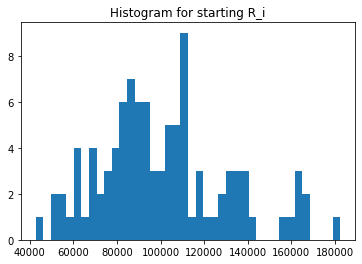

In [22]:
import matplotlib.pyplot as plt
a = starting_Ri.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_i")
plt.show()

In [23]:
experiments.UNI_Qi.unique()

array([234991.00271916, 322772.87719685, 321772.87719685, ...,
       134475.60537311, 136475.60537311, 135475.60537311])

In [24]:
experiments.UNI_Si.unique()

array([10000., 15740., 16223., 15586., 14551., 13730., 14484., 17474.,
       14630., 13818., 15172., 12785., 14304., 14961., 16225., 16780.,
       15466., 15034., 15745., 15422., 18316., 13126., 20255., 17466.,
       14962., 15484., 16179., 13695., 16045., 16593., 13783., 19252.,
       14591., 15379., 14641., 14026., 14756., 14863., 16056., 16633.,
       13610., 16074., 15694., 16668., 18469., 14216., 17651., 13930.,
       16148., 14824., 13628., 17196., 13171., 16090., 17989., 14654.,
       15857., 16499., 19978., 14698., 16025., 16429., 14262., 13071.,
       13957., 13030., 14545., 14644., 15984., 14707., 13687., 15721.,
       15946., 14584., 14182., 15540., 22247., 13096., 13887., 14399.,
       15392., 15568., 14954., 15091., 13063., 15236., 13281., 16216.,
       17282., 14616., 14970., 18426., 19133., 17805., 16983., 18094.,
       13943., 15967., 15248., 19735., 15479., 15680., 16823., 15211.,
       15660., 16194., 15274., 14601., 19330., 13674., 15940., 13902.,
      

In [25]:
experiments.UNI_Qj.unique()

array([126330.07812691, 268252.16996651, 267252.16996651, ...,
       275239.69298769, 276239.69298769, 277239.69298769])

In [26]:
experiments.UNI_Rj.unique()

array([ 63165.03906345, 101466.08498325, 101844.08498325, ...,
        88199.84649385,  87881.84649385,  87565.84649385])

In [27]:
starting_Rj = experiments[experiments.timestep == 0]
starting_Rj = starting_Rj['UNI_Rj']
starting_Rj.reset_index(drop=True)
starting_Rj.unique()

array([ 63165.03906345,  84923.05324348, 116626.08498325,  75712.47751304,
       132046.10051326,  83208.87345698,  67930.26018656, 103287.49423241,
        79304.65485187,  70835.0546442 ,  86507.80377551,  60451.16988137,
       183238.25473686, 102250.45421452, 157670.46393556,  66740.52171809,
        74439.70910161, 129108.38140364,  63442.84106905, 129273.91133498,
       145655.17633366, 203603.89426884, 123752.39939971,  72504.54004228,
       122517.9231894 , 120984.18084661,  72878.63247634,  61158.05716419,
       107196.4876564 , 110119.84649385, 116603.55162645,  59346.46919369,
       108470.5137288 , 107662.57745148, 152850.35527864, 128888.06274238,
       126081.64059932,  65141.34294745,  66931.17378188,  93003.37329919,
       106176.31014314, 118461.57947979, 108801.62628614, 107830.23309029,
       165383.63001383,  75967.60527887,  77550.68873137,  74197.58905611,
       109980.09712264,  70637.8515887 , 116953.60063319, 111902.14637153,
       130220.87599479,  

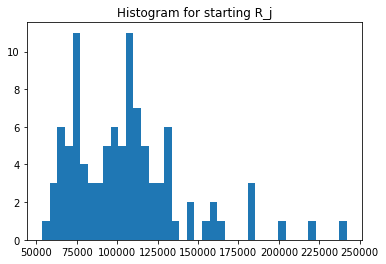

In [28]:
a = starting_Rj.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_j")
plt.show()

In [29]:
experiments.UNI_Sj.unique()

array([10000], dtype=int64)

In [30]:
experiments.UNI_ij.unique()

array([117495.50135958,  90450.43859842,  82286.50855935,  90966.24299436,
       112290.1753212 , 103201.2395389 , 136945.82644319, 112969.63603961,
       111351.95223329,  68824.92112422, 135294.92838467, 118128.51273943,
        99562.84804397, 182437.27830573,  76154.65308934,  82257.98971196,
        92933.55858926,  94151.63401275, 102216.11620354,  89910.38007817,
        52458.35073539,  62973.06639424,  79621.8676403 , 160920.31283036,
        69829.86392356, 103666.06970946,  93117.88422135, 137252.89254509,
        83802.88617593,  85595.58086518,  86112.1172684 , 139745.82756865,
        70940.73323924, 134599.42759769,  56424.30268655, 111799.40341522,
        96315.72342097, 111092.75954931, 127086.90640676,  84516.21258366,
       106598.552709  , 105720.10723748,  84970.44067322,  76917.92516885,
        79163.38693247, 140935.80428436,  90688.81949993,  61883.43441018,
       121962.7820952 , 161561.20028609,  84201.59076479,  67282.02216372,
       130603.02513683, 1

In [31]:
experiments.UNI_ji.unique()

array([ 63165.03906345, 116626.08498325, 103287.49423241,  84923.05324348,
        75712.47751304,  86507.80377551, 132046.10051326,  83208.87345698,
        67930.26018656,  72504.54004228,  79304.65485187,  61158.05716419,
        70835.0546442 , 102250.45421452, 183238.25473686,  60451.16988137,
        74439.70910161, 129108.38140364, 157670.46393556,  66740.52171809,
       241801.61985332,  63442.84106905, 107196.4876564 , 129273.91133498,
       145655.17633366, 203603.89426884, 122517.9231894 , 123752.39939971,
       120984.18084661,  72878.63247634,  66931.17378188, 109980.09712264,
       116616.98134039, 116603.55162645, 110119.84649385, 118461.57947979,
        59346.46919369, 108470.5137288 , 107662.57745148, 116953.60063319,
        67063.53371722, 152850.35527864, 126081.64059932,  93003.37329919,
       128888.06274238,  65141.34294745, 106176.31014314, 108801.62628614,
       107830.23309029,  70637.8515887 ,  75967.60527887, 165383.63001383,
        74197.58905611,  

In [32]:
experiments.UNI_Sij.unique()

array([7.42160793e+09, 1.05488805e+10, 8.49916728e+09, 7.72513110e+09,
       8.50176737e+09, 8.92771258e+09, 1.80831624e+10, 9.40007615e+09,
       7.56416709e+09, 4.99011925e+09, 1.07295176e+10, 7.22451033e+09,
       7.05253978e+09, 1.86542946e+10, 1.39544457e+10, 4.97259171e+09,
       6.91794707e+09, 1.21557651e+10, 1.61164625e+10, 6.00066567e+09,
       1.26845142e+10, 3.99519024e+09, 8.53518455e+09, 2.08027983e+10,
       1.01710811e+10, 2.11068155e+10, 1.14086098e+10, 1.69853748e+10,
       1.01388235e+10, 6.23808888e+09, 5.76358509e+09, 1.53692597e+10,
       8.27289416e+09, 1.56947713e+10, 6.21343555e+09, 1.32439339e+10,
       5.71599811e+09, 1.20502887e+10, 1.36825039e+10, 9.88447537e+09,
       7.14887563e+09, 1.61593560e+10, 1.07132126e+10, 7.15362651e+09,
       1.02032156e+10, 9.18074756e+09, 9.62900423e+09, 6.73301830e+09,
       1.31512752e+10, 1.14123361e+10, 6.39659321e+09, 1.11273451e+10,
       9.69042959e+09, 8.29906042e+09, 9.87537959e+09, 8.46150685e+09,
      

In [33]:
def get_M(k, v):
    if k == 'sim_config':
        k, v = 'M', v['M']
    return k, v

config_ids = [
    dict(
        get_M(k, v) for k, v in config.__dict__.items() if k in ['simulation_id', 'run_id', 'sim_config', 'subset_id']
    ) for config in configs
]

# Agent sequences

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


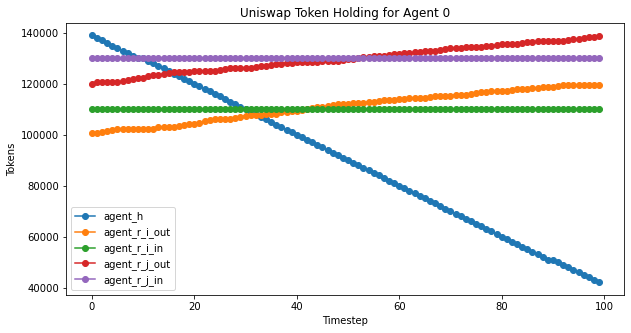

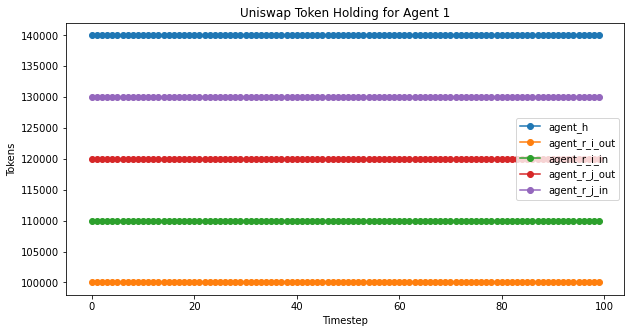

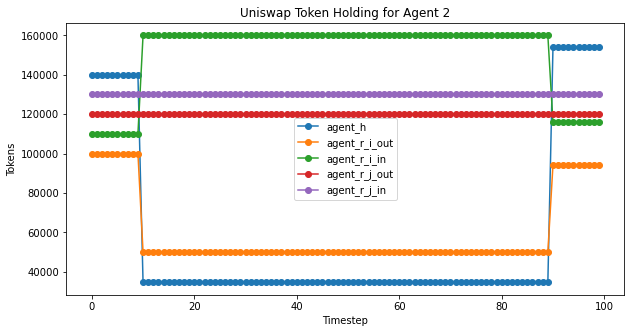

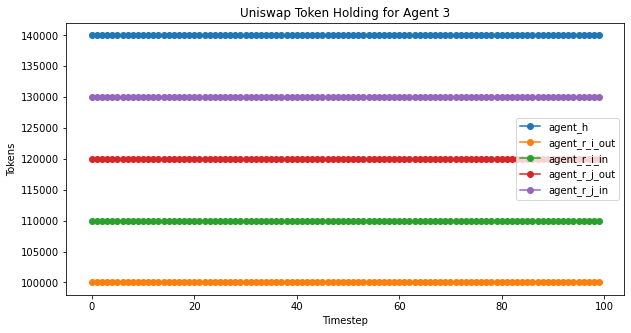

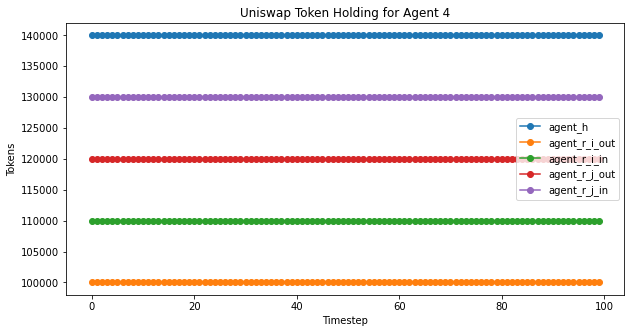

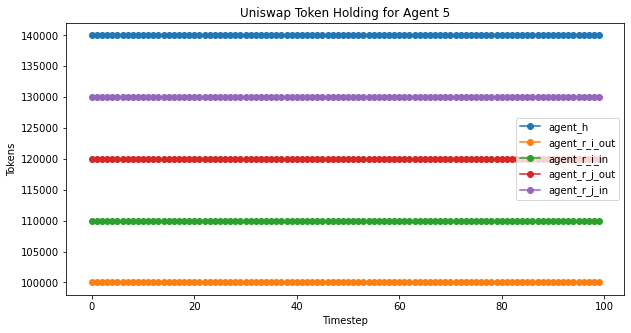

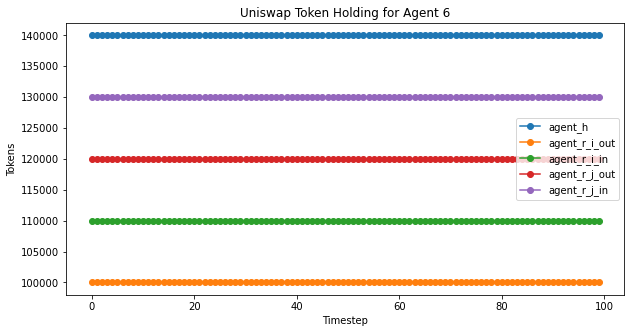

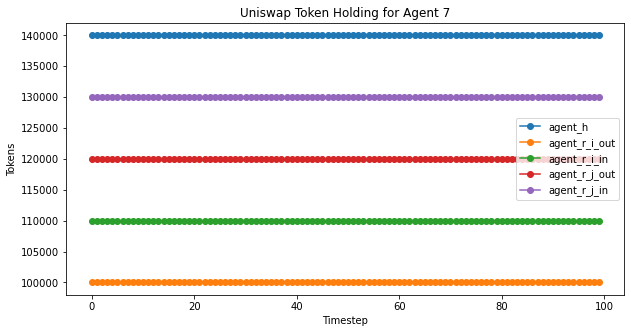

In [34]:
agent_plot(experiment2,'Uniswap Token Holding for Agent ', 100) #,4,'j')

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


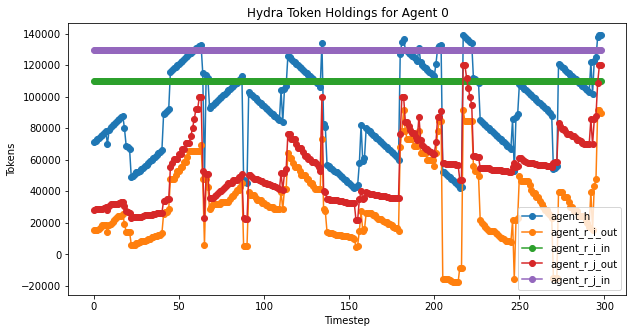

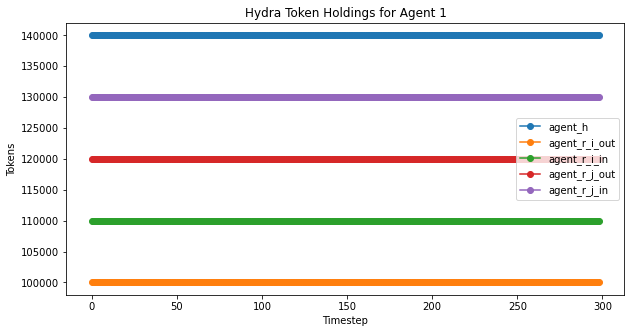

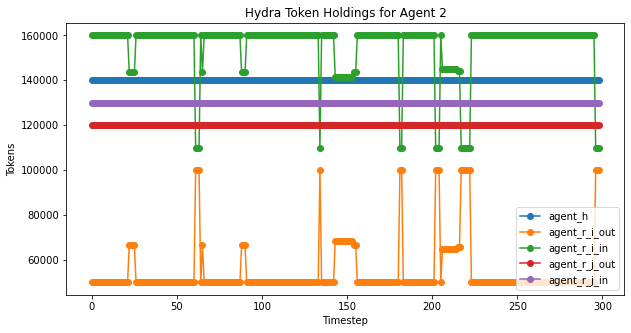

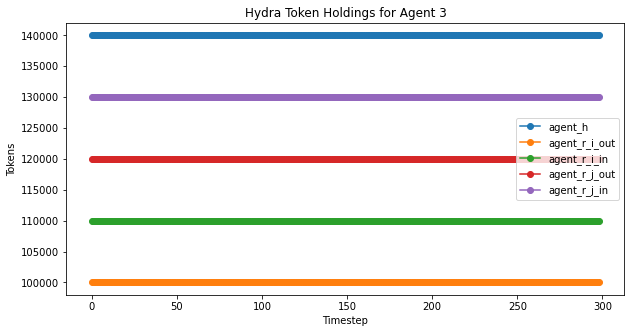

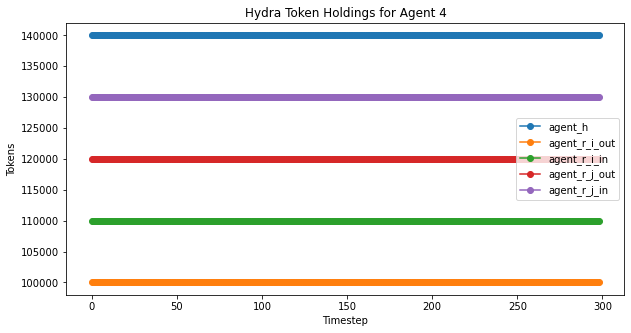

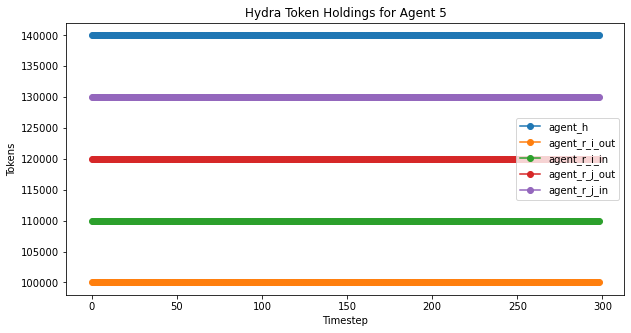

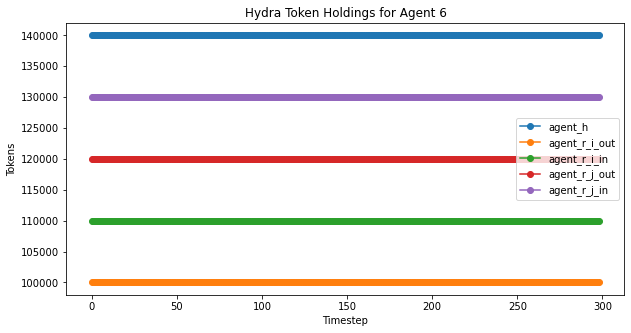

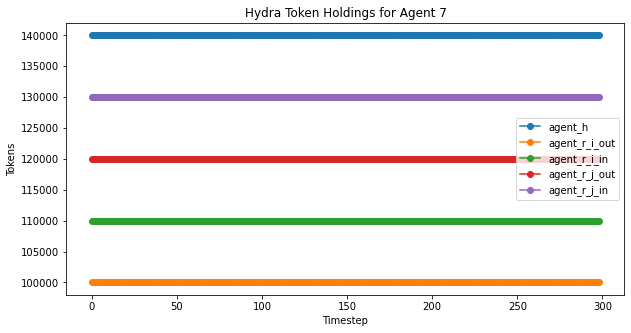

In [35]:
hydra_agent_plot(experiments,'Hydra Token Holdings for Agent ', 299)

# Liquidity dynamics

Movement of the Uniswap variables

- 'UNI_Ri', 'UNI_Qi', 'UNI_Si'
- 'UNI_Rj', 'UNI_Qj', 'UNI_Sj'
- 'UNI_ij', 'UNI_ji', 'UNI_Sij'

## Uniswap -- Ri-Q instance

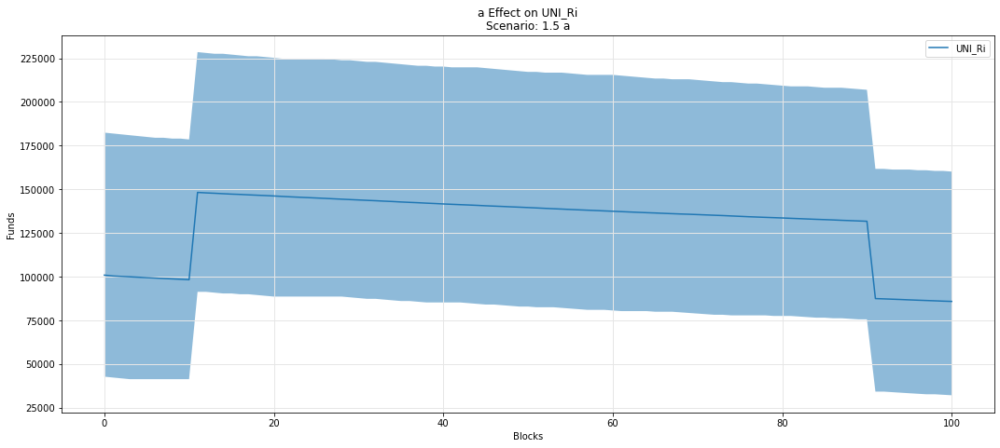

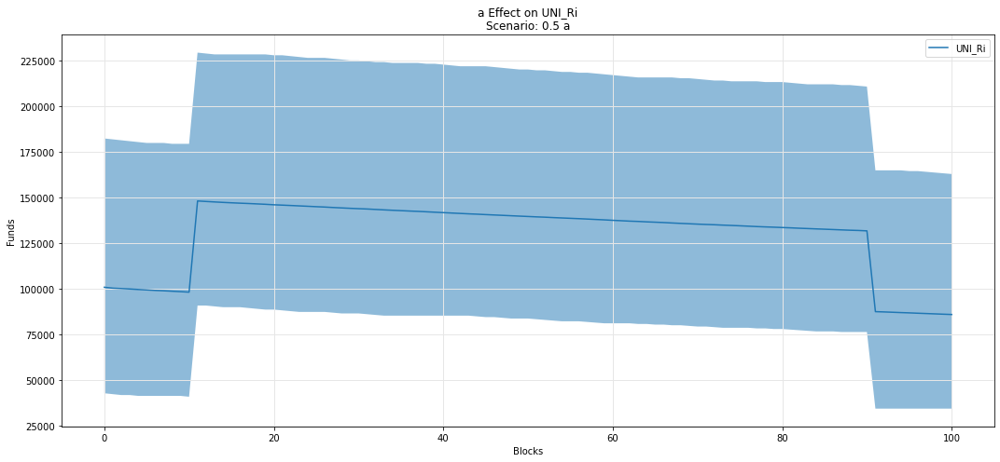

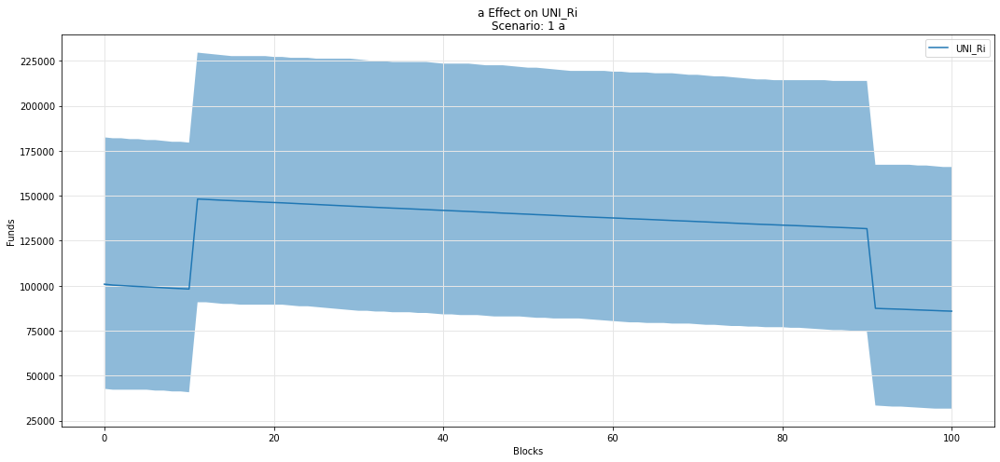

In [36]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Ri')

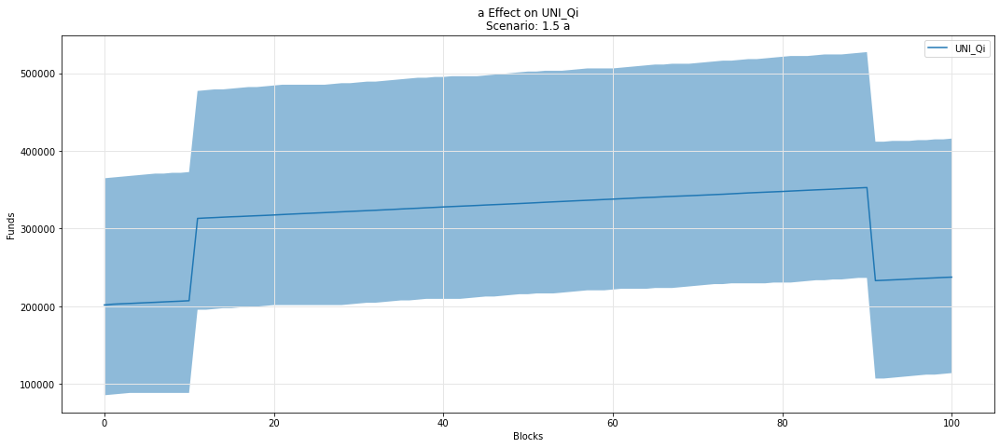

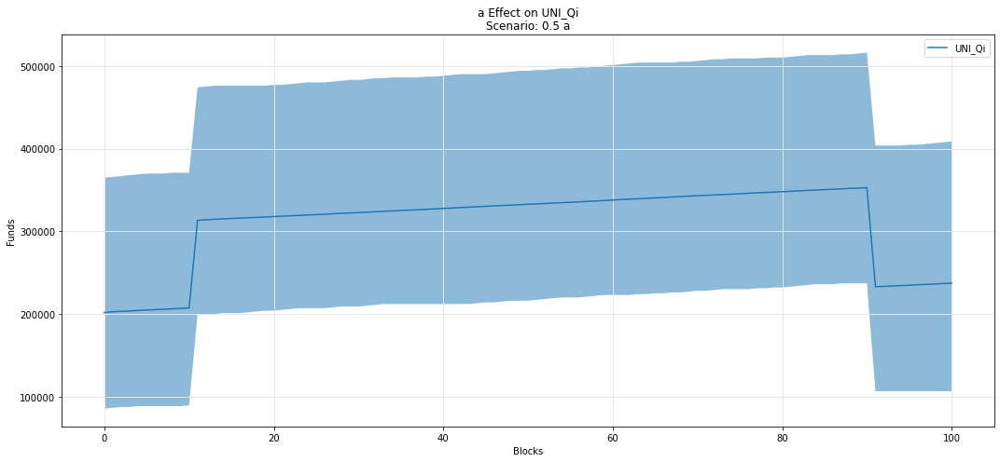

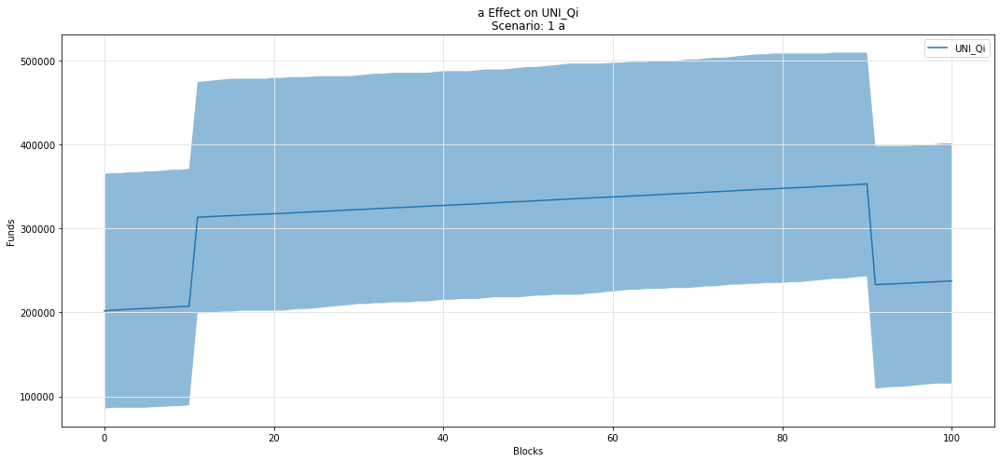

In [37]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qi')

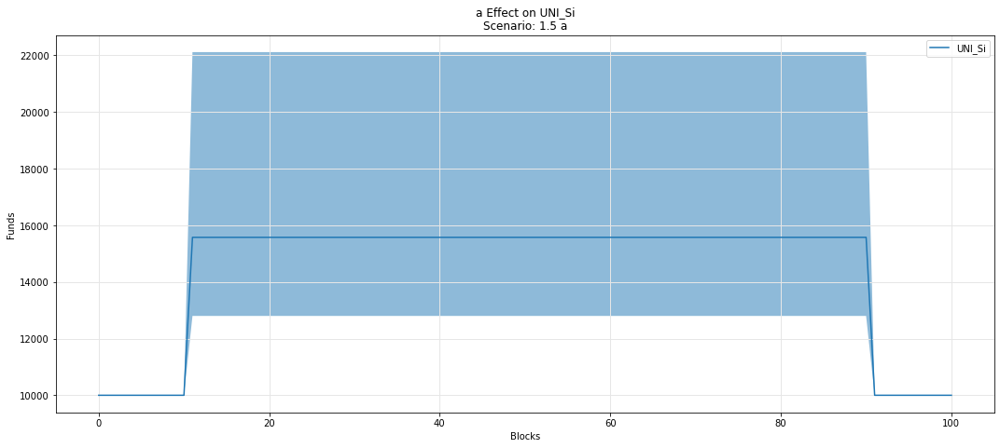

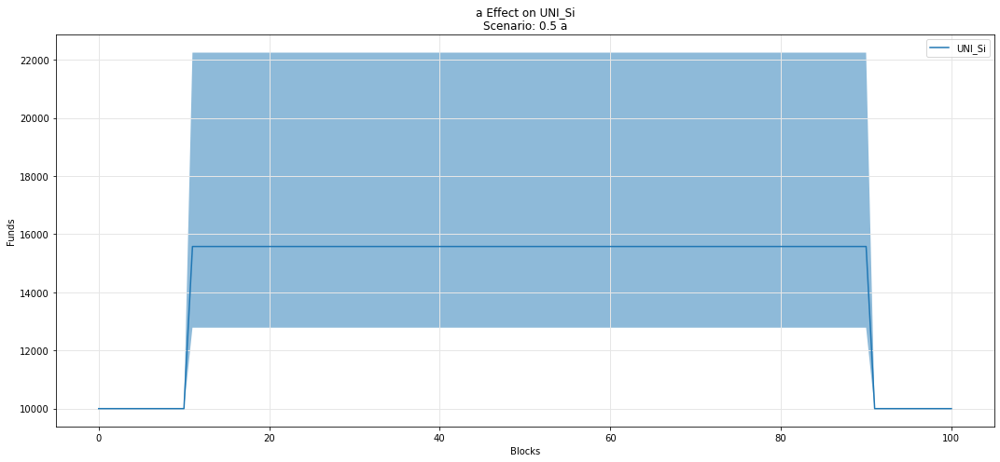

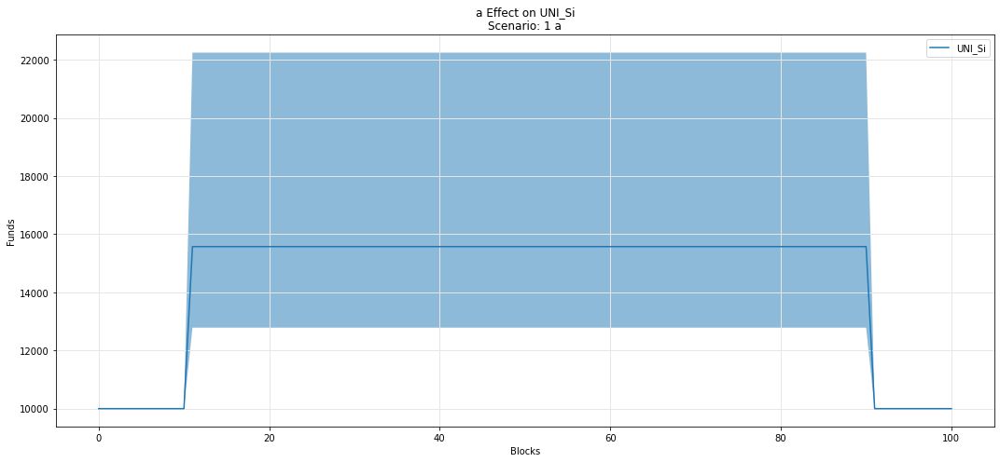

In [38]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Si')

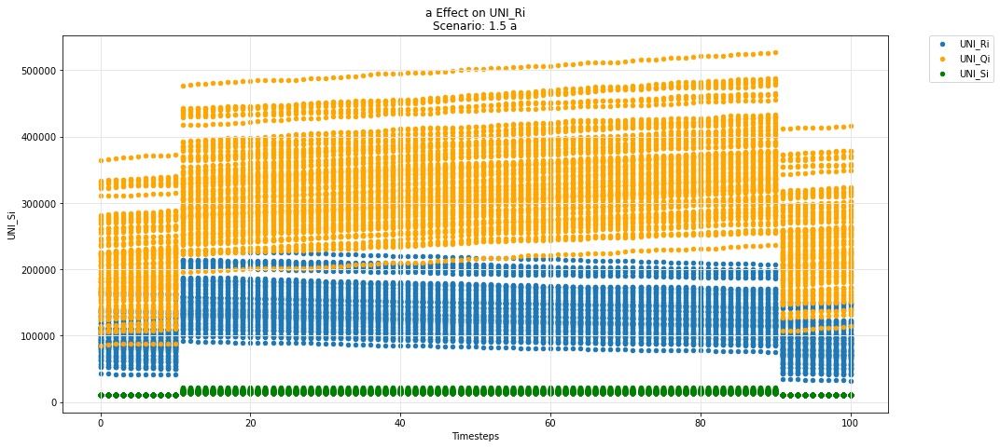

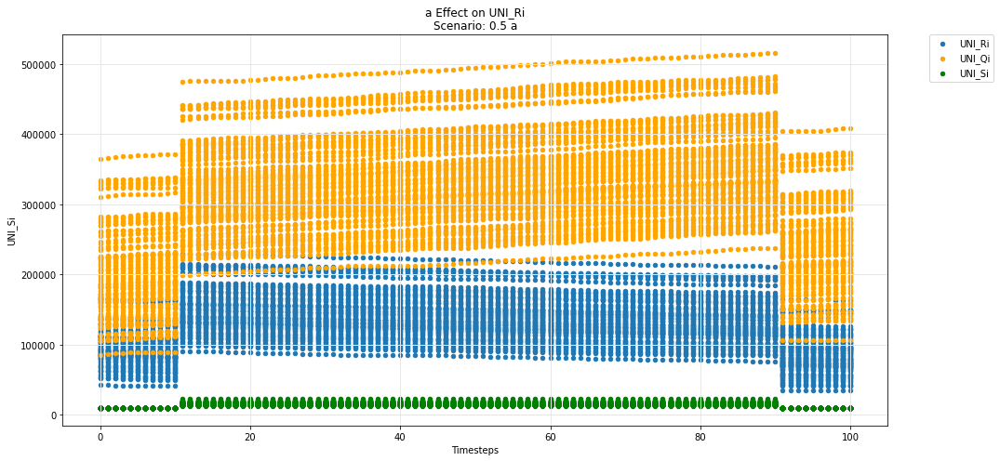

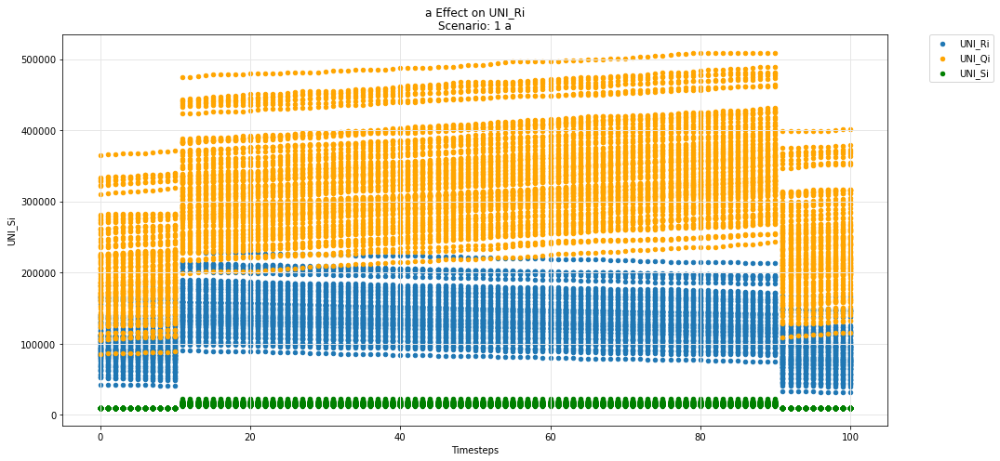

In [39]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Ri', 'UNI_Qi', 'UNI_Si')

## Uniswap -- Rj-Q instance

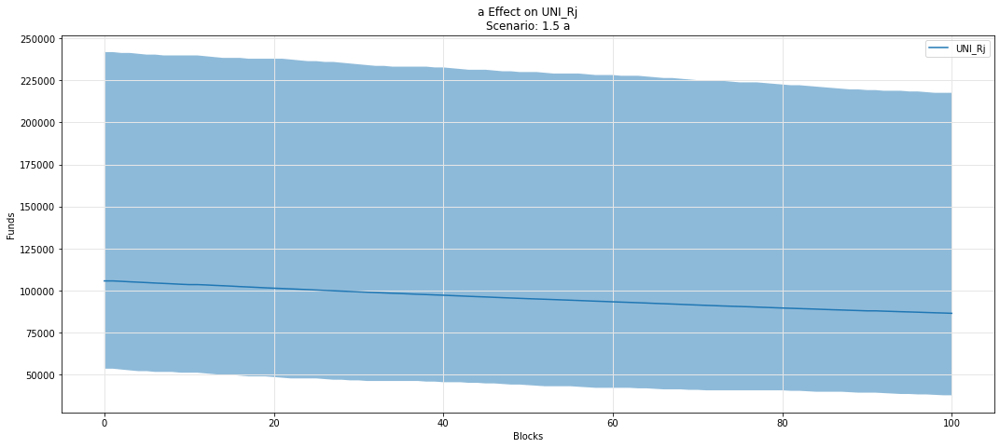

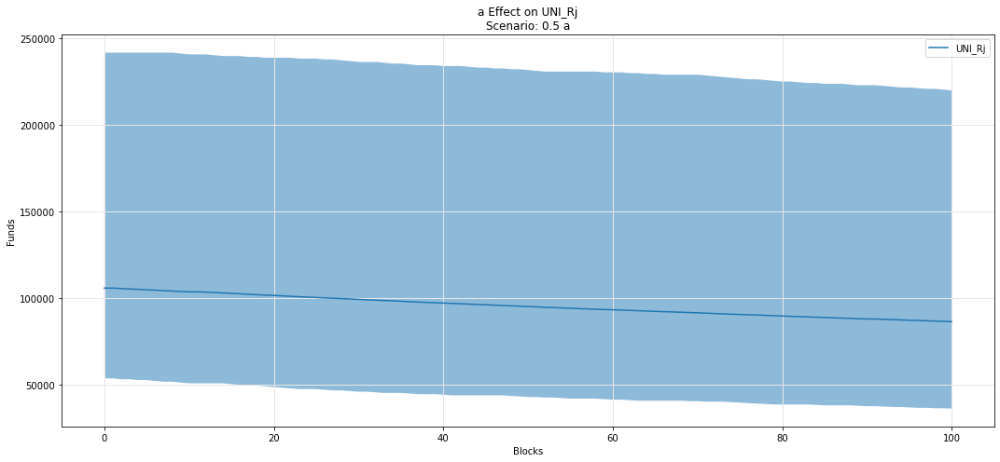

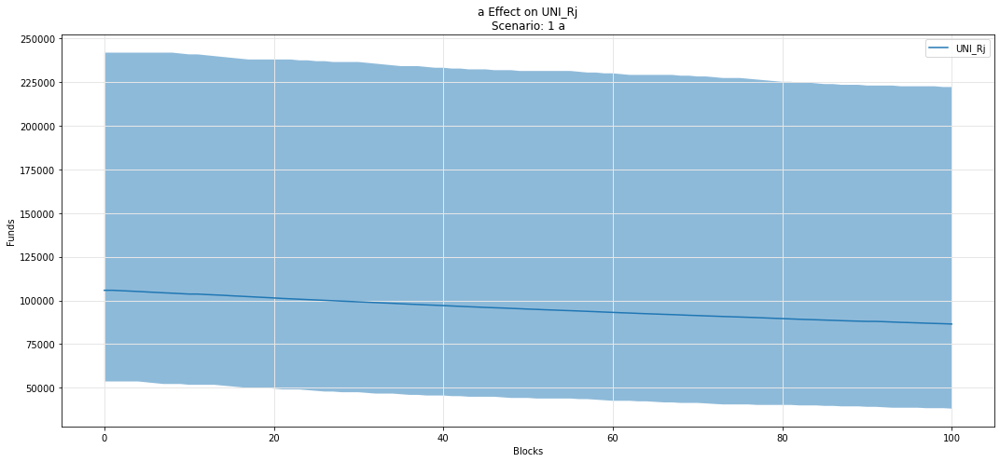

In [40]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Rj')

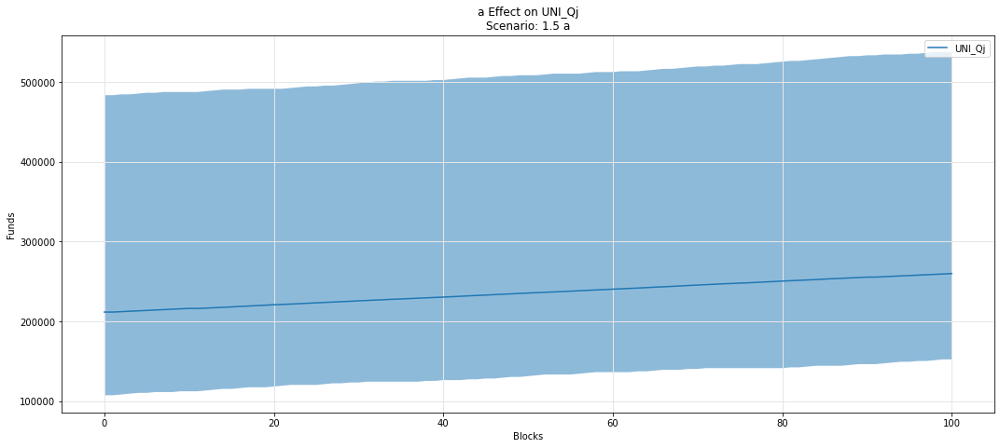

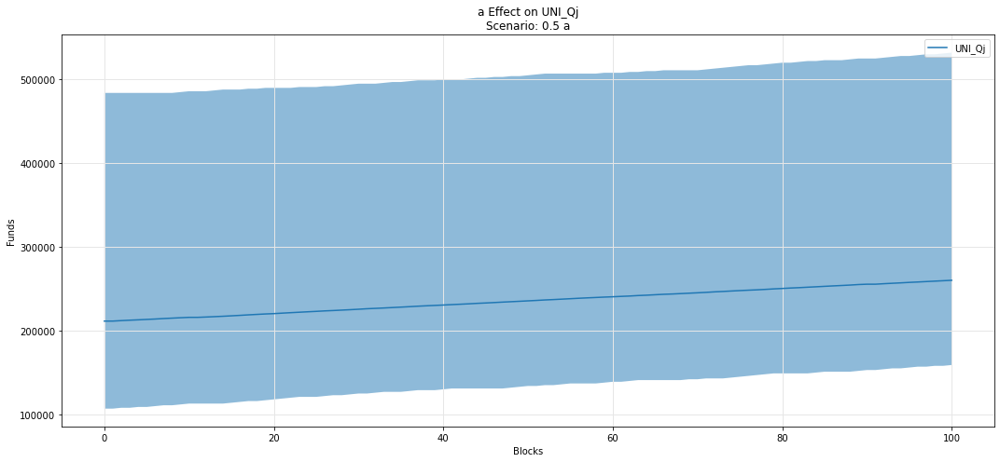

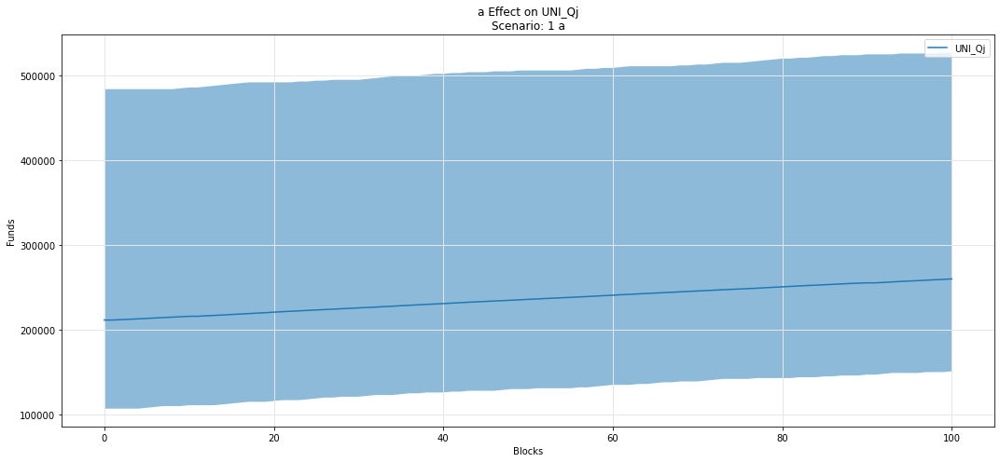

In [41]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qj')

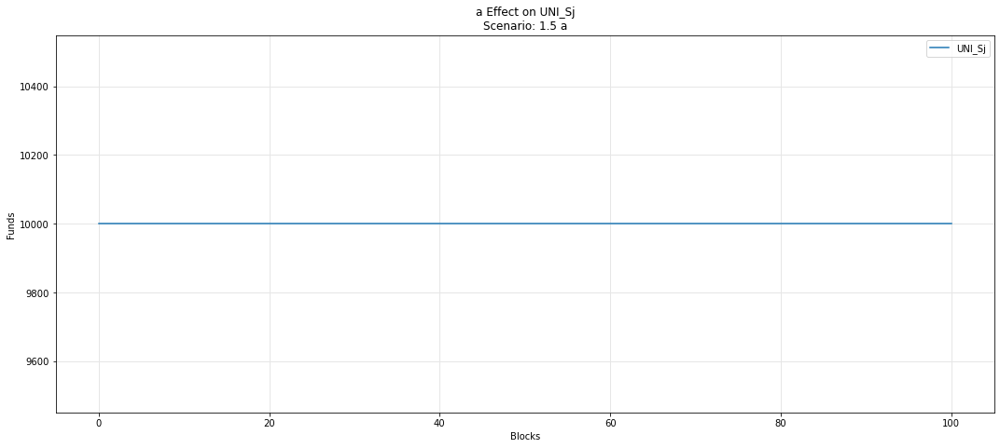

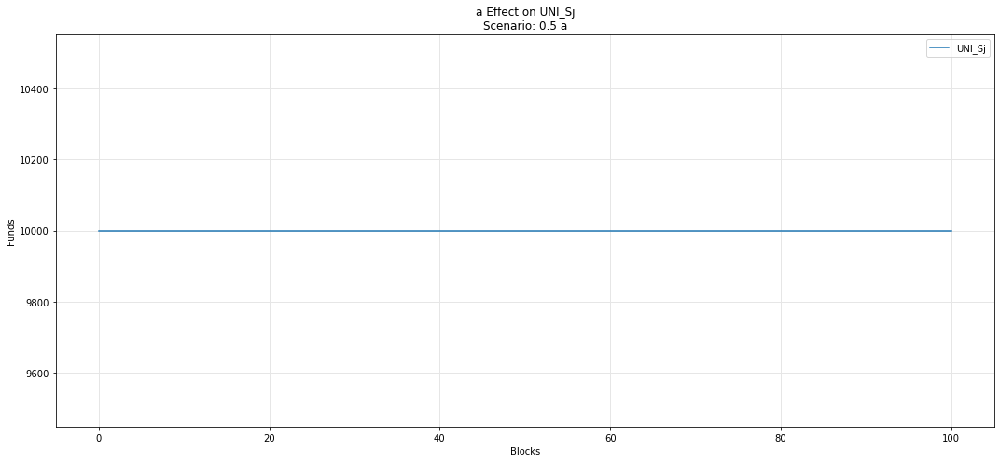

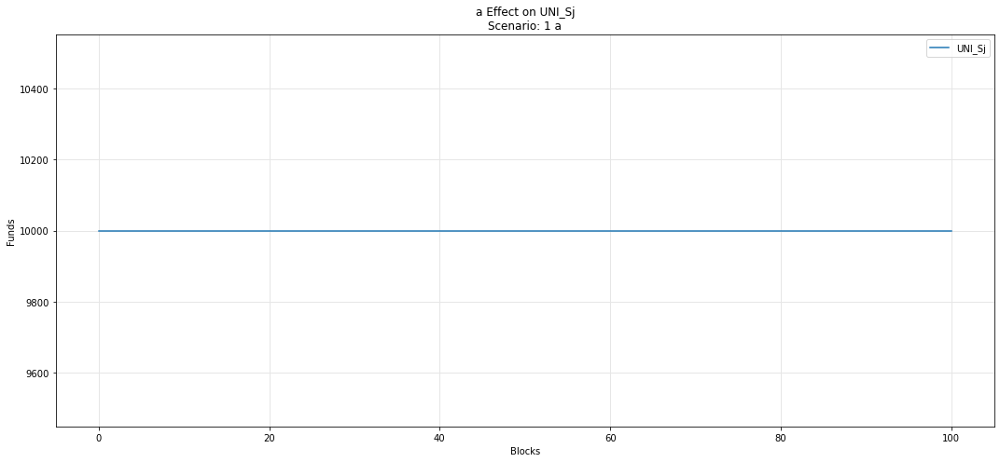

In [42]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sj')

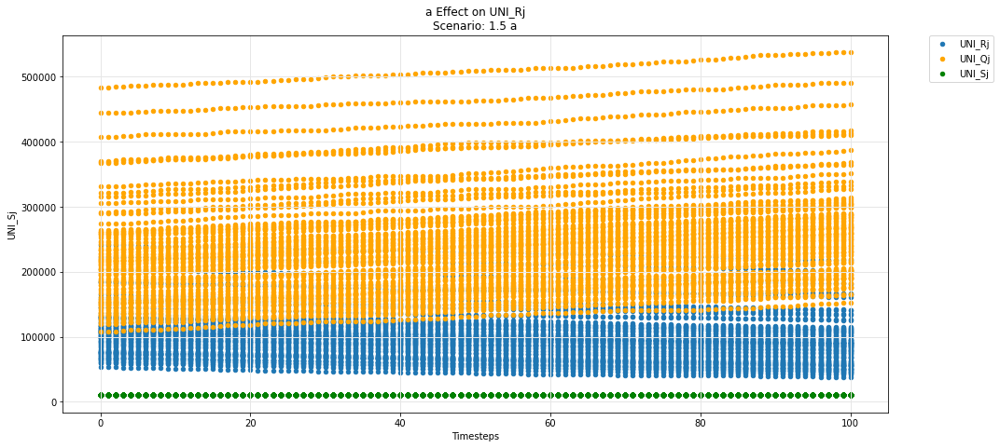

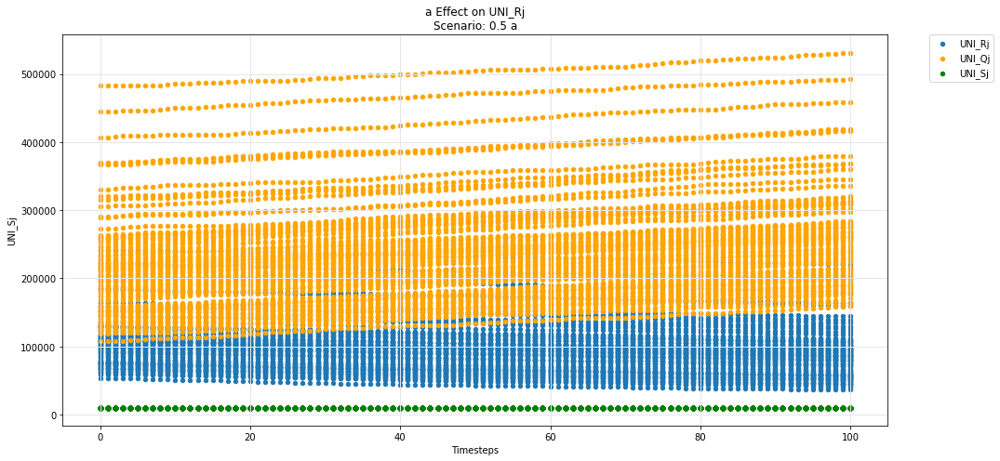

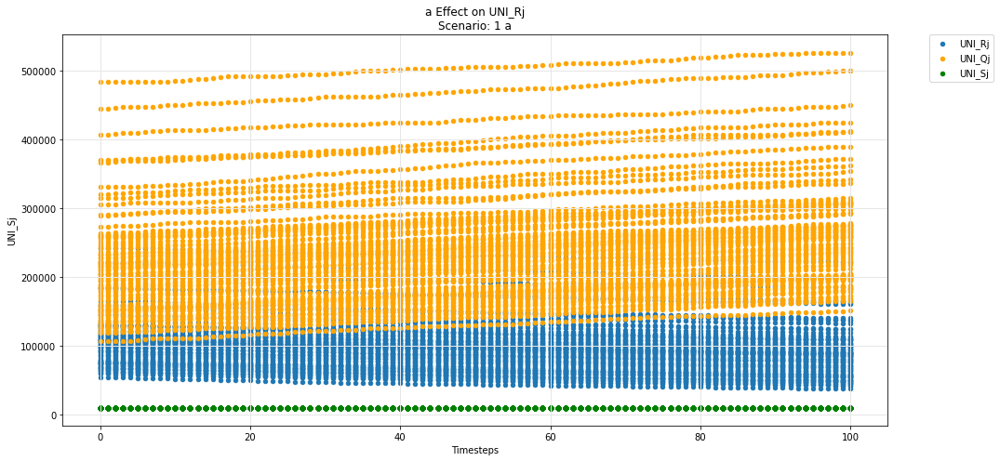

In [43]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Rj', 'UNI_Qj', 'UNI_Sj')

## Uniswap -- ij-Q instance

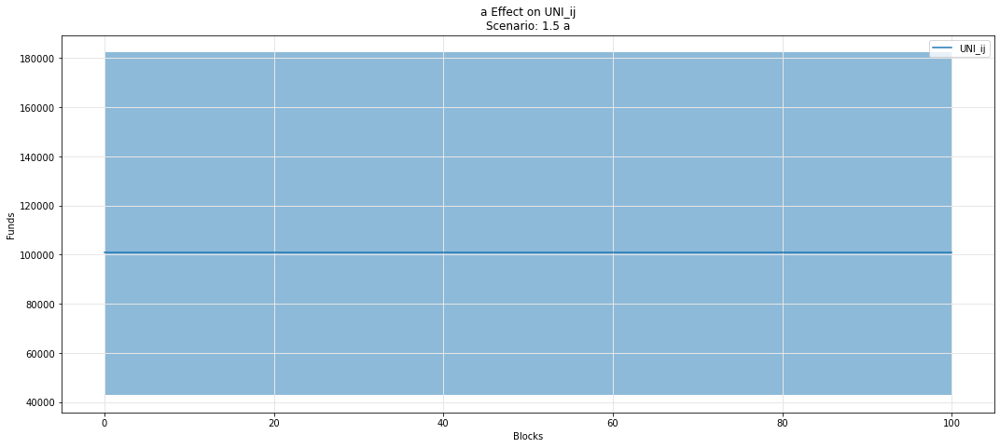

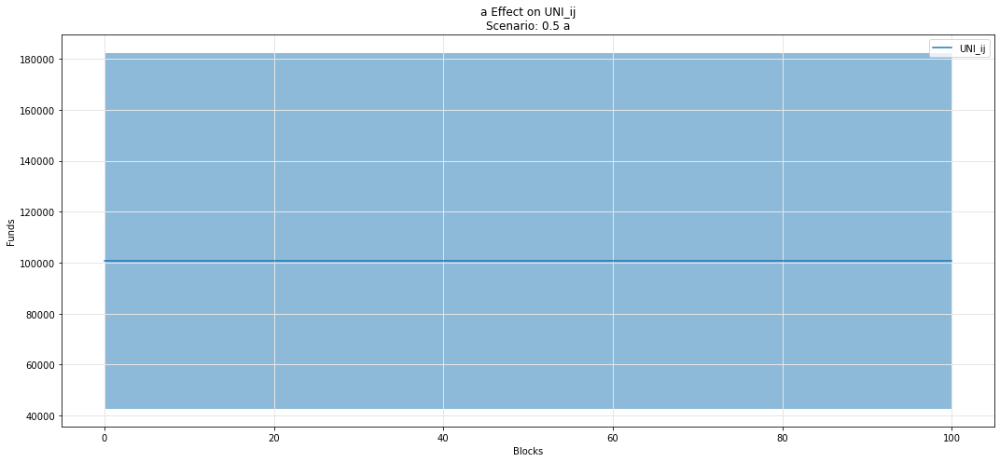

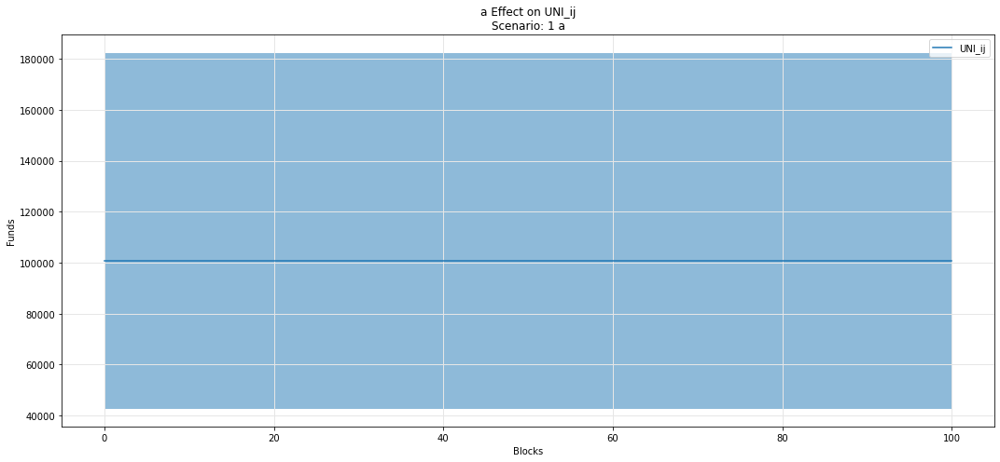

In [44]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ij')

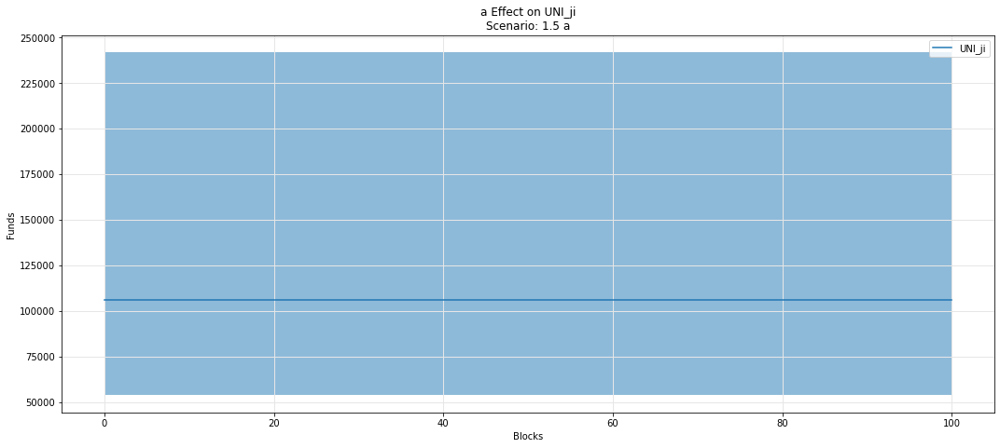

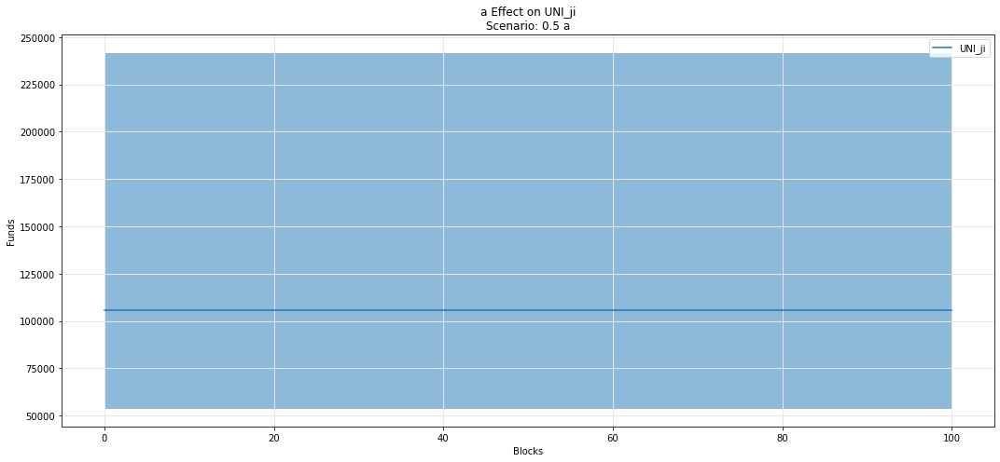

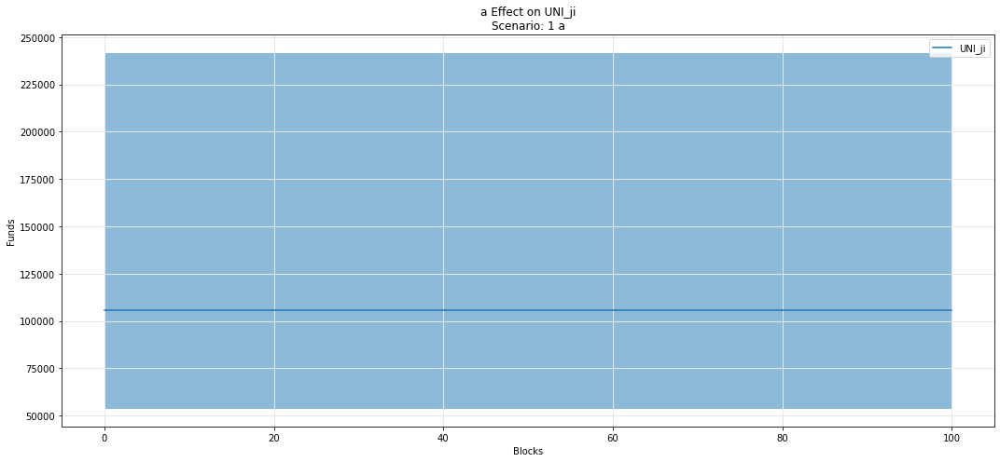

In [45]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ji')

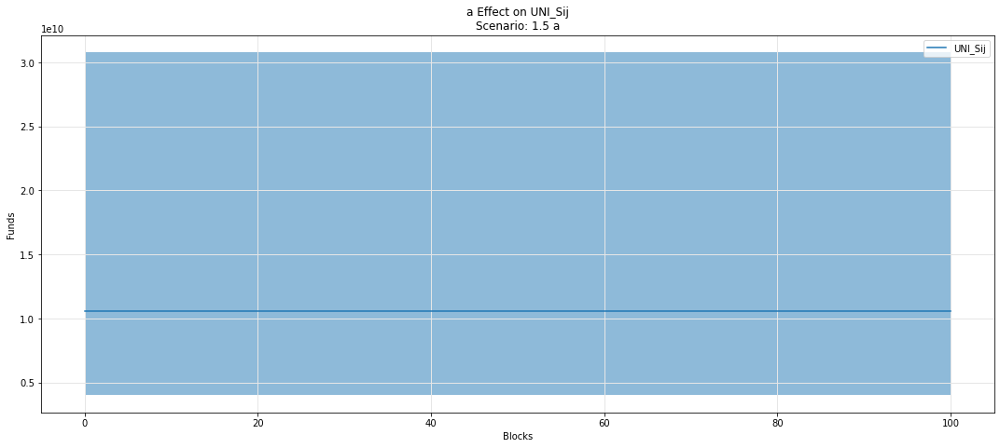

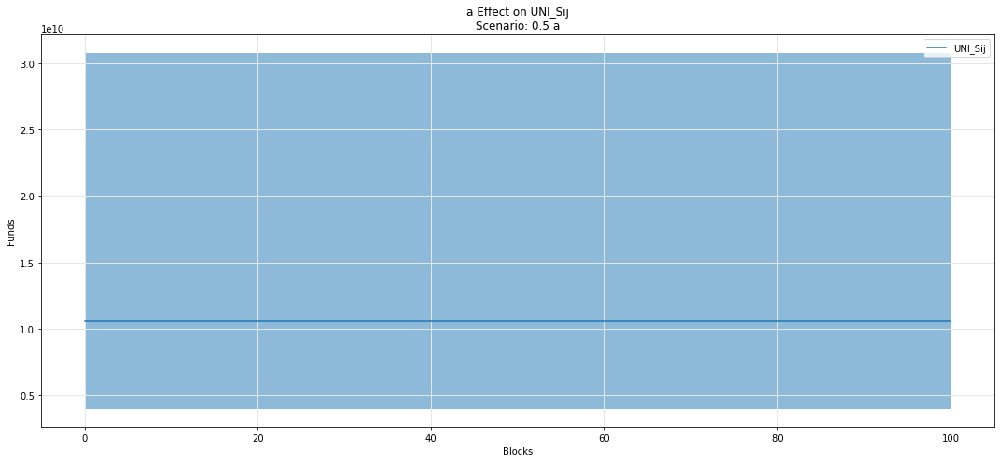

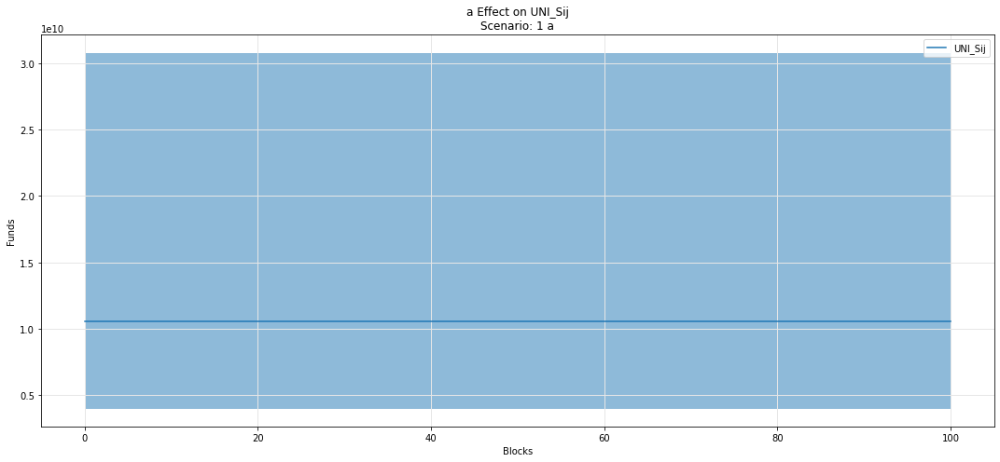

In [46]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sij')

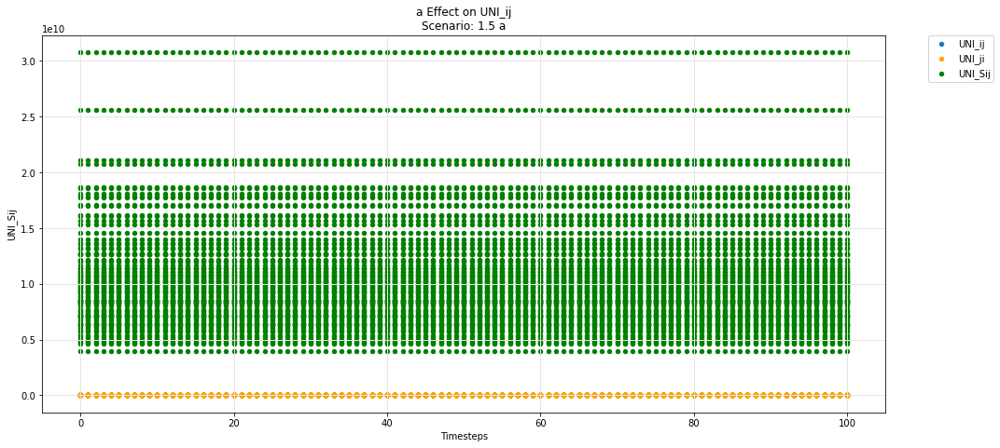

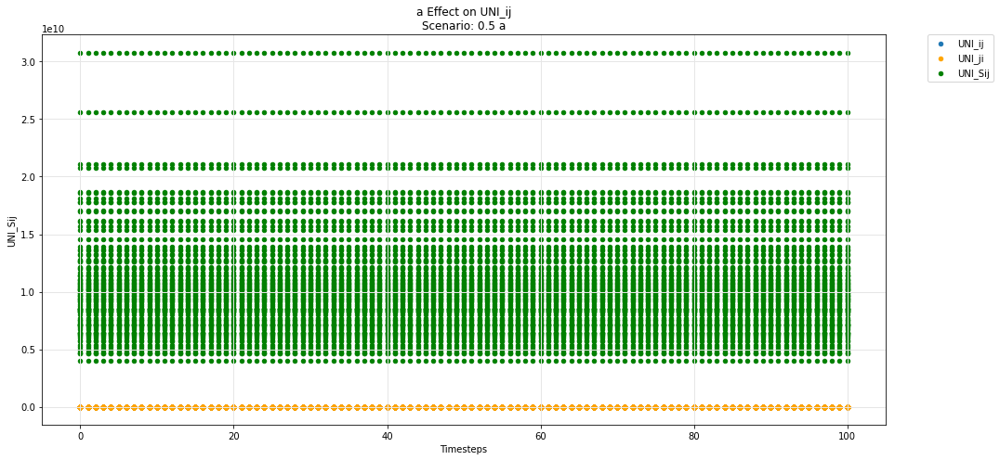

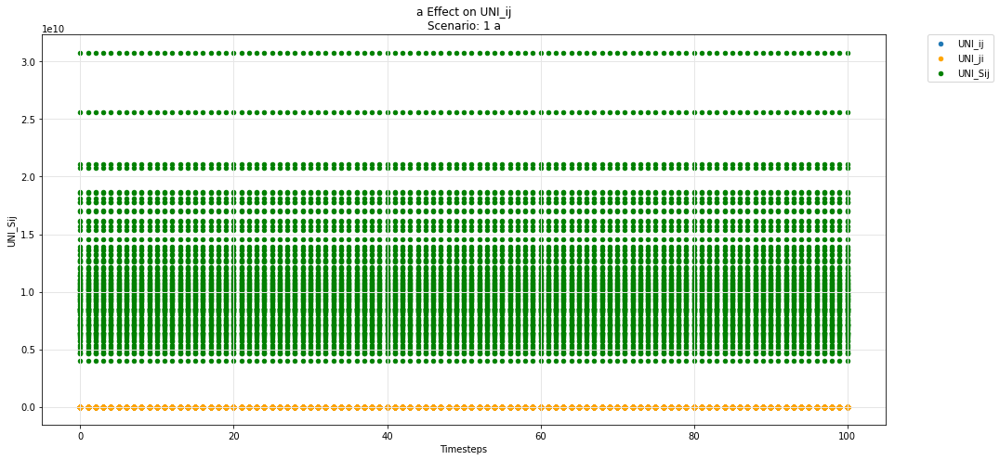

In [47]:
param_test_plot(experiments, config_ids, 'a', 'UNI_ij', 'UNI_ji', 'UNI_Sij')

## Hydra -- base

In [48]:
def param_fan_plot3(experiments, config_ids, swept_variable, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()
        df = df.groupby('timestep').agg({y_variable: ['min', 'mean', 'max']}).reset_index()
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        #plt.ylim(25000, 35000)
        #plt.xlim(9, 11)
        ax = axs
        title = swept_variable + ' Effect on ' + y_variable + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(y_variable,'mean'),label = y_variable, ax=ax, legend=True)

        ax.fill_between(df.timestep, df[(y_variable,'min')], df[(y_variable,'max')], alpha=0.5)        
        ax.set_xlabel('Blocks')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)



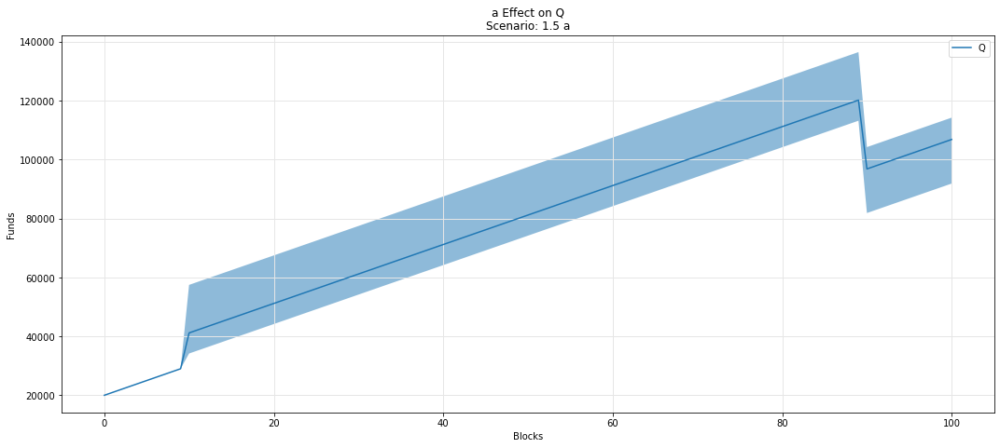

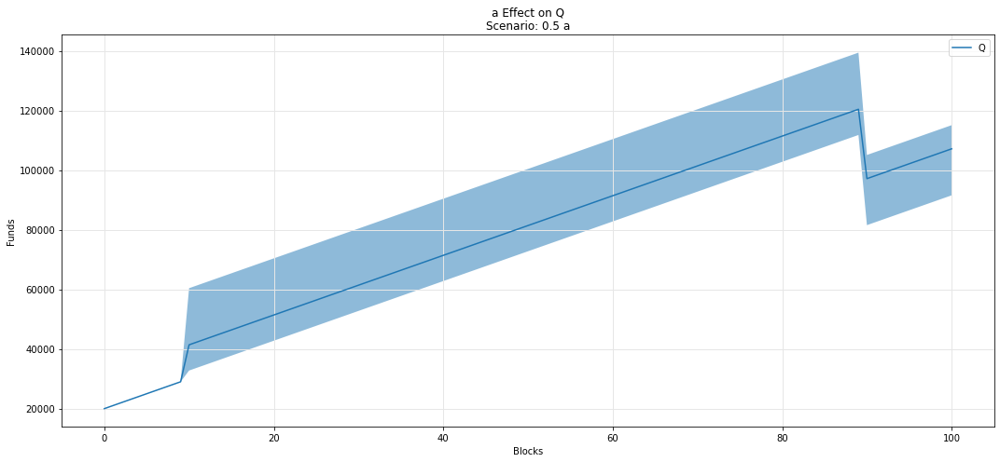

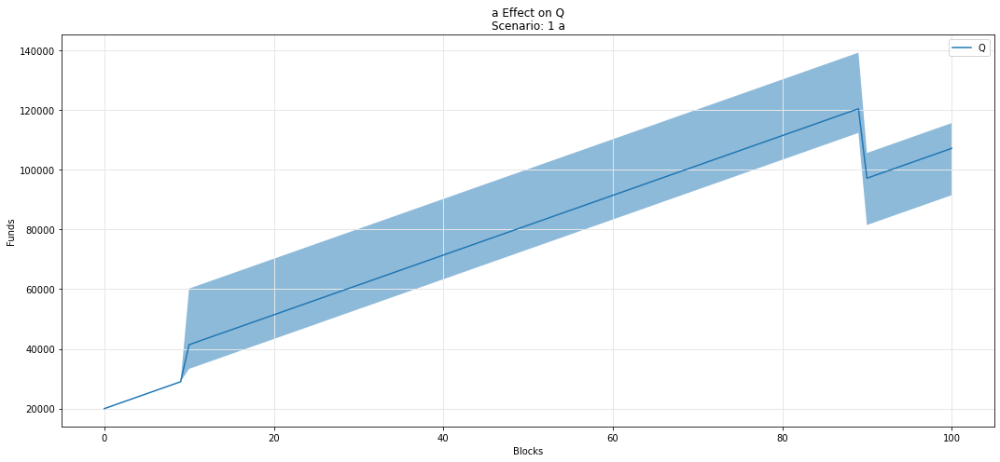

In [49]:
param_fan_plot3(experiments, config_ids, 'a','Q')

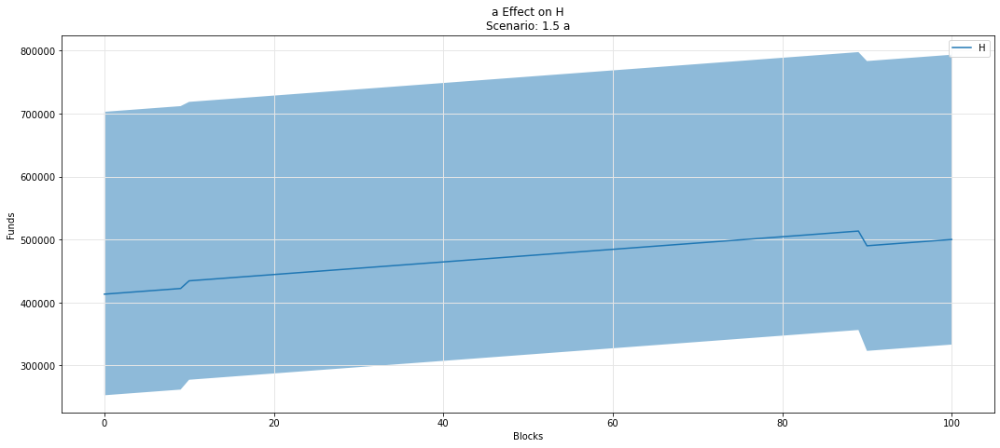

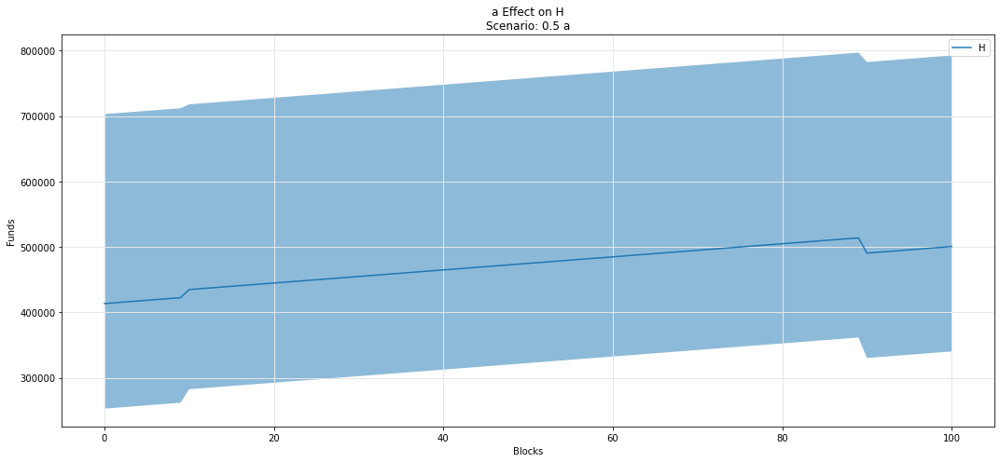

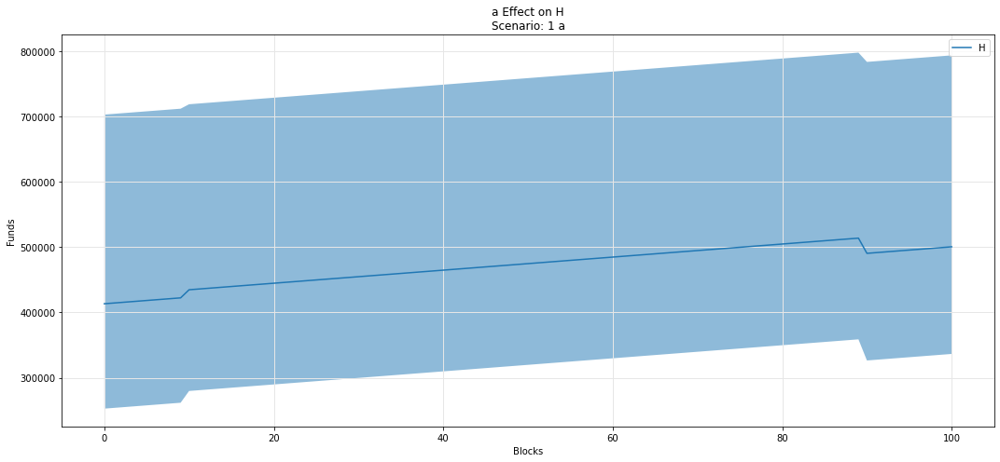

In [50]:
param_fan_plot3(experiments, config_ids, 'a','H')

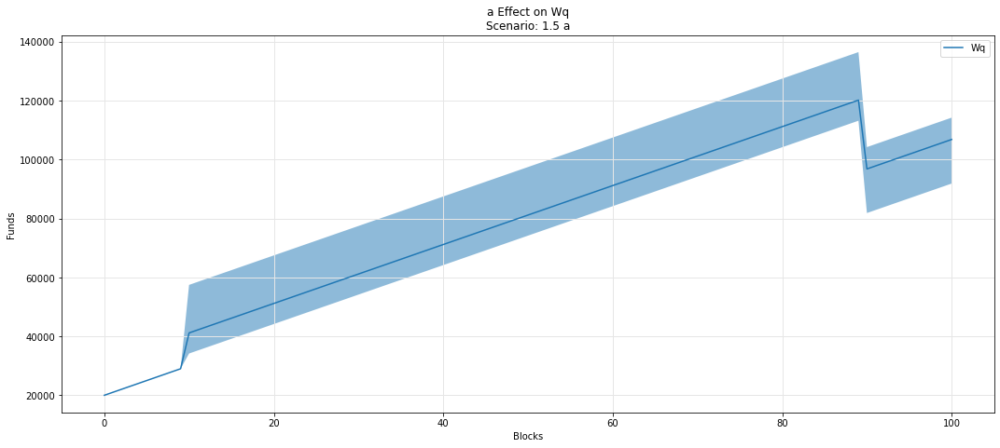

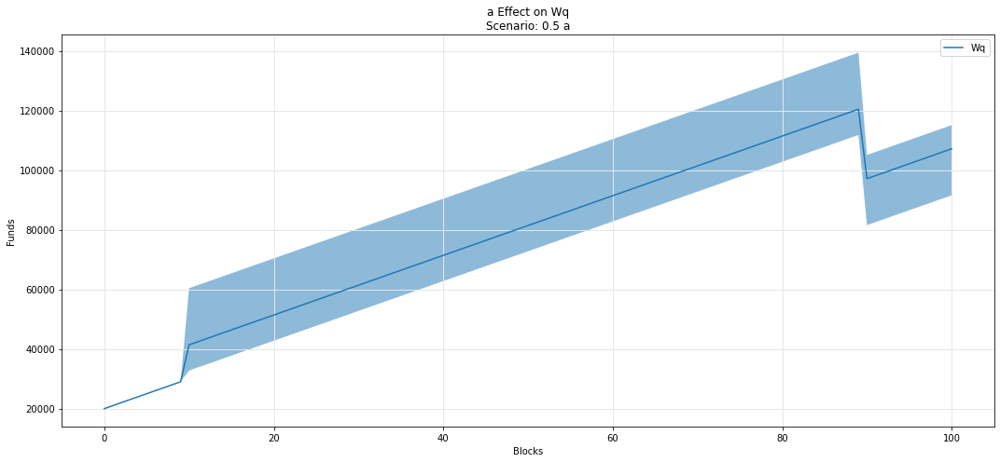

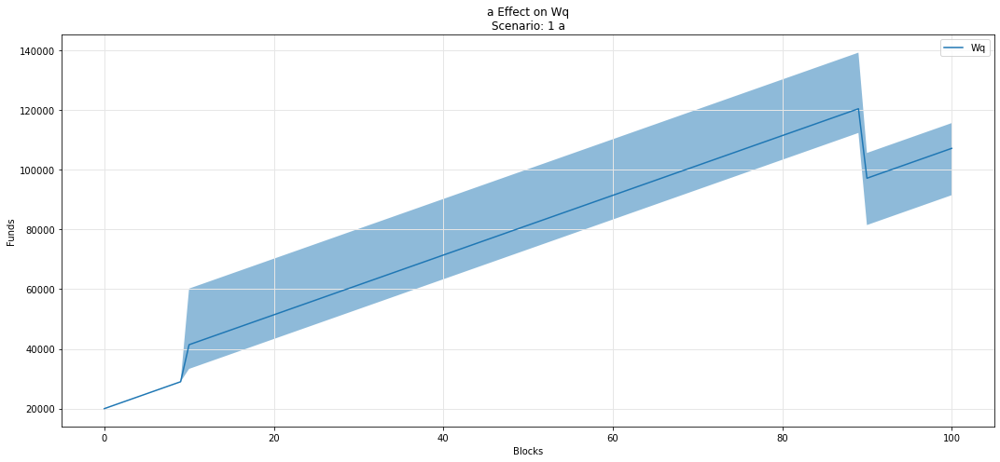

In [51]:
param_fan_plot3(experiments, config_ids, 'a','Wq')

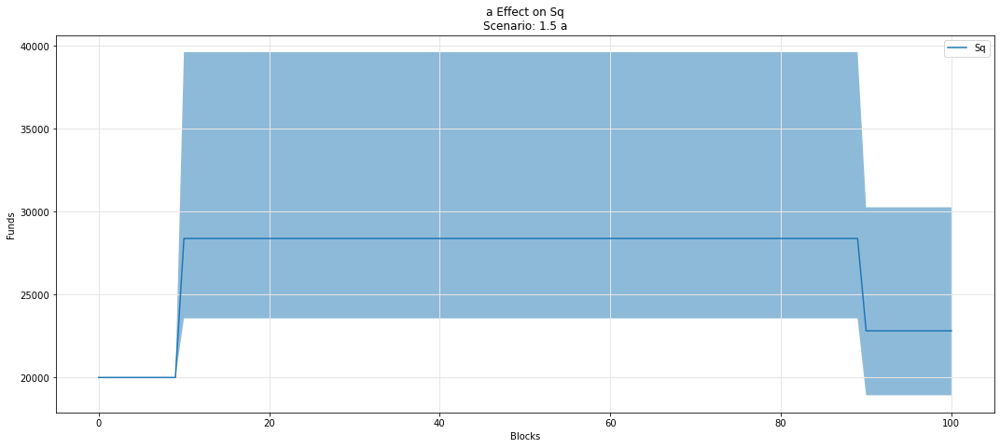

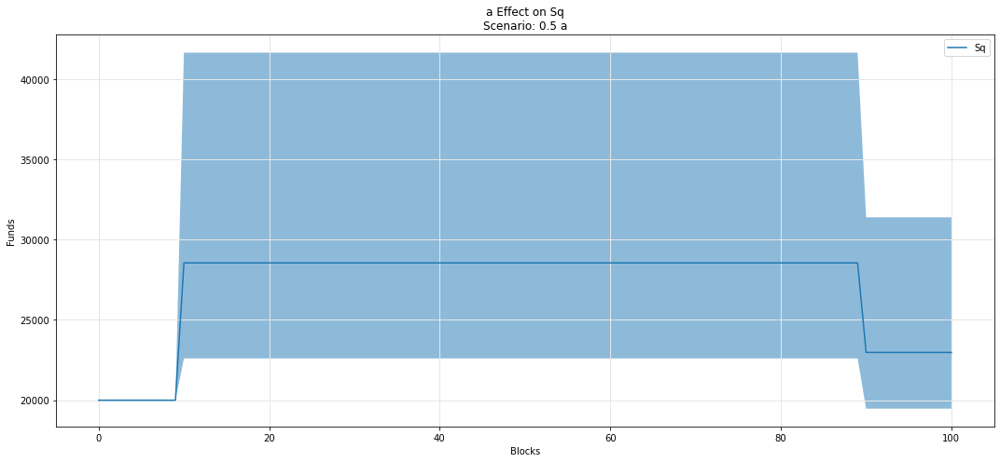

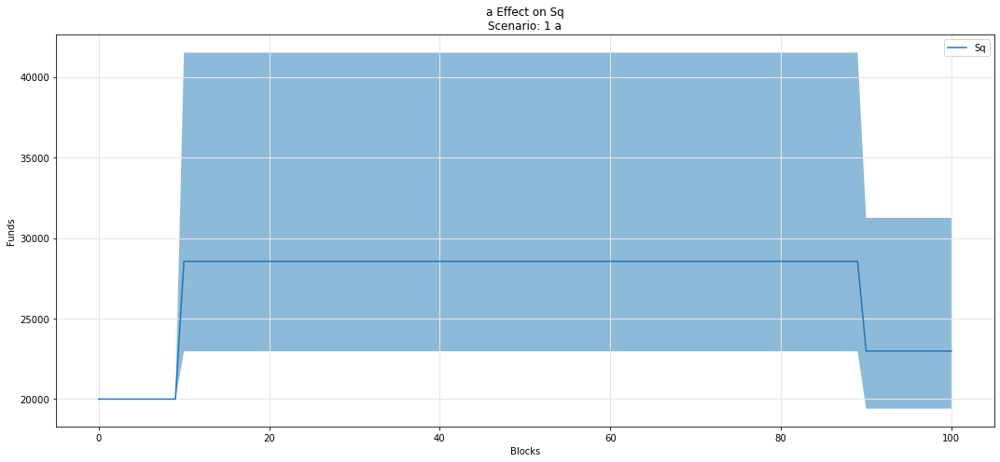

In [52]:
param_fan_plot3(experiments, config_ids, 'a','Sq')

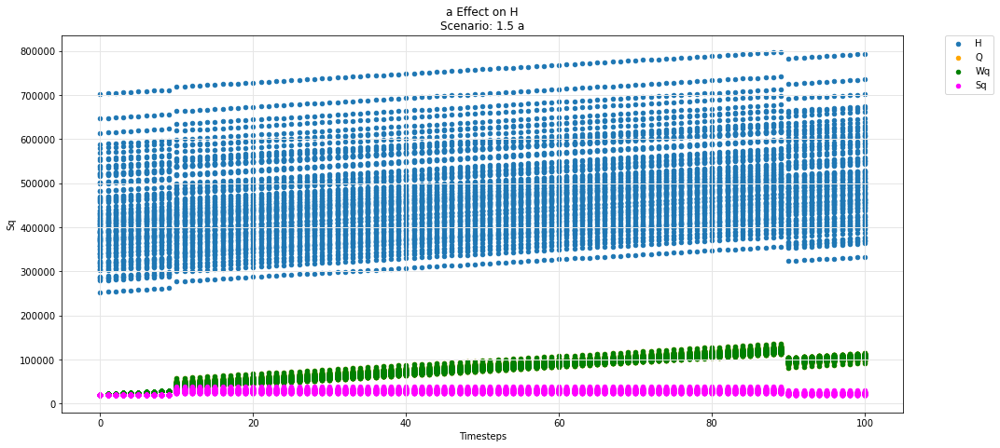

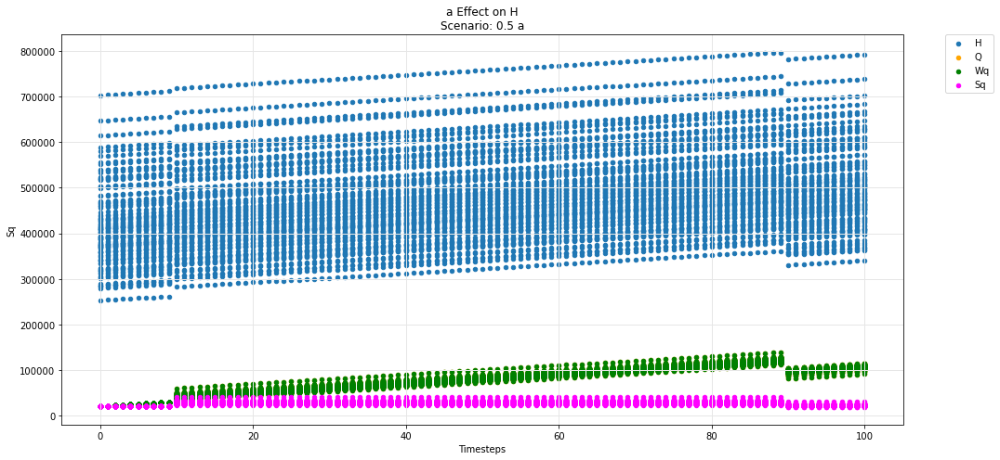

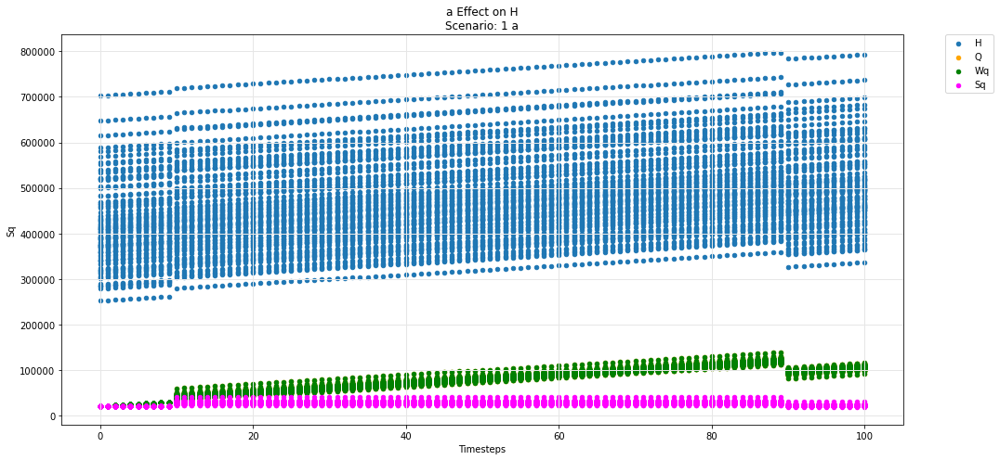

In [53]:
param_test_plot(experiments, config_ids, 'a', 'H', 'Q', 'Wq', 'Sq')

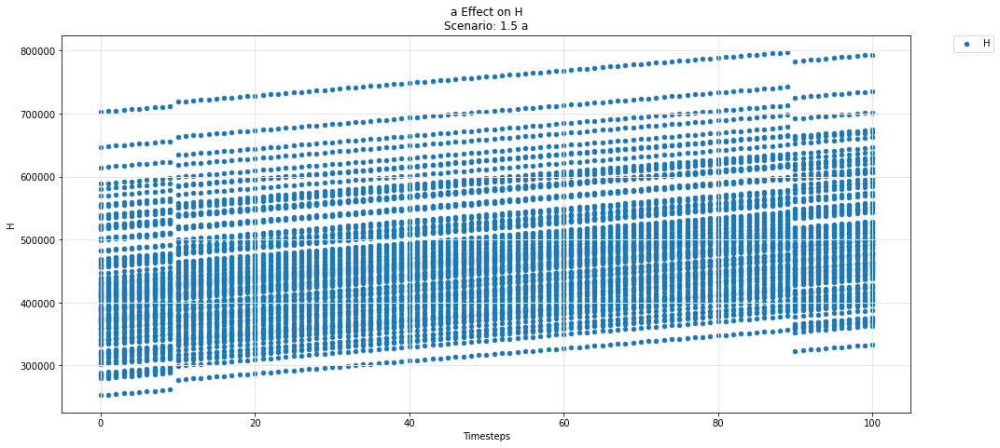

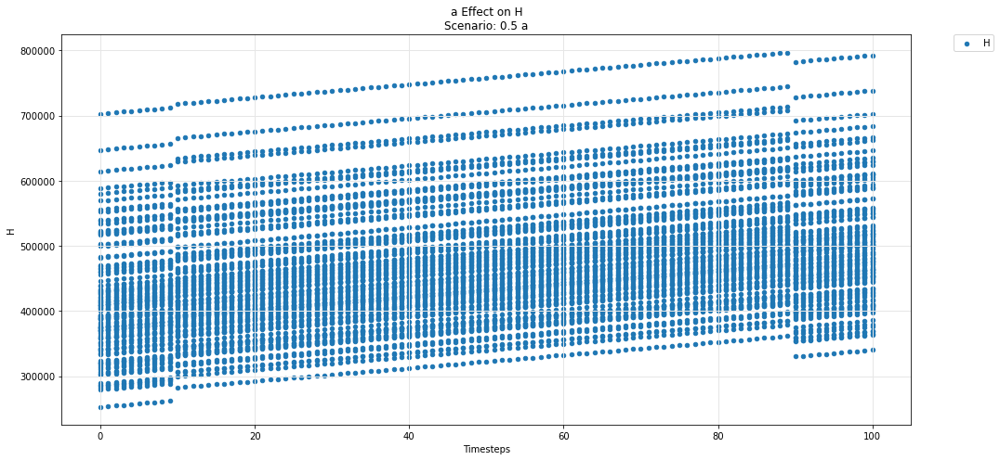

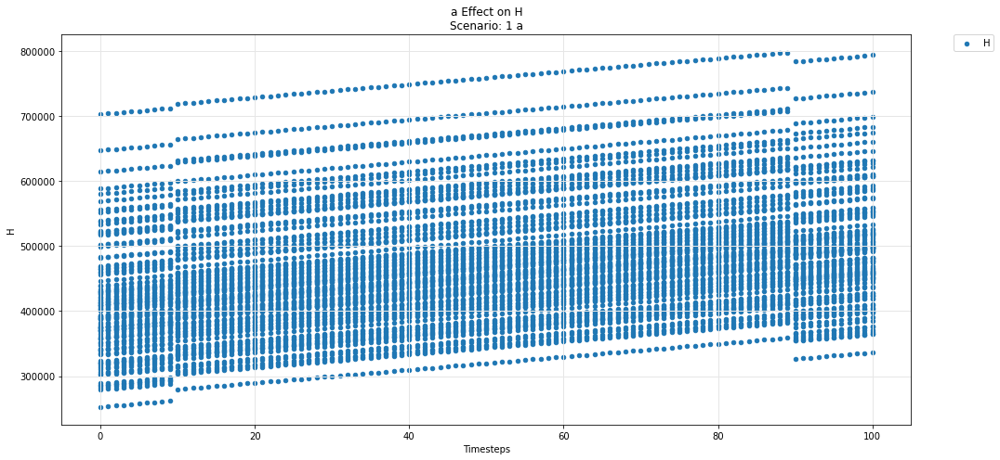

In [54]:
param_test_plot(experiments, config_ids, 'a', 'H')

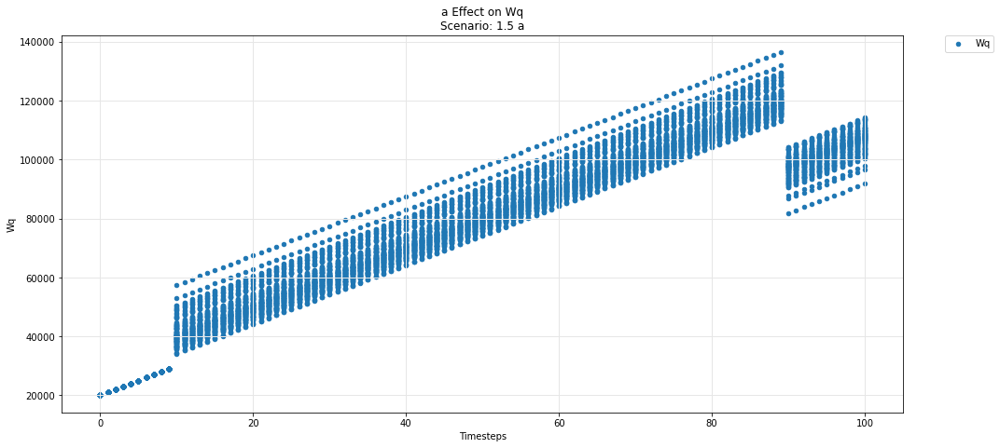

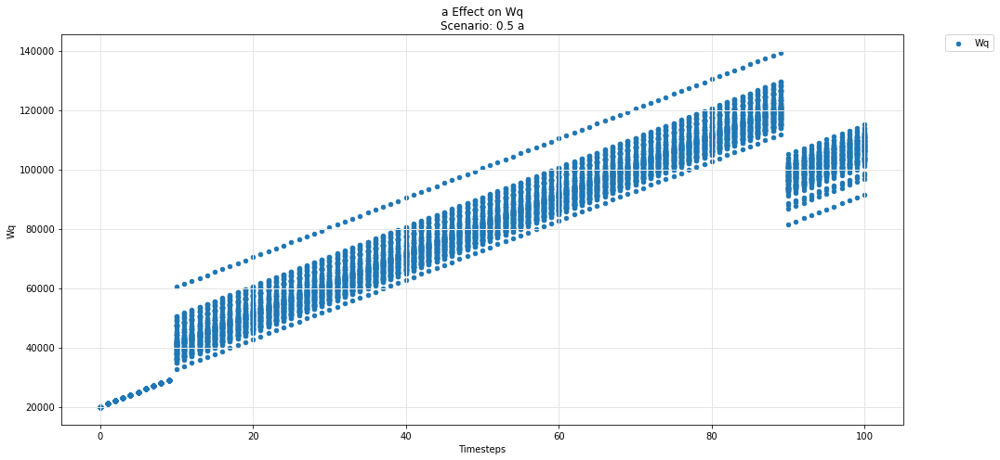

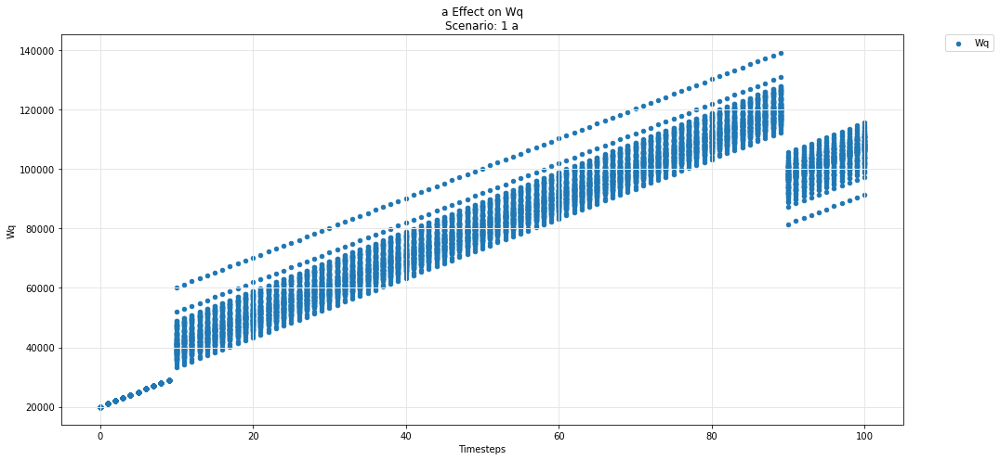

In [55]:
param_test_plot(experiments, config_ids, 'a', 'Wq')

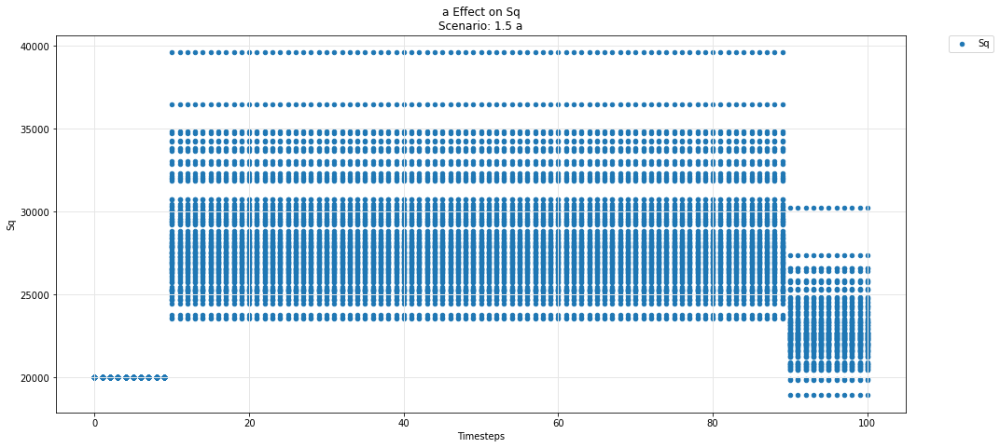

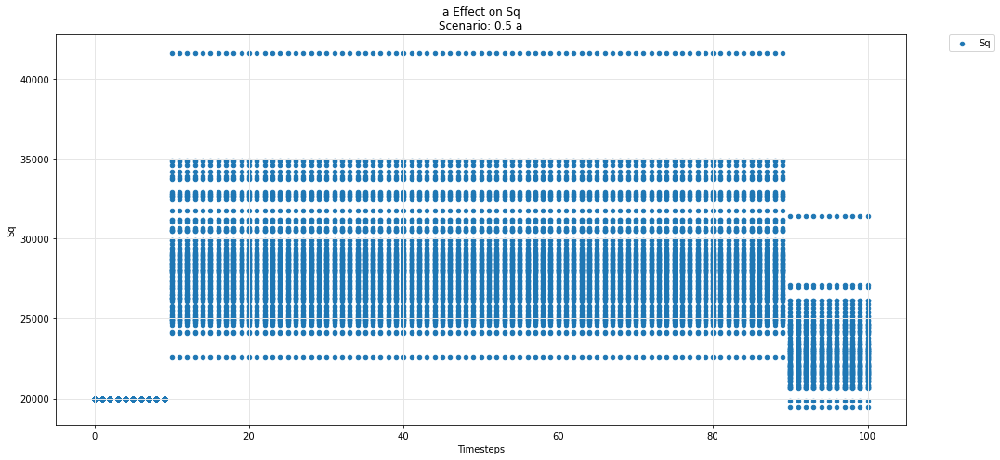

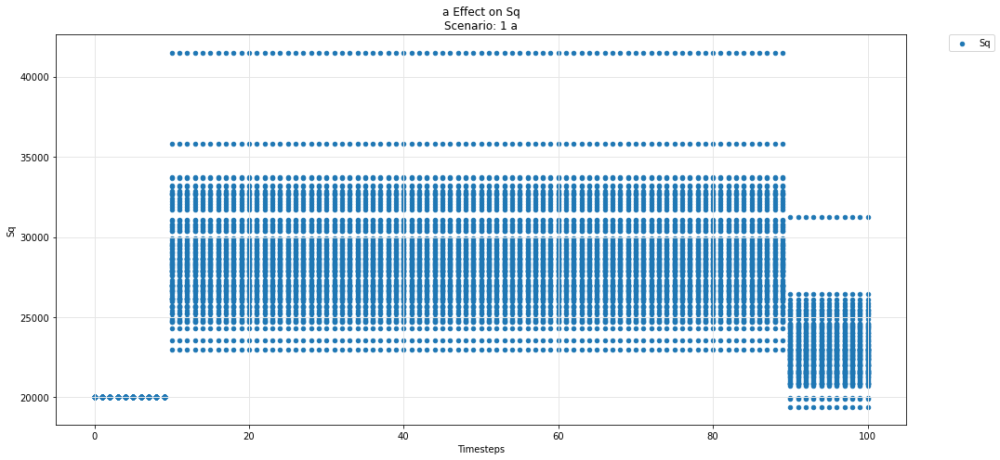

In [56]:
param_test_plot(experiments, config_ids, 'a', 'Sq')

## Hydra -- pool

Movement of the Omnipool variables
- Asset i
- Asset j
- Asset k

over the course of the simulation

In [57]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

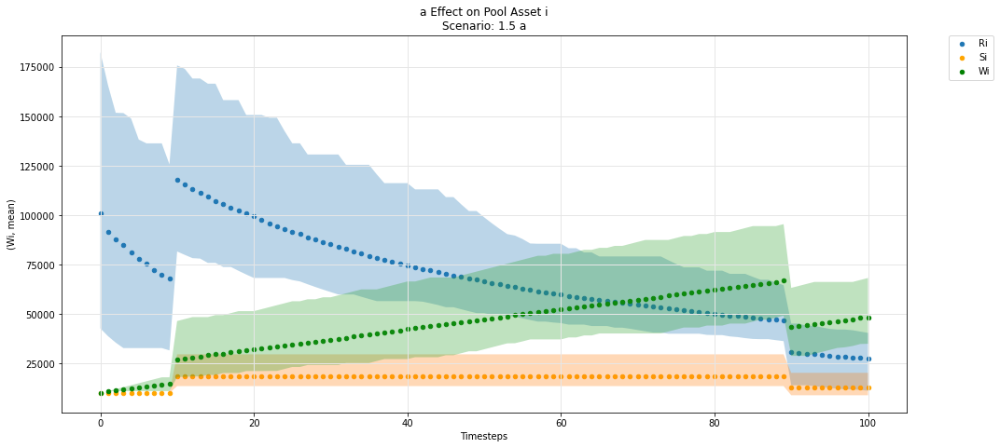

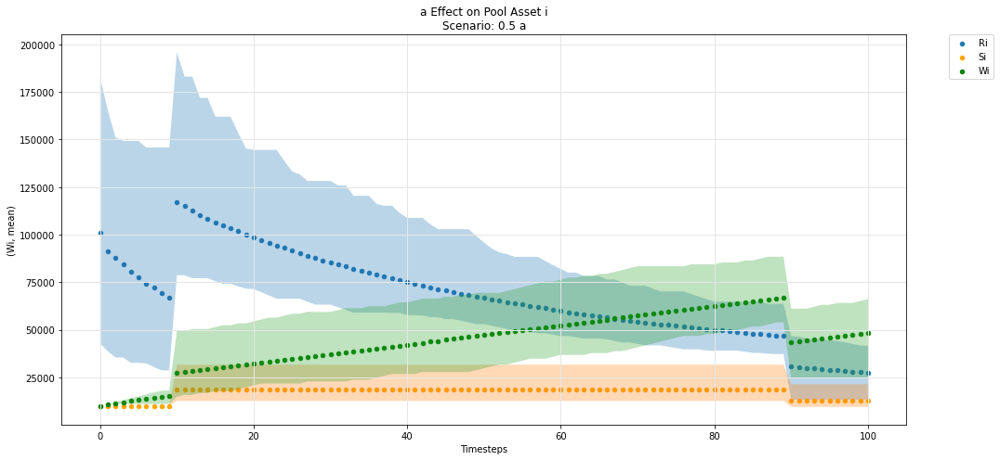

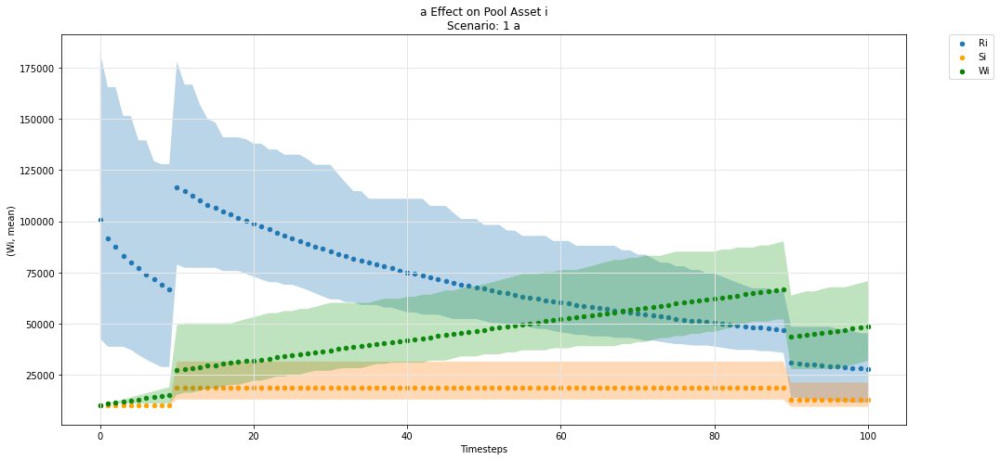

In [58]:
param_pool_simulation_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

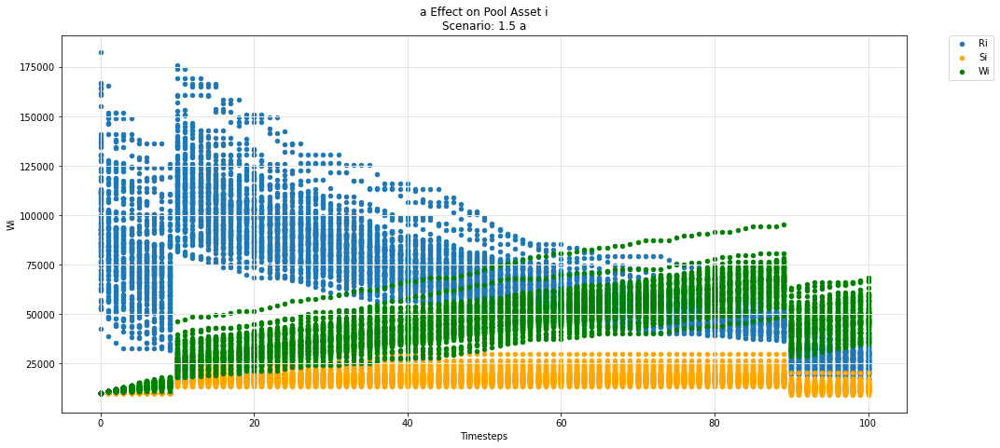

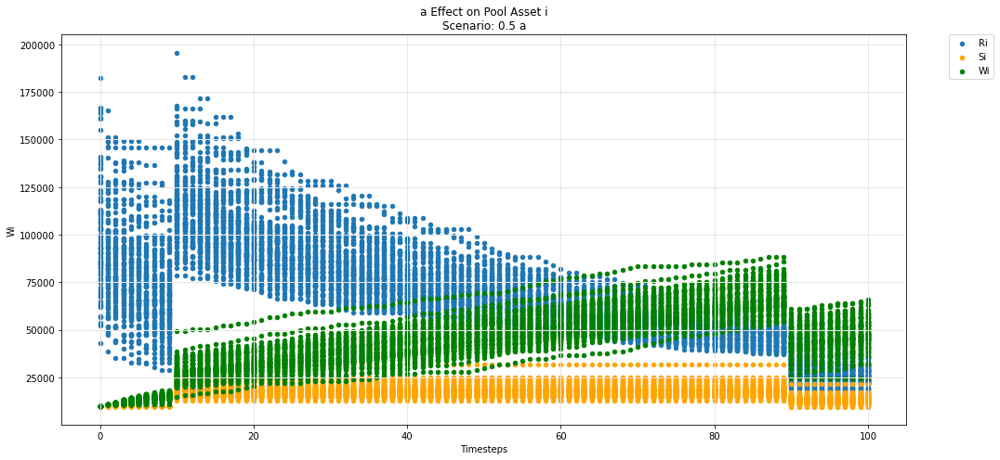

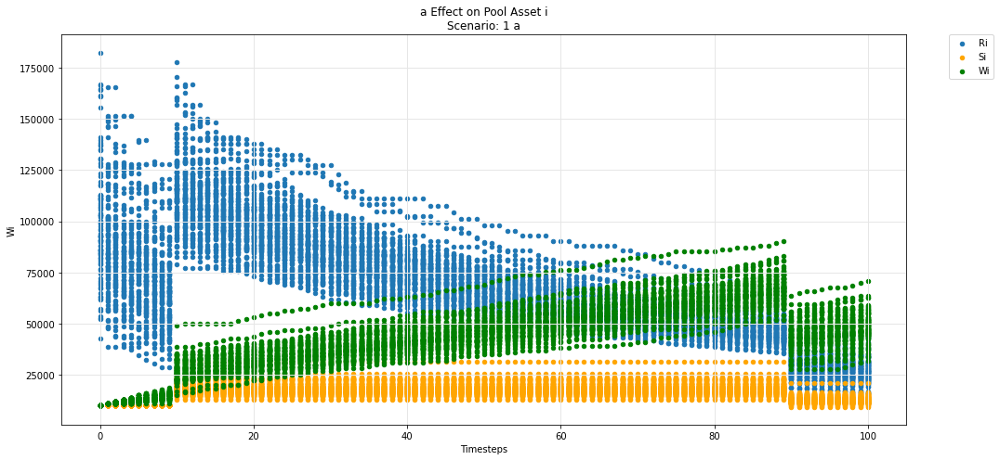

In [59]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

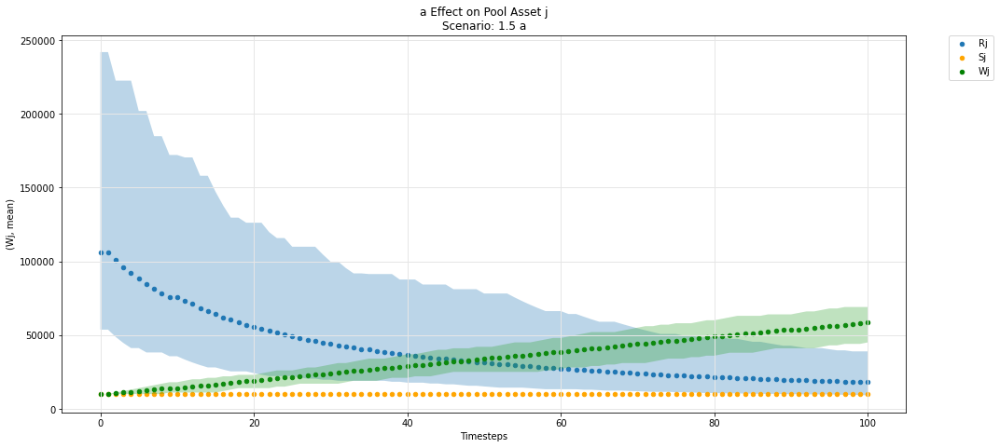

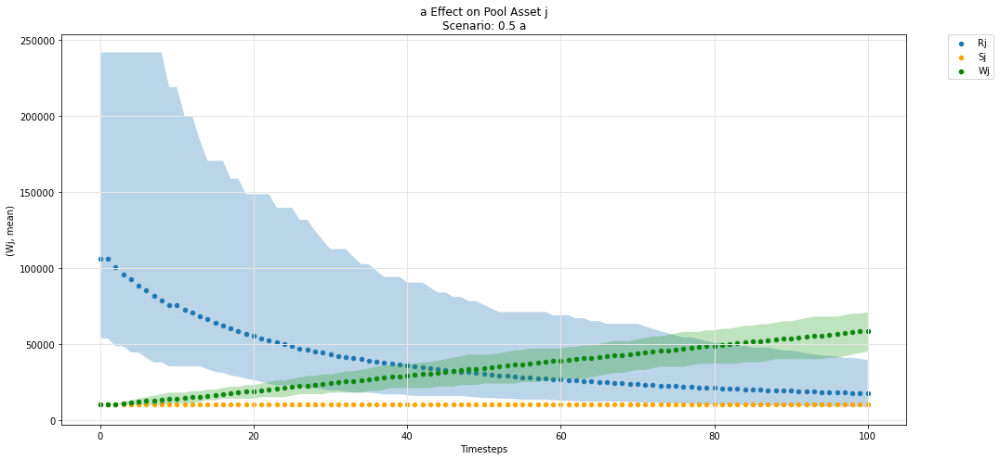

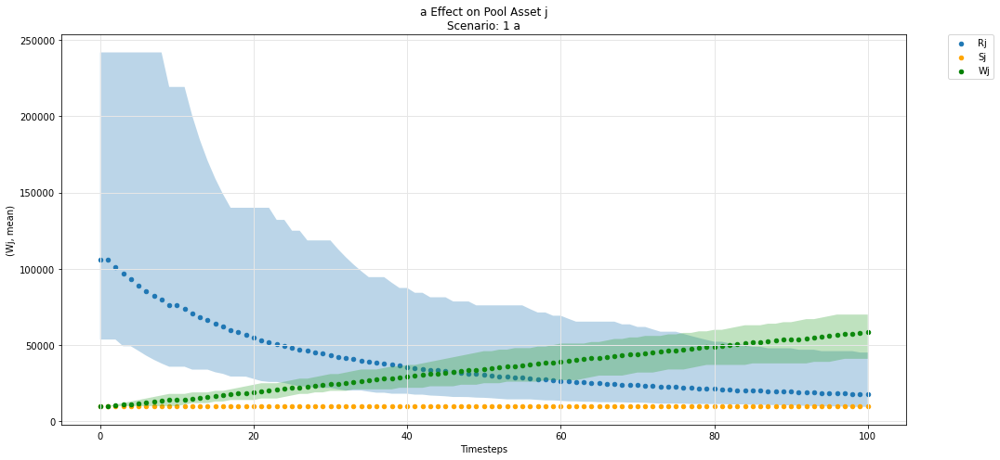

In [60]:
param_pool_simulation_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

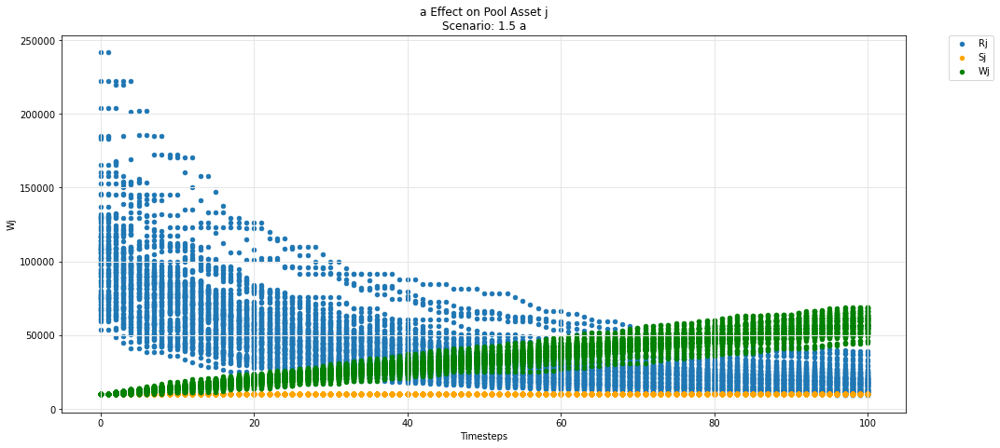

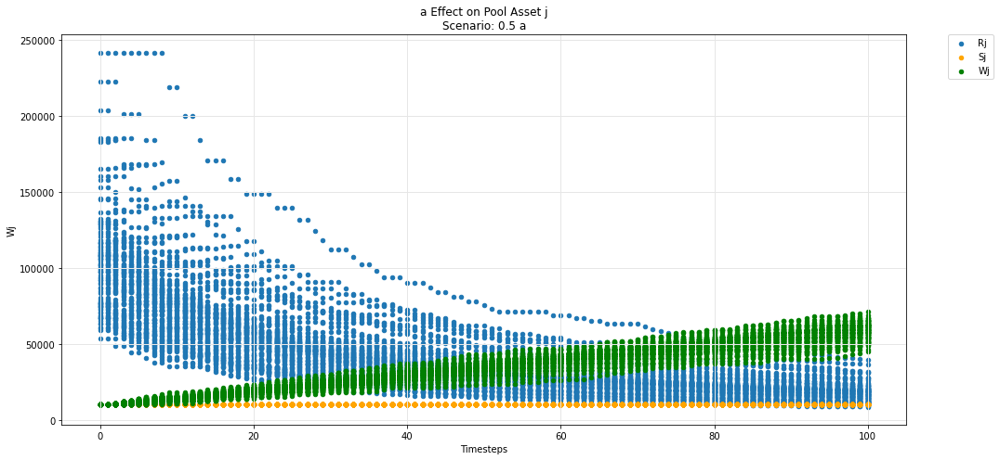

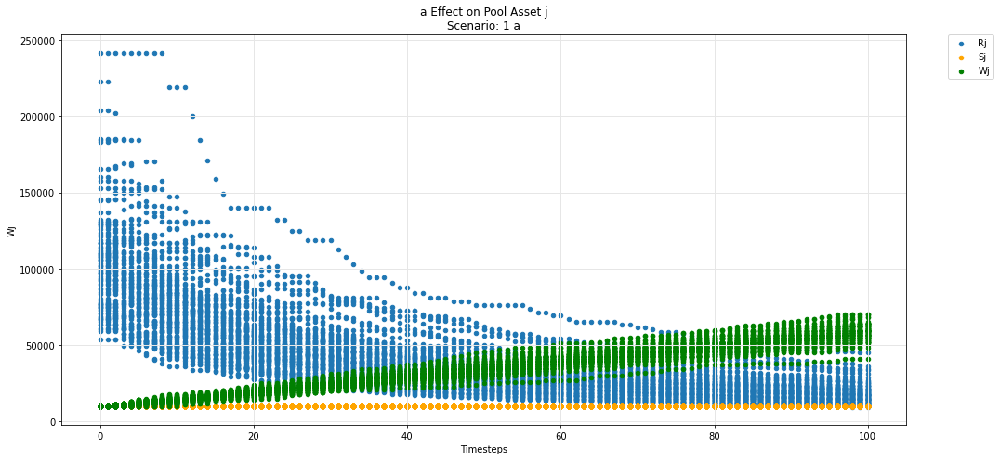

In [61]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

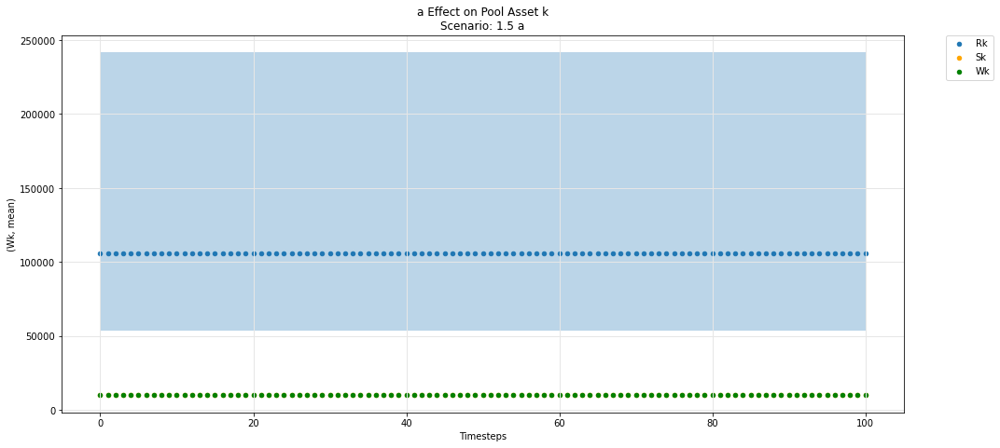

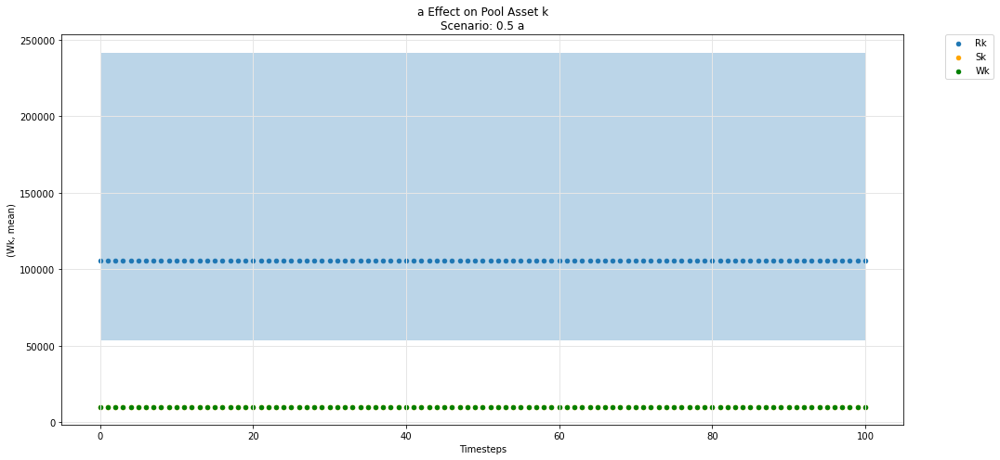

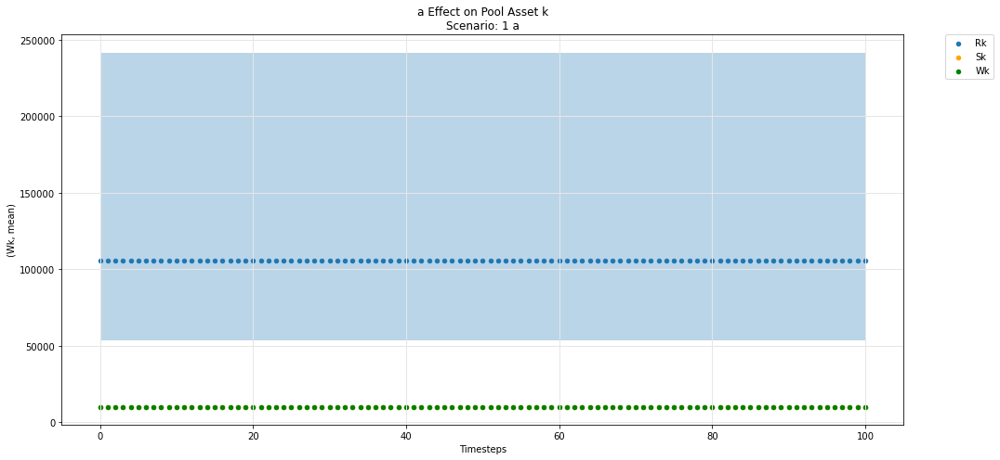

In [62]:
param_pool_simulation_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

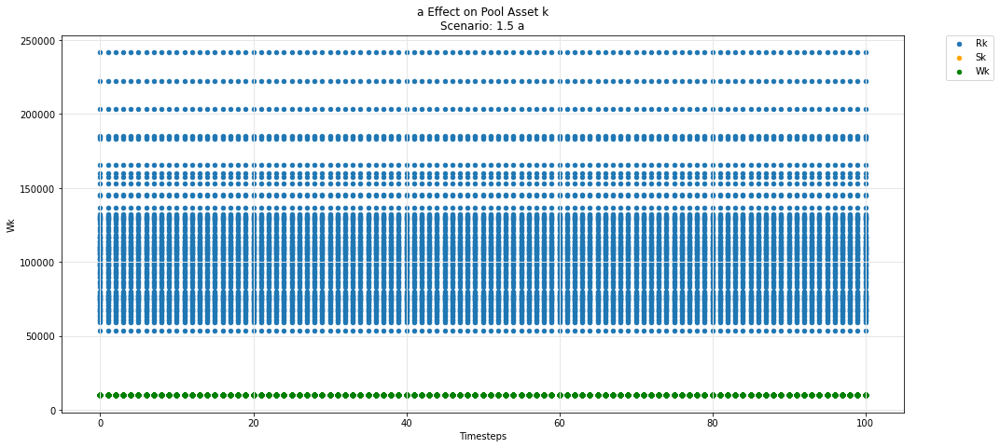

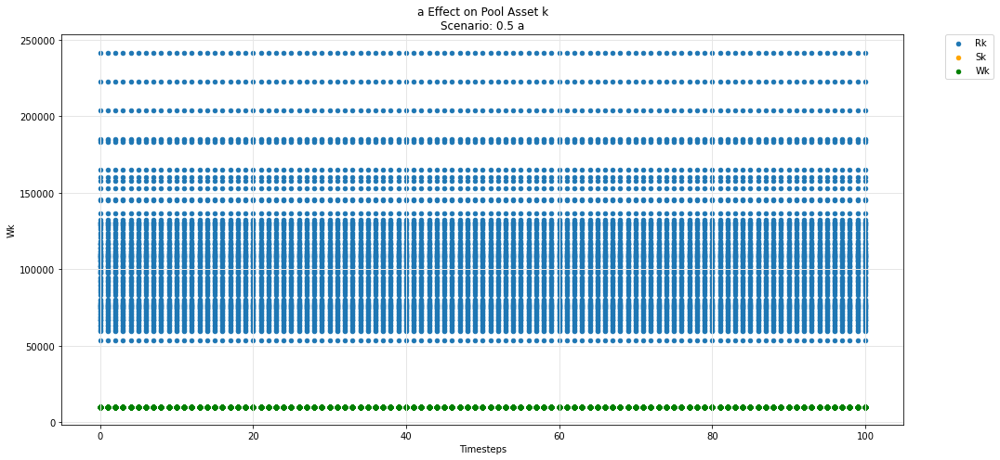

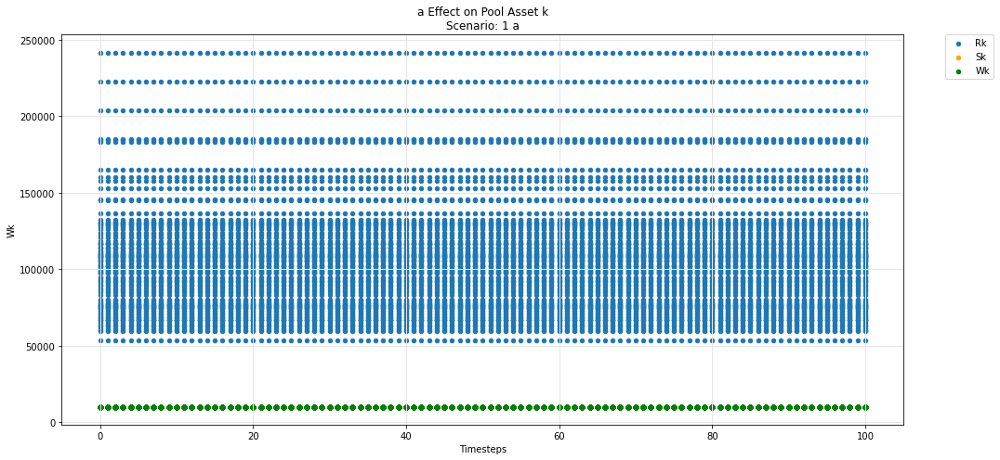

In [63]:
param_pool_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

In [64]:
def param_pool_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=df_label, label=df_label, ax=ax, legend=True, kind ='scatter')

        for count, arg in enumerate(args):
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))

            df.plot(x='timestep', y=df_arg_label, label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

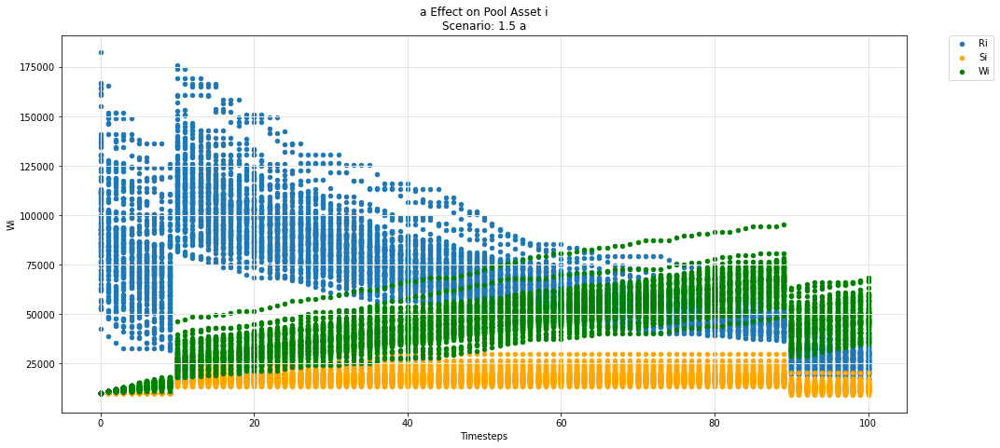

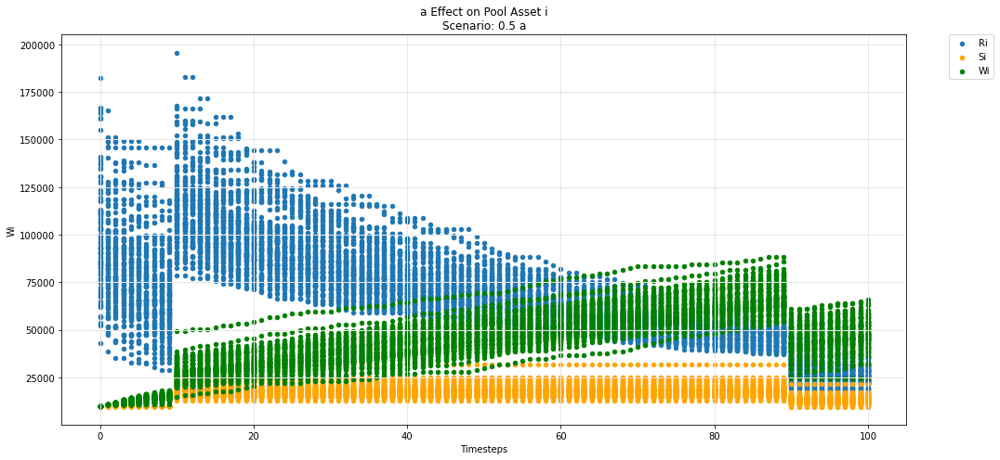

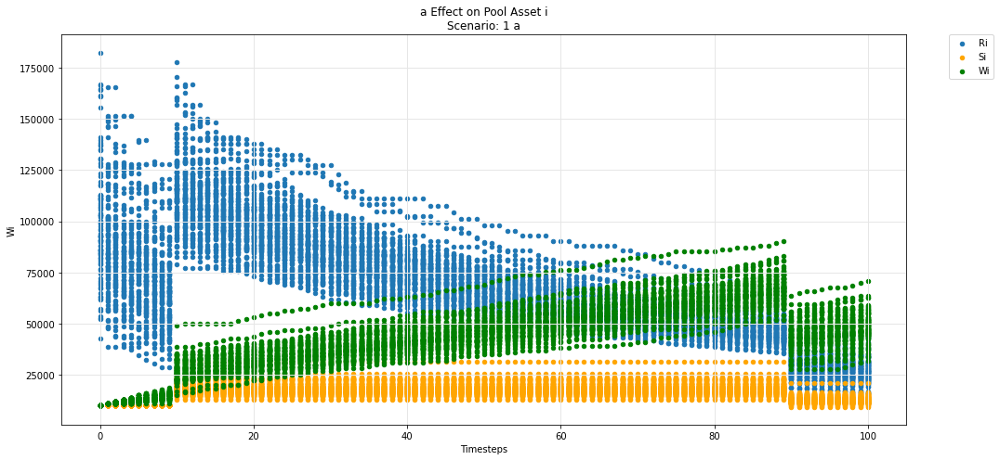

In [65]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

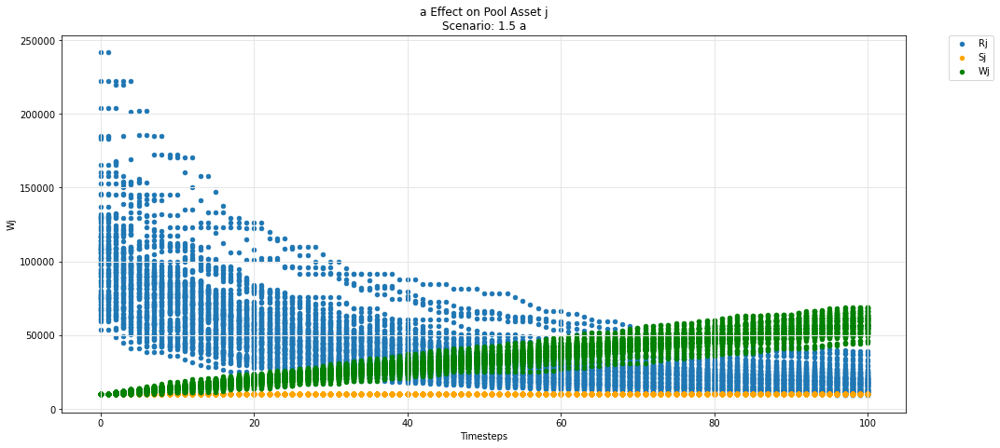

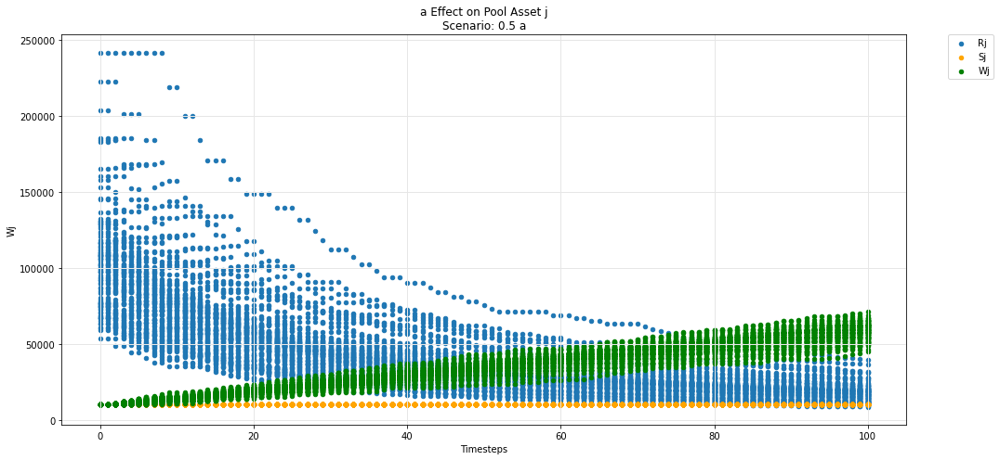

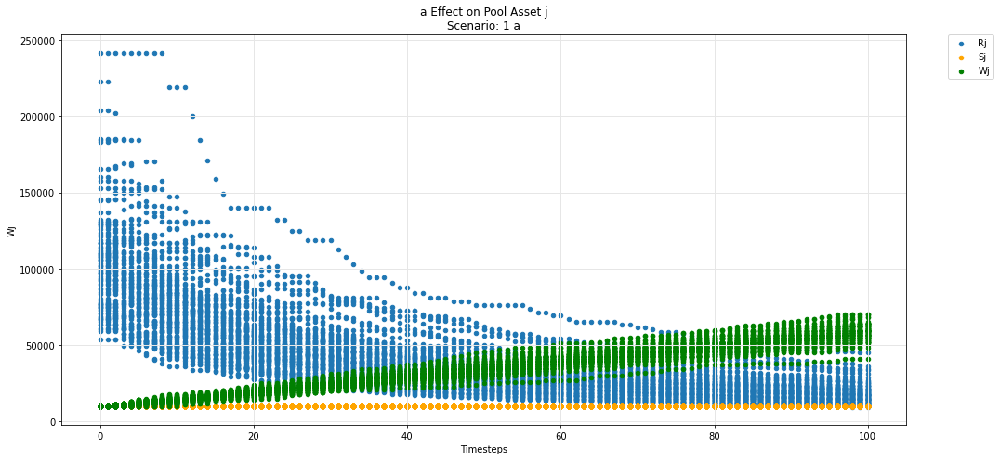

In [66]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

In [67]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

# Prices

## Uniswap

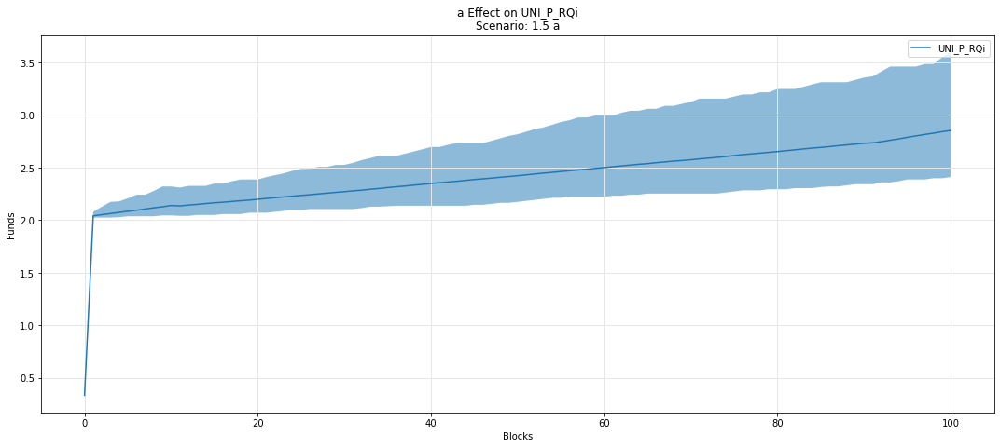

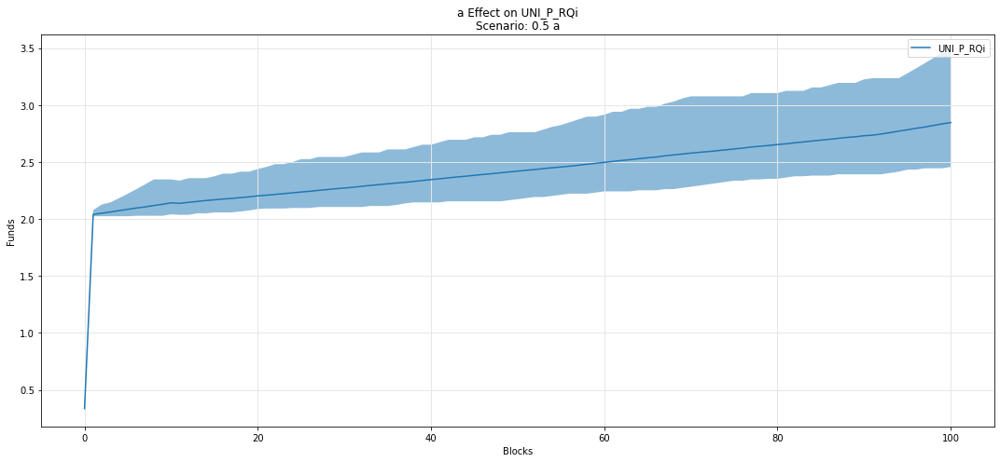

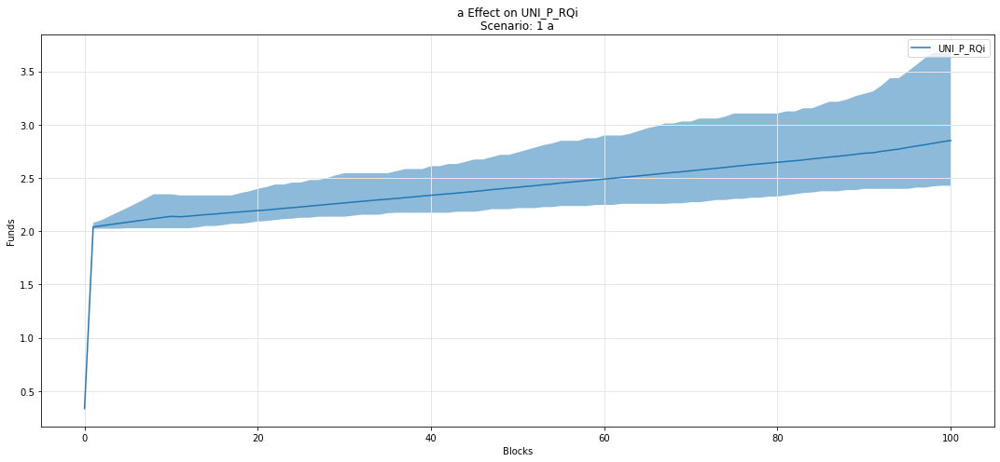

In [68]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQi')

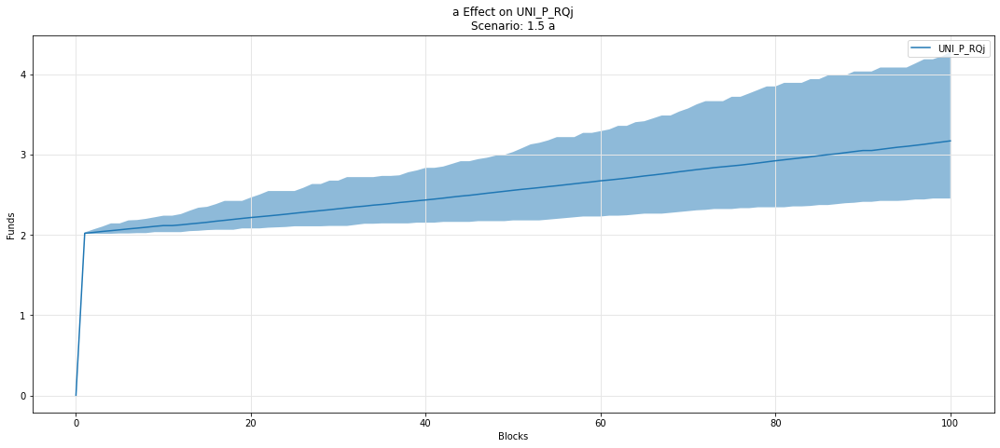

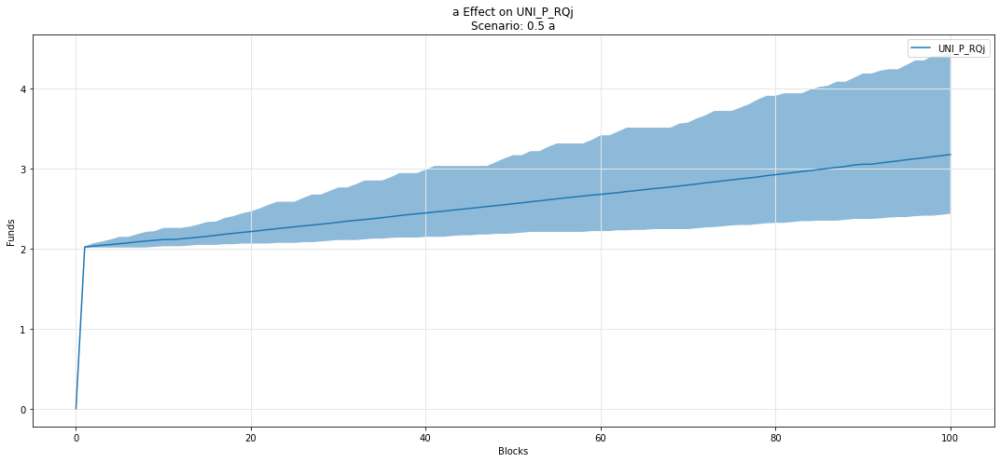

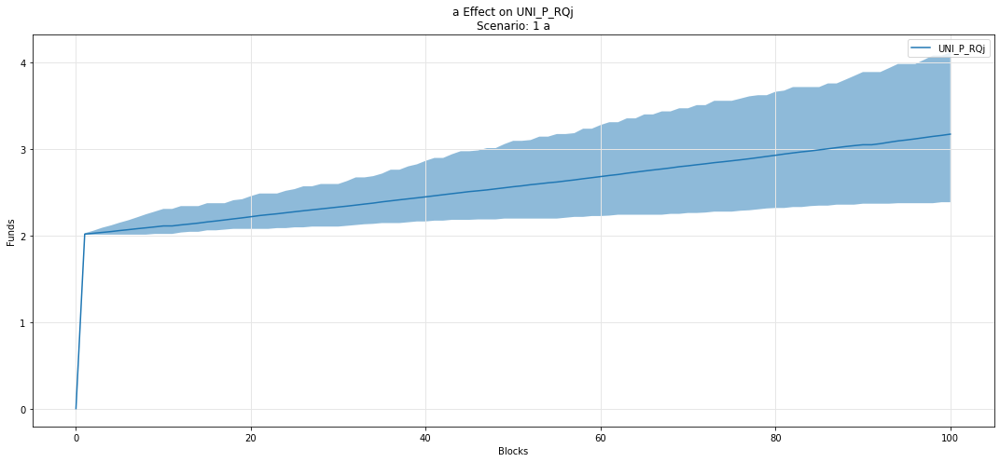

In [69]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQj')

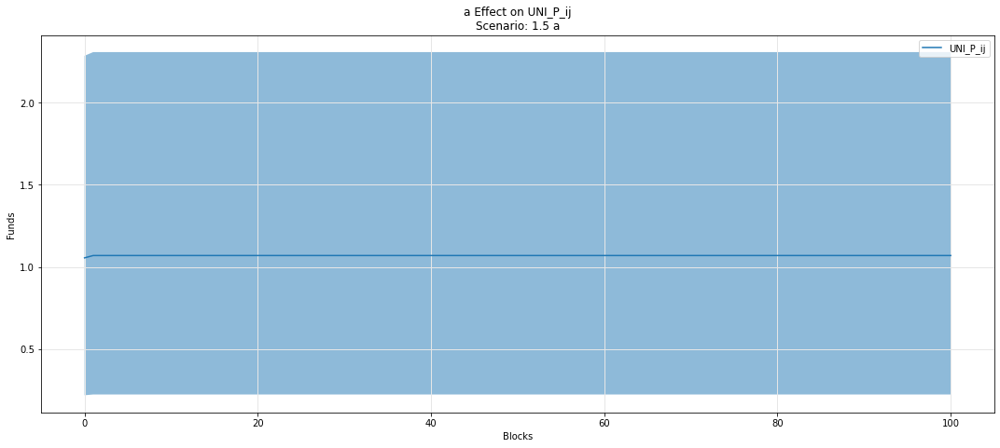

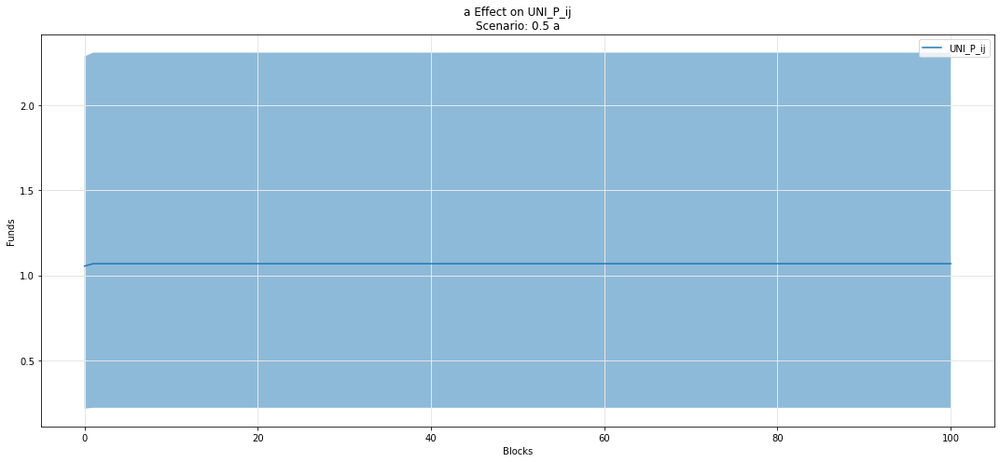

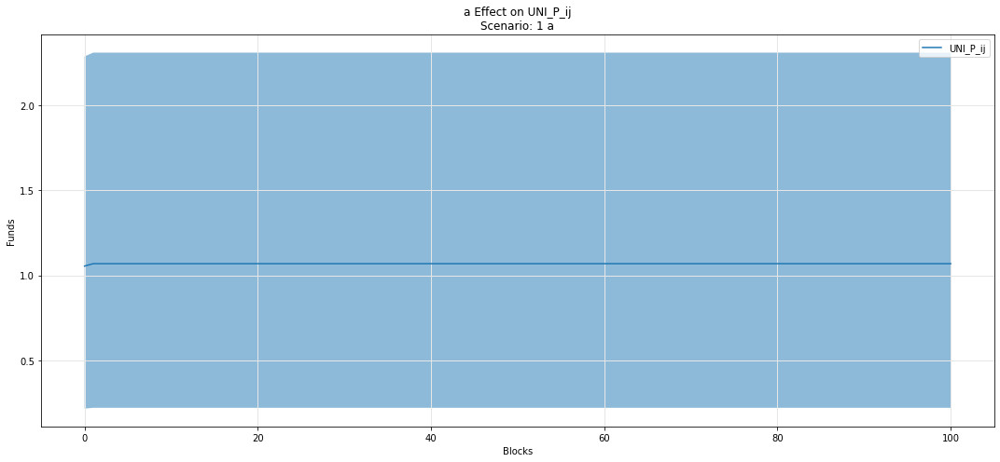

In [70]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_ij')

## Omnipool

## Asset i

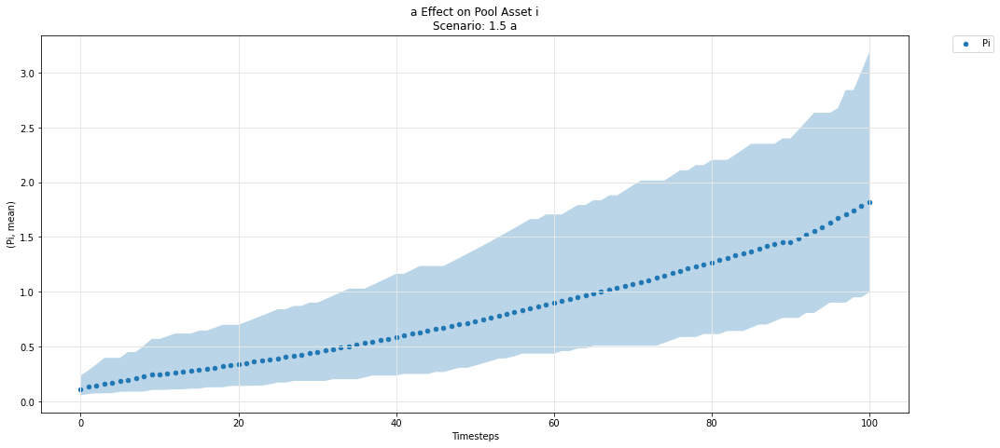

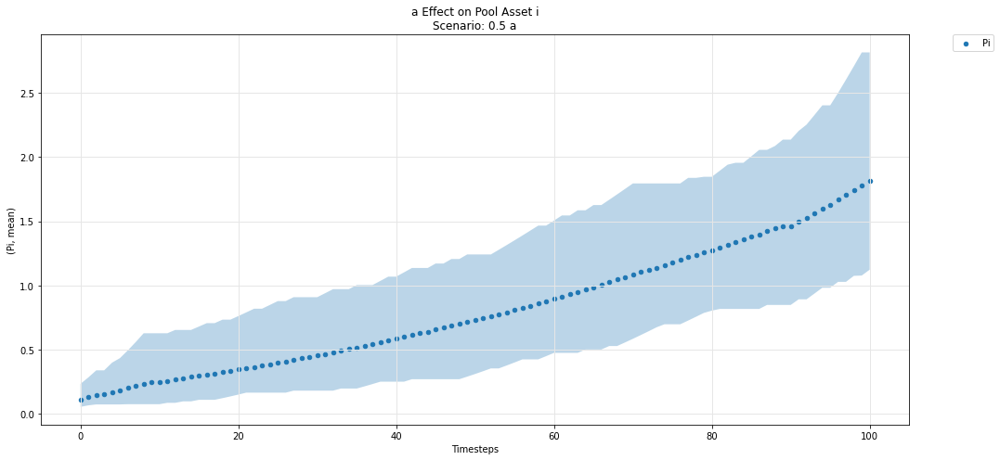

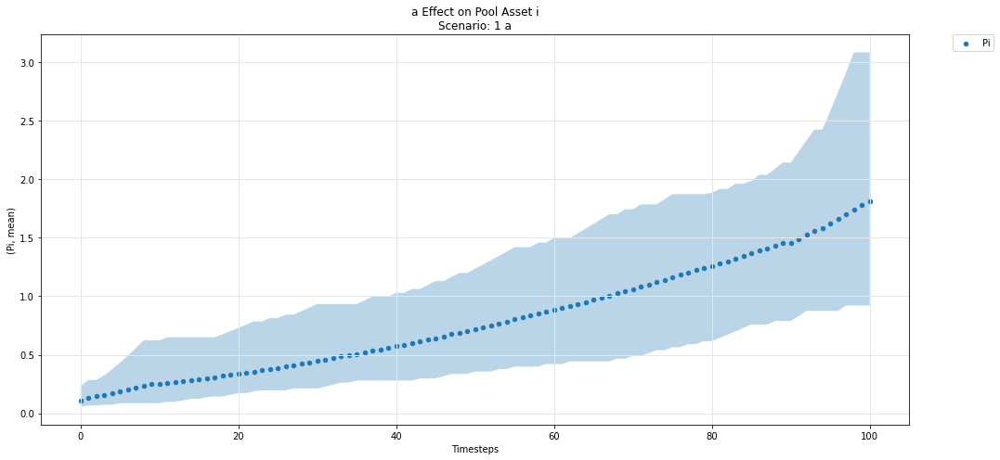

In [71]:
param_pool_simulation_plot(experiments, config_ids, 'a','i','P')

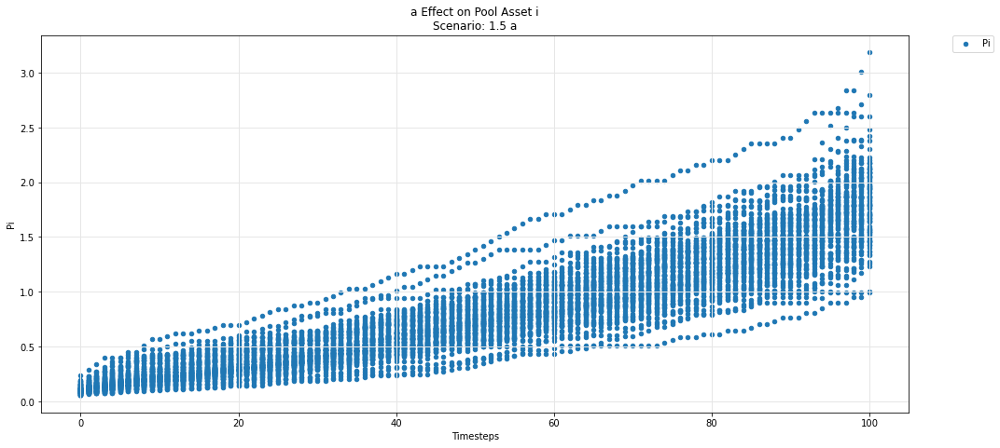

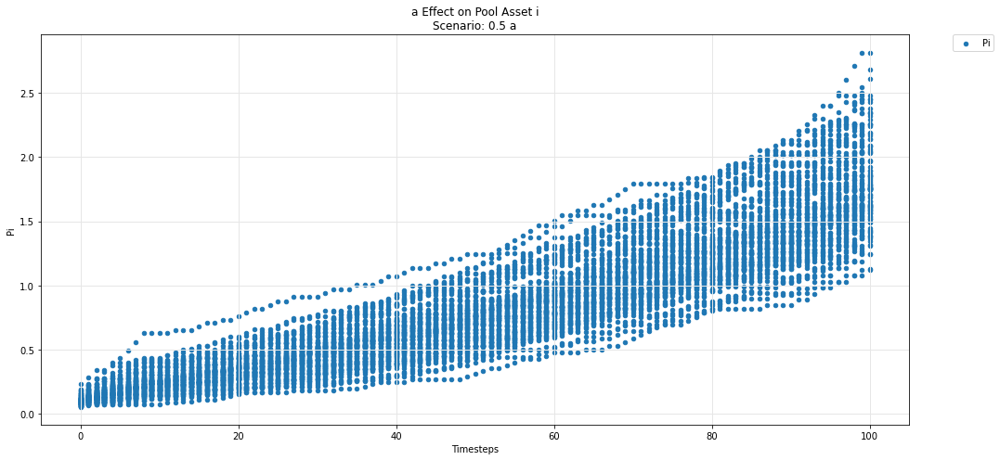

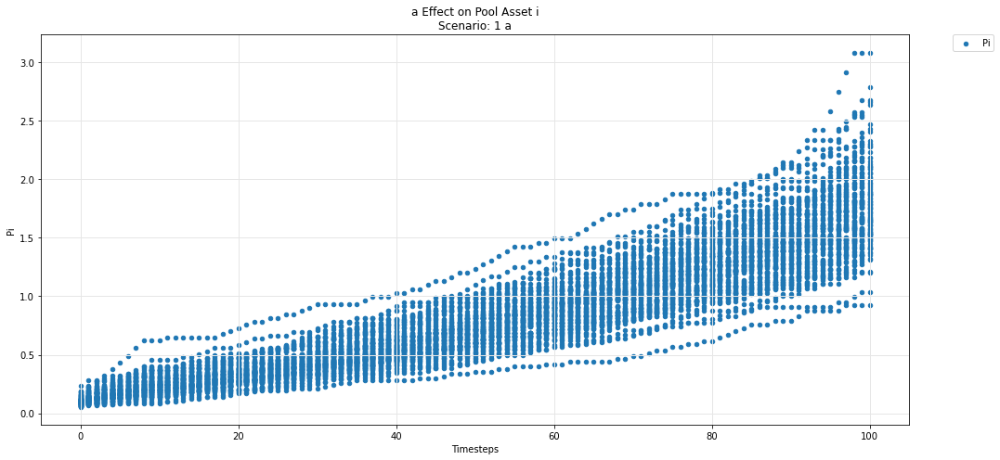

In [72]:
param_pool_plot(experiments, config_ids, 'a','i','P')

## Asset j

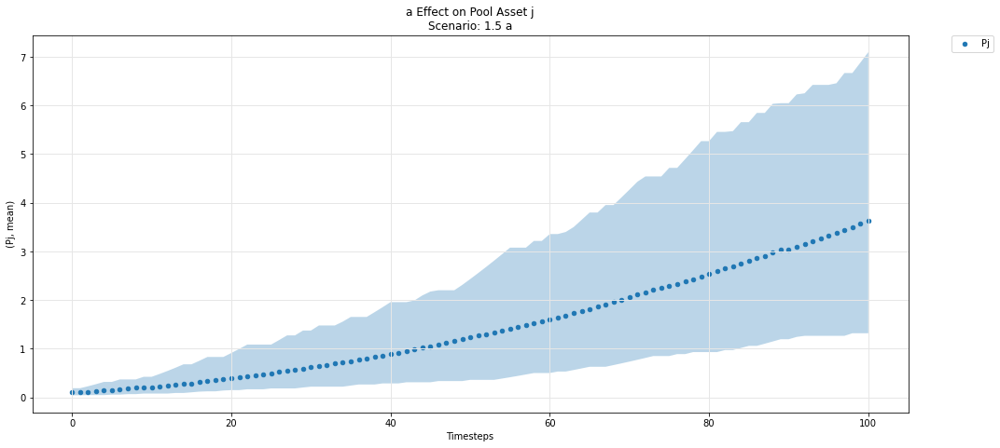

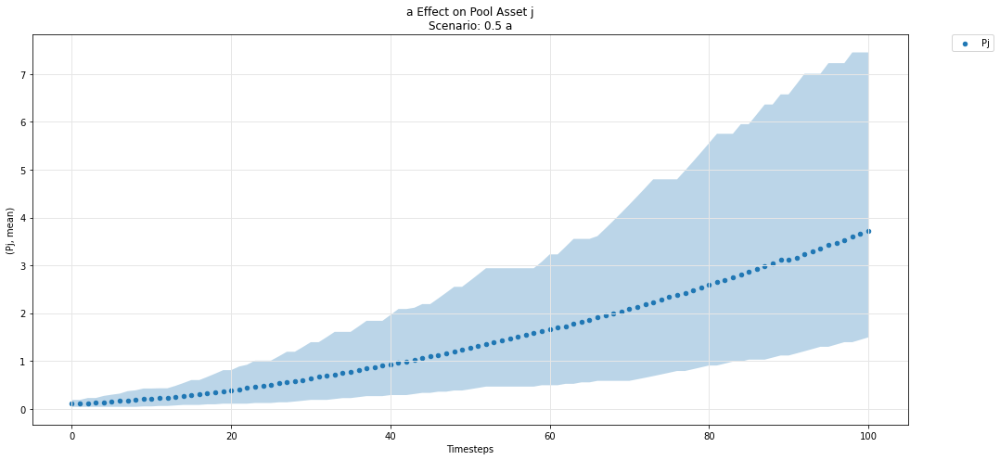

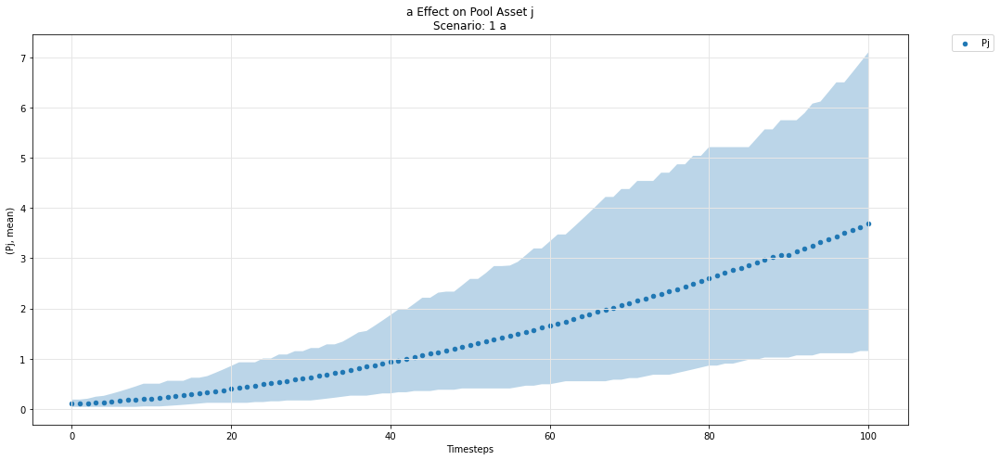

In [73]:
param_pool_simulation_plot(experiments, config_ids, 'a','j','P')

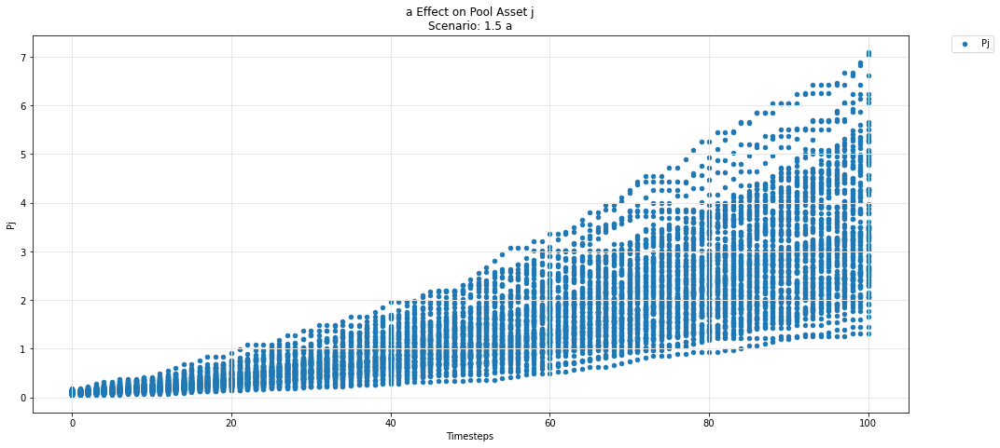

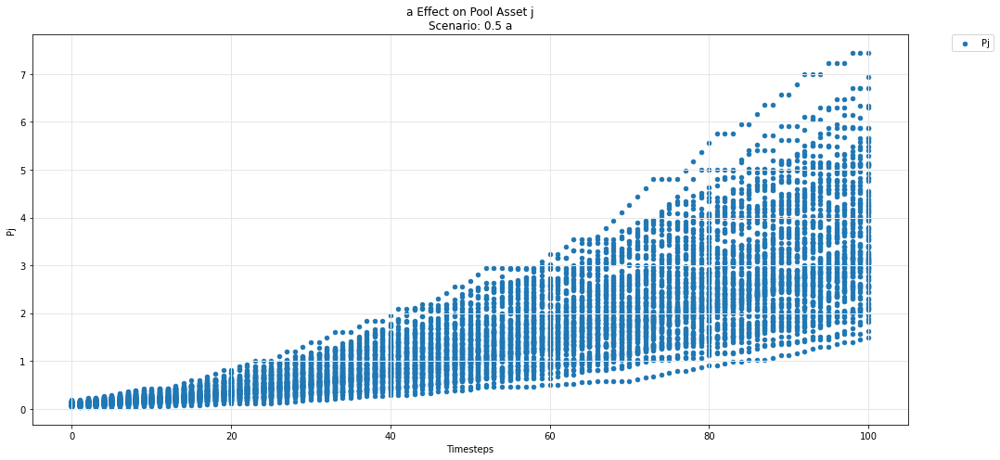

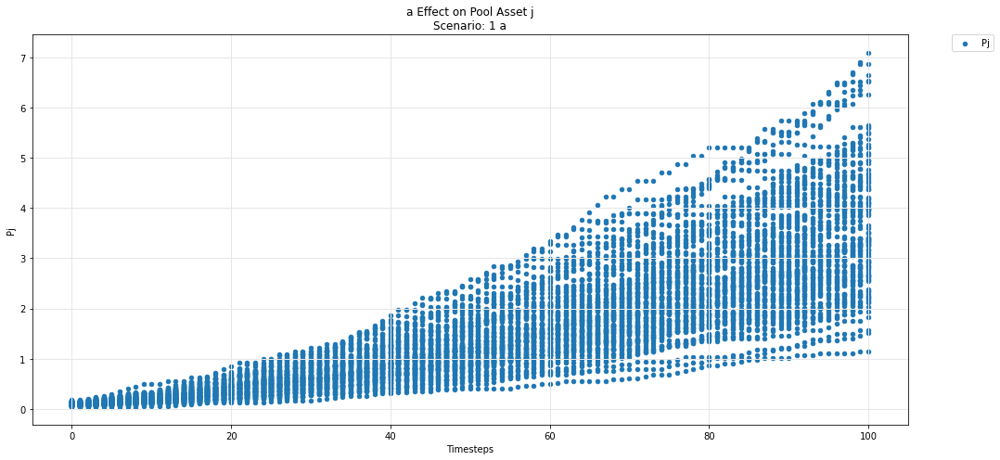

In [74]:
param_pool_plot(experiments, config_ids, 'a','j','P')

## Asset k

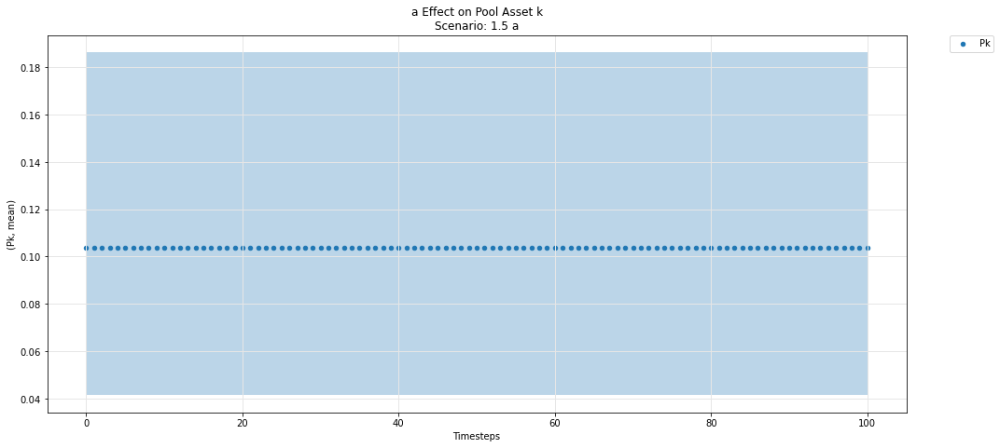

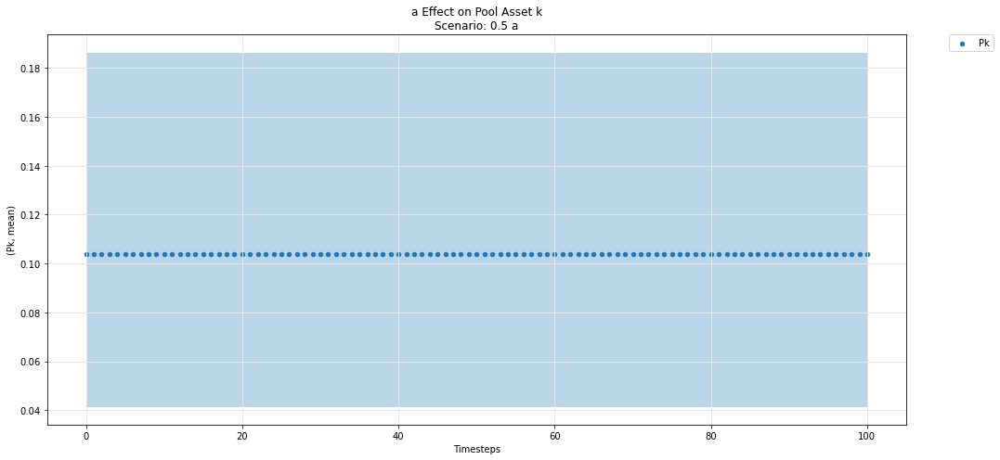

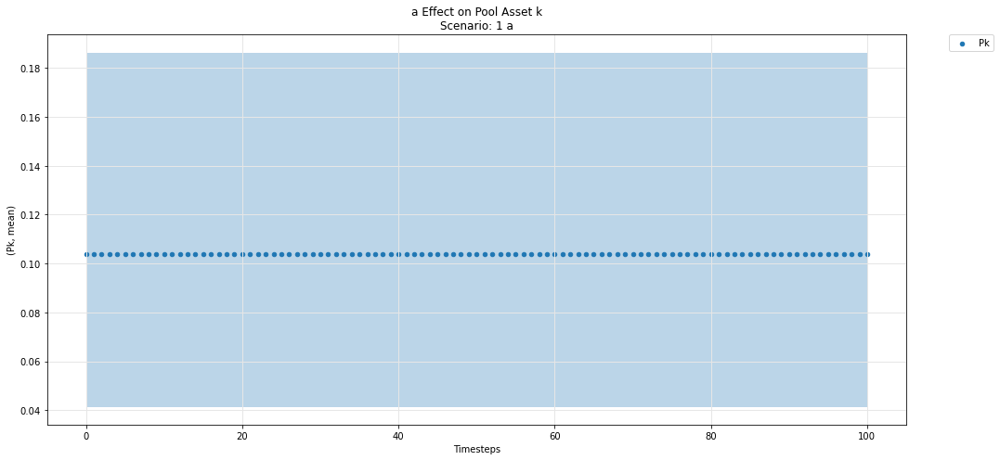

In [75]:
param_pool_simulation_plot(experiments, config_ids, 'a','k','P')

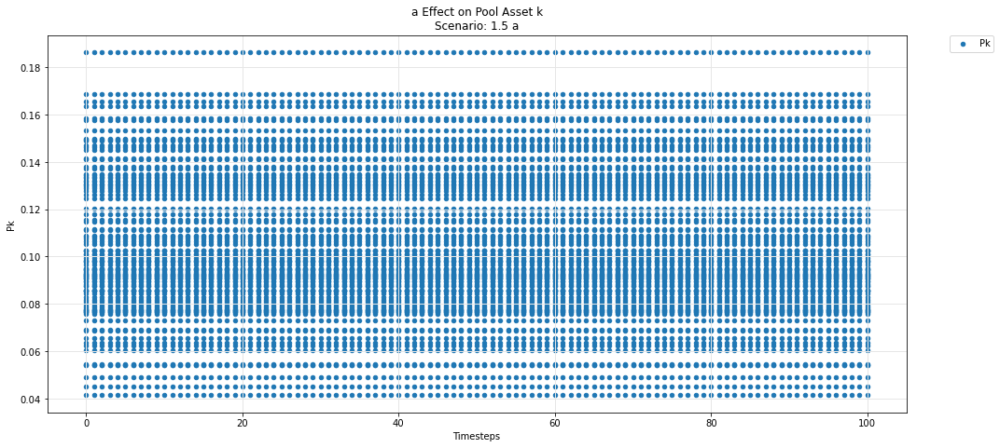

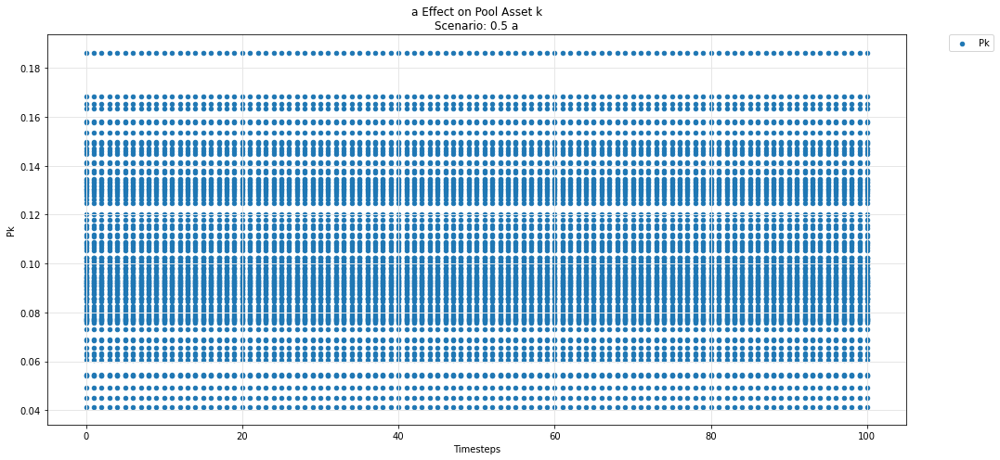

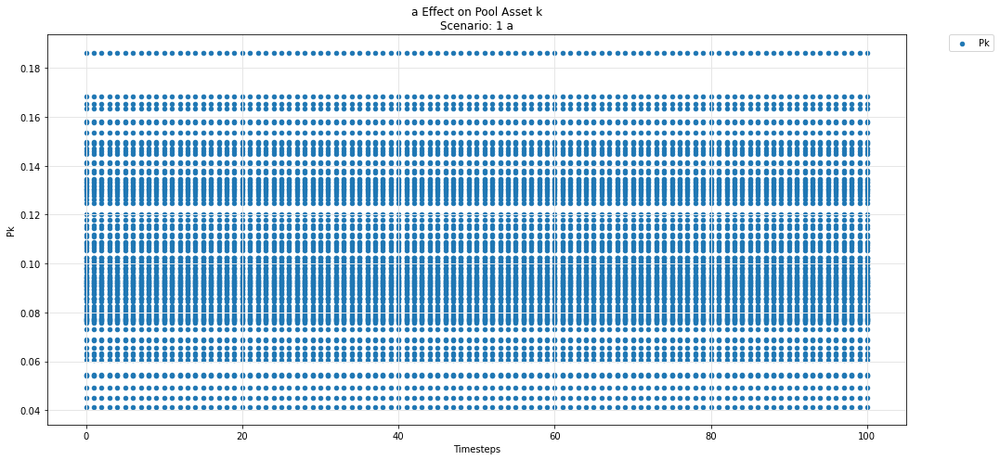

In [76]:
param_pool_plot(experiments, config_ids, 'a','k','P')

In [77]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')
        plt.ylim(0, 500000)
        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

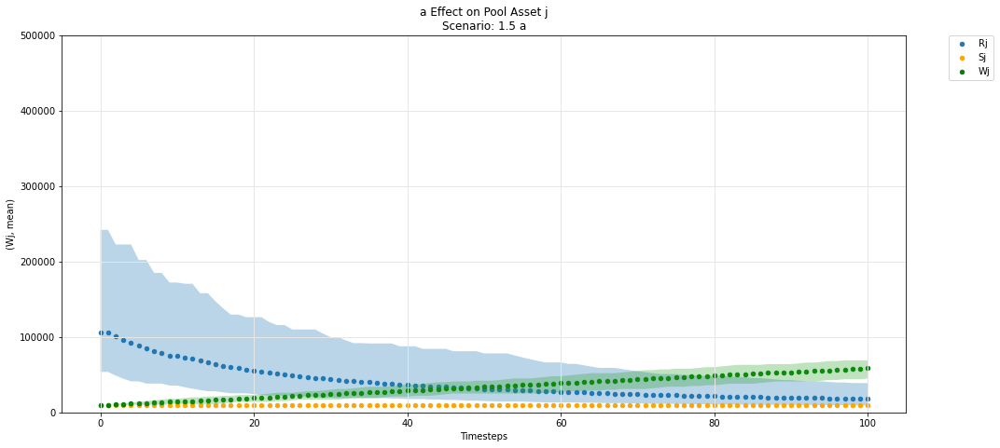

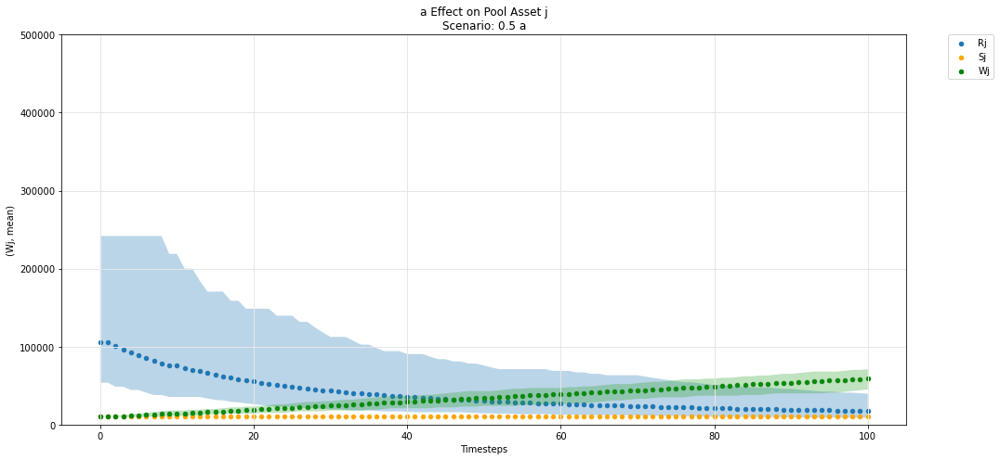

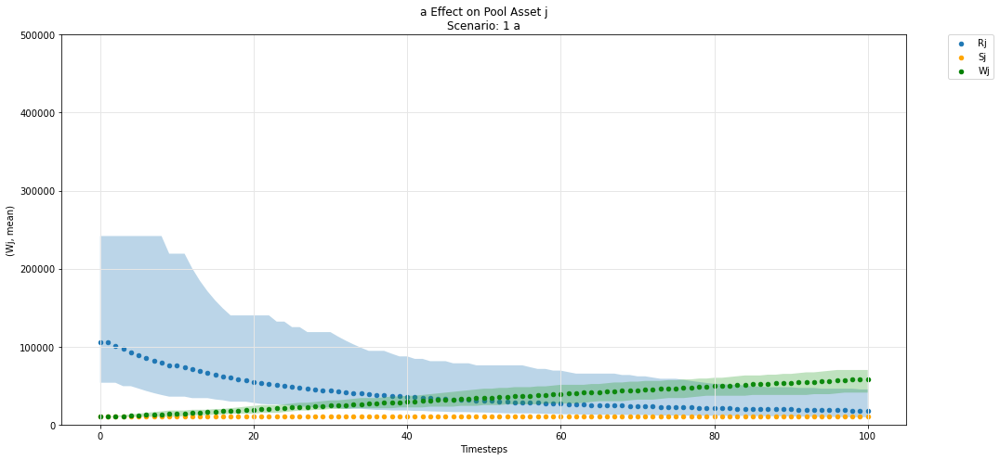

In [78]:
param_pool_simulation_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')